# GANS/Cyclic GANS For Data Augmentation and Neural Style Transfer

In [1]:
import tensorflow as tf
import os
import glob
import numpy as np
from pathlib import Path
import matplotlib.pyplot as plt
import shutil
import random
import itertools
import math
import time
import wandb

from skimage.io import imread
from skimage.transform import resize
from mpl_toolkits.axes_grid1 import ImageGrid

# Model class
from tensorflow.keras.models import Model, Sequential

# Layers
from tensorflow.keras.layers import (LeakyReLU, BatchNormalization, Dropout, 
                                     Flatten, Conv2D, Dense, MaxPool2D, Conv2DTranspose, 
                                     GlobalMaxPool2D, Reshape, BatchNormalization, Input, Embedding, multiply)
from tensorflow.keras.layers import Layer
from tensorflow.keras import layers

# Optimizer
from tensorflow.keras.optimizers import Adam

# Loss function
from tensorflow.keras.losses import BinaryCrossentropy, MeanAbsoluteError 

# Data loader
from tensorflow.keras.utils import Sequence

# Metrics
from tensorflow.keras.metrics import BinaryAccuracy, Recall, Precision, MSE

# ImageLoader
from skimage.io import imread

# Weights Initializer
from tensorflow.keras.initializers import RandomNormal, GlorotNormal, GlorotUniform

# Callbacks
from tensorflow.keras.callbacks import Callback, ModelCheckpoint

# Initializers
from tensorflow.keras.initializers import RandomNormal, RandomUniform

In [2]:
!pip install tensorflow-addons

     |████████████████████████████████| 1.1 MB 2.2 MB/s            


In [4]:
import tensorflow_addons as tfa

In [5]:
# To limit GPU VRAM allocation by tensorflow
gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus:
  tf.config.experimental.set_memory_growth(gpu, True)

## Pre-Processing The Data

In [6]:
class DataLoader(Sequence):
    
    def __init__(self, im_dir, labels= None, batch_size= 32, output_dim= None, classification= True, shuffle= True):
        
        self.im_dir = im_dir
        self.classification = classification
        self.shuffle = shuffle
        self.resize = resize
        self.output_dim = output_dim
        
        self.labels = {}
        if isinstance(labels, list):
            for i, label in enumerate(labels):
                self.labels[label] = i
        elif isinstance(labels, dict):
            self.labels = labels
        else:
            for root_dir, subdirs, files in os.walk(self.im_dir):
                for i, subdir in enumerate(subdirs):
                    self.labels[subdir] = i
        
            
        self.images = glob.glob(f"{self.im_dir}/*/*")
        random.shuffle(self.images)
        self.batch_size = len(self.images) if batch_size == -1 else batch_size
        
        self.on_epoch_end()
        
    
    def __len__(self):
        return int(np.floor(len(self.images)/self.batch_size))
    
    def __getitem__(self, index):
        indexes = self.indexes[index*self.batch_size:(index+1)*self.batch_size]
        im_files_batch = [self.images[idx] for idx in indexes]
        if self.output_dim:
            batch_images = np.array([resize(imread(file), self.output_dim, preserve_range= True) for file in im_files_batch], dtype= np.uint8)
            
        else:
            batch_images = np.arrary([imread(file) for file in im_files_batch], dtype= np.uint8)
        
        if self.classification:
            batch_images = np.asanyarray(batch_images, dtype= np.float32)/255.
        else:
            batch_images = (np.asanyarray(batch_images, dtype= np.float32) - 127.5)/127.5
            
        batch_labels = np.empty((self.batch_size), dtype= np.uint8)
        for i, im in enumerate(im_files_batch):
            for label in self.labels.keys():
                if label in im:
                    batch_labels[i] = self.labels[label]
        return batch_images, batch_labels.reshape(-1, 1)
    
    def on_epoch_end(self):
        "Updates all indexes after the end of each epoch"
        self.indexes = np.arange(len(self.images))
        if self.shuffle:
            np.random.shuffle(self.indexes)
            
        
    def get_all_data(self, batched_data):
        return

In [7]:
train_horses_cows = DataLoader(im_dir= "../dataset/Newdata/Train", classification= True, output_dim= (128, 128, 3), batch_size= 16)
val_horses_cows = DataLoader(im_dir= "../dataset/Newdata/Test", classification= True, output_dim= (128, 128, 3))

In [8]:
# Get a batch of data
horses_cows_iter = iter(train_horses_cows)
batch_data = next(horses_cows_iter)

In [9]:
horse_batch = [data for i, data in enumerate(batch_data[0]) if batch_data[1][i] == 1]
cow_batch = [data for i, data in enumerate(batch_data[0]) if batch_data[1][i] == 0]

In [10]:
random_horse = np.random.choice(range(len(horse_batch)), size= 4, replace= False)
random_cow = np.random.choice(range(len(cow_batch)-1), size= 4, replace= False)
random_horse, random_cow

(array([8, 4, 0, 2]), array([0, 4, 5, 1]))

In [11]:
cow_images, horse_images = [cow_batch[i] for i in random_cow], [horse_batch[i] for i in random_horse]

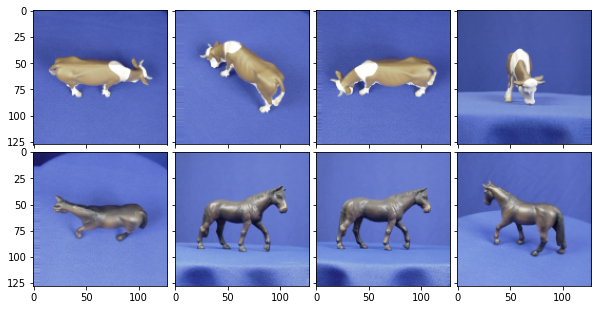

In [12]:
fig = plt.figure(figsize=(10., 10.))
grid = ImageGrid(fig, 111,  # similar to subplot(111)
                 nrows_ncols=(2, 4),  # creates 2x2 grid of axes
                 axes_pad=0.1,  # pad between axes in inch.
                 )

for ax, im in zip(grid, [*cow_images, *horse_images]):
    # Iterating over the grid returns the Axes.
    ax.imshow(im)

plt.show()

## Define Metrics For Classification
- Accuracy
- Precision
- Recall

In [ ]:
def show_metrics_classification(model_history):
    metrics = ["_".join(metric.split("_")[1:]) for metric in model_history.history.keys() if "val" not in metric]
    print(metrics)
    colors = list(itertools.combinations(['b', 'g', 'r', 'c', 'm', 'y', 'k'], 2))
    
    f = plt.figure()
    f.set_figwidth(2.5*len(metrics))
    f.set_figheight(3*len(metrics))
    for i, metric in enumerate(metrics):
        plt.subplot(math.ceil(len(metrics)/2), 2, i+1)
        color_plts = np.random.randint(0, len(colors))
        plt.plot(model_history.history[f"train_{metric}"], color= colors[color_plts][0])
        plt.plot(model_history.history[f"val_{metric}"], color= colors[color_plts][1])
        plt.ylabel(metric)
        plt.xlabel("epochs")
        plt.legend(["train", "val"], loc= "upper left")
        plt.title(f"{metric.title()} vs Epochs")
    plt.show()
    

## Building The Classifier

In [ ]:
class Classifier(Model):
    
    def __init__(self, name):
        super(Classifier, self).__init__(name= name)
        
    def build(self, input_shape):
        
        self.conv1 = Conv2D(filters= 50, kernel_size= 3, activation= 'relu', padding= 'same', kernel_initializer= 'glorot_uniform', input_shape= input_shape)
        self.maxpool1 = MaxPool2D(pool_size= (2, 2))
        
        self.conv2 = Conv2D(filters= 20, kernel_size= 3, activation= 'relu', padding= 'valid', kernel_initializer= 'glorot_uniform')
        self.maxpool2 = MaxPool2D(pool_size= (2, 2))
        
        self.conv3 = Conv2D(filters= 5, kernel_size= 3, activation= 'relu', padding= 'valid', kernel_initializer= 'glorot_uniform')
        self.maxpool3 = MaxPool2D(pool_size= (2, 2))
        
        self.flatten = Flatten()
        self.dense1 = Dense(units= 30, activation= 'relu', kernel_initializer= 'glorot_uniform')
        self.dense2 = Dense(units= 20, activation= 'relu', kernel_initializer= 'glorot_uniform')
        self.dense3 = Dense(units= 1, activation= 'sigmoid', kernel_initializer= 'glorot_uniform')
        
        super(Classifier, self).build(input_shape)
    
    def call(self, input_):
        x = self.conv1(input_)
        x = self.maxpool1(x)
        
        x = self.conv2(x)
        x = self.maxpool2(x)
        
        x = self.conv3(x)
        x = self.maxpool3(x)
     
        x = self.flatten(x)
        x = self.dense1(x)
        x = self.dense2(x)
        
        output = self.dense3(x)
        return output
    
    def train_step(self, train_batch):
        X_train, y_train = train_batch
        
        with tf.GradientTape() as tape:
            # apply forward pass
            y_pred = self(X_train, training= True)
            loss = self.compiled_loss(y_train, y_pred, regularization_losses= self.losses)
        # calculate gradients - uses reverse gradient autodiff
        gradients = tape.gradient(loss, self.trainable_variables)
        # backpropagate the gradients and update the weights using the compiled optimizer
        self.optimizer.apply_gradients(zip(gradients, self.trainable_variables))
        
        self.compiled_metrics.update_state(y_train, y_pred)
        return {f"train_{metric.name}": metric.result() for metric in self.metrics}
    
    def test_step(self, test_batch):
        X_test, y_test = test_batch
        # obtain prediciton
        y_pred = self(X_test, training= False)
        
        # updates loss metric
        self.compiled_loss(y_test, y_pred)
        
        # updates metrics
        self.compiled_metrics.update_state(y_test, y_pred)
        
        return {f"{metric.name}": metric.result() for metric in self.metrics}

## Traning the Classifier

In [ ]:
EPOCHS= 50
BATCH_SIZE= 16
IMAGE_SIZE= (128, 128, 3)

In [ ]:
train_horses_cows_classification = DataLoader(im_dir= "dataset/Newdata/Train", classification= True, output_dim= IMAGE_SIZE, batch_size= BATCH_SIZE)
val_horses_cows_classification = DataLoader(im_dir= "dataset/Newdata/Test", classification= True, output_dim= IMAGE_SIZE, batch_size= BATCH_SIZE)

In [ ]:
horses_cows_classifier = Classifier(name= "Horses_vs_Cows_Classifier")
horses_cows_classifier.build(input_shape= (None, *IMAGE_SIZE))

horses_cows_classifier.summary()
horses_cows_classifier.compile(optimizer= Adam(0.001), loss= BinaryCrossentropy(), metrics= [BinaryAccuracy(), Recall(), Precision(), MSE])
model_data = horses_cows_classifier.fit(train_horses_cows_classification, validation_data= val_horses_cows_classification, epochs= EPOCHS, workers= 10)

In [ ]:
show_metrics_classification(horses_cows_classifier.history)

## DC-GAN
First, we will experiment with a normal DCGAN without conditioning the output to a desired target variable. This way we gain more understanding of how GANs train which can be carried to the Conditional GAN part.

### Building The DCGAN Architecture
#### Generator
#### Convolutional Layer With Batch Normalization and Leaky ReLU Activation Function
This block will be used multiple times in the Generator Block

In [ ]:
class Conv2DTBatchNorm(Layer):
    def __init__(self, filters, kernel_size, strides, padding, use_bias):
        super(Conv2DTBatchNorm, self).__init__()
        self.filters = filters
        self.kernel_size = kernel_size
        self.strides = strides
        self.padding = padding
        self.use_bias = use_bias
    
    def build(self, input_shape):
        self.conv2d_t = Conv2DTranspose(filters= self.filters, kernel_size= self.kernel_size, strides= self.strides, use_bias= self.use_bias)
        self.batch_norm = BatchNormalization()
        self.leaky_relu = LeakyReLU()
        super(Conv2DTBatchNorm, self).build(input_shape)
    
    def call(self, input_tensor):
        x = input_tensor
        
        x = self.conv2d_t(x)
        x = self.batch_norm(x)
        x = self.leaky_relu(x)
        
        return x    

In [ ]:
class Generator(Model):
    def __init__(self, latent_dim, name, **kwargs):
        super(Generator, self).__init__(name= name, **kwargs)
        self.latent_dim = latent_dim
    
    def build(self, input_shape):
        assert input_shape[1:] == (1, 1, self.latent_dim), f"input_shape should have shape (batch_size, 1, 1, latent_dimension), received: {input_shape}"
        self.conv2d_t_1 = Conv2DTBatchNorm(filters= 64*12, kernel_size= (4, 4), strides=(1, 1), padding="valid", use_bias= False)
        self.conv2d_t_2 = Conv2DTBatchNorm(filters= 64*8, kernel_size= (2, 2), strides=(2, 2), padding="same", use_bias= False)
        self.conv2d_t_3 = Conv2DTBatchNorm(filters= 64*8, kernel_size= (2, 2), strides=(2, 2), padding="same", use_bias= False)
        self.conv2d_t_4 = Conv2DTBatchNorm(filters= 64*4, kernel_size= (2, 2), strides=(2, 2), padding="same", use_bias= False)
        self.conv2d_t_5 = Conv2DTBatchNorm(filters= 64*4, kernel_size= (2, 2), strides=(2, 2), padding="same", use_bias= False)
        self.conv2d_t_6 = Conv2DTBatchNorm(filters= 64*2, kernel_size= (2, 2), strides=(2, 2), padding="same", use_bias= False)
        
        self.conv2d = Conv2D(filters= 3, kernel_size= (3, 3), strides=(1, 1), padding="same", use_bias= False, activation= "tanh")
        super(Generator, self).build(input_shape)
    
    def call(self, input_tensor):
        x = input_tensor
        x = self.conv2d_t_1(x)
        x = self.conv2d_t_2(x)
        x = self.conv2d_t_3(x)
        x = self.conv2d_t_4(x)
        x = self.conv2d_t_5(x)
        x = self.conv2d_t_6(x)
        
        x = self.conv2d(x)
        return x

#### Discriminator

In [ ]:
class Conv2DBatchNorm(Layer):
    def __init__(self, filters, kernel_size, strides, padding, use_bias, batch_norm= True):
        super(Conv2DBatchNorm, self).__init__()
        self.filters = filters
        self.kernel_size = kernel_size
        self.strides = strides
        self.padding = padding
        self.use_bias = use_bias
        self.batch_norm = batch_norm
        
    def build(self, input_shape):
        self.conv = Conv2D(filters= self.filters, kernel_size= self.kernel_size, strides= self.strides, padding= self.padding, use_bias= self.use_bias)
        if self.batch_norm:
            self.bn = BatchNormalization()
        self.leaky_relu = LeakyReLU(alpha= 0.2)
        
        super(Conv2DBatchNorm, self).build(input_shape)
    
    def call(self, input_tensor):
        x = input_tensor
        x = self.conv(x)
        if self.batch_norm:
            x = self.bn(x)
        x = self.leaky_relu(x)
        
        return x

In [ ]:
class Discriminator(Model):
    def __init__(self, name, **kwargs):
        super(Discriminator, self).__init__(name, **kwargs)
    
    def build(self, input_shape):
        self.conv1 = Conv2DBatchNorm(filters=64, kernel_size=(4, 4), strides=(2, 2), padding="same", use_bias=False, batch_norm= False)
        
        self.conv_bn_1 = Conv2DBatchNorm(filters=64*2, kernel_size=(4, 4), strides=(2, 2), padding="same", use_bias=False, batch_norm= False)
        self.conv_bn_2 = Conv2DBatchNorm(filters=64*4, kernel_size=(4, 4), strides=(2, 2), padding="same", use_bias=False, batch_norm= False)        
        self.conv_bn_3 = Conv2DBatchNorm(filters=64*8, kernel_size=(4, 4), strides=(2, 2), padding="same", use_bias=False, batch_norm= False)        
        self.conv_bn_4 = Conv2DBatchNorm(filters=64*8, kernel_size=(4, 4), strides=(2, 2), padding="same", use_bias=False, batch_norm= False)        
        self.conv_bn_5 = Conv2DBatchNorm(filters=64*4, kernel_size=(4, 4), strides=(2, 2), padding="same", use_bias=False, batch_norm= False)        
        self.conv_bn_6 = Conv2DBatchNorm(filters=64*2, kernel_size=(4, 4), strides=(2, 2), padding="same", use_bias=False, batch_norm= False)
        self.conv_bn_7 = Conv2DBatchNorm(filters=64, kernel_size=(4, 4), strides=(2, 2), padding="same", use_bias=False, batch_norm= False)  
        
        self.conv2 = Conv2D(1, (3, 3), strides=(4, 4), padding="same", use_bias= False, activation= 'sigmoid')
        super(Discriminator, self).build(input_shape)
    
    def call(self, input_tensor):
        x = input_tensor
        x = self.conv1(x)
        
        x = self.conv_bn_1(x)
        x = self.conv_bn_2(x)
        x = self.conv_bn_3(x)
        x = self.conv_bn_4(x)
        x = self.conv_bn_5(x)        
        x = self.conv_bn_6(x)
        x = self.conv_bn_7(x)
        
        x = self.conv2(x)
        return x

#### GAN

In [ ]:
class GAN(Model):
    def __init__(self, discriminator, generator, latent_dim, batch_size):
        super(GAN, self).__init__()
        self.discriminator = discriminator
        self.generator = generator
        self.latent_dim = latent_dim
        self.batch_size = batch_size
        
    def compile(self, d_optimizer, g_optimizer, loss_fn):
        super(GAN, self).compile()
        self.d_optimizer = d_optimizer
        self.g_optimizer = g_optimizer
        self.loss_fn = loss_fn
        
    def call(self, data, training=False): 
        # Method needed to be implemented for tensorflow reasons when using a custom data loader
        pass
    
    def train_step(self, real_images):
        if isinstance(real_images, tuple):
            real_images = real_images[0]
        # Sample random points in the latent space
        batch_size = self.batch_size
        #random_latent_vectors = tf.random.normal(shape=(batch_size, self.latent_dim))
        random_latent_vectors = tf.random.normal(shape=(batch_size, 1, 1, self.latent_dim))
        
        # Decode them to fake images
        generated_images = self.generator(random_latent_vectors)
        
        # Combine them with real images
        combined_images = tf.concat([generated_images, real_images], axis=0)
        
        # Assemble labels discriminating real from fake images
        labels = tf.concat(
            [tf.ones((batch_size, 1, 1, 1)), tf.zeros((batch_size, 1, 1, 1))], axis=0
        )
        
        # Add random noise to the labels - important trick!
        labels += 0.05 * tf.random.uniform(tf.shape(labels))

        # Train the discriminator
        with tf.GradientTape() as tape:
            predictions = self.discriminator(combined_images)
            d_loss = self.loss_fn(labels, predictions)
        grads = tape.gradient(d_loss, self.discriminator.trainable_weights)
        self.d_optimizer.apply_gradients(
            zip(grads, self.discriminator.trainable_weights)
        )

        # Sample random points in the latent space
        #random_latent_vectors = tf.random.normal(shape=(batch_size, self.latent_dim))
        random_latent_vectors = tf.random.normal(shape=(batch_size, 1, 1, self.latent_dim))

        # Assemble labels that say "all real images"
        misleading_labels = tf.zeros((batch_size, 1, 1, 1))

        # Train the generator (note that we should *not* update the weights
        # of the discriminator)!
        with tf.GradientTape() as tape:
            predictions = self.discriminator(self.generator(random_latent_vectors))
            g_loss = self.loss_fn(misleading_labels, predictions)
        grads = tape.gradient(g_loss, self.generator.trainable_weights)
        self.g_optimizer.apply_gradients(zip(grads, self.generator.trainable_weights))
        return {"d_loss": d_loss, "g_loss": g_loss}

**Callbacks**

In [ ]:
import datetime
class SaveImagesCallback(Callback):
    def __init__(self, logdir, latent_dim, save_freq, batch_size):
        self.logdir = Path(f"{logdir}/gan_image_output/{datetime.datetime.now().strftime('%Y-%m-%d_%H-%M-%S')}")
        self.latent_dim = latent_dim
        self.save_freq = save_freq
        
        self.logdir.mkdir(exist_ok=True, parents=True)
        self.batch_size = batch_size
        
        self.fixed_noise = tf.random.normal([self.batch_size, 1, 1, self.latent_dim])
        
    def on_epoch_end(self, epoch, logs= None):
        if epoch % self.save_freq == 0:
            generator = self.model.generator
            predictions = generator(self.fixed_noise, training=False)
            
            pred_index = np.random.choice(np.array(list(range(predictions.shape[0]))), size= predictions.shape[0])
            predictions = np.array([predictions[x, :, :, :] for x in pred_index])
            plt_shape = int(np.math.sqrt(predictions.shape[0]))
            
            fig = plt.figure(figsize=(8, 8))
            for i in range(predictions.shape[0]):
                plt.subplot(plt_shape, plt_shape, i+1)
                plt.imshow(np.asarray(predictions[i, :, :, :] * 127.5 + 127.5, dtype= np.uint8))
                plt.axis('off')
            plt.show()
            plt.savefig(f'{str(self.logdir)}/tf_image_at_epoch_{epoch:04d}.png')

In [ ]:
BATCH_SIZE = 16
EPOCHS= 30000
EPOCH_SAVE_FREQ = 30000
LATENT_DIMENSION = 128
IMAGE_SIZE = (128, 128, 3)

In [ ]:
train_horses_cows_data = DataLoader(im_dir= "dataset/Newdata/Train", classification= False, output_dim= IMAGE_SIZE, batch_size= BATCH_SIZE)

In [ ]:
logdir = 'gan-logdir/horses_cows/'
isaveimg = SaveImagesCallback(logdir= logdir, latent_dim= LATENT_DIMENSION, save_freq= 100, batch_size= BATCH_SIZE)

In [ ]:
discriminator = Discriminator(name= "Discriminator")
generator = Generator(latent_dim= LATENT_DIMENSION, name= "Generator")
gan = GAN(discriminator=discriminator, generator=generator, latent_dim=LATENT_DIMENSION, batch_size= BATCH_SIZE)

optimizer_d = Adam(0.0001, 0.5)
optimizer_g = Adam(0.0001, 0.5)

gan.compile(d_optimizer= optimizer_d, g_optimizer= optimizer_g, loss_fn=BinaryCrossentropy())
gan.fit(train_horses_cows_data, epochs=EPOCHS, callbacks= [isaveimg])

## Conditional GAN

In [ ]:
#tf.config.experimental_run_functions_eagerly(True)

In [13]:
class Generator(Model):
    def __init__(self, latent_dim, num_classes):
        super(Generator, self).__init__()
        self.latent_dim, self.num_classes = latent_dim, num_classes
        
    def build(self, input_shape):
        self.seq_model = Sequential(
            [
                Dense(16 * 16 * (self.latent_dim + self.num_classes)),
                LeakyReLU(alpha=0.2),
                Reshape((16, 16, (self.latent_dim + self.num_classes))),
                Conv2DTranspose(128, (4, 4), strides=(2, 2), padding="same"),
                LeakyReLU(alpha=0.2),
                Conv2DTranspose(128, (4, 4), strides=(2, 2), padding="same"),
                LeakyReLU(alpha=0.2),
                Conv2DTranspose(128, (4, 4), strides=(2, 2), padding="same"),
                LeakyReLU(alpha=0.2),
                Conv2D(3, (7, 7), padding="same", activation="tanh"),    
            ]
        )
        super(Generator, self).build(input_shape)
        
    def call(self, input_tensor):
        noise, label = input_tensor
        label_embedding = Flatten()(Embedding(self.num_classes, self.latent_dim)(label))
        model_input = multiply([noise, label_embedding])
        
        output = self.seq_model(model_input)
        return output

In [14]:
def build_generator(latent_dim, num_classes):

    model = Sequential(
    [
        layers.InputLayer(latent_dim,),
        Dense(16 * 16 * (latent_dim + num_classes)),
        LeakyReLU(alpha=0.2),
        Reshape((16, 16, (latent_dim + num_classes))),
        Conv2DTranspose(128, (4, 4), strides=(2, 2), padding="same"),
        LeakyReLU(alpha=0.2),
        Conv2DTranspose(128, (4, 4), strides=(2, 2), padding="same"),
        LeakyReLU(alpha=0.2),
        Conv2DTranspose(128, (4, 4), strides=(2, 2), padding="same"),
        LeakyReLU(alpha=0.2),
        Conv2D(3, (7, 7), padding="same", activation="tanh"),
    ],
    name="generator",
    )

    model.summary()

    noise = Input(shape=(latent_dim,))
    label = Input(shape=(1,), dtype='int32')
    label_embedding = Flatten()(Embedding(num_classes, latent_dim)(label))
    model_input = multiply([noise, label_embedding])
    img = model(model_input)

    return Model([noise, label], img)

In [15]:
class Discriminator(Model):
    def __init__(self, image_size, num_classes):
        super(Discriminator, self).__init__()
        self.img_shape, self.num_classes = image_size, num_classes
        
    def build(self, input_shape):
        self.seq_model = Sequential(
            [
                Dense(512),
                LeakyReLU(alpha=0.2),
                Dense(512),
                LeakyReLU(alpha=0.2),
                Dropout(0.4),
                Dense(512),
                LeakyReLU(alpha=0.2),
                Dropout(0.4),
                Dense(1, activation='sigmoid')
            ]
        )
        super(Discriminator, self).build(input_shape)
        
    def call(self, input_tensor):
        img, label = input_tensor
        assert img.shape[1:] == self.img_shape, f"Received input shape: {img.shape[1:]} does not match image shape: {self.img_shape} in Discriminator Call"
        
        label_embedding = Flatten()(Embedding(self.num_classes, np.prod(self.img_shape))(label))
        flat_img = Flatten()(img)
        model_input = multiply([flat_img, label_embedding])
        
        output = self.seq_model(model_input)
        return output

In [48]:
def build_discriminator(img_shape, num_classes):

    model = Sequential()

    model.add(Dense(512, input_dim=np.prod(img_shape)))
    model.add(LeakyReLU(alpha=0.2))

    model.add(layers.GaussianNoise(1.0))
    
    model.add(Dense(512))
    model.add(LeakyReLU(alpha=0.2))
    
    model.add(layers.GaussianNoise(1.0))
    
    model.add(Dense(512))
    model.add(LeakyReLU(alpha=0.2))
    
    model.add(layers.GaussianNoise(1.0))
    
    model.add(Dense(1, activation='sigmoid'))
    
    model.summary()

    img = Input(shape=img_shape)
    label = Input(shape=(1,), dtype='int32')

    label_embedding = Flatten()(Embedding(num_classes, np.prod(img_shape))(label))
    flat_img = Flatten()(img)

    model_input = multiply([flat_img, label_embedding])

    validity = model(model_input)

    return Model([img, label], validity)

In [49]:
class CondGAN():
    def __init__(self, image_size, num_classes, latent_dim, generator, discriminator):
        # Input shape
        self.img_rows, self.cols, self.channels = image_size
        self.img_shape = image_size
        self.num_classes = num_classes
        self.latent_dim = latent_dim

        optimizer = Adam(0.0002, 0.5)

        # Build and compile the discriminator
        self.discriminator = build_discriminator(self.img_shape, self.num_classes)
        
        #self.discriminator.build(input_shape= [(None, *self.img_shape), (None, 1,)])
        
        self.discriminator.compile(loss=['binary_crossentropy'],
            optimizer=optimizer,
            metrics=['accuracy'])

        # Build the generator
        self.generator = build_generator(latent_dim= self.latent_dim, num_classes= self.num_classes)
        #self.generator.build(input_shape= [(None, self.latent_dim), (None, 1,)])

        # The generator takes noise and the target label as input
        # and generates the corresponding class of that label
        noise = Input(shape=(self.latent_dim,))
        label = Input(shape=(1,))
        img = self.generator([noise, label])

        # For the combined model we will only train the generator
        self.discriminator.trainable = False

        # The discriminator takes generated image as input and determines validity
        # and the label of that image
        valid = self.discriminator([img, label])

        # The combined model  (stacked generator and discriminator)
        # Trains generator to fool discriminator
        self.combined = Model([noise, label], valid)
        self.combined.compile(loss=['binary_crossentropy'],
            optimizer=optimizer)

    def train(self, epochs, dataset, batch_size=128, sample_interval=50):
        D_loss, G_loss, acc = [], [], []
        # Load iterator dataset assuming DataLoader with one batch (full data)
        X_train, y_train = next(iter(dataset))

        # Adversarial ground truths
        valid = np.ones((batch_size, 1))
        fake = np.zeros((batch_size, 1))

        for epoch in range(epochs):

            # ---------------------
            #  Train Discriminator
            # ---------------------

            # Select a random half batch of images
            idx = np.random.randint(0, X_train.shape[0], batch_size)
            imgs, labels = X_train[idx], y_train[idx]

            # Sample noise as generator input
            noise = np.random.normal(0, 1, (batch_size, self.latent_dim))

            # Generate a half batch of new images
            gen_imgs = self.generator.predict([noise, labels])

            # Train the discriminator
            d_loss_real = self.discriminator.train_on_batch([imgs, labels], valid)
            d_loss_fake = self.discriminator.train_on_batch([gen_imgs, labels], fake)
            d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)

            # ---------------------
            #  Train Generator
            # ---------------------

            # Condition on labels
            sampled_labels = np.random.randint(0, self.num_classes, batch_size).reshape(-1, 1)

            # Train the generator
            g_loss = self.combined.train_on_batch([noise, sampled_labels], valid)

            # Plot the progress
            D_loss.append(d_loss[0])
            G_loss.append(g_loss)
            acc.append(100*d_loss[1])
            print ("%d [D loss: %f, acc.: %.2f%%] [G loss: %f]" % (epoch, d_loss[0], 100*d_loss[1], g_loss))

            # If at save interval => save generated image samples
            if epoch % sample_interval == 0:
                self.sample_images(epoch)

    def sample_images(self, epoch):
        r, c = 2, 4
        noise = np.random.normal(0, 1, (r * c, self.latent_dim))
        sampled_labels = np.array([[0], [0], [0], [0], [1], [1], [1], [1]]).reshape(-1, 1)

        gen_imgs = self.generator.predict([noise, sampled_labels])

        # Rescale images 0 - 1
        gen_imgs = gen_imgs

        fig, axs = plt.subplots(r, c)
        for i in range(r):
            if i == 0:
                cnt = 0
                title= "Cow"
            elif i == 1:
                cnt = 4
                title= "Horse"
            for j in range(c):
                axs[i, j].imshow(np.asarray(gen_imgs[cnt,:,:, :]* 127.5 + 127.5, dtype= np.uint8))
                axs[i, j].set_title(title)
                axs[i, j].axis('off')
                cnt += 1
        plt.show()
        plt.close()

In [50]:
IMAGE_SIZE = (128, 128, 3)
BATCH_SIZE = -1
LATENT_DIM = 100
NUM_CLASSES = 2

In [51]:
train_horses_cows = DataLoader(im_dir= "../dataset/Newdata/Train", classification= False, output_dim= IMAGE_SIZE, batch_size= BATCH_SIZE)

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_31 (Dense)             (None, 512)               25166336  
_________________________________________________________________
leaky_re_lu_43 (LeakyReLU)   (None, 512)               0         
_________________________________________________________________
gaussian_noise_17 (GaussianN (None, 512)               0         
_________________________________________________________________
dense_32 (Dense)             (None, 512)               262656    
_________________________________________________________________
leaky_re_lu_44 (LeakyReLU)   (None, 512)               0         
_________________________________________________________________
gaussian_noise_18 (GaussianN (None, 512)               0         
_________________________________________________________________
dense_33 (Dense)             (None, 512)              

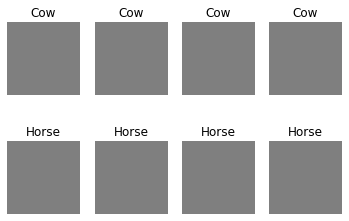

1 [D loss: 0.987460, acc.: 56.25%] [G loss: 0.718125]
2 [D loss: 1.046085, acc.: 51.56%] [G loss: 0.580374]
3 [D loss: 0.637989, acc.: 68.75%] [G loss: 0.892048]
4 [D loss: 0.657042, acc.: 68.75%] [G loss: 1.219619]
5 [D loss: 0.818641, acc.: 56.25%] [G loss: 1.057245]
6 [D loss: 0.763050, acc.: 65.62%] [G loss: 0.856896]
7 [D loss: 0.718475, acc.: 62.50%] [G loss: 1.101377]
8 [D loss: 0.598244, acc.: 73.44%] [G loss: 1.005684]
9 [D loss: 0.898973, acc.: 57.81%] [G loss: 1.487296]
10 [D loss: 0.711222, acc.: 68.75%] [G loss: 1.497180]
11 [D loss: 0.736496, acc.: 62.50%] [G loss: 2.465571]
12 [D loss: 0.729349, acc.: 60.94%] [G loss: 2.512607]
13 [D loss: 0.969817, acc.: 59.38%] [G loss: 2.544853]
14 [D loss: 0.563923, acc.: 68.75%] [G loss: 2.183757]
15 [D loss: 0.498183, acc.: 78.12%] [G loss: 2.086268]
16 [D loss: 0.604905, acc.: 71.88%] [G loss: 1.610684]
17 [D loss: 0.655264, acc.: 68.75%] [G loss: 2.355173]
18 [D loss: 0.500794, acc.: 75.00%] [G loss: 2.504711]
19 [D loss: 0.85340

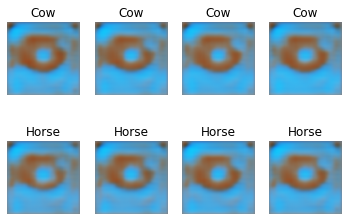

101 [D loss: 0.129616, acc.: 92.19%] [G loss: 4.640390]
102 [D loss: 0.230212, acc.: 90.62%] [G loss: 6.657994]
103 [D loss: 0.068611, acc.: 96.88%] [G loss: 6.659871]
104 [D loss: 0.110235, acc.: 95.31%] [G loss: 6.720755]
105 [D loss: 0.599794, acc.: 79.69%] [G loss: 8.601942]
106 [D loss: 0.269728, acc.: 87.50%] [G loss: 7.861484]
107 [D loss: 0.388514, acc.: 82.81%] [G loss: 4.755074]
108 [D loss: 0.189766, acc.: 90.62%] [G loss: 5.401543]
109 [D loss: 0.316710, acc.: 84.38%] [G loss: 4.802137]
110 [D loss: 0.450328, acc.: 84.38%] [G loss: 5.713905]
111 [D loss: 0.073797, acc.: 96.88%] [G loss: 5.326365]
112 [D loss: 0.298028, acc.: 85.94%] [G loss: 6.745137]
113 [D loss: 0.443619, acc.: 87.50%] [G loss: 6.315969]
114 [D loss: 0.379678, acc.: 82.81%] [G loss: 8.704873]
115 [D loss: 0.536403, acc.: 84.38%] [G loss: 6.080573]
116 [D loss: 0.357037, acc.: 84.38%] [G loss: 8.369785]
117 [D loss: 0.316234, acc.: 89.06%] [G loss: 9.858702]
118 [D loss: 0.144046, acc.: 92.19%] [G loss: 8.

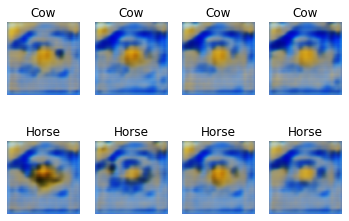

201 [D loss: 0.598079, acc.: 71.88%] [G loss: 3.301816]
202 [D loss: 0.269697, acc.: 89.06%] [G loss: 6.013098]
203 [D loss: 0.308066, acc.: 82.81%] [G loss: 6.657220]
204 [D loss: 0.289075, acc.: 85.94%] [G loss: 5.846230]
205 [D loss: 0.226128, acc.: 93.75%] [G loss: 6.285148]
206 [D loss: 0.288922, acc.: 85.94%] [G loss: 4.701620]
207 [D loss: 0.736821, acc.: 75.00%] [G loss: 6.299841]
208 [D loss: 0.362240, acc.: 85.94%] [G loss: 6.332683]
209 [D loss: 0.707852, acc.: 81.25%] [G loss: 5.093539]
210 [D loss: 0.495803, acc.: 82.81%] [G loss: 4.146419]
211 [D loss: 0.620982, acc.: 70.31%] [G loss: 6.592395]
212 [D loss: 0.347602, acc.: 84.38%] [G loss: 7.058267]
213 [D loss: 0.796127, acc.: 78.12%] [G loss: 6.421706]
214 [D loss: 0.620883, acc.: 78.12%] [G loss: 5.028343]
215 [D loss: 0.586232, acc.: 82.81%] [G loss: 5.135477]
216 [D loss: 0.396291, acc.: 82.81%] [G loss: 4.311829]
217 [D loss: 0.939357, acc.: 64.06%] [G loss: 3.553052]
218 [D loss: 0.642517, acc.: 73.44%] [G loss: 3.

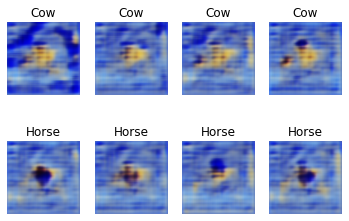

301 [D loss: 0.708296, acc.: 70.31%] [G loss: 3.085129]
302 [D loss: 0.523449, acc.: 73.44%] [G loss: 3.318275]
303 [D loss: 0.721910, acc.: 68.75%] [G loss: 3.153916]
304 [D loss: 0.360933, acc.: 81.25%] [G loss: 4.051233]
305 [D loss: 0.451570, acc.: 78.12%] [G loss: 4.244702]
306 [D loss: 0.691126, acc.: 67.19%] [G loss: 3.009507]
307 [D loss: 0.482632, acc.: 81.25%] [G loss: 4.041796]
308 [D loss: 0.449274, acc.: 81.25%] [G loss: 3.629395]
309 [D loss: 0.757744, acc.: 68.75%] [G loss: 3.547000]
310 [D loss: 0.526662, acc.: 76.56%] [G loss: 3.088642]
311 [D loss: 0.708087, acc.: 75.00%] [G loss: 3.236593]
312 [D loss: 0.675526, acc.: 73.44%] [G loss: 3.013099]
313 [D loss: 0.590795, acc.: 70.31%] [G loss: 3.202283]
314 [D loss: 0.728970, acc.: 59.38%] [G loss: 3.304201]
315 [D loss: 0.491044, acc.: 79.69%] [G loss: 3.447094]
316 [D loss: 0.751002, acc.: 70.31%] [G loss: 2.811375]
317 [D loss: 0.952216, acc.: 62.50%] [G loss: 2.700940]
318 [D loss: 0.393922, acc.: 84.38%] [G loss: 4.

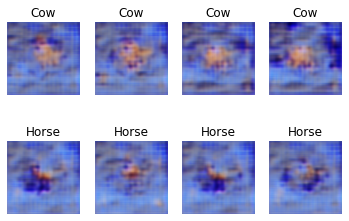

401 [D loss: 0.507286, acc.: 70.31%] [G loss: 1.932821]
402 [D loss: 0.695288, acc.: 64.06%] [G loss: 2.078433]
403 [D loss: 0.586346, acc.: 73.44%] [G loss: 2.422468]
404 [D loss: 0.774662, acc.: 67.19%] [G loss: 2.400598]
405 [D loss: 0.810345, acc.: 65.62%] [G loss: 2.225136]
406 [D loss: 0.782895, acc.: 70.31%] [G loss: 2.490177]
407 [D loss: 0.667152, acc.: 64.06%] [G loss: 2.303546]
408 [D loss: 0.845849, acc.: 60.94%] [G loss: 2.673190]
409 [D loss: 1.132407, acc.: 53.12%] [G loss: 2.507492]
410 [D loss: 0.915081, acc.: 56.25%] [G loss: 2.078866]
411 [D loss: 0.663726, acc.: 73.44%] [G loss: 2.651056]
412 [D loss: 0.755694, acc.: 57.81%] [G loss: 2.295374]
413 [D loss: 0.798908, acc.: 60.94%] [G loss: 1.997066]
414 [D loss: 0.616143, acc.: 68.75%] [G loss: 2.185507]
415 [D loss: 0.778517, acc.: 67.19%] [G loss: 2.433791]
416 [D loss: 0.854446, acc.: 59.38%] [G loss: 1.759209]
417 [D loss: 0.786745, acc.: 64.06%] [G loss: 2.753303]
418 [D loss: 0.952820, acc.: 59.38%] [G loss: 2.

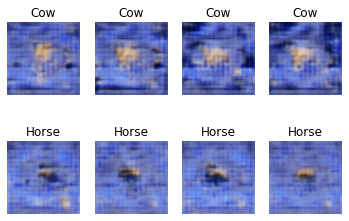

501 [D loss: 0.653733, acc.: 70.31%] [G loss: 1.945227]
502 [D loss: 0.613073, acc.: 67.19%] [G loss: 2.348409]
503 [D loss: 0.682987, acc.: 68.75%] [G loss: 2.606879]
504 [D loss: 0.751373, acc.: 62.50%] [G loss: 2.073148]
505 [D loss: 0.705594, acc.: 62.50%] [G loss: 2.030565]
506 [D loss: 0.780112, acc.: 65.62%] [G loss: 1.782428]
507 [D loss: 0.762023, acc.: 60.94%] [G loss: 2.047863]
508 [D loss: 0.896663, acc.: 50.00%] [G loss: 2.530350]
509 [D loss: 0.645731, acc.: 67.19%] [G loss: 1.721023]
510 [D loss: 0.798458, acc.: 59.38%] [G loss: 1.738724]
511 [D loss: 0.734037, acc.: 68.75%] [G loss: 1.424334]
512 [D loss: 0.813474, acc.: 60.94%] [G loss: 2.181237]
513 [D loss: 0.705529, acc.: 57.81%] [G loss: 2.292260]
514 [D loss: 0.580420, acc.: 70.31%] [G loss: 2.313612]
515 [D loss: 0.919558, acc.: 50.00%] [G loss: 1.732144]
516 [D loss: 0.651721, acc.: 62.50%] [G loss: 1.711144]
517 [D loss: 0.894545, acc.: 53.12%] [G loss: 1.893846]
518 [D loss: 0.809321, acc.: 56.25%] [G loss: 2.

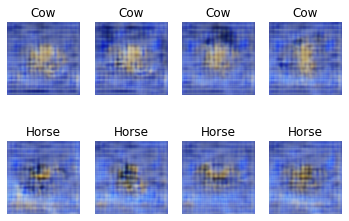

601 [D loss: 0.809603, acc.: 62.50%] [G loss: 2.143494]
602 [D loss: 0.723209, acc.: 64.06%] [G loss: 1.627505]
603 [D loss: 0.663908, acc.: 73.44%] [G loss: 1.687592]
604 [D loss: 0.589226, acc.: 71.88%] [G loss: 1.552025]
605 [D loss: 0.594584, acc.: 73.44%] [G loss: 1.805500]
606 [D loss: 0.587370, acc.: 64.06%] [G loss: 2.067347]
607 [D loss: 0.629610, acc.: 71.88%] [G loss: 1.659227]
608 [D loss: 0.808041, acc.: 62.50%] [G loss: 2.043576]
609 [D loss: 0.689711, acc.: 64.06%] [G loss: 1.560392]
610 [D loss: 0.552268, acc.: 67.19%] [G loss: 1.666341]
611 [D loss: 0.721009, acc.: 60.94%] [G loss: 2.114249]
612 [D loss: 0.662239, acc.: 68.75%] [G loss: 2.108298]
613 [D loss: 0.529924, acc.: 68.75%] [G loss: 2.301628]
614 [D loss: 0.688567, acc.: 70.31%] [G loss: 1.677255]
615 [D loss: 0.732216, acc.: 59.38%] [G loss: 1.832638]
616 [D loss: 0.690804, acc.: 60.94%] [G loss: 1.952178]
617 [D loss: 0.692293, acc.: 65.62%] [G loss: 2.179979]
618 [D loss: 0.643428, acc.: 67.19%] [G loss: 1.

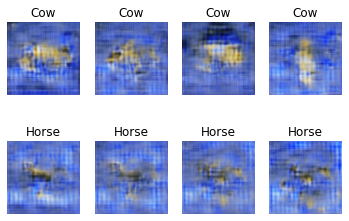

701 [D loss: 0.810453, acc.: 53.12%] [G loss: 1.264719]
702 [D loss: 0.782762, acc.: 59.38%] [G loss: 2.135075]
703 [D loss: 0.627315, acc.: 71.88%] [G loss: 1.681791]
704 [D loss: 0.827756, acc.: 59.38%] [G loss: 1.872796]
705 [D loss: 0.641392, acc.: 62.50%] [G loss: 0.946046]
706 [D loss: 0.846155, acc.: 57.81%] [G loss: 1.516738]
707 [D loss: 0.668152, acc.: 59.38%] [G loss: 2.046940]
708 [D loss: 0.478450, acc.: 84.38%] [G loss: 1.754076]
709 [D loss: 0.792655, acc.: 56.25%] [G loss: 1.805466]
710 [D loss: 0.786910, acc.: 59.38%] [G loss: 2.134445]
711 [D loss: 0.605594, acc.: 70.31%] [G loss: 1.676380]
712 [D loss: 0.565427, acc.: 65.62%] [G loss: 1.525614]
713 [D loss: 0.535113, acc.: 76.56%] [G loss: 1.762926]
714 [D loss: 0.797199, acc.: 57.81%] [G loss: 1.351900]
715 [D loss: 0.809182, acc.: 59.38%] [G loss: 1.567902]
716 [D loss: 0.653905, acc.: 67.19%] [G loss: 1.830863]
717 [D loss: 0.775806, acc.: 54.69%] [G loss: 1.600788]
718 [D loss: 0.634314, acc.: 68.75%] [G loss: 1.

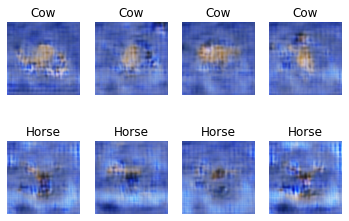

801 [D loss: 0.701888, acc.: 60.94%] [G loss: 1.303644]
802 [D loss: 0.729875, acc.: 56.25%] [G loss: 1.523849]
803 [D loss: 0.746059, acc.: 59.38%] [G loss: 1.570974]
804 [D loss: 0.822505, acc.: 53.12%] [G loss: 1.927743]
805 [D loss: 0.546894, acc.: 73.44%] [G loss: 1.185576]
806 [D loss: 0.727837, acc.: 65.62%] [G loss: 1.448652]
807 [D loss: 0.839601, acc.: 54.69%] [G loss: 1.374121]
808 [D loss: 0.486231, acc.: 75.00%] [G loss: 1.765952]
809 [D loss: 0.574753, acc.: 68.75%] [G loss: 1.442272]
810 [D loss: 0.648018, acc.: 68.75%] [G loss: 1.600815]
811 [D loss: 0.723158, acc.: 62.50%] [G loss: 1.776700]
812 [D loss: 0.517083, acc.: 79.69%] [G loss: 2.159019]
813 [D loss: 0.652074, acc.: 62.50%] [G loss: 1.627116]
814 [D loss: 0.764425, acc.: 54.69%] [G loss: 1.892392]
815 [D loss: 0.553447, acc.: 73.44%] [G loss: 2.071020]
816 [D loss: 0.522102, acc.: 68.75%] [G loss: 1.907088]
817 [D loss: 0.549849, acc.: 68.75%] [G loss: 1.858178]
818 [D loss: 0.841516, acc.: 57.81%] [G loss: 1.

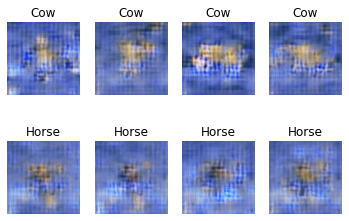

901 [D loss: 0.568411, acc.: 76.56%] [G loss: 1.241437]
902 [D loss: 0.529251, acc.: 67.19%] [G loss: 1.365890]
903 [D loss: 0.527920, acc.: 70.31%] [G loss: 1.935328]
904 [D loss: 0.551824, acc.: 78.12%] [G loss: 1.935962]
905 [D loss: 0.554606, acc.: 68.75%] [G loss: 1.082421]
906 [D loss: 0.598666, acc.: 68.75%] [G loss: 1.663833]
907 [D loss: 0.576879, acc.: 70.31%] [G loss: 2.110418]
908 [D loss: 0.889007, acc.: 48.44%] [G loss: 1.310831]
909 [D loss: 0.761534, acc.: 57.81%] [G loss: 1.786273]
910 [D loss: 0.714654, acc.: 60.94%] [G loss: 1.309765]
911 [D loss: 0.705563, acc.: 64.06%] [G loss: 1.529336]
912 [D loss: 0.475179, acc.: 75.00%] [G loss: 1.783379]
913 [D loss: 0.610753, acc.: 67.19%] [G loss: 1.513984]
914 [D loss: 0.718284, acc.: 59.38%] [G loss: 1.684097]
915 [D loss: 0.482204, acc.: 75.00%] [G loss: 1.871535]
916 [D loss: 0.579945, acc.: 73.44%] [G loss: 1.579353]
917 [D loss: 0.657381, acc.: 67.19%] [G loss: 2.215100]
918 [D loss: 0.700903, acc.: 59.38%] [G loss: 1.

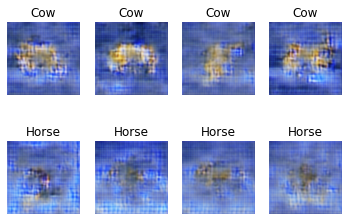

1001 [D loss: 0.733098, acc.: 60.94%] [G loss: 1.892998]
1002 [D loss: 0.498817, acc.: 76.56%] [G loss: 2.063475]
1003 [D loss: 0.610043, acc.: 75.00%] [G loss: 1.427786]
1004 [D loss: 0.427379, acc.: 81.25%] [G loss: 1.334339]
1005 [D loss: 0.491156, acc.: 76.56%] [G loss: 1.621347]
1006 [D loss: 0.464684, acc.: 76.56%] [G loss: 1.844779]
1007 [D loss: 0.612539, acc.: 70.31%] [G loss: 1.537606]
1008 [D loss: 0.639832, acc.: 65.62%] [G loss: 1.714138]
1009 [D loss: 0.674638, acc.: 67.19%] [G loss: 2.276358]
1010 [D loss: 0.470790, acc.: 85.94%] [G loss: 1.776992]
1011 [D loss: 0.641130, acc.: 67.19%] [G loss: 1.504185]
1012 [D loss: 0.580843, acc.: 67.19%] [G loss: 1.434393]
1013 [D loss: 0.713576, acc.: 59.38%] [G loss: 1.409914]
1014 [D loss: 0.453516, acc.: 79.69%] [G loss: 2.205108]
1015 [D loss: 0.579746, acc.: 75.00%] [G loss: 2.980056]
1016 [D loss: 0.488951, acc.: 75.00%] [G loss: 2.831458]
1017 [D loss: 0.786614, acc.: 59.38%] [G loss: 1.689831]
1018 [D loss: 0.622054, acc.: 6

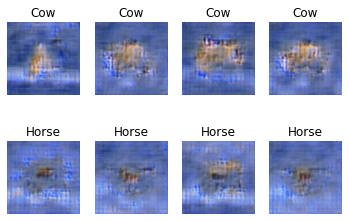

1101 [D loss: 0.676959, acc.: 62.50%] [G loss: 1.693903]
1102 [D loss: 0.531467, acc.: 68.75%] [G loss: 1.621567]
1103 [D loss: 0.501330, acc.: 75.00%] [G loss: 2.059455]
1104 [D loss: 0.641293, acc.: 62.50%] [G loss: 1.915812]
1105 [D loss: 0.488427, acc.: 81.25%] [G loss: 2.036068]
1106 [D loss: 0.483345, acc.: 71.88%] [G loss: 2.477068]
1107 [D loss: 0.521278, acc.: 73.44%] [G loss: 1.982312]
1108 [D loss: 0.657717, acc.: 67.19%] [G loss: 1.787915]
1109 [D loss: 0.633188, acc.: 64.06%] [G loss: 2.222890]
1110 [D loss: 0.481573, acc.: 76.56%] [G loss: 1.973874]
1111 [D loss: 0.728445, acc.: 64.06%] [G loss: 1.382486]
1112 [D loss: 0.745349, acc.: 57.81%] [G loss: 1.654588]
1113 [D loss: 0.569952, acc.: 65.62%] [G loss: 2.140385]
1114 [D loss: 0.526381, acc.: 75.00%] [G loss: 2.230785]
1115 [D loss: 0.491433, acc.: 76.56%] [G loss: 1.345215]
1116 [D loss: 0.831277, acc.: 54.69%] [G loss: 1.531157]
1117 [D loss: 0.597486, acc.: 76.56%] [G loss: 1.638421]
1118 [D loss: 0.643722, acc.: 6

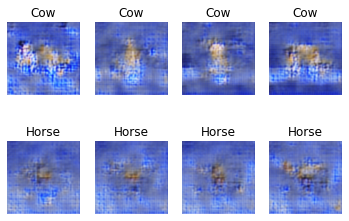

1201 [D loss: 0.532051, acc.: 73.44%] [G loss: 2.378313]
1202 [D loss: 0.605771, acc.: 71.88%] [G loss: 2.604203]
1203 [D loss: 0.516709, acc.: 73.44%] [G loss: 3.488348]
1204 [D loss: 0.324324, acc.: 85.94%] [G loss: 3.370418]
1205 [D loss: 0.652677, acc.: 64.06%] [G loss: 1.098745]
1206 [D loss: 0.466273, acc.: 78.12%] [G loss: 2.521074]
1207 [D loss: 0.657292, acc.: 70.31%] [G loss: 2.215251]
1208 [D loss: 0.379239, acc.: 81.25%] [G loss: 1.837831]
1209 [D loss: 0.529116, acc.: 75.00%] [G loss: 2.085192]
1210 [D loss: 0.587765, acc.: 75.00%] [G loss: 1.516884]
1211 [D loss: 0.643310, acc.: 68.75%] [G loss: 1.560286]
1212 [D loss: 0.500742, acc.: 71.88%] [G loss: 2.055752]
1213 [D loss: 0.552909, acc.: 78.12%] [G loss: 2.352873]
1214 [D loss: 0.642437, acc.: 65.62%] [G loss: 2.103865]
1215 [D loss: 0.428398, acc.: 81.25%] [G loss: 1.772610]
1216 [D loss: 0.710761, acc.: 64.06%] [G loss: 2.175785]
1217 [D loss: 0.547655, acc.: 70.31%] [G loss: 1.991788]
1218 [D loss: 0.399061, acc.: 8

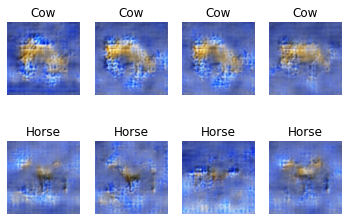

1301 [D loss: 0.583027, acc.: 65.62%] [G loss: 2.019264]
1302 [D loss: 0.588334, acc.: 75.00%] [G loss: 1.837839]
1303 [D loss: 0.666244, acc.: 62.50%] [G loss: 2.087049]
1304 [D loss: 0.544906, acc.: 68.75%] [G loss: 2.105824]
1305 [D loss: 0.449903, acc.: 76.56%] [G loss: 1.816665]
1306 [D loss: 0.597283, acc.: 73.44%] [G loss: 2.340645]
1307 [D loss: 0.390753, acc.: 78.12%] [G loss: 2.565896]
1308 [D loss: 0.619202, acc.: 73.44%] [G loss: 2.263890]
1309 [D loss: 0.515248, acc.: 75.00%] [G loss: 1.899377]
1310 [D loss: 0.526913, acc.: 73.44%] [G loss: 2.158730]
1311 [D loss: 0.747843, acc.: 70.31%] [G loss: 2.041453]
1312 [D loss: 0.518528, acc.: 78.12%] [G loss: 1.813569]
1313 [D loss: 0.424864, acc.: 75.00%] [G loss: 2.444290]
1314 [D loss: 0.541045, acc.: 67.19%] [G loss: 2.132235]
1315 [D loss: 0.412532, acc.: 79.69%] [G loss: 2.106790]
1316 [D loss: 0.486534, acc.: 76.56%] [G loss: 1.841734]
1317 [D loss: 0.569146, acc.: 73.44%] [G loss: 2.019408]
1318 [D loss: 0.327891, acc.: 9

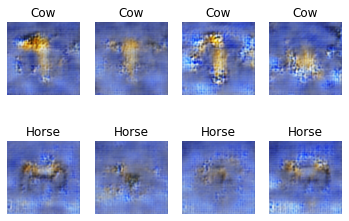

1401 [D loss: 0.553348, acc.: 71.88%] [G loss: 1.972792]
1402 [D loss: 0.582156, acc.: 71.88%] [G loss: 2.210141]
1403 [D loss: 0.555220, acc.: 67.19%] [G loss: 2.609685]
1404 [D loss: 0.513251, acc.: 71.88%] [G loss: 2.766183]
1405 [D loss: 0.544798, acc.: 67.19%] [G loss: 1.787167]
1406 [D loss: 0.472994, acc.: 75.00%] [G loss: 2.576340]
1407 [D loss: 0.353661, acc.: 81.25%] [G loss: 5.224107]
1408 [D loss: 0.444177, acc.: 79.69%] [G loss: 1.682923]
1409 [D loss: 0.393351, acc.: 85.94%] [G loss: 2.400495]
1410 [D loss: 0.518561, acc.: 75.00%] [G loss: 2.620313]
1411 [D loss: 0.378770, acc.: 78.12%] [G loss: 2.390821]
1412 [D loss: 0.506787, acc.: 75.00%] [G loss: 1.872102]
1413 [D loss: 0.564108, acc.: 68.75%] [G loss: 2.339546]
1414 [D loss: 0.661609, acc.: 64.06%] [G loss: 2.103332]
1415 [D loss: 0.363374, acc.: 85.94%] [G loss: 1.932344]
1416 [D loss: 0.470982, acc.: 79.69%] [G loss: 2.848598]
1417 [D loss: 0.552902, acc.: 70.31%] [G loss: 1.510822]
1418 [D loss: 0.685539, acc.: 5

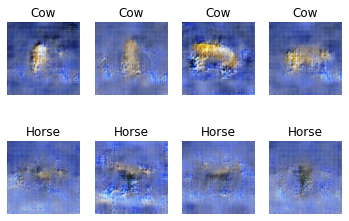

1501 [D loss: 0.662217, acc.: 64.06%] [G loss: 2.119662]
1502 [D loss: 0.548006, acc.: 73.44%] [G loss: 2.127880]
1503 [D loss: 0.628363, acc.: 65.62%] [G loss: 2.054909]
1504 [D loss: 0.434889, acc.: 79.69%] [G loss: 1.968299]
1505 [D loss: 0.427273, acc.: 76.56%] [G loss: 2.345018]
1506 [D loss: 0.347282, acc.: 87.50%] [G loss: 2.378778]
1507 [D loss: 0.331050, acc.: 87.50%] [G loss: 3.336156]
1508 [D loss: 0.524897, acc.: 81.25%] [G loss: 2.736701]
1509 [D loss: 0.600835, acc.: 64.06%] [G loss: 1.966071]
1510 [D loss: 0.582306, acc.: 70.31%] [G loss: 2.681024]
1511 [D loss: 0.544347, acc.: 70.31%] [G loss: 2.260538]
1512 [D loss: 0.501678, acc.: 78.12%] [G loss: 1.811244]
1513 [D loss: 0.635408, acc.: 62.50%] [G loss: 2.886168]
1514 [D loss: 0.640000, acc.: 68.75%] [G loss: 2.572134]
1515 [D loss: 0.509972, acc.: 79.69%] [G loss: 2.111521]
1516 [D loss: 0.381881, acc.: 85.94%] [G loss: 1.741662]
1517 [D loss: 0.520825, acc.: 68.75%] [G loss: 1.789109]
1518 [D loss: 0.458580, acc.: 7

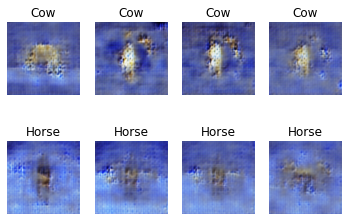

1601 [D loss: 0.344018, acc.: 85.94%] [G loss: 2.876413]
1602 [D loss: 0.471036, acc.: 82.81%] [G loss: 2.489231]
1603 [D loss: 0.505466, acc.: 75.00%] [G loss: 2.711837]
1604 [D loss: 0.584144, acc.: 68.75%] [G loss: 3.085567]
1605 [D loss: 0.434170, acc.: 82.81%] [G loss: 3.590196]
1606 [D loss: 0.390133, acc.: 85.94%] [G loss: 2.509157]
1607 [D loss: 0.482153, acc.: 75.00%] [G loss: 2.030673]
1608 [D loss: 0.431690, acc.: 78.12%] [G loss: 3.341095]
1609 [D loss: 0.323348, acc.: 82.81%] [G loss: 4.490418]
1610 [D loss: 0.466383, acc.: 78.12%] [G loss: 3.411231]
1611 [D loss: 0.353239, acc.: 81.25%] [G loss: 2.261088]
1612 [D loss: 0.408935, acc.: 78.12%] [G loss: 2.407314]
1613 [D loss: 0.482784, acc.: 73.44%] [G loss: 2.632697]
1614 [D loss: 0.464412, acc.: 78.12%] [G loss: 3.033447]
1615 [D loss: 0.456076, acc.: 78.12%] [G loss: 2.113969]
1616 [D loss: 0.324920, acc.: 84.38%] [G loss: 2.242337]
1617 [D loss: 0.421011, acc.: 79.69%] [G loss: 1.989886]
1618 [D loss: 0.653843, acc.: 6

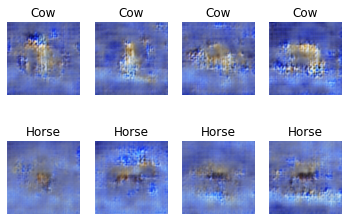

1701 [D loss: 0.468727, acc.: 79.69%] [G loss: 2.514705]
1702 [D loss: 0.493362, acc.: 75.00%] [G loss: 2.562470]
1703 [D loss: 0.370272, acc.: 84.38%] [G loss: 2.425083]
1704 [D loss: 0.324239, acc.: 87.50%] [G loss: 2.534745]
1705 [D loss: 0.313029, acc.: 85.94%] [G loss: 2.387656]
1706 [D loss: 0.211066, acc.: 92.19%] [G loss: 3.398176]
1707 [D loss: 0.331966, acc.: 87.50%] [G loss: 3.335386]
1708 [D loss: 0.498637, acc.: 75.00%] [G loss: 1.557983]
1709 [D loss: 0.296919, acc.: 85.94%] [G loss: 3.933068]
1710 [D loss: 0.316149, acc.: 82.81%] [G loss: 5.208035]
1711 [D loss: 0.280195, acc.: 89.06%] [G loss: 3.417638]
1712 [D loss: 0.518570, acc.: 75.00%] [G loss: 2.756434]
1713 [D loss: 0.344484, acc.: 85.94%] [G loss: 5.129072]
1714 [D loss: 0.495467, acc.: 76.56%] [G loss: 2.978081]
1715 [D loss: 0.238795, acc.: 87.50%] [G loss: 3.419518]
1716 [D loss: 0.310478, acc.: 82.81%] [G loss: 3.467340]
1717 [D loss: 0.648376, acc.: 78.12%] [G loss: 2.613649]
1718 [D loss: 0.538832, acc.: 7

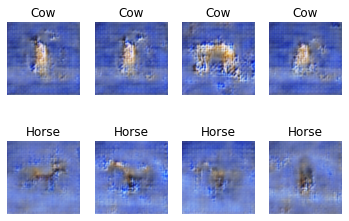

1801 [D loss: 0.361111, acc.: 85.94%] [G loss: 2.754069]
1802 [D loss: 0.324579, acc.: 85.94%] [G loss: 3.341102]
1803 [D loss: 0.424308, acc.: 82.81%] [G loss: 2.466419]
1804 [D loss: 0.316666, acc.: 87.50%] [G loss: 2.307598]
1805 [D loss: 0.346909, acc.: 79.69%] [G loss: 3.339597]
1806 [D loss: 0.309993, acc.: 85.94%] [G loss: 3.486806]
1807 [D loss: 0.499485, acc.: 82.81%] [G loss: 3.468250]
1808 [D loss: 0.439772, acc.: 78.12%] [G loss: 3.037329]
1809 [D loss: 0.473616, acc.: 78.12%] [G loss: 2.505929]
1810 [D loss: 0.459192, acc.: 75.00%] [G loss: 3.156904]
1811 [D loss: 0.358002, acc.: 84.38%] [G loss: 3.724930]
1812 [D loss: 0.318100, acc.: 85.94%] [G loss: 4.368111]
1813 [D loss: 0.470136, acc.: 76.56%] [G loss: 3.047719]
1814 [D loss: 0.365820, acc.: 78.12%] [G loss: 3.844688]
1815 [D loss: 0.301557, acc.: 82.81%] [G loss: 2.836727]
1816 [D loss: 0.256758, acc.: 87.50%] [G loss: 4.576479]
1817 [D loss: 0.243610, acc.: 87.50%] [G loss: 4.967309]
1818 [D loss: 0.407444, acc.: 8

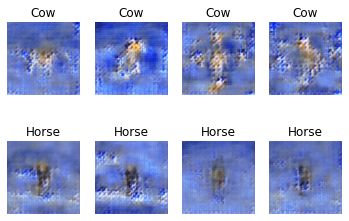

1901 [D loss: 0.450172, acc.: 78.12%] [G loss: 3.805715]
1902 [D loss: 0.335899, acc.: 85.94%] [G loss: 3.892294]
1903 [D loss: 0.599559, acc.: 71.88%] [G loss: 3.415385]
1904 [D loss: 0.424048, acc.: 78.12%] [G loss: 2.931746]
1905 [D loss: 0.201421, acc.: 92.19%] [G loss: 4.442556]
1906 [D loss: 0.581515, acc.: 65.62%] [G loss: 2.638159]
1907 [D loss: 0.229829, acc.: 93.75%] [G loss: 4.075348]
1908 [D loss: 0.419056, acc.: 78.12%] [G loss: 3.620020]
1909 [D loss: 0.323434, acc.: 81.25%] [G loss: 2.666722]
1910 [D loss: 0.309790, acc.: 87.50%] [G loss: 2.610546]
1911 [D loss: 0.337549, acc.: 82.81%] [G loss: 2.967387]
1912 [D loss: 0.449963, acc.: 79.69%] [G loss: 3.651025]
1913 [D loss: 0.213584, acc.: 92.19%] [G loss: 4.420083]
1914 [D loss: 0.472625, acc.: 76.56%] [G loss: 2.970227]
1915 [D loss: 0.391712, acc.: 81.25%] [G loss: 3.232804]
1916 [D loss: 0.342278, acc.: 84.38%] [G loss: 6.115102]
1917 [D loss: 0.171020, acc.: 95.31%] [G loss: 3.998115]
1918 [D loss: 0.543579, acc.: 7

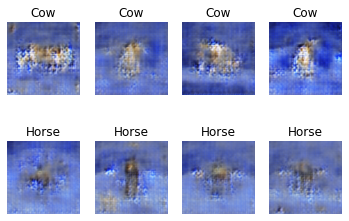

2001 [D loss: 0.232523, acc.: 92.19%] [G loss: 3.827119]
2002 [D loss: 0.352054, acc.: 85.94%] [G loss: 3.683510]
2003 [D loss: 0.429022, acc.: 81.25%] [G loss: 2.775370]
2004 [D loss: 0.394032, acc.: 79.69%] [G loss: 3.319779]
2005 [D loss: 0.377467, acc.: 81.25%] [G loss: 4.539234]
2006 [D loss: 0.298216, acc.: 90.62%] [G loss: 5.647269]
2007 [D loss: 0.496263, acc.: 79.69%] [G loss: 2.802411]
2008 [D loss: 0.468613, acc.: 81.25%] [G loss: 3.751204]
2009 [D loss: 0.325410, acc.: 84.38%] [G loss: 4.412745]
2010 [D loss: 0.224205, acc.: 87.50%] [G loss: 4.198085]
2011 [D loss: 0.278202, acc.: 89.06%] [G loss: 2.653768]
2012 [D loss: 0.305926, acc.: 89.06%] [G loss: 2.585182]
2013 [D loss: 0.375943, acc.: 78.12%] [G loss: 3.498044]
2014 [D loss: 0.432897, acc.: 76.56%] [G loss: 4.198699]
2015 [D loss: 0.279619, acc.: 85.94%] [G loss: 4.565023]
2016 [D loss: 0.401961, acc.: 79.69%] [G loss: 3.340187]
2017 [D loss: 0.331860, acc.: 87.50%] [G loss: 3.910193]
2018 [D loss: 0.356676, acc.: 8

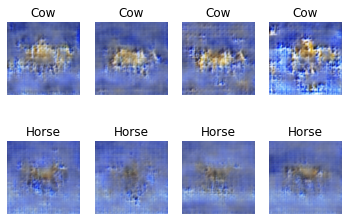

2101 [D loss: 0.273598, acc.: 92.19%] [G loss: 3.172079]
2102 [D loss: 0.342356, acc.: 79.69%] [G loss: 4.323714]
2103 [D loss: 0.394327, acc.: 84.38%] [G loss: 3.587073]
2104 [D loss: 0.475114, acc.: 73.44%] [G loss: 3.135490]
2105 [D loss: 0.321595, acc.: 89.06%] [G loss: 4.346401]
2106 [D loss: 0.318441, acc.: 87.50%] [G loss: 3.350045]
2107 [D loss: 0.540964, acc.: 75.00%] [G loss: 2.607714]
2108 [D loss: 0.206324, acc.: 93.75%] [G loss: 3.386542]
2109 [D loss: 0.338725, acc.: 85.94%] [G loss: 3.228109]
2110 [D loss: 0.395121, acc.: 79.69%] [G loss: 4.532101]
2111 [D loss: 0.185552, acc.: 90.62%] [G loss: 4.659038]
2112 [D loss: 0.269652, acc.: 87.50%] [G loss: 2.787208]
2113 [D loss: 0.286250, acc.: 90.62%] [G loss: 4.434559]
2114 [D loss: 0.268026, acc.: 85.94%] [G loss: 2.140924]
2115 [D loss: 0.329995, acc.: 85.94%] [G loss: 4.419359]
2116 [D loss: 0.344288, acc.: 87.50%] [G loss: 3.841117]
2117 [D loss: 0.447605, acc.: 79.69%] [G loss: 3.006443]
2118 [D loss: 0.396734, acc.: 8

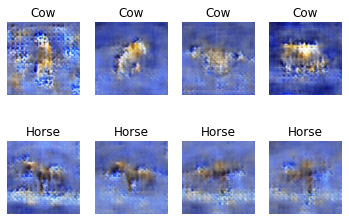

2201 [D loss: 0.431511, acc.: 81.25%] [G loss: 3.396934]
2202 [D loss: 0.361406, acc.: 81.25%] [G loss: 3.464849]
2203 [D loss: 0.276247, acc.: 82.81%] [G loss: 4.821737]
2204 [D loss: 0.254222, acc.: 89.06%] [G loss: 4.365204]
2205 [D loss: 0.356001, acc.: 82.81%] [G loss: 3.051657]
2206 [D loss: 0.207329, acc.: 95.31%] [G loss: 4.226039]
2207 [D loss: 0.311312, acc.: 85.94%] [G loss: 4.330440]
2208 [D loss: 0.304099, acc.: 89.06%] [G loss: 4.507165]
2209 [D loss: 0.269286, acc.: 89.06%] [G loss: 3.467368]
2210 [D loss: 0.480034, acc.: 81.25%] [G loss: 4.040480]
2211 [D loss: 0.280927, acc.: 87.50%] [G loss: 4.803267]
2212 [D loss: 0.229163, acc.: 89.06%] [G loss: 7.283283]
2213 [D loss: 0.419177, acc.: 82.81%] [G loss: 2.546965]
2214 [D loss: 0.179607, acc.: 93.75%] [G loss: 4.211545]
2215 [D loss: 0.265342, acc.: 92.19%] [G loss: 5.125710]
2216 [D loss: 0.314095, acc.: 85.94%] [G loss: 3.408372]
2217 [D loss: 0.404961, acc.: 79.69%] [G loss: 4.016388]
2218 [D loss: 0.342196, acc.: 8

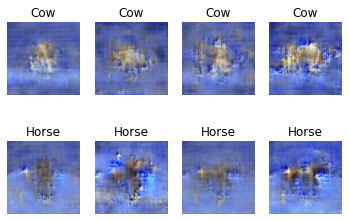

2301 [D loss: 0.225810, acc.: 95.31%] [G loss: 3.631569]
2302 [D loss: 0.289038, acc.: 89.06%] [G loss: 5.050344]
2303 [D loss: 0.220036, acc.: 92.19%] [G loss: 5.269864]
2304 [D loss: 0.335076, acc.: 87.50%] [G loss: 5.978676]
2305 [D loss: 0.265359, acc.: 90.62%] [G loss: 4.054011]
2306 [D loss: 0.332967, acc.: 82.81%] [G loss: 3.150857]
2307 [D loss: 0.303087, acc.: 87.50%] [G loss: 3.856796]
2308 [D loss: 0.343424, acc.: 85.94%] [G loss: 3.813371]
2309 [D loss: 0.240922, acc.: 90.62%] [G loss: 4.441653]
2310 [D loss: 0.368525, acc.: 82.81%] [G loss: 3.407637]
2311 [D loss: 0.284765, acc.: 89.06%] [G loss: 2.760447]
2312 [D loss: 0.354466, acc.: 81.25%] [G loss: 3.412224]
2313 [D loss: 0.491107, acc.: 84.38%] [G loss: 4.091060]
2314 [D loss: 0.291884, acc.: 82.81%] [G loss: 3.018272]
2315 [D loss: 0.301075, acc.: 84.38%] [G loss: 4.797137]
2316 [D loss: 0.213639, acc.: 90.62%] [G loss: 4.856355]
2317 [D loss: 0.396047, acc.: 81.25%] [G loss: 4.636157]
2318 [D loss: 0.206448, acc.: 9

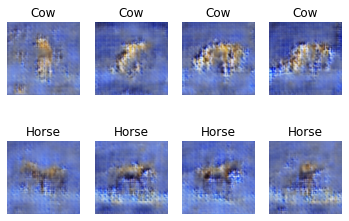

2401 [D loss: 0.244480, acc.: 89.06%] [G loss: 6.026564]
2402 [D loss: 0.306356, acc.: 89.06%] [G loss: 3.093406]
2403 [D loss: 0.223155, acc.: 92.19%] [G loss: 5.084839]
2404 [D loss: 0.230297, acc.: 89.06%] [G loss: 5.671465]
2405 [D loss: 0.267970, acc.: 90.62%] [G loss: 3.558452]
2406 [D loss: 0.246397, acc.: 84.38%] [G loss: 4.158792]
2407 [D loss: 0.277935, acc.: 85.94%] [G loss: 5.177199]
2408 [D loss: 0.277415, acc.: 87.50%] [G loss: 3.314967]
2409 [D loss: 0.404125, acc.: 79.69%] [G loss: 4.471153]
2410 [D loss: 0.452987, acc.: 81.25%] [G loss: 4.591528]
2411 [D loss: 0.284470, acc.: 82.81%] [G loss: 4.033361]
2412 [D loss: 0.224572, acc.: 85.94%] [G loss: 3.271713]
2413 [D loss: 0.311022, acc.: 87.50%] [G loss: 3.846829]
2414 [D loss: 0.098469, acc.: 98.44%] [G loss: 4.292803]
2415 [D loss: 0.284860, acc.: 87.50%] [G loss: 3.964374]
2416 [D loss: 0.331608, acc.: 82.81%] [G loss: 5.427814]
2417 [D loss: 0.122805, acc.: 98.44%] [G loss: 4.296733]
2418 [D loss: 0.323292, acc.: 8

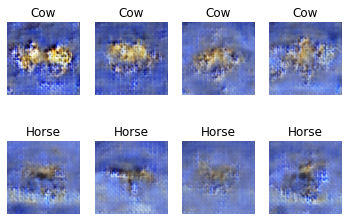

2501 [D loss: 0.329967, acc.: 85.94%] [G loss: 4.829202]
2502 [D loss: 0.245226, acc.: 87.50%] [G loss: 4.636464]
2503 [D loss: 0.108523, acc.: 98.44%] [G loss: 6.114832]
2504 [D loss: 0.167337, acc.: 92.19%] [G loss: 5.809325]
2505 [D loss: 0.204484, acc.: 92.19%] [G loss: 4.701694]
2506 [D loss: 0.265717, acc.: 90.62%] [G loss: 5.312283]
2507 [D loss: 0.237343, acc.: 92.19%] [G loss: 4.052968]
2508 [D loss: 0.349806, acc.: 78.12%] [G loss: 5.166366]
2509 [D loss: 0.275946, acc.: 87.50%] [G loss: 5.903137]
2510 [D loss: 0.375619, acc.: 84.38%] [G loss: 6.547691]
2511 [D loss: 0.637055, acc.: 76.56%] [G loss: 3.862198]
2512 [D loss: 0.178488, acc.: 92.19%] [G loss: 6.072172]
2513 [D loss: 0.109361, acc.: 95.31%] [G loss: 6.600391]
2514 [D loss: 0.296993, acc.: 84.38%] [G loss: 4.787405]
2515 [D loss: 0.293572, acc.: 87.50%] [G loss: 3.584440]
2516 [D loss: 0.236081, acc.: 89.06%] [G loss: 4.070062]
2517 [D loss: 0.165234, acc.: 90.62%] [G loss: 4.989100]
2518 [D loss: 0.306803, acc.: 8

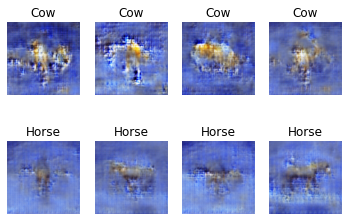

2601 [D loss: 0.343831, acc.: 81.25%] [G loss: 5.447807]
2602 [D loss: 0.467618, acc.: 78.12%] [G loss: 5.389499]
2603 [D loss: 0.271577, acc.: 85.94%] [G loss: 5.678135]
2604 [D loss: 0.311572, acc.: 89.06%] [G loss: 5.706028]
2605 [D loss: 0.203065, acc.: 95.31%] [G loss: 5.223711]
2606 [D loss: 0.372149, acc.: 87.50%] [G loss: 4.212482]
2607 [D loss: 0.224538, acc.: 92.19%] [G loss: 3.737779]
2608 [D loss: 0.411176, acc.: 79.69%] [G loss: 3.975025]
2609 [D loss: 0.337470, acc.: 81.25%] [G loss: 3.875847]
2610 [D loss: 0.424908, acc.: 82.81%] [G loss: 4.629773]
2611 [D loss: 0.308687, acc.: 87.50%] [G loss: 5.446331]
2612 [D loss: 0.507374, acc.: 75.00%] [G loss: 3.985729]
2613 [D loss: 0.303652, acc.: 84.38%] [G loss: 3.966489]
2614 [D loss: 0.295418, acc.: 81.25%] [G loss: 4.923127]
2615 [D loss: 0.201875, acc.: 90.62%] [G loss: 4.662273]
2616 [D loss: 0.220994, acc.: 92.19%] [G loss: 4.633983]
2617 [D loss: 0.104396, acc.: 96.88%] [G loss: 5.609078]
2618 [D loss: 0.226552, acc.: 9

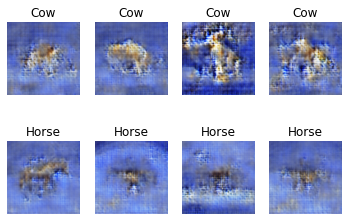

2701 [D loss: 0.141024, acc.: 95.31%] [G loss: 4.672835]
2702 [D loss: 0.266153, acc.: 92.19%] [G loss: 6.181138]
2703 [D loss: 0.260840, acc.: 87.50%] [G loss: 5.712555]
2704 [D loss: 0.366964, acc.: 87.50%] [G loss: 5.280306]
2705 [D loss: 0.315779, acc.: 85.94%] [G loss: 4.840780]
2706 [D loss: 0.348293, acc.: 84.38%] [G loss: 4.367093]
2707 [D loss: 0.284983, acc.: 85.94%] [G loss: 3.684327]
2708 [D loss: 0.211219, acc.: 96.88%] [G loss: 5.031026]
2709 [D loss: 0.235691, acc.: 90.62%] [G loss: 5.711953]
2710 [D loss: 0.198146, acc.: 89.06%] [G loss: 3.287078]
2711 [D loss: 0.185588, acc.: 92.19%] [G loss: 3.668959]
2712 [D loss: 0.435328, acc.: 84.38%] [G loss: 3.926951]
2713 [D loss: 0.222931, acc.: 85.94%] [G loss: 5.221294]
2714 [D loss: 0.139614, acc.: 95.31%] [G loss: 4.299663]
2715 [D loss: 0.218977, acc.: 92.19%] [G loss: 5.358648]
2716 [D loss: 0.199768, acc.: 90.62%] [G loss: 4.429491]
2717 [D loss: 0.341687, acc.: 89.06%] [G loss: 4.252219]
2718 [D loss: 0.290117, acc.: 8

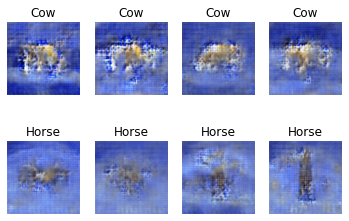

2801 [D loss: 0.131997, acc.: 93.75%] [G loss: 6.955511]
2802 [D loss: 0.386869, acc.: 82.81%] [G loss: 4.523136]
2803 [D loss: 0.116379, acc.: 96.88%] [G loss: 5.662279]
2804 [D loss: 0.413675, acc.: 84.38%] [G loss: 5.603391]
2805 [D loss: 0.267836, acc.: 87.50%] [G loss: 4.087075]
2806 [D loss: 0.250696, acc.: 92.19%] [G loss: 8.704857]
2807 [D loss: 0.298691, acc.: 87.50%] [G loss: 4.200771]
2808 [D loss: 0.133545, acc.: 93.75%] [G loss: 5.246192]
2809 [D loss: 0.260464, acc.: 92.19%] [G loss: 4.902236]
2810 [D loss: 0.286494, acc.: 89.06%] [G loss: 4.428467]
2811 [D loss: 0.304820, acc.: 89.06%] [G loss: 4.869051]
2812 [D loss: 0.350339, acc.: 85.94%] [G loss: 4.797613]
2813 [D loss: 0.154291, acc.: 93.75%] [G loss: 5.063674]
2814 [D loss: 0.274177, acc.: 89.06%] [G loss: 5.367235]
2815 [D loss: 0.141108, acc.: 92.19%] [G loss: 5.470262]
2816 [D loss: 0.434977, acc.: 79.69%] [G loss: 4.462441]
2817 [D loss: 0.293884, acc.: 89.06%] [G loss: 5.080677]
2818 [D loss: 0.151089, acc.: 9

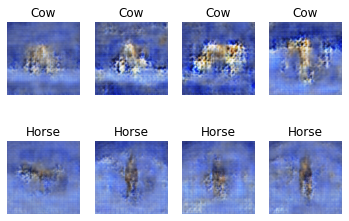

2901 [D loss: 0.140966, acc.: 98.44%] [G loss: 5.417777]
2902 [D loss: 0.159207, acc.: 96.88%] [G loss: 5.654449]
2903 [D loss: 0.365125, acc.: 84.38%] [G loss: 4.824893]
2904 [D loss: 0.099587, acc.: 98.44%] [G loss: 5.410689]
2905 [D loss: 0.327947, acc.: 85.94%] [G loss: 4.402735]
2906 [D loss: 0.142275, acc.: 95.31%] [G loss: 4.723493]
2907 [D loss: 0.217196, acc.: 85.94%] [G loss: 3.929564]
2908 [D loss: 0.366543, acc.: 85.94%] [G loss: 5.290123]
2909 [D loss: 0.261522, acc.: 92.19%] [G loss: 6.034897]
2910 [D loss: 0.146574, acc.: 96.88%] [G loss: 6.150311]
2911 [D loss: 0.146570, acc.: 95.31%] [G loss: 7.181157]
2912 [D loss: 0.249741, acc.: 92.19%] [G loss: 3.892649]
2913 [D loss: 0.178893, acc.: 92.19%] [G loss: 5.188269]
2914 [D loss: 0.174596, acc.: 95.31%] [G loss: 6.424562]
2915 [D loss: 0.334364, acc.: 89.06%] [G loss: 6.676626]
2916 [D loss: 0.282028, acc.: 89.06%] [G loss: 4.720950]
2917 [D loss: 0.159804, acc.: 93.75%] [G loss: 6.428498]
2918 [D loss: 0.117973, acc.: 9

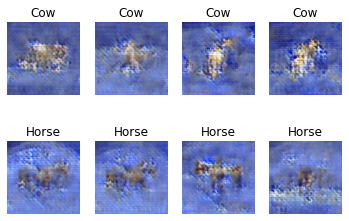

3001 [D loss: 0.099530, acc.: 98.44%] [G loss: 5.843493]
3002 [D loss: 0.284470, acc.: 85.94%] [G loss: 4.868113]
3003 [D loss: 0.196745, acc.: 92.19%] [G loss: 5.138718]
3004 [D loss: 0.224092, acc.: 90.62%] [G loss: 4.883834]
3005 [D loss: 0.263249, acc.: 90.62%] [G loss: 4.492960]
3006 [D loss: 0.316949, acc.: 84.38%] [G loss: 5.472468]
3007 [D loss: 0.186625, acc.: 93.75%] [G loss: 6.132230]
3008 [D loss: 0.252347, acc.: 90.62%] [G loss: 5.293755]
3009 [D loss: 0.185610, acc.: 92.19%] [G loss: 5.771606]
3010 [D loss: 0.303461, acc.: 90.62%] [G loss: 5.110528]
3011 [D loss: 0.093642, acc.: 95.31%] [G loss: 6.444777]
3012 [D loss: 0.287374, acc.: 90.62%] [G loss: 4.376915]
3013 [D loss: 0.437208, acc.: 81.25%] [G loss: 4.864609]
3014 [D loss: 0.217096, acc.: 89.06%] [G loss: 3.870828]
3015 [D loss: 0.220303, acc.: 92.19%] [G loss: 4.726221]
3016 [D loss: 0.291488, acc.: 92.19%] [G loss: 6.164602]
3017 [D loss: 0.220792, acc.: 90.62%] [G loss: 4.860852]
3018 [D loss: 0.254746, acc.: 8

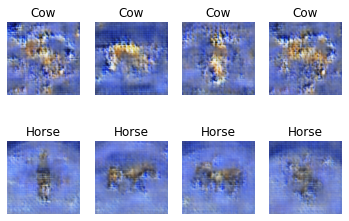

3101 [D loss: 0.318609, acc.: 85.94%] [G loss: 5.267452]
3102 [D loss: 0.279614, acc.: 89.06%] [G loss: 4.586885]
3103 [D loss: 0.319238, acc.: 87.50%] [G loss: 4.948561]
3104 [D loss: 0.134030, acc.: 95.31%] [G loss: 5.309195]
3105 [D loss: 0.164913, acc.: 93.75%] [G loss: 5.955081]
3106 [D loss: 0.504291, acc.: 75.00%] [G loss: 5.347374]
3107 [D loss: 0.171458, acc.: 93.75%] [G loss: 7.251703]
3108 [D loss: 0.329566, acc.: 85.94%] [G loss: 5.391318]
3109 [D loss: 0.228206, acc.: 89.06%] [G loss: 4.814218]
3110 [D loss: 0.152993, acc.: 95.31%] [G loss: 6.758192]
3111 [D loss: 0.147168, acc.: 95.31%] [G loss: 6.407628]
3112 [D loss: 0.129811, acc.: 96.88%] [G loss: 5.472404]
3113 [D loss: 0.156704, acc.: 95.31%] [G loss: 5.274833]
3114 [D loss: 0.192136, acc.: 92.19%] [G loss: 4.669785]
3115 [D loss: 0.299505, acc.: 90.62%] [G loss: 5.981102]
3116 [D loss: 0.261902, acc.: 89.06%] [G loss: 7.445541]
3117 [D loss: 0.315139, acc.: 85.94%] [G loss: 4.984860]
3118 [D loss: 0.081542, acc.: 9

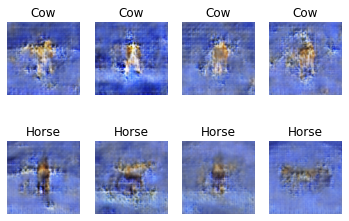

3201 [D loss: 0.067730, acc.: 100.00%] [G loss: 6.074263]
3202 [D loss: 0.174237, acc.: 92.19%] [G loss: 5.169847]
3203 [D loss: 0.372590, acc.: 82.81%] [G loss: 5.957271]
3204 [D loss: 0.080738, acc.: 98.44%] [G loss: 8.034145]
3205 [D loss: 0.232245, acc.: 90.62%] [G loss: 5.976495]
3206 [D loss: 0.129466, acc.: 95.31%] [G loss: 5.121196]
3207 [D loss: 0.196307, acc.: 89.06%] [G loss: 5.005731]
3208 [D loss: 0.200717, acc.: 92.19%] [G loss: 5.879056]
3209 [D loss: 0.096799, acc.: 98.44%] [G loss: 6.466141]
3210 [D loss: 0.216088, acc.: 92.19%] [G loss: 4.366287]
3211 [D loss: 0.211436, acc.: 87.50%] [G loss: 5.387909]
3212 [D loss: 0.276465, acc.: 89.06%] [G loss: 4.324206]
3213 [D loss: 0.120177, acc.: 95.31%] [G loss: 4.518218]
3214 [D loss: 0.138349, acc.: 93.75%] [G loss: 5.751348]
3215 [D loss: 0.354624, acc.: 82.81%] [G loss: 5.599003]
3216 [D loss: 0.160326, acc.: 96.88%] [G loss: 5.413397]
3217 [D loss: 0.132306, acc.: 96.88%] [G loss: 6.752332]
3218 [D loss: 0.118215, acc.: 

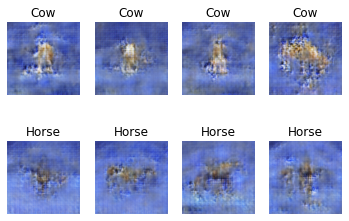

3301 [D loss: 0.090930, acc.: 98.44%] [G loss: 5.538717]
3302 [D loss: 0.066527, acc.: 98.44%] [G loss: 5.291858]
3303 [D loss: 0.222581, acc.: 90.62%] [G loss: 4.869942]
3304 [D loss: 0.092768, acc.: 96.88%] [G loss: 4.974221]
3305 [D loss: 0.184657, acc.: 90.62%] [G loss: 6.250957]
3306 [D loss: 0.160811, acc.: 93.75%] [G loss: 5.367997]
3307 [D loss: 0.218750, acc.: 85.94%] [G loss: 5.229119]
3308 [D loss: 0.149183, acc.: 95.31%] [G loss: 7.607034]
3309 [D loss: 0.216973, acc.: 87.50%] [G loss: 6.160209]
3310 [D loss: 0.280917, acc.: 85.94%] [G loss: 4.409701]
3311 [D loss: 0.181287, acc.: 95.31%] [G loss: 5.529399]
3312 [D loss: 0.186941, acc.: 95.31%] [G loss: 6.732414]
3313 [D loss: 0.220928, acc.: 89.06%] [G loss: 6.524690]
3314 [D loss: 0.121583, acc.: 95.31%] [G loss: 4.838975]
3315 [D loss: 0.147879, acc.: 92.19%] [G loss: 4.643512]
3316 [D loss: 0.108500, acc.: 95.31%] [G loss: 5.007463]
3317 [D loss: 0.240731, acc.: 89.06%] [G loss: 5.046616]
3318 [D loss: 0.080363, acc.: 9

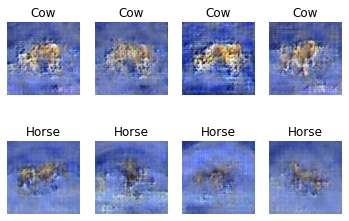

3401 [D loss: 0.096328, acc.: 95.31%] [G loss: 5.931747]
3402 [D loss: 0.129629, acc.: 95.31%] [G loss: 5.711106]
3403 [D loss: 0.159349, acc.: 93.75%] [G loss: 4.301829]
3404 [D loss: 0.229060, acc.: 89.06%] [G loss: 4.928318]
3405 [D loss: 0.165245, acc.: 92.19%] [G loss: 5.964354]
3406 [D loss: 0.264458, acc.: 87.50%] [G loss: 6.323448]
3407 [D loss: 0.263572, acc.: 85.94%] [G loss: 4.479294]
3408 [D loss: 0.176158, acc.: 92.19%] [G loss: 5.879616]
3409 [D loss: 0.203852, acc.: 92.19%] [G loss: 6.445890]
3410 [D loss: 0.188312, acc.: 90.62%] [G loss: 6.384383]
3411 [D loss: 0.219272, acc.: 90.62%] [G loss: 7.698023]
3412 [D loss: 0.123960, acc.: 95.31%] [G loss: 6.869293]
3413 [D loss: 0.131071, acc.: 96.88%] [G loss: 6.121751]
3414 [D loss: 0.178837, acc.: 93.75%] [G loss: 4.832056]
3415 [D loss: 0.109722, acc.: 95.31%] [G loss: 7.322896]
3416 [D loss: 0.086425, acc.: 95.31%] [G loss: 8.597110]
3417 [D loss: 0.141758, acc.: 90.62%] [G loss: 5.815840]
3418 [D loss: 0.117203, acc.: 9

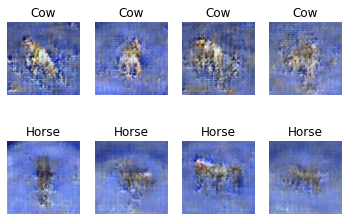

3501 [D loss: 0.086698, acc.: 98.44%] [G loss: 6.386308]
3502 [D loss: 0.158309, acc.: 93.75%] [G loss: 5.493601]
3503 [D loss: 0.094463, acc.: 95.31%] [G loss: 7.540598]
3504 [D loss: 0.050815, acc.: 98.44%] [G loss: 6.959525]
3505 [D loss: 0.062406, acc.: 98.44%] [G loss: 6.131744]
3506 [D loss: 0.195771, acc.: 92.19%] [G loss: 5.785755]
3507 [D loss: 0.222724, acc.: 89.06%] [G loss: 7.391038]
3508 [D loss: 0.200122, acc.: 95.31%] [G loss: 5.887679]
3509 [D loss: 0.119304, acc.: 93.75%] [G loss: 5.094722]
3510 [D loss: 0.103516, acc.: 96.88%] [G loss: 6.329476]
3511 [D loss: 0.281176, acc.: 90.62%] [G loss: 5.830359]
3512 [D loss: 0.093238, acc.: 95.31%] [G loss: 5.145349]
3513 [D loss: 0.104163, acc.: 98.44%] [G loss: 6.758227]
3514 [D loss: 0.058350, acc.: 98.44%] [G loss: 6.042331]
3515 [D loss: 0.212559, acc.: 92.19%] [G loss: 6.177432]
3516 [D loss: 0.090352, acc.: 95.31%] [G loss: 7.553429]
3517 [D loss: 0.065888, acc.: 100.00%] [G loss: 4.860831]
3518 [D loss: 0.053142, acc.: 

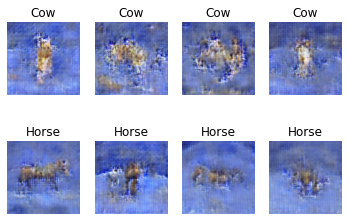

3601 [D loss: 0.103649, acc.: 98.44%] [G loss: 5.506368]
3602 [D loss: 0.293302, acc.: 87.50%] [G loss: 8.659521]
3603 [D loss: 0.206674, acc.: 96.88%] [G loss: 10.139758]
3604 [D loss: 0.257108, acc.: 92.19%] [G loss: 9.299806]
3605 [D loss: 0.074895, acc.: 96.88%] [G loss: 7.814643]
3606 [D loss: 0.207197, acc.: 89.06%] [G loss: 5.613331]
3607 [D loss: 0.054141, acc.: 100.00%] [G loss: 8.146452]
3608 [D loss: 0.069433, acc.: 96.88%] [G loss: 7.960808]
3609 [D loss: 0.155951, acc.: 95.31%] [G loss: 5.823845]
3610 [D loss: 0.195094, acc.: 92.19%] [G loss: 7.200863]
3611 [D loss: 0.165376, acc.: 93.75%] [G loss: 7.813282]
3612 [D loss: 0.112754, acc.: 96.88%] [G loss: 5.554827]
3613 [D loss: 0.123873, acc.: 95.31%] [G loss: 7.469789]
3614 [D loss: 0.153716, acc.: 92.19%] [G loss: 7.004493]
3615 [D loss: 0.312728, acc.: 87.50%] [G loss: 6.976804]
3616 [D loss: 0.135351, acc.: 95.31%] [G loss: 5.872026]
3617 [D loss: 0.202139, acc.: 92.19%] [G loss: 6.313699]
3618 [D loss: 0.145901, acc.:

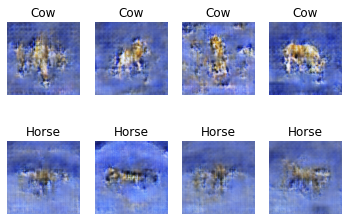

3701 [D loss: 0.338803, acc.: 87.50%] [G loss: 5.970709]
3702 [D loss: 0.113492, acc.: 95.31%] [G loss: 7.321932]
3703 [D loss: 0.150776, acc.: 93.75%] [G loss: 7.129568]
3704 [D loss: 0.070636, acc.: 96.88%] [G loss: 7.590801]
3705 [D loss: 0.163289, acc.: 93.75%] [G loss: 6.728384]
3706 [D loss: 0.121230, acc.: 96.88%] [G loss: 6.046935]
3707 [D loss: 0.206728, acc.: 89.06%] [G loss: 6.312120]
3708 [D loss: 0.226194, acc.: 93.75%] [G loss: 6.449821]
3709 [D loss: 0.120015, acc.: 95.31%] [G loss: 5.581188]
3710 [D loss: 0.225802, acc.: 92.19%] [G loss: 9.048122]
3711 [D loss: 0.080372, acc.: 96.88%] [G loss: 8.839487]
3712 [D loss: 0.095976, acc.: 95.31%] [G loss: 6.931085]
3713 [D loss: 0.166223, acc.: 93.75%] [G loss: 5.512096]
3714 [D loss: 0.204952, acc.: 89.06%] [G loss: 5.493516]
3715 [D loss: 0.248918, acc.: 89.06%] [G loss: 5.844987]
3716 [D loss: 0.092428, acc.: 95.31%] [G loss: 6.470754]
3717 [D loss: 0.267566, acc.: 87.50%] [G loss: 6.332780]
3718 [D loss: 0.088240, acc.: 9

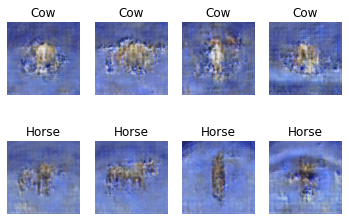

3801 [D loss: 0.073706, acc.: 96.88%] [G loss: 6.731183]
3802 [D loss: 0.164078, acc.: 95.31%] [G loss: 6.232440]
3803 [D loss: 0.081826, acc.: 95.31%] [G loss: 6.126581]
3804 [D loss: 0.194220, acc.: 90.62%] [G loss: 6.171560]
3805 [D loss: 0.041501, acc.: 100.00%] [G loss: 6.116992]
3806 [D loss: 0.175044, acc.: 93.75%] [G loss: 5.261036]
3807 [D loss: 0.106326, acc.: 95.31%] [G loss: 7.560225]
3808 [D loss: 0.138401, acc.: 95.31%] [G loss: 4.585105]
3809 [D loss: 0.157119, acc.: 93.75%] [G loss: 6.470108]
3810 [D loss: 0.095067, acc.: 96.88%] [G loss: 9.406231]
3811 [D loss: 0.142417, acc.: 96.88%] [G loss: 8.969403]
3812 [D loss: 0.119299, acc.: 95.31%] [G loss: 6.271711]
3813 [D loss: 0.168967, acc.: 90.62%] [G loss: 6.969224]
3814 [D loss: 0.066415, acc.: 98.44%] [G loss: 8.234291]
3815 [D loss: 0.098190, acc.: 95.31%] [G loss: 6.179602]
3816 [D loss: 0.156178, acc.: 93.75%] [G loss: 5.940065]
3817 [D loss: 0.137027, acc.: 93.75%] [G loss: 5.976468]
3818 [D loss: 0.202857, acc.: 

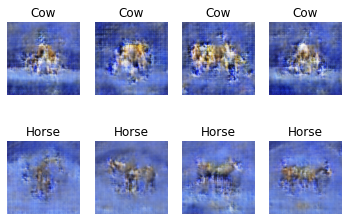

3901 [D loss: 0.113091, acc.: 95.31%] [G loss: 6.860077]
3902 [D loss: 0.051684, acc.: 98.44%] [G loss: 7.287215]
3903 [D loss: 0.116273, acc.: 96.88%] [G loss: 6.490626]
3904 [D loss: 0.150965, acc.: 92.19%] [G loss: 6.234358]
3905 [D loss: 0.068758, acc.: 98.44%] [G loss: 7.922815]
3906 [D loss: 0.183380, acc.: 93.75%] [G loss: 7.307841]
3907 [D loss: 0.133126, acc.: 96.88%] [G loss: 6.393313]
3908 [D loss: 0.119553, acc.: 96.88%] [G loss: 4.973834]
3909 [D loss: 0.205506, acc.: 92.19%] [G loss: 7.657791]
3910 [D loss: 0.330868, acc.: 90.62%] [G loss: 7.627965]
3911 [D loss: 0.134807, acc.: 93.75%] [G loss: 8.357119]
3912 [D loss: 0.102525, acc.: 93.75%] [G loss: 8.301399]
3913 [D loss: 0.044480, acc.: 100.00%] [G loss: 6.309474]
3914 [D loss: 0.134758, acc.: 92.19%] [G loss: 6.869977]
3915 [D loss: 0.244232, acc.: 92.19%] [G loss: 5.921939]
3916 [D loss: 0.117615, acc.: 95.31%] [G loss: 6.978408]
3917 [D loss: 0.182583, acc.: 93.75%] [G loss: 5.817264]
3918 [D loss: 0.164966, acc.: 

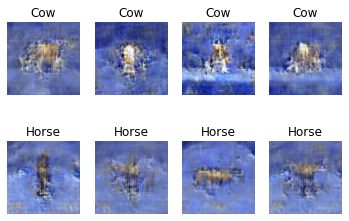

4001 [D loss: 0.089158, acc.: 96.88%] [G loss: 5.936590]
4002 [D loss: 0.133501, acc.: 93.75%] [G loss: 7.174164]
4003 [D loss: 0.021241, acc.: 100.00%] [G loss: 7.737419]
4004 [D loss: 0.165332, acc.: 92.19%] [G loss: 6.425495]
4005 [D loss: 0.059981, acc.: 96.88%] [G loss: 8.038248]
4006 [D loss: 0.226881, acc.: 90.62%] [G loss: 6.380775]
4007 [D loss: 0.028892, acc.: 100.00%] [G loss: 8.171550]
4008 [D loss: 0.102285, acc.: 95.31%] [G loss: 6.628893]
4009 [D loss: 0.147873, acc.: 95.31%] [G loss: 5.914532]
4010 [D loss: 0.142008, acc.: 92.19%] [G loss: 7.468762]
4011 [D loss: 0.051945, acc.: 98.44%] [G loss: 8.447195]
4012 [D loss: 0.101926, acc.: 96.88%] [G loss: 7.517859]
4013 [D loss: 0.099013, acc.: 95.31%] [G loss: 6.812573]
4014 [D loss: 0.111535, acc.: 98.44%] [G loss: 5.904226]
4015 [D loss: 0.062850, acc.: 98.44%] [G loss: 9.320100]
4016 [D loss: 0.221679, acc.: 89.06%] [G loss: 6.474325]
4017 [D loss: 0.032647, acc.: 100.00%] [G loss: 8.103135]
4018 [D loss: 0.078661, acc.

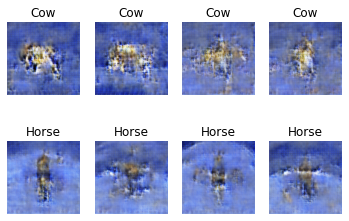

4101 [D loss: 0.134482, acc.: 96.88%] [G loss: 6.801955]
4102 [D loss: 0.213827, acc.: 92.19%] [G loss: 7.223467]
4103 [D loss: 0.031783, acc.: 100.00%] [G loss: 7.878288]
4104 [D loss: 0.129234, acc.: 93.75%] [G loss: 7.724400]
4105 [D loss: 0.231585, acc.: 82.81%] [G loss: 6.828244]
4106 [D loss: 0.211395, acc.: 87.50%] [G loss: 7.037621]
4107 [D loss: 0.077100, acc.: 95.31%] [G loss: 8.038055]
4108 [D loss: 0.149753, acc.: 92.19%] [G loss: 6.865437]
4109 [D loss: 0.263234, acc.: 92.19%] [G loss: 6.733498]
4110 [D loss: 0.062881, acc.: 95.31%] [G loss: 6.539376]
4111 [D loss: 0.184664, acc.: 90.62%] [G loss: 7.590694]
4112 [D loss: 0.249066, acc.: 89.06%] [G loss: 6.166111]
4113 [D loss: 0.056288, acc.: 95.31%] [G loss: 9.176640]
4114 [D loss: 0.245126, acc.: 90.62%] [G loss: 6.692134]
4115 [D loss: 0.140087, acc.: 93.75%] [G loss: 7.418958]
4116 [D loss: 0.122612, acc.: 96.88%] [G loss: 5.489641]
4117 [D loss: 0.043915, acc.: 100.00%] [G loss: 5.563886]
4118 [D loss: 0.051230, acc.:

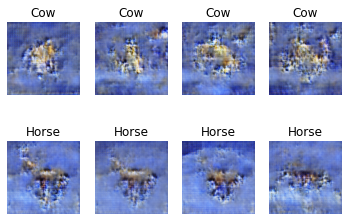

4201 [D loss: 0.098269, acc.: 96.88%] [G loss: 8.791689]
4202 [D loss: 0.200987, acc.: 90.62%] [G loss: 7.770954]
4203 [D loss: 0.094161, acc.: 96.88%] [G loss: 7.062830]
4204 [D loss: 0.173752, acc.: 92.19%] [G loss: 9.243439]
4205 [D loss: 0.174798, acc.: 92.19%] [G loss: 7.498183]
4206 [D loss: 0.041671, acc.: 100.00%] [G loss: 8.414825]
4207 [D loss: 0.144067, acc.: 95.31%] [G loss: 5.630530]
4208 [D loss: 0.048016, acc.: 98.44%] [G loss: 6.295440]
4209 [D loss: 0.075342, acc.: 96.88%] [G loss: 7.994172]
4210 [D loss: 0.140631, acc.: 93.75%] [G loss: 7.970386]
4211 [D loss: 0.028794, acc.: 98.44%] [G loss: 7.581628]
4212 [D loss: 0.073550, acc.: 98.44%] [G loss: 8.178289]
4213 [D loss: 0.269489, acc.: 87.50%] [G loss: 5.399952]
4214 [D loss: 0.208784, acc.: 92.19%] [G loss: 8.216449]
4215 [D loss: 0.097295, acc.: 95.31%] [G loss: 8.075688]
4216 [D loss: 0.208090, acc.: 92.19%] [G loss: 7.872830]
4217 [D loss: 0.138763, acc.: 93.75%] [G loss: 7.229080]
4218 [D loss: 0.099749, acc.: 

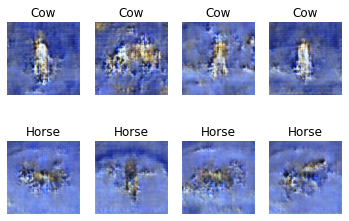

4301 [D loss: 0.130862, acc.: 95.31%] [G loss: 6.742064]
4302 [D loss: 0.073100, acc.: 96.88%] [G loss: 7.281972]
4303 [D loss: 0.056045, acc.: 98.44%] [G loss: 6.571210]
4304 [D loss: 0.078942, acc.: 96.88%] [G loss: 6.801585]
4305 [D loss: 0.073319, acc.: 98.44%] [G loss: 7.850419]
4306 [D loss: 0.119615, acc.: 96.88%] [G loss: 8.914476]
4307 [D loss: 0.066129, acc.: 96.88%] [G loss: 9.842625]
4308 [D loss: 0.036884, acc.: 98.44%] [G loss: 7.244397]
4309 [D loss: 0.292522, acc.: 87.50%] [G loss: 8.381292]
4310 [D loss: 0.077212, acc.: 96.88%] [G loss: 10.390940]
4311 [D loss: 0.294351, acc.: 87.50%] [G loss: 13.747921]
4312 [D loss: 0.403118, acc.: 87.50%] [G loss: 6.571593]
4313 [D loss: 0.076134, acc.: 96.88%] [G loss: 11.041260]
4314 [D loss: 0.237724, acc.: 90.62%] [G loss: 7.170855]
4315 [D loss: 0.103593, acc.: 96.88%] [G loss: 8.677584]
4316 [D loss: 0.167465, acc.: 90.62%] [G loss: 7.848948]
4317 [D loss: 0.094842, acc.: 93.75%] [G loss: 8.645356]
4318 [D loss: 0.112514, acc.

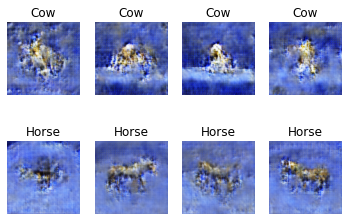

4401 [D loss: 0.184756, acc.: 92.19%] [G loss: 8.961054]
4402 [D loss: 0.115518, acc.: 93.75%] [G loss: 7.326028]
4403 [D loss: 0.033880, acc.: 100.00%] [G loss: 7.589764]
4404 [D loss: 0.218280, acc.: 95.31%] [G loss: 8.028581]
4405 [D loss: 0.151206, acc.: 92.19%] [G loss: 5.861836]
4406 [D loss: 0.173306, acc.: 92.19%] [G loss: 7.110684]
4407 [D loss: 0.121885, acc.: 96.88%] [G loss: 10.312425]
4408 [D loss: 0.119888, acc.: 95.31%] [G loss: 11.356283]
4409 [D loss: 0.015231, acc.: 100.00%] [G loss: 9.240049]
4410 [D loss: 0.145648, acc.: 95.31%] [G loss: 7.594513]
4411 [D loss: 0.038817, acc.: 98.44%] [G loss: 6.617136]
4412 [D loss: 0.224517, acc.: 96.88%] [G loss: 7.677514]
4413 [D loss: 0.094692, acc.: 96.88%] [G loss: 6.889647]
4414 [D loss: 0.086274, acc.: 96.88%] [G loss: 7.586116]
4415 [D loss: 0.026084, acc.: 100.00%] [G loss: 6.917004]
4416 [D loss: 0.083497, acc.: 95.31%] [G loss: 5.680326]
4417 [D loss: 0.162028, acc.: 93.75%] [G loss: 6.982041]
4418 [D loss: 0.248014, ac

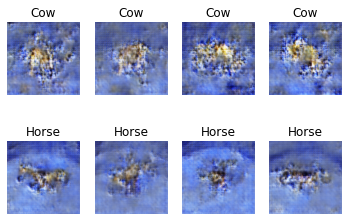

4501 [D loss: 0.016112, acc.: 100.00%] [G loss: 8.995569]
4502 [D loss: 0.033478, acc.: 100.00%] [G loss: 8.270515]
4503 [D loss: 0.037631, acc.: 98.44%] [G loss: 8.375088]
4504 [D loss: 0.142417, acc.: 95.31%] [G loss: 8.077173]
4505 [D loss: 0.206510, acc.: 90.62%] [G loss: 8.490696]
4506 [D loss: 0.079710, acc.: 96.88%] [G loss: 8.158047]
4507 [D loss: 0.202400, acc.: 92.19%] [G loss: 6.165400]
4508 [D loss: 0.124871, acc.: 95.31%] [G loss: 5.115941]
4509 [D loss: 0.293309, acc.: 93.75%] [G loss: 9.652087]
4510 [D loss: 0.066417, acc.: 98.44%] [G loss: 8.182299]
4511 [D loss: 0.043183, acc.: 100.00%] [G loss: 8.912167]
4512 [D loss: 0.114518, acc.: 93.75%] [G loss: 8.730108]
4513 [D loss: 0.201031, acc.: 92.19%] [G loss: 8.290962]
4514 [D loss: 0.101383, acc.: 96.88%] [G loss: 8.305379]
4515 [D loss: 0.297471, acc.: 89.06%] [G loss: 9.435185]
4516 [D loss: 0.183203, acc.: 90.62%] [G loss: 8.497997]
4517 [D loss: 0.042459, acc.: 98.44%] [G loss: 10.920030]
4518 [D loss: 0.050371, acc

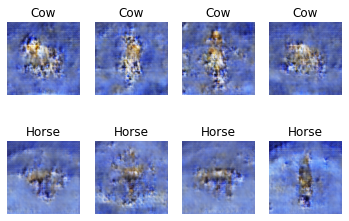

4601 [D loss: 0.122180, acc.: 95.31%] [G loss: 8.377647]
4602 [D loss: 0.067980, acc.: 96.88%] [G loss: 8.303102]
4603 [D loss: 0.173153, acc.: 95.31%] [G loss: 7.750465]
4604 [D loss: 0.032166, acc.: 100.00%] [G loss: 8.120176]
4605 [D loss: 0.063322, acc.: 96.88%] [G loss: 7.692360]
4606 [D loss: 0.041292, acc.: 98.44%] [G loss: 8.017874]
4607 [D loss: 0.109294, acc.: 95.31%] [G loss: 8.545654]
4608 [D loss: 0.109856, acc.: 96.88%] [G loss: 8.148926]
4609 [D loss: 0.048956, acc.: 98.44%] [G loss: 7.711076]
4610 [D loss: 0.156170, acc.: 92.19%] [G loss: 7.322593]
4611 [D loss: 0.113087, acc.: 96.88%] [G loss: 7.065554]
4612 [D loss: 0.114440, acc.: 93.75%] [G loss: 8.321743]
4613 [D loss: 0.033270, acc.: 98.44%] [G loss: 8.423080]
4614 [D loss: 0.055575, acc.: 98.44%] [G loss: 6.146682]
4615 [D loss: 0.151349, acc.: 93.75%] [G loss: 6.931092]
4616 [D loss: 0.157205, acc.: 92.19%] [G loss: 7.990724]
4617 [D loss: 0.074227, acc.: 98.44%] [G loss: 9.924654]
4618 [D loss: 0.232443, acc.: 

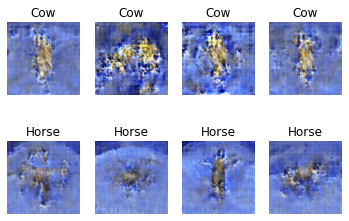

4701 [D loss: 0.173033, acc.: 93.75%] [G loss: 7.708577]
4702 [D loss: 0.152931, acc.: 95.31%] [G loss: 9.176401]
4703 [D loss: 0.091859, acc.: 93.75%] [G loss: 8.725418]
4704 [D loss: 0.031400, acc.: 100.00%] [G loss: 9.362293]
4705 [D loss: 0.046905, acc.: 98.44%] [G loss: 8.148144]
4706 [D loss: 0.060541, acc.: 96.88%] [G loss: 7.978879]
4707 [D loss: 0.032346, acc.: 100.00%] [G loss: 9.748008]
4708 [D loss: 0.154687, acc.: 95.31%] [G loss: 7.411349]
4709 [D loss: 0.125572, acc.: 90.62%] [G loss: 7.498697]
4710 [D loss: 0.022208, acc.: 100.00%] [G loss: 9.873558]
4711 [D loss: 0.113178, acc.: 96.88%] [G loss: 6.736335]
4712 [D loss: 0.054692, acc.: 96.88%] [G loss: 7.516694]
4713 [D loss: 0.140023, acc.: 93.75%] [G loss: 6.603533]
4714 [D loss: 0.185853, acc.: 92.19%] [G loss: 6.045927]
4715 [D loss: 0.096312, acc.: 95.31%] [G loss: 8.700678]
4716 [D loss: 0.014769, acc.: 100.00%] [G loss: 9.214723]
4717 [D loss: 0.073893, acc.: 96.88%] [G loss: 8.270287]
4718 [D loss: 0.141184, acc

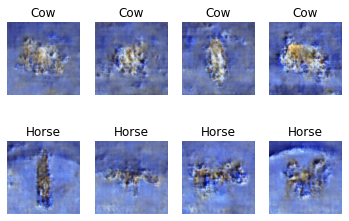

4801 [D loss: 0.054769, acc.: 96.88%] [G loss: 8.604507]
4802 [D loss: 0.040969, acc.: 100.00%] [G loss: 6.564876]
4803 [D loss: 0.050577, acc.: 100.00%] [G loss: 8.457646]
4804 [D loss: 0.064200, acc.: 96.88%] [G loss: 7.902760]
4805 [D loss: 0.026242, acc.: 100.00%] [G loss: 7.684322]
4806 [D loss: 0.140470, acc.: 95.31%] [G loss: 6.719209]
4807 [D loss: 0.063404, acc.: 98.44%] [G loss: 7.890792]
4808 [D loss: 0.192399, acc.: 93.75%] [G loss: 6.689115]
4809 [D loss: 0.066399, acc.: 98.44%] [G loss: 7.941341]
4810 [D loss: 0.038242, acc.: 100.00%] [G loss: 6.497530]
4811 [D loss: 0.160854, acc.: 93.75%] [G loss: 7.131516]
4812 [D loss: 0.072771, acc.: 98.44%] [G loss: 6.445816]
4813 [D loss: 0.131352, acc.: 93.75%] [G loss: 9.230660]
4814 [D loss: 0.155558, acc.: 96.88%] [G loss: 9.892597]
4815 [D loss: 0.046004, acc.: 96.88%] [G loss: 7.178588]
4816 [D loss: 0.282087, acc.: 89.06%] [G loss: 6.714791]
4817 [D loss: 0.123769, acc.: 92.19%] [G loss: 5.878161]
4818 [D loss: 0.173417, acc

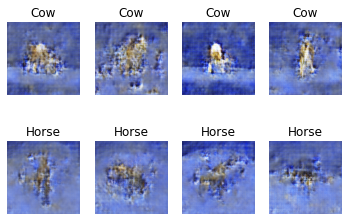

4901 [D loss: 0.135908, acc.: 95.31%] [G loss: 7.139860]
4902 [D loss: 0.056868, acc.: 98.44%] [G loss: 7.300479]
4903 [D loss: 0.085249, acc.: 95.31%] [G loss: 8.686834]
4904 [D loss: 0.102662, acc.: 95.31%] [G loss: 6.055571]
4905 [D loss: 0.105151, acc.: 95.31%] [G loss: 7.163980]
4906 [D loss: 0.128719, acc.: 93.75%] [G loss: 8.577580]
4907 [D loss: 0.147923, acc.: 95.31%] [G loss: 7.243946]
4908 [D loss: 0.156001, acc.: 93.75%] [G loss: 8.927967]
4909 [D loss: 0.046178, acc.: 98.44%] [G loss: 8.709659]
4910 [D loss: 0.015373, acc.: 100.00%] [G loss: 9.048016]
4911 [D loss: 0.107853, acc.: 92.19%] [G loss: 8.015771]
4912 [D loss: 0.044233, acc.: 98.44%] [G loss: 9.121681]
4913 [D loss: 0.093143, acc.: 96.88%] [G loss: 7.135151]
4914 [D loss: 0.016476, acc.: 100.00%] [G loss: 6.743925]
4915 [D loss: 0.167664, acc.: 96.88%] [G loss: 9.056323]
4916 [D loss: 0.042747, acc.: 98.44%] [G loss: 7.766074]
4917 [D loss: 0.121677, acc.: 96.88%] [G loss: 7.576765]
4918 [D loss: 0.050188, acc.:

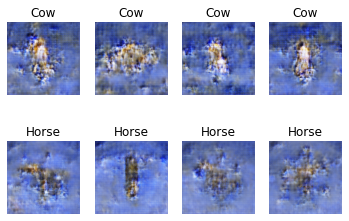

5001 [D loss: 0.093138, acc.: 96.88%] [G loss: 8.647798]
5002 [D loss: 0.094274, acc.: 96.88%] [G loss: 7.945806]
5003 [D loss: 0.049851, acc.: 98.44%] [G loss: 7.429935]
5004 [D loss: 0.055863, acc.: 98.44%] [G loss: 8.689740]
5005 [D loss: 0.056785, acc.: 100.00%] [G loss: 7.059765]
5006 [D loss: 0.041487, acc.: 98.44%] [G loss: 5.969985]
5007 [D loss: 0.095290, acc.: 95.31%] [G loss: 6.267791]
5008 [D loss: 0.094266, acc.: 96.88%] [G loss: 8.397295]
5009 [D loss: 0.035616, acc.: 98.44%] [G loss: 6.820367]
5010 [D loss: 0.327143, acc.: 89.06%] [G loss: 7.163982]
5011 [D loss: 0.067383, acc.: 95.31%] [G loss: 9.176920]
5012 [D loss: 0.188938, acc.: 93.75%] [G loss: 5.692491]
5013 [D loss: 0.123433, acc.: 96.88%] [G loss: 7.430373]
5014 [D loss: 0.098038, acc.: 96.88%] [G loss: 7.784693]
5015 [D loss: 0.024125, acc.: 100.00%] [G loss: 9.816486]
5016 [D loss: 0.067849, acc.: 96.88%] [G loss: 8.052284]
5017 [D loss: 0.024359, acc.: 100.00%] [G loss: 8.319179]
5018 [D loss: 0.046996, acc.

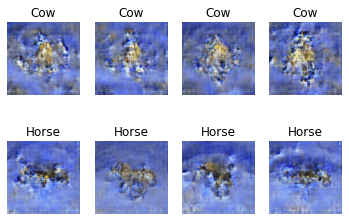

5101 [D loss: 0.069385, acc.: 98.44%] [G loss: 8.495449]
5102 [D loss: 0.050231, acc.: 96.88%] [G loss: 8.988287]
5103 [D loss: 0.158895, acc.: 90.62%] [G loss: 8.494102]
5104 [D loss: 0.077104, acc.: 93.75%] [G loss: 12.036850]
5105 [D loss: 0.111865, acc.: 93.75%] [G loss: 10.202989]
5106 [D loss: 0.076196, acc.: 95.31%] [G loss: 7.734810]
5107 [D loss: 0.039725, acc.: 100.00%] [G loss: 7.019288]
5108 [D loss: 0.055310, acc.: 98.44%] [G loss: 8.370151]
5109 [D loss: 0.085682, acc.: 95.31%] [G loss: 9.132990]
5110 [D loss: 0.039211, acc.: 98.44%] [G loss: 8.016411]
5111 [D loss: 0.103817, acc.: 95.31%] [G loss: 6.824319]
5112 [D loss: 0.058637, acc.: 98.44%] [G loss: 8.732914]
5113 [D loss: 0.082471, acc.: 95.31%] [G loss: 9.211397]
5114 [D loss: 0.065165, acc.: 98.44%] [G loss: 7.186113]
5115 [D loss: 0.052279, acc.: 98.44%] [G loss: 10.167234]
5116 [D loss: 0.045062, acc.: 98.44%] [G loss: 8.502488]
5117 [D loss: 0.085107, acc.: 98.44%] [G loss: 7.430235]
5118 [D loss: 0.023256, acc

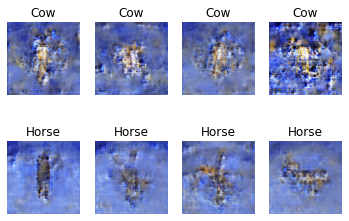

5201 [D loss: 0.135308, acc.: 95.31%] [G loss: 10.513693]
5202 [D loss: 0.051801, acc.: 98.44%] [G loss: 9.005256]
5203 [D loss: 0.026972, acc.: 100.00%] [G loss: 8.564388]
5204 [D loss: 0.069735, acc.: 96.88%] [G loss: 7.653234]
5205 [D loss: 0.114431, acc.: 95.31%] [G loss: 9.349237]
5206 [D loss: 0.075626, acc.: 96.88%] [G loss: 8.834936]
5207 [D loss: 0.108223, acc.: 96.88%] [G loss: 8.752694]
5208 [D loss: 0.058391, acc.: 95.31%] [G loss: 8.370502]
5209 [D loss: 0.053150, acc.: 98.44%] [G loss: 8.729511]
5210 [D loss: 0.150463, acc.: 96.88%] [G loss: 9.351778]
5211 [D loss: 0.077751, acc.: 96.88%] [G loss: 8.744457]
5212 [D loss: 0.034080, acc.: 100.00%] [G loss: 8.756701]
5213 [D loss: 0.168974, acc.: 93.75%] [G loss: 8.589253]
5214 [D loss: 0.072748, acc.: 96.88%] [G loss: 8.924810]
5215 [D loss: 0.022899, acc.: 100.00%] [G loss: 7.743376]
5216 [D loss: 0.051658, acc.: 98.44%] [G loss: 9.987995]
5217 [D loss: 0.029050, acc.: 100.00%] [G loss: 9.418447]
5218 [D loss: 0.087559, ac

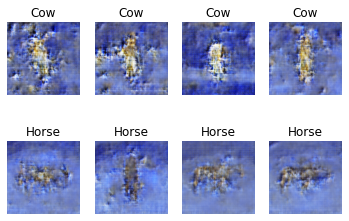

5301 [D loss: 0.119384, acc.: 96.88%] [G loss: 7.291981]
5302 [D loss: 0.111618, acc.: 98.44%] [G loss: 7.523579]
5303 [D loss: 0.095281, acc.: 95.31%] [G loss: 9.801157]
5304 [D loss: 0.052313, acc.: 96.88%] [G loss: 10.166969]
5305 [D loss: 0.073009, acc.: 96.88%] [G loss: 9.575094]
5306 [D loss: 0.151361, acc.: 95.31%] [G loss: 8.261702]
5307 [D loss: 0.032468, acc.: 98.44%] [G loss: 9.228928]
5308 [D loss: 0.056331, acc.: 98.44%] [G loss: 8.409229]
5309 [D loss: 0.064908, acc.: 95.31%] [G loss: 8.055655]
5310 [D loss: 0.038186, acc.: 98.44%] [G loss: 10.313480]
5311 [D loss: 0.055094, acc.: 98.44%] [G loss: 9.664959]
5312 [D loss: 0.208368, acc.: 92.19%] [G loss: 7.697755]
5313 [D loss: 0.077577, acc.: 96.88%] [G loss: 7.400763]
5314 [D loss: 0.062576, acc.: 96.88%] [G loss: 8.683060]
5315 [D loss: 0.038496, acc.: 98.44%] [G loss: 8.631508]
5316 [D loss: 0.085967, acc.: 96.88%] [G loss: 8.639299]
5317 [D loss: 0.014976, acc.: 100.00%] [G loss: 10.415052]
5318 [D loss: 0.058644, acc

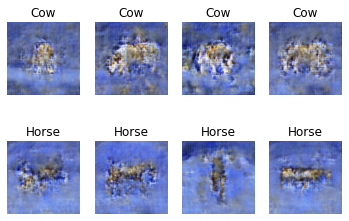

5401 [D loss: 0.052767, acc.: 96.88%] [G loss: 10.641717]
5402 [D loss: 0.173393, acc.: 90.62%] [G loss: 7.270463]
5403 [D loss: 0.054498, acc.: 96.88%] [G loss: 6.501946]
5404 [D loss: 0.149968, acc.: 95.31%] [G loss: 7.547808]
5405 [D loss: 0.058588, acc.: 96.88%] [G loss: 9.526895]
5406 [D loss: 0.086383, acc.: 96.88%] [G loss: 8.630013]
5407 [D loss: 0.143116, acc.: 90.62%] [G loss: 8.415350]
5408 [D loss: 0.171212, acc.: 92.19%] [G loss: 8.969381]
5409 [D loss: 0.062901, acc.: 96.88%] [G loss: 8.464943]
5410 [D loss: 0.134609, acc.: 93.75%] [G loss: 8.091211]
5411 [D loss: 0.052557, acc.: 96.88%] [G loss: 8.905132]
5412 [D loss: 0.171442, acc.: 95.31%] [G loss: 6.433378]
5413 [D loss: 0.014107, acc.: 100.00%] [G loss: 6.920500]
5414 [D loss: 0.025642, acc.: 100.00%] [G loss: 7.376734]
5415 [D loss: 0.116931, acc.: 92.19%] [G loss: 8.794353]
5416 [D loss: 0.061929, acc.: 98.44%] [G loss: 9.978203]
5417 [D loss: 0.116958, acc.: 96.88%] [G loss: 7.647081]
5418 [D loss: 0.182009, acc.

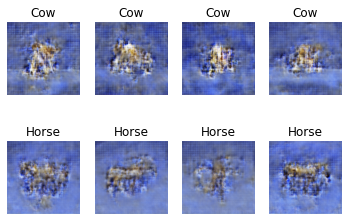

5501 [D loss: 0.092172, acc.: 96.88%] [G loss: 8.611668]
5502 [D loss: 0.009387, acc.: 100.00%] [G loss: 9.129190]
5503 [D loss: 0.088204, acc.: 95.31%] [G loss: 8.423807]
5504 [D loss: 0.067309, acc.: 96.88%] [G loss: 7.957099]
5505 [D loss: 0.058114, acc.: 98.44%] [G loss: 9.296579]
5506 [D loss: 0.060407, acc.: 96.88%] [G loss: 9.423260]
5507 [D loss: 0.022211, acc.: 100.00%] [G loss: 9.584509]
5508 [D loss: 0.115999, acc.: 96.88%] [G loss: 9.580153]
5509 [D loss: 0.021772, acc.: 100.00%] [G loss: 9.446112]
5510 [D loss: 0.038403, acc.: 96.88%] [G loss: 6.698048]
5511 [D loss: 0.026946, acc.: 100.00%] [G loss: 7.330631]
5512 [D loss: 0.055301, acc.: 96.88%] [G loss: 7.607760]
5513 [D loss: 0.045301, acc.: 98.44%] [G loss: 8.725449]
5514 [D loss: 0.104382, acc.: 96.88%] [G loss: 6.429080]
5515 [D loss: 0.070345, acc.: 98.44%] [G loss: 7.181104]
5516 [D loss: 0.068528, acc.: 96.88%] [G loss: 9.161183]
5517 [D loss: 0.062303, acc.: 95.31%] [G loss: 7.992578]
5518 [D loss: 0.071372, acc

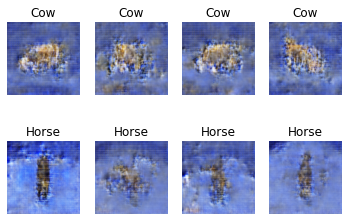

5601 [D loss: 0.029329, acc.: 100.00%] [G loss: 9.790262]
5602 [D loss: 0.205040, acc.: 93.75%] [G loss: 7.981423]
5603 [D loss: 0.190862, acc.: 92.19%] [G loss: 7.378162]
5604 [D loss: 0.024399, acc.: 100.00%] [G loss: 10.095459]
5605 [D loss: 0.071623, acc.: 96.88%] [G loss: 10.234510]
5606 [D loss: 0.055512, acc.: 96.88%] [G loss: 6.270174]
5607 [D loss: 0.081361, acc.: 98.44%] [G loss: 10.187889]
5608 [D loss: 0.086608, acc.: 95.31%] [G loss: 8.703968]
5609 [D loss: 0.037664, acc.: 98.44%] [G loss: 8.733088]
5610 [D loss: 0.317917, acc.: 90.62%] [G loss: 7.170053]
5611 [D loss: 0.079686, acc.: 98.44%] [G loss: 10.364464]
5612 [D loss: 0.104559, acc.: 96.88%] [G loss: 7.496560]
5613 [D loss: 0.086497, acc.: 93.75%] [G loss: 6.014442]
5614 [D loss: 0.045270, acc.: 98.44%] [G loss: 8.708682]
5615 [D loss: 0.043827, acc.: 98.44%] [G loss: 8.913026]
5616 [D loss: 0.025832, acc.: 100.00%] [G loss: 8.888782]
5617 [D loss: 0.109369, acc.: 96.88%] [G loss: 7.756166]
5618 [D loss: 0.070641, 

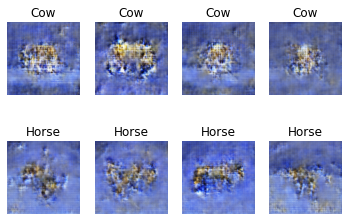

5701 [D loss: 0.031561, acc.: 98.44%] [G loss: 8.112419]
5702 [D loss: 0.185644, acc.: 87.50%] [G loss: 8.453093]
5703 [D loss: 0.042289, acc.: 98.44%] [G loss: 8.735750]
5704 [D loss: 0.058247, acc.: 96.88%] [G loss: 8.218259]
5705 [D loss: 0.102893, acc.: 93.75%] [G loss: 10.278528]
5706 [D loss: 0.022758, acc.: 98.44%] [G loss: 9.907861]
5707 [D loss: 0.052667, acc.: 98.44%] [G loss: 10.716539]
5708 [D loss: 0.091057, acc.: 96.88%] [G loss: 13.344654]
5709 [D loss: 0.103046, acc.: 96.88%] [G loss: 12.948611]
5710 [D loss: 0.116869, acc.: 95.31%] [G loss: 9.226104]
5711 [D loss: 0.039846, acc.: 100.00%] [G loss: 10.745267]
5712 [D loss: 0.121247, acc.: 95.31%] [G loss: 7.674721]
5713 [D loss: 0.190705, acc.: 92.19%] [G loss: 8.006092]
5714 [D loss: 0.054950, acc.: 98.44%] [G loss: 8.482639]
5715 [D loss: 0.032821, acc.: 100.00%] [G loss: 7.920051]
5716 [D loss: 0.116143, acc.: 95.31%] [G loss: 8.008493]
5717 [D loss: 0.035076, acc.: 98.44%] [G loss: 6.922608]
5718 [D loss: 0.008806, 

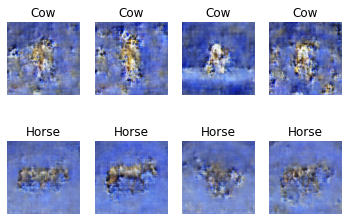

5801 [D loss: 0.027179, acc.: 100.00%] [G loss: 9.116789]
5802 [D loss: 0.026275, acc.: 100.00%] [G loss: 9.553426]
5803 [D loss: 0.053772, acc.: 96.88%] [G loss: 8.427481]
5804 [D loss: 0.019402, acc.: 100.00%] [G loss: 8.749224]
5805 [D loss: 0.014947, acc.: 100.00%] [G loss: 7.019397]
5806 [D loss: 0.028736, acc.: 100.00%] [G loss: 8.789819]
5807 [D loss: 0.058123, acc.: 95.31%] [G loss: 8.259319]
5808 [D loss: 0.037161, acc.: 98.44%] [G loss: 9.326864]
5809 [D loss: 0.187420, acc.: 93.75%] [G loss: 7.222545]
5810 [D loss: 0.105927, acc.: 96.88%] [G loss: 8.360664]
5811 [D loss: 0.089262, acc.: 95.31%] [G loss: 9.621600]
5812 [D loss: 0.354504, acc.: 82.81%] [G loss: 8.960325]
5813 [D loss: 0.044092, acc.: 98.44%] [G loss: 10.581021]
5814 [D loss: 0.033086, acc.: 100.00%] [G loss: 9.410168]
5815 [D loss: 0.133995, acc.: 93.75%] [G loss: 8.146211]
5816 [D loss: 0.050831, acc.: 98.44%] [G loss: 8.031572]
5817 [D loss: 0.078710, acc.: 98.44%] [G loss: 7.409570]
5818 [D loss: 0.092716, 

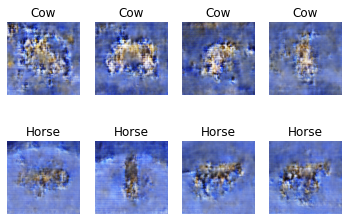

5901 [D loss: 0.050254, acc.: 98.44%] [G loss: 8.152857]
5902 [D loss: 0.101774, acc.: 95.31%] [G loss: 6.287895]
5903 [D loss: 0.049178, acc.: 98.44%] [G loss: 8.805762]
5904 [D loss: 0.081597, acc.: 96.88%] [G loss: 7.272963]
5905 [D loss: 0.075685, acc.: 96.88%] [G loss: 5.621696]
5906 [D loss: 0.174175, acc.: 92.19%] [G loss: 7.555763]
5907 [D loss: 0.059334, acc.: 96.88%] [G loss: 8.524678]
5908 [D loss: 0.178100, acc.: 93.75%] [G loss: 9.102431]
5909 [D loss: 0.084187, acc.: 95.31%] [G loss: 11.776538]
5910 [D loss: 0.024428, acc.: 100.00%] [G loss: 9.467682]
5911 [D loss: 0.120269, acc.: 93.75%] [G loss: 8.778764]
5912 [D loss: 0.020139, acc.: 100.00%] [G loss: 7.811067]
5913 [D loss: 0.080510, acc.: 98.44%] [G loss: 7.910271]
5914 [D loss: 0.124524, acc.: 92.19%] [G loss: 7.930214]
5915 [D loss: 0.100706, acc.: 93.75%] [G loss: 8.802642]
5916 [D loss: 0.202655, acc.: 92.19%] [G loss: 10.273396]
5917 [D loss: 0.044605, acc.: 98.44%] [G loss: 11.228525]
5918 [D loss: 0.028709, ac

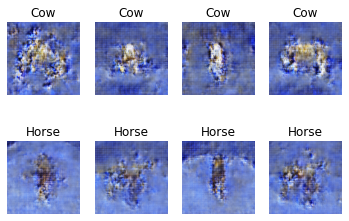

6001 [D loss: 0.029824, acc.: 98.44%] [G loss: 8.687525]
6002 [D loss: 0.046708, acc.: 98.44%] [G loss: 8.125359]
6003 [D loss: 0.097774, acc.: 96.88%] [G loss: 8.915606]
6004 [D loss: 0.040280, acc.: 98.44%] [G loss: 8.325363]
6005 [D loss: 0.080669, acc.: 95.31%] [G loss: 10.860079]
6006 [D loss: 0.118749, acc.: 96.88%] [G loss: 8.646326]
6007 [D loss: 0.044959, acc.: 98.44%] [G loss: 7.739203]
6008 [D loss: 0.114538, acc.: 96.88%] [G loss: 10.033416]
6009 [D loss: 0.020151, acc.: 100.00%] [G loss: 12.756399]
6010 [D loss: 0.111437, acc.: 93.75%] [G loss: 7.609407]
6011 [D loss: 0.068664, acc.: 98.44%] [G loss: 8.002585]
6012 [D loss: 0.089269, acc.: 96.88%] [G loss: 8.552355]
6013 [D loss: 0.073797, acc.: 96.88%] [G loss: 8.540966]
6014 [D loss: 0.090982, acc.: 98.44%] [G loss: 7.627957]
6015 [D loss: 0.110410, acc.: 92.19%] [G loss: 9.279072]
6016 [D loss: 0.031023, acc.: 100.00%] [G loss: 10.654254]
6017 [D loss: 0.043634, acc.: 98.44%] [G loss: 10.535730]
6018 [D loss: 0.044015, 

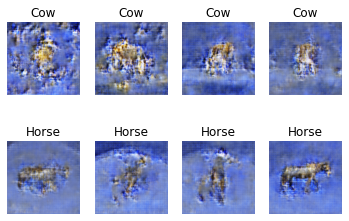

6101 [D loss: 0.093910, acc.: 95.31%] [G loss: 7.216570]
6102 [D loss: 0.065087, acc.: 96.88%] [G loss: 9.773109]
6103 [D loss: 0.121775, acc.: 96.88%] [G loss: 7.698511]
6104 [D loss: 0.057413, acc.: 98.44%] [G loss: 8.682988]
6105 [D loss: 0.074799, acc.: 93.75%] [G loss: 8.720085]
6106 [D loss: 0.031006, acc.: 100.00%] [G loss: 10.353977]
6107 [D loss: 0.079418, acc.: 98.44%] [G loss: 9.245564]
6108 [D loss: 0.077696, acc.: 98.44%] [G loss: 8.480468]
6109 [D loss: 0.052135, acc.: 98.44%] [G loss: 8.423824]
6110 [D loss: 0.076411, acc.: 96.88%] [G loss: 7.912771]
6111 [D loss: 0.096642, acc.: 96.88%] [G loss: 10.418176]
6112 [D loss: 0.142852, acc.: 96.88%] [G loss: 8.069054]
6113 [D loss: 0.060445, acc.: 96.88%] [G loss: 10.285802]
6114 [D loss: 0.018700, acc.: 100.00%] [G loss: 9.842093]
6115 [D loss: 0.152909, acc.: 95.31%] [G loss: 7.802953]
6116 [D loss: 0.034606, acc.: 100.00%] [G loss: 7.296073]
6117 [D loss: 0.160266, acc.: 95.31%] [G loss: 7.535986]
6118 [D loss: 0.200384, a

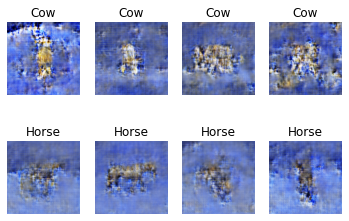

6201 [D loss: 0.029054, acc.: 100.00%] [G loss: 8.119588]
6202 [D loss: 0.024419, acc.: 98.44%] [G loss: 8.565618]
6203 [D loss: 0.014556, acc.: 100.00%] [G loss: 10.526093]
6204 [D loss: 0.062791, acc.: 98.44%] [G loss: 8.531108]
6205 [D loss: 0.036557, acc.: 98.44%] [G loss: 9.011761]
6206 [D loss: 0.021584, acc.: 100.00%] [G loss: 10.754059]
6207 [D loss: 0.039722, acc.: 96.88%] [G loss: 8.989428]
6208 [D loss: 0.113892, acc.: 96.88%] [G loss: 8.984715]
6209 [D loss: 0.060650, acc.: 98.44%] [G loss: 9.359566]
6210 [D loss: 0.037203, acc.: 98.44%] [G loss: 7.207141]
6211 [D loss: 0.066958, acc.: 98.44%] [G loss: 8.775421]
6212 [D loss: 0.052223, acc.: 96.88%] [G loss: 7.936046]
6213 [D loss: 0.088730, acc.: 93.75%] [G loss: 7.694964]
6214 [D loss: 0.073127, acc.: 98.44%] [G loss: 7.573171]
6215 [D loss: 0.051656, acc.: 98.44%] [G loss: 9.993081]
6216 [D loss: 0.270606, acc.: 92.19%] [G loss: 11.403568]
6217 [D loss: 0.026766, acc.: 98.44%] [G loss: 9.088263]
6218 [D loss: 0.107001, a

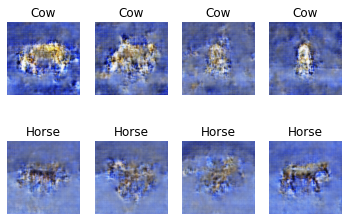

6301 [D loss: 0.176174, acc.: 93.75%] [G loss: 7.871449]
6302 [D loss: 0.281205, acc.: 92.19%] [G loss: 8.400540]
6303 [D loss: 0.089839, acc.: 96.88%] [G loss: 10.233049]
6304 [D loss: 0.086623, acc.: 96.88%] [G loss: 7.694383]
6305 [D loss: 0.152415, acc.: 93.75%] [G loss: 7.427922]
6306 [D loss: 0.030095, acc.: 100.00%] [G loss: 12.087297]
6307 [D loss: 0.068226, acc.: 98.44%] [G loss: 13.102022]
6308 [D loss: 0.019000, acc.: 100.00%] [G loss: 11.062061]
6309 [D loss: 0.048838, acc.: 98.44%] [G loss: 11.519794]
6310 [D loss: 0.011100, acc.: 100.00%] [G loss: 9.723962]
6311 [D loss: 0.031073, acc.: 100.00%] [G loss: 10.562466]
6312 [D loss: 0.019023, acc.: 100.00%] [G loss: 8.290632]
6313 [D loss: 0.056444, acc.: 98.44%] [G loss: 8.954018]
6314 [D loss: 0.065992, acc.: 96.88%] [G loss: 8.457448]
6315 [D loss: 0.075274, acc.: 95.31%] [G loss: 7.517508]
6316 [D loss: 0.036093, acc.: 98.44%] [G loss: 9.313393]
6317 [D loss: 0.058509, acc.: 96.88%] [G loss: 7.875871]
6318 [D loss: 0.0371

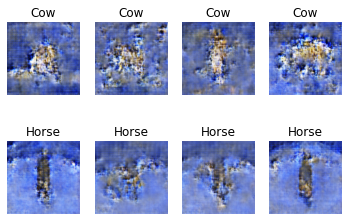

6401 [D loss: 0.370388, acc.: 90.62%] [G loss: 7.300535]
6402 [D loss: 0.091745, acc.: 98.44%] [G loss: 7.455087]
6403 [D loss: 0.068756, acc.: 96.88%] [G loss: 8.723772]
6404 [D loss: 0.071156, acc.: 96.88%] [G loss: 8.254894]
6405 [D loss: 0.045605, acc.: 98.44%] [G loss: 8.910388]
6406 [D loss: 0.017402, acc.: 100.00%] [G loss: 11.488050]
6407 [D loss: 0.031643, acc.: 100.00%] [G loss: 9.633482]
6408 [D loss: 0.071467, acc.: 98.44%] [G loss: 12.189840]
6409 [D loss: 0.020981, acc.: 98.44%] [G loss: 13.427397]
6410 [D loss: 0.206935, acc.: 92.19%] [G loss: 9.563087]
6411 [D loss: 0.008252, acc.: 100.00%] [G loss: 10.605127]
6412 [D loss: 0.306162, acc.: 93.75%] [G loss: 8.578942]
6413 [D loss: 0.060730, acc.: 96.88%] [G loss: 9.269891]
6414 [D loss: 0.011847, acc.: 100.00%] [G loss: 9.186672]
6415 [D loss: 0.029072, acc.: 100.00%] [G loss: 8.648769]
6416 [D loss: 0.026259, acc.: 100.00%] [G loss: 10.051891]
6417 [D loss: 0.064334, acc.: 98.44%] [G loss: 7.819223]
6418 [D loss: 0.0223

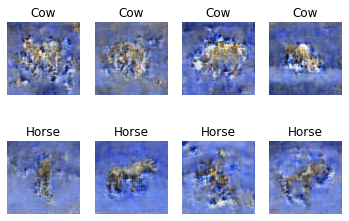

6501 [D loss: 0.042387, acc.: 98.44%] [G loss: 9.300628]
6502 [D loss: 0.051784, acc.: 98.44%] [G loss: 8.739368]
6503 [D loss: 0.028365, acc.: 98.44%] [G loss: 8.224607]
6504 [D loss: 0.055519, acc.: 98.44%] [G loss: 12.609322]
6505 [D loss: 0.019708, acc.: 100.00%] [G loss: 10.040586]
6506 [D loss: 0.019538, acc.: 100.00%] [G loss: 10.941476]
6507 [D loss: 0.119545, acc.: 93.75%] [G loss: 9.290304]
6508 [D loss: 0.026234, acc.: 100.00%] [G loss: 8.496832]
6509 [D loss: 0.008303, acc.: 100.00%] [G loss: 8.972275]
6510 [D loss: 0.061156, acc.: 96.88%] [G loss: 10.662457]
6511 [D loss: 0.018414, acc.: 100.00%] [G loss: 9.551071]
6512 [D loss: 0.073453, acc.: 96.88%] [G loss: 10.748407]
6513 [D loss: 0.071576, acc.: 96.88%] [G loss: 9.475069]
6514 [D loss: 0.037059, acc.: 100.00%] [G loss: 8.572281]
6515 [D loss: 0.070405, acc.: 96.88%] [G loss: 9.950027]
6516 [D loss: 0.097527, acc.: 98.44%] [G loss: 11.449988]
6517 [D loss: 0.111513, acc.: 96.88%] [G loss: 8.646393]
6518 [D loss: 0.019

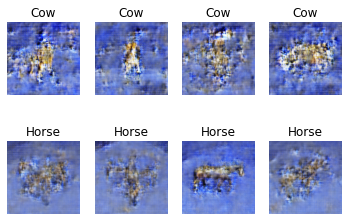

6601 [D loss: 0.048466, acc.: 96.88%] [G loss: 8.841416]
6602 [D loss: 0.137673, acc.: 93.75%] [G loss: 12.376837]
6603 [D loss: 0.049519, acc.: 100.00%] [G loss: 11.678505]
6604 [D loss: 0.053148, acc.: 98.44%] [G loss: 11.168747]
6605 [D loss: 0.023322, acc.: 100.00%] [G loss: 10.823429]
6606 [D loss: 0.040621, acc.: 96.88%] [G loss: 8.748926]
6607 [D loss: 0.110167, acc.: 96.88%] [G loss: 9.704418]
6608 [D loss: 0.070649, acc.: 95.31%] [G loss: 10.880016]
6609 [D loss: 0.066556, acc.: 96.88%] [G loss: 10.297701]
6610 [D loss: 0.056854, acc.: 96.88%] [G loss: 9.710154]
6611 [D loss: 0.112643, acc.: 96.88%] [G loss: 7.840959]
6612 [D loss: 0.026788, acc.: 100.00%] [G loss: 7.885933]
6613 [D loss: 0.042658, acc.: 98.44%] [G loss: 8.237777]
6614 [D loss: 0.048231, acc.: 96.88%] [G loss: 9.295980]
6615 [D loss: 0.090873, acc.: 96.88%] [G loss: 7.857274]
6616 [D loss: 0.011829, acc.: 100.00%] [G loss: 9.540968]
6617 [D loss: 0.090237, acc.: 98.44%] [G loss: 8.023996]
6618 [D loss: 0.02392

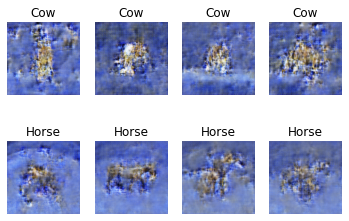

6701 [D loss: 0.059526, acc.: 96.88%] [G loss: 10.608691]
6702 [D loss: 0.145869, acc.: 95.31%] [G loss: 8.947796]
6703 [D loss: 0.047319, acc.: 98.44%] [G loss: 6.795674]
6704 [D loss: 0.073001, acc.: 95.31%] [G loss: 5.978167]
6705 [D loss: 0.073267, acc.: 96.88%] [G loss: 11.223995]
6706 [D loss: 0.027743, acc.: 100.00%] [G loss: 8.713694]
6707 [D loss: 0.032085, acc.: 98.44%] [G loss: 9.152694]
6708 [D loss: 0.053645, acc.: 96.88%] [G loss: 10.853884]
6709 [D loss: 0.075534, acc.: 98.44%] [G loss: 9.421528]
6710 [D loss: 0.018028, acc.: 100.00%] [G loss: 9.888397]
6711 [D loss: 0.032857, acc.: 96.88%] [G loss: 10.062625]
6712 [D loss: 0.060259, acc.: 96.88%] [G loss: 8.551060]
6713 [D loss: 0.020355, acc.: 98.44%] [G loss: 9.506510]
6714 [D loss: 0.038109, acc.: 98.44%] [G loss: 9.102703]
6715 [D loss: 0.192760, acc.: 87.50%] [G loss: 9.001483]
6716 [D loss: 0.085669, acc.: 95.31%] [G loss: 11.403961]
6717 [D loss: 0.344552, acc.: 87.50%] [G loss: 9.627588]
6718 [D loss: 0.185218, 

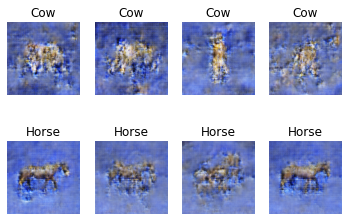

6801 [D loss: 0.025285, acc.: 100.00%] [G loss: 7.422248]
6802 [D loss: 0.021487, acc.: 100.00%] [G loss: 8.705746]
6803 [D loss: 0.083374, acc.: 96.88%] [G loss: 8.737844]
6804 [D loss: 0.051433, acc.: 98.44%] [G loss: 10.157167]
6805 [D loss: 0.036617, acc.: 98.44%] [G loss: 11.789918]
6806 [D loss: 0.027811, acc.: 98.44%] [G loss: 10.952288]
6807 [D loss: 0.061554, acc.: 96.88%] [G loss: 9.624914]
6808 [D loss: 0.094399, acc.: 96.88%] [G loss: 6.001064]
6809 [D loss: 0.087053, acc.: 96.88%] [G loss: 12.130493]
6810 [D loss: 0.042956, acc.: 98.44%] [G loss: 9.219133]
6811 [D loss: 0.075623, acc.: 96.88%] [G loss: 9.309909]
6812 [D loss: 0.154716, acc.: 93.75%] [G loss: 9.178578]
6813 [D loss: 0.031130, acc.: 98.44%] [G loss: 9.228862]
6814 [D loss: 0.073269, acc.: 96.88%] [G loss: 9.433549]
6815 [D loss: 0.047042, acc.: 98.44%] [G loss: 7.918922]
6816 [D loss: 0.032838, acc.: 98.44%] [G loss: 8.329582]
6817 [D loss: 0.020214, acc.: 100.00%] [G loss: 9.380699]
6818 [D loss: 0.035385, 

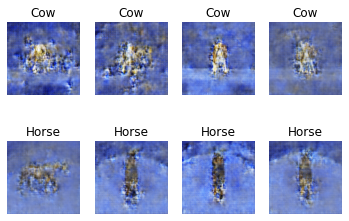

6901 [D loss: 0.018370, acc.: 100.00%] [G loss: 8.443720]
6902 [D loss: 0.024411, acc.: 100.00%] [G loss: 8.345410]
6903 [D loss: 0.046141, acc.: 98.44%] [G loss: 9.588640]
6904 [D loss: 0.098284, acc.: 93.75%] [G loss: 9.480906]
6905 [D loss: 0.010217, acc.: 100.00%] [G loss: 8.981569]
6906 [D loss: 0.037878, acc.: 98.44%] [G loss: 8.958565]
6907 [D loss: 0.007894, acc.: 100.00%] [G loss: 11.612703]
6908 [D loss: 0.186063, acc.: 92.19%] [G loss: 9.569668]
6909 [D loss: 0.097711, acc.: 96.88%] [G loss: 10.506156]
6910 [D loss: 0.057593, acc.: 96.88%] [G loss: 9.846750]
6911 [D loss: 0.215056, acc.: 90.62%] [G loss: 9.916176]
6912 [D loss: 0.029825, acc.: 98.44%] [G loss: 14.596004]
6913 [D loss: 0.065264, acc.: 96.88%] [G loss: 18.943256]
6914 [D loss: 0.219879, acc.: 90.62%] [G loss: 11.321739]
6915 [D loss: 0.021539, acc.: 100.00%] [G loss: 11.781294]
6916 [D loss: 0.041894, acc.: 98.44%] [G loss: 8.730387]
6917 [D loss: 0.085576, acc.: 96.88%] [G loss: 8.615398]
6918 [D loss: 0.0928

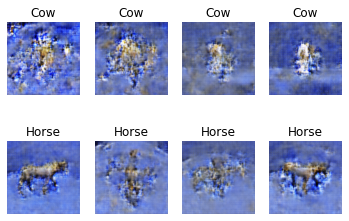

7001 [D loss: 0.104626, acc.: 95.31%] [G loss: 7.615332]
7002 [D loss: 0.132947, acc.: 93.75%] [G loss: 12.629303]
7003 [D loss: 0.036384, acc.: 98.44%] [G loss: 11.646463]
7004 [D loss: 0.031666, acc.: 100.00%] [G loss: 9.807470]
7005 [D loss: 0.040154, acc.: 98.44%] [G loss: 11.310484]
7006 [D loss: 0.074689, acc.: 98.44%] [G loss: 9.900502]
7007 [D loss: 0.014887, acc.: 100.00%] [G loss: 9.658909]
7008 [D loss: 0.041277, acc.: 98.44%] [G loss: 9.622768]
7009 [D loss: 0.049846, acc.: 98.44%] [G loss: 9.264399]
7010 [D loss: 0.069346, acc.: 95.31%] [G loss: 9.312084]
7011 [D loss: 0.064965, acc.: 98.44%] [G loss: 11.144876]
7012 [D loss: 0.028595, acc.: 98.44%] [G loss: 12.003294]
7013 [D loss: 0.109756, acc.: 96.88%] [G loss: 9.245881]
7014 [D loss: 0.128805, acc.: 98.44%] [G loss: 8.260935]
7015 [D loss: 0.021165, acc.: 100.00%] [G loss: 8.141857]
7016 [D loss: 0.016921, acc.: 100.00%] [G loss: 8.586465]
7017 [D loss: 0.006494, acc.: 100.00%] [G loss: 10.581707]
7018 [D loss: 0.0042

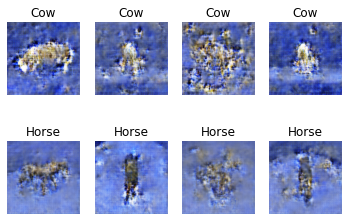

7101 [D loss: 0.066106, acc.: 98.44%] [G loss: 10.092514]
7102 [D loss: 0.047142, acc.: 96.88%] [G loss: 9.845351]
7103 [D loss: 0.053596, acc.: 96.88%] [G loss: 9.291067]
7104 [D loss: 0.012878, acc.: 100.00%] [G loss: 9.400223]
7105 [D loss: 0.130732, acc.: 92.19%] [G loss: 10.923182]
7106 [D loss: 0.015977, acc.: 100.00%] [G loss: 10.046642]
7107 [D loss: 0.363997, acc.: 84.38%] [G loss: 8.096413]
7108 [D loss: 0.067735, acc.: 95.31%] [G loss: 10.129432]
7109 [D loss: 0.055059, acc.: 98.44%] [G loss: 9.848047]
7110 [D loss: 0.036545, acc.: 96.88%] [G loss: 8.488822]
7111 [D loss: 0.064254, acc.: 95.31%] [G loss: 9.683376]
7112 [D loss: 0.060510, acc.: 98.44%] [G loss: 9.773432]
7113 [D loss: 0.186463, acc.: 93.75%] [G loss: 10.022832]
7114 [D loss: 0.059012, acc.: 96.88%] [G loss: 10.168679]
7115 [D loss: 0.114182, acc.: 98.44%] [G loss: 9.552071]
7116 [D loss: 0.037928, acc.: 100.00%] [G loss: 7.932123]
7117 [D loss: 0.063475, acc.: 96.88%] [G loss: 7.515163]
7118 [D loss: 0.095470

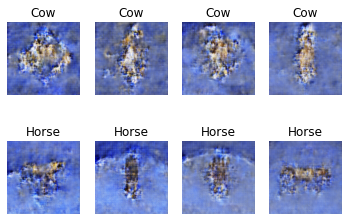

7201 [D loss: 0.030827, acc.: 100.00%] [G loss: 9.931636]
7202 [D loss: 0.039201, acc.: 98.44%] [G loss: 9.730839]
7203 [D loss: 0.034843, acc.: 98.44%] [G loss: 9.148172]
7204 [D loss: 0.200470, acc.: 89.06%] [G loss: 10.412983]
7205 [D loss: 0.058979, acc.: 96.88%] [G loss: 10.420607]
7206 [D loss: 0.030090, acc.: 100.00%] [G loss: 9.427088]
7207 [D loss: 0.076469, acc.: 98.44%] [G loss: 9.396443]
7208 [D loss: 0.017080, acc.: 100.00%] [G loss: 7.589710]
7209 [D loss: 0.040358, acc.: 98.44%] [G loss: 10.088751]
7210 [D loss: 0.005587, acc.: 100.00%] [G loss: 9.826672]
7211 [D loss: 0.048783, acc.: 96.88%] [G loss: 8.802565]
7212 [D loss: 0.057159, acc.: 98.44%] [G loss: 8.463689]
7213 [D loss: 0.026132, acc.: 100.00%] [G loss: 10.699503]
7214 [D loss: 0.053490, acc.: 96.88%] [G loss: 10.178762]
7215 [D loss: 0.064949, acc.: 98.44%] [G loss: 9.613431]
7216 [D loss: 0.076595, acc.: 95.31%] [G loss: 8.444445]
7217 [D loss: 0.068408, acc.: 95.31%] [G loss: 10.143804]
7218 [D loss: 0.0372

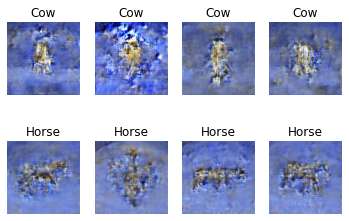

7301 [D loss: 0.032834, acc.: 98.44%] [G loss: 11.425946]
7302 [D loss: 0.042766, acc.: 96.88%] [G loss: 8.780518]
7303 [D loss: 0.071647, acc.: 96.88%] [G loss: 10.077170]
7304 [D loss: 0.035646, acc.: 96.88%] [G loss: 12.267199]
7305 [D loss: 0.115368, acc.: 96.88%] [G loss: 11.701292]
7306 [D loss: 0.051704, acc.: 98.44%] [G loss: 11.526360]
7307 [D loss: 0.025209, acc.: 98.44%] [G loss: 11.316406]
7308 [D loss: 0.188944, acc.: 95.31%] [G loss: 8.575871]
7309 [D loss: 0.050746, acc.: 98.44%] [G loss: 9.099737]
7310 [D loss: 0.112414, acc.: 95.31%] [G loss: 10.760653]
7311 [D loss: 0.024024, acc.: 98.44%] [G loss: 11.847045]
7312 [D loss: 0.036319, acc.: 98.44%] [G loss: 13.057419]
7313 [D loss: 0.151436, acc.: 95.31%] [G loss: 8.885552]
7314 [D loss: 0.054709, acc.: 96.88%] [G loss: 12.715645]
7315 [D loss: 0.029908, acc.: 100.00%] [G loss: 10.895592]
7316 [D loss: 0.138245, acc.: 92.19%] [G loss: 11.461393]
7317 [D loss: 0.016052, acc.: 100.00%] [G loss: 13.273487]
7318 [D loss: 0.

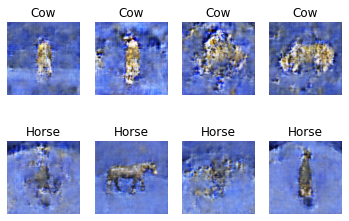

7401 [D loss: 0.034195, acc.: 98.44%] [G loss: 10.668152]
7402 [D loss: 0.062914, acc.: 96.88%] [G loss: 8.858438]
7403 [D loss: 0.179792, acc.: 92.19%] [G loss: 9.309464]
7404 [D loss: 0.038522, acc.: 98.44%] [G loss: 11.411213]
7405 [D loss: 0.078296, acc.: 96.88%] [G loss: 11.183285]
7406 [D loss: 0.029855, acc.: 98.44%] [G loss: 10.049252]
7407 [D loss: 0.056214, acc.: 95.31%] [G loss: 9.945467]
7408 [D loss: 0.050346, acc.: 96.88%] [G loss: 8.580149]
7409 [D loss: 0.090033, acc.: 95.31%] [G loss: 8.122790]
7410 [D loss: 0.055116, acc.: 98.44%] [G loss: 8.872524]
7411 [D loss: 0.058533, acc.: 95.31%] [G loss: 9.861958]
7412 [D loss: 0.054954, acc.: 96.88%] [G loss: 7.709213]
7413 [D loss: 0.013541, acc.: 100.00%] [G loss: 8.753462]
7414 [D loss: 0.122503, acc.: 95.31%] [G loss: 9.986725]
7415 [D loss: 0.032362, acc.: 98.44%] [G loss: 7.701747]
7416 [D loss: 0.073077, acc.: 96.88%] [G loss: 9.477142]
7417 [D loss: 0.071300, acc.: 96.88%] [G loss: 9.074554]
7418 [D loss: 0.111552, ac

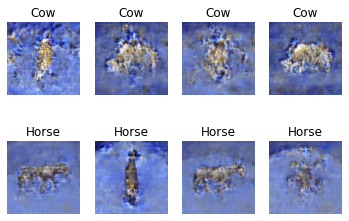

7501 [D loss: 0.127987, acc.: 93.75%] [G loss: 7.280390]
7502 [D loss: 0.049048, acc.: 98.44%] [G loss: 9.702868]
7503 [D loss: 0.036396, acc.: 100.00%] [G loss: 10.645346]
7504 [D loss: 0.034733, acc.: 98.44%] [G loss: 9.551757]
7505 [D loss: 0.033778, acc.: 100.00%] [G loss: 9.947367]
7506 [D loss: 0.004183, acc.: 100.00%] [G loss: 8.711978]
7507 [D loss: 0.021899, acc.: 100.00%] [G loss: 8.511815]
7508 [D loss: 0.087044, acc.: 98.44%] [G loss: 7.294829]
7509 [D loss: 0.102520, acc.: 95.31%] [G loss: 10.403950]
7510 [D loss: 0.023031, acc.: 100.00%] [G loss: 12.122009]
7511 [D loss: 0.184369, acc.: 95.31%] [G loss: 9.115534]
7512 [D loss: 0.086841, acc.: 96.88%] [G loss: 9.526154]
7513 [D loss: 0.053860, acc.: 96.88%] [G loss: 13.375950]
7514 [D loss: 0.086959, acc.: 96.88%] [G loss: 8.551867]
7515 [D loss: 0.067216, acc.: 95.31%] [G loss: 8.782649]
7516 [D loss: 0.105796, acc.: 96.88%] [G loss: 8.049311]
7517 [D loss: 0.050209, acc.: 98.44%] [G loss: 7.255544]
7518 [D loss: 0.030646

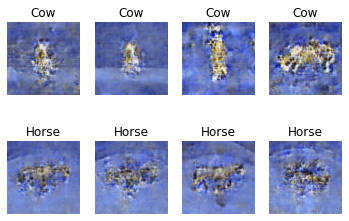

7601 [D loss: 0.033271, acc.: 100.00%] [G loss: 10.442646]
7602 [D loss: 0.015342, acc.: 100.00%] [G loss: 10.094875]
7603 [D loss: 0.028224, acc.: 98.44%] [G loss: 8.740019]
7604 [D loss: 0.050340, acc.: 98.44%] [G loss: 9.111769]
7605 [D loss: 0.029010, acc.: 98.44%] [G loss: 8.934293]
7606 [D loss: 0.033064, acc.: 100.00%] [G loss: 10.665930]
7607 [D loss: 0.026336, acc.: 98.44%] [G loss: 9.641802]
7608 [D loss: 0.028566, acc.: 100.00%] [G loss: 9.530356]
7609 [D loss: 0.125970, acc.: 95.31%] [G loss: 8.572062]
7610 [D loss: 0.031238, acc.: 100.00%] [G loss: 9.934160]
7611 [D loss: 0.061445, acc.: 96.88%] [G loss: 9.877520]
7612 [D loss: 0.064587, acc.: 98.44%] [G loss: 9.724701]
7613 [D loss: 0.167042, acc.: 93.75%] [G loss: 7.272664]
7614 [D loss: 0.036855, acc.: 98.44%] [G loss: 8.994282]
7615 [D loss: 0.026897, acc.: 100.00%] [G loss: 9.470185]
7616 [D loss: 0.046920, acc.: 98.44%] [G loss: 11.630825]
7617 [D loss: 0.056545, acc.: 98.44%] [G loss: 9.363874]
7618 [D loss: 0.02035

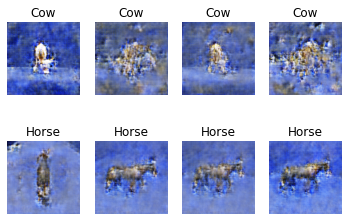

7701 [D loss: 0.027508, acc.: 98.44%] [G loss: 9.232515]
7702 [D loss: 0.074846, acc.: 96.88%] [G loss: 8.144750]
7703 [D loss: 0.127906, acc.: 96.88%] [G loss: 8.798648]
7704 [D loss: 0.109064, acc.: 93.75%] [G loss: 10.050920]
7705 [D loss: 0.015585, acc.: 100.00%] [G loss: 10.240375]
7706 [D loss: 0.254534, acc.: 93.75%] [G loss: 10.447618]
7707 [D loss: 0.036658, acc.: 98.44%] [G loss: 8.327859]
7708 [D loss: 0.115088, acc.: 96.88%] [G loss: 7.775936]
7709 [D loss: 0.073873, acc.: 96.88%] [G loss: 7.034368]
7710 [D loss: 0.135423, acc.: 95.31%] [G loss: 7.410264]
7711 [D loss: 0.271749, acc.: 90.62%] [G loss: 8.750600]
7712 [D loss: 0.181152, acc.: 93.75%] [G loss: 10.051370]
7713 [D loss: 0.112416, acc.: 95.31%] [G loss: 7.190203]
7714 [D loss: 0.035805, acc.: 100.00%] [G loss: 9.064997]
7715 [D loss: 0.050183, acc.: 98.44%] [G loss: 8.451783]
7716 [D loss: 0.060127, acc.: 96.88%] [G loss: 7.244673]
7717 [D loss: 0.080098, acc.: 98.44%] [G loss: 9.558243]
7718 [D loss: 0.139473, a

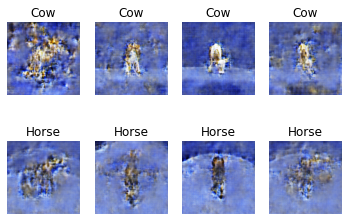

7801 [D loss: 0.065633, acc.: 96.88%] [G loss: 8.898361]
7802 [D loss: 0.088272, acc.: 95.31%] [G loss: 9.754663]
7803 [D loss: 0.122898, acc.: 95.31%] [G loss: 10.573168]
7804 [D loss: 0.126278, acc.: 95.31%] [G loss: 11.092541]
7805 [D loss: 0.067947, acc.: 98.44%] [G loss: 9.973359]
7806 [D loss: 0.012366, acc.: 100.00%] [G loss: 10.120698]
7807 [D loss: 0.078367, acc.: 96.88%] [G loss: 8.596415]
7808 [D loss: 0.039375, acc.: 98.44%] [G loss: 7.903814]
7809 [D loss: 0.079696, acc.: 96.88%] [G loss: 8.914681]
7810 [D loss: 0.043881, acc.: 98.44%] [G loss: 8.640556]
7811 [D loss: 0.132580, acc.: 92.19%] [G loss: 7.459928]
7812 [D loss: 0.032374, acc.: 96.88%] [G loss: 8.553855]
7813 [D loss: 0.067652, acc.: 93.75%] [G loss: 8.529906]
7814 [D loss: 0.056258, acc.: 96.88%] [G loss: 8.444519]
7815 [D loss: 0.084594, acc.: 98.44%] [G loss: 9.382963]
7816 [D loss: 0.013942, acc.: 100.00%] [G loss: 8.697512]
7817 [D loss: 0.009104, acc.: 100.00%] [G loss: 7.602266]
7818 [D loss: 0.043828, a

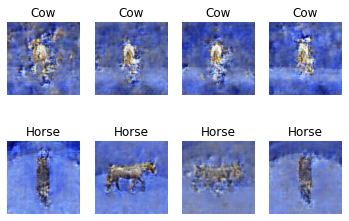

7901 [D loss: 0.024958, acc.: 100.00%] [G loss: 9.346437]
7902 [D loss: 0.065730, acc.: 96.88%] [G loss: 7.649279]
7903 [D loss: 0.059494, acc.: 95.31%] [G loss: 9.272346]
7904 [D loss: 0.023066, acc.: 100.00%] [G loss: 9.394333]
7905 [D loss: 0.011886, acc.: 100.00%] [G loss: 9.593441]
7906 [D loss: 0.015282, acc.: 100.00%] [G loss: 9.290164]
7907 [D loss: 0.085192, acc.: 98.44%] [G loss: 9.167858]
7908 [D loss: 0.064462, acc.: 98.44%] [G loss: 8.086251]
7909 [D loss: 0.037279, acc.: 98.44%] [G loss: 8.730107]
7910 [D loss: 0.040443, acc.: 98.44%] [G loss: 7.326488]
7911 [D loss: 0.024064, acc.: 100.00%] [G loss: 7.682817]
7912 [D loss: 0.041428, acc.: 98.44%] [G loss: 8.415613]
7913 [D loss: 0.030798, acc.: 98.44%] [G loss: 9.863445]
7914 [D loss: 0.035560, acc.: 98.44%] [G loss: 9.607990]
7915 [D loss: 0.035722, acc.: 98.44%] [G loss: 9.653522]
7916 [D loss: 0.021768, acc.: 100.00%] [G loss: 8.392639]
7917 [D loss: 0.127772, acc.: 95.31%] [G loss: 9.694781]
7918 [D loss: 0.059927, a

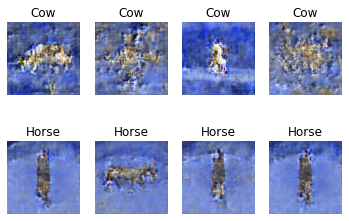

8001 [D loss: 0.069623, acc.: 95.31%] [G loss: 7.531734]
8002 [D loss: 0.053589, acc.: 95.31%] [G loss: 9.734805]
8003 [D loss: 0.064772, acc.: 98.44%] [G loss: 10.268320]
8004 [D loss: 0.063212, acc.: 96.88%] [G loss: 10.456905]
8005 [D loss: 0.051791, acc.: 96.88%] [G loss: 9.099504]
8006 [D loss: 0.139462, acc.: 93.75%] [G loss: 7.949759]
8007 [D loss: 0.042484, acc.: 96.88%] [G loss: 8.811186]
8008 [D loss: 0.053228, acc.: 98.44%] [G loss: 9.224930]
8009 [D loss: 0.186087, acc.: 92.19%] [G loss: 7.188685]
8010 [D loss: 0.029393, acc.: 98.44%] [G loss: 7.539861]
8011 [D loss: 0.066235, acc.: 98.44%] [G loss: 8.963985]
8012 [D loss: 0.044519, acc.: 96.88%] [G loss: 8.414877]
8013 [D loss: 0.029147, acc.: 98.44%] [G loss: 8.953421]
8014 [D loss: 0.069796, acc.: 95.31%] [G loss: 9.079394]
8015 [D loss: 0.041492, acc.: 98.44%] [G loss: 8.105275]
8016 [D loss: 0.046331, acc.: 96.88%] [G loss: 9.988558]
8017 [D loss: 0.038871, acc.: 98.44%] [G loss: 9.876377]
8018 [D loss: 0.004170, acc.:

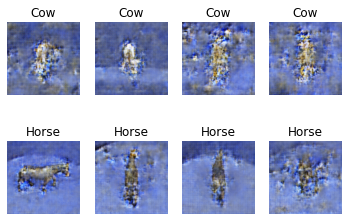

8101 [D loss: 0.031033, acc.: 98.44%] [G loss: 9.658381]
8102 [D loss: 0.129510, acc.: 95.31%] [G loss: 6.973950]
8103 [D loss: 0.059637, acc.: 96.88%] [G loss: 8.049179]
8104 [D loss: 0.046135, acc.: 96.88%] [G loss: 9.756171]
8105 [D loss: 0.119485, acc.: 96.88%] [G loss: 9.136761]
8106 [D loss: 0.111396, acc.: 93.75%] [G loss: 9.155132]
8107 [D loss: 0.013475, acc.: 100.00%] [G loss: 7.445325]
8108 [D loss: 0.066098, acc.: 95.31%] [G loss: 6.929956]
8109 [D loss: 0.020323, acc.: 98.44%] [G loss: 8.216949]
8110 [D loss: 0.081137, acc.: 95.31%] [G loss: 6.912885]
8111 [D loss: 0.090660, acc.: 96.88%] [G loss: 10.449977]
8112 [D loss: 0.083835, acc.: 95.31%] [G loss: 10.770813]
8113 [D loss: 0.015142, acc.: 100.00%] [G loss: 10.677012]
8114 [D loss: 0.014056, acc.: 100.00%] [G loss: 10.910675]
8115 [D loss: 0.086100, acc.: 96.88%] [G loss: 9.652275]
8116 [D loss: 0.076571, acc.: 95.31%] [G loss: 7.875910]
8117 [D loss: 0.057324, acc.: 98.44%] [G loss: 8.428816]
8118 [D loss: 0.079331, 

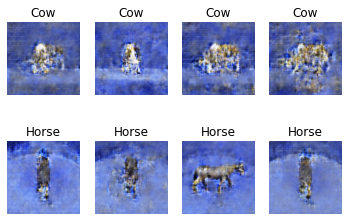

8201 [D loss: 0.105049, acc.: 95.31%] [G loss: 8.225247]
8202 [D loss: 0.143761, acc.: 92.19%] [G loss: 7.940786]
8203 [D loss: 0.023745, acc.: 100.00%] [G loss: 8.751262]
8204 [D loss: 0.088458, acc.: 95.31%] [G loss: 8.376709]
8205 [D loss: 0.087134, acc.: 96.88%] [G loss: 10.587643]
8206 [D loss: 0.027840, acc.: 98.44%] [G loss: 9.872292]
8207 [D loss: 0.048059, acc.: 96.88%] [G loss: 9.459843]
8208 [D loss: 0.016033, acc.: 100.00%] [G loss: 7.908699]
8209 [D loss: 0.100160, acc.: 96.88%] [G loss: 8.002411]
8210 [D loss: 0.059717, acc.: 95.31%] [G loss: 8.308561]
8211 [D loss: 0.037444, acc.: 98.44%] [G loss: 7.612327]
8212 [D loss: 0.033067, acc.: 98.44%] [G loss: 10.891682]
8213 [D loss: 0.025290, acc.: 100.00%] [G loss: 10.131892]
8214 [D loss: 0.032589, acc.: 100.00%] [G loss: 10.776479]
8215 [D loss: 0.217342, acc.: 89.06%] [G loss: 8.205067]
8216 [D loss: 0.022032, acc.: 100.00%] [G loss: 8.148695]
8217 [D loss: 0.017179, acc.: 100.00%] [G loss: 10.842052]
8218 [D loss: 0.0389

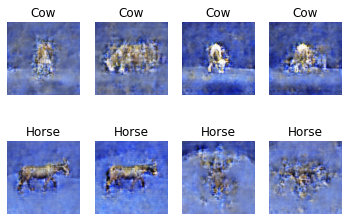

8301 [D loss: 0.099106, acc.: 93.75%] [G loss: 8.093108]
8302 [D loss: 0.044001, acc.: 100.00%] [G loss: 8.321762]
8303 [D loss: 0.131950, acc.: 93.75%] [G loss: 8.739897]
8304 [D loss: 0.053363, acc.: 98.44%] [G loss: 9.397999]
8305 [D loss: 0.134055, acc.: 95.31%] [G loss: 8.314018]
8306 [D loss: 0.097609, acc.: 95.31%] [G loss: 7.238053]
8307 [D loss: 0.011277, acc.: 100.00%] [G loss: 7.339808]
8308 [D loss: 0.026639, acc.: 98.44%] [G loss: 6.626108]
8309 [D loss: 0.010255, acc.: 100.00%] [G loss: 9.812868]
8310 [D loss: 0.017291, acc.: 100.00%] [G loss: 9.185758]
8311 [D loss: 0.040829, acc.: 96.88%] [G loss: 9.892551]
8312 [D loss: 0.048605, acc.: 96.88%] [G loss: 9.410810]
8313 [D loss: 0.063381, acc.: 95.31%] [G loss: 8.969296]
8314 [D loss: 0.040124, acc.: 100.00%] [G loss: 8.769522]
8315 [D loss: 0.022334, acc.: 100.00%] [G loss: 7.635221]
8316 [D loss: 0.043211, acc.: 100.00%] [G loss: 7.137121]
8317 [D loss: 0.111551, acc.: 95.31%] [G loss: 8.617947]
8318 [D loss: 0.029244, 

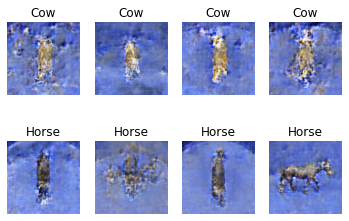

8401 [D loss: 0.049596, acc.: 98.44%] [G loss: 7.854044]
8402 [D loss: 0.044202, acc.: 96.88%] [G loss: 9.898787]
8403 [D loss: 0.052371, acc.: 96.88%] [G loss: 10.857244]
8404 [D loss: 0.115421, acc.: 96.88%] [G loss: 9.496101]
8405 [D loss: 0.111152, acc.: 93.75%] [G loss: 9.245741]
8406 [D loss: 0.016495, acc.: 100.00%] [G loss: 9.232334]
8407 [D loss: 0.119468, acc.: 95.31%] [G loss: 7.830539]
8408 [D loss: 0.021398, acc.: 100.00%] [G loss: 7.046840]
8409 [D loss: 0.114312, acc.: 93.75%] [G loss: 9.568823]
8410 [D loss: 0.105750, acc.: 98.44%] [G loss: 6.076830]
8411 [D loss: 0.069127, acc.: 96.88%] [G loss: 7.580424]
8412 [D loss: 0.020108, acc.: 100.00%] [G loss: 8.848921]
8413 [D loss: 0.112631, acc.: 96.88%] [G loss: 8.445240]
8414 [D loss: 0.043467, acc.: 98.44%] [G loss: 8.872231]
8415 [D loss: 0.116971, acc.: 95.31%] [G loss: 8.058039]
8416 [D loss: 0.045174, acc.: 96.88%] [G loss: 9.719909]
8417 [D loss: 0.123329, acc.: 96.88%] [G loss: 8.094360]
8418 [D loss: 0.076161, acc

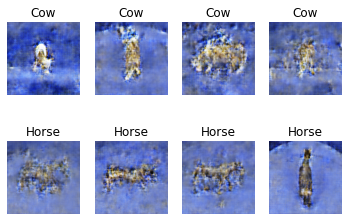

8501 [D loss: 0.073328, acc.: 98.44%] [G loss: 8.706991]
8502 [D loss: 0.007615, acc.: 100.00%] [G loss: 9.761516]
8503 [D loss: 0.159228, acc.: 92.19%] [G loss: 9.157473]
8504 [D loss: 0.033503, acc.: 98.44%] [G loss: 9.103868]
8505 [D loss: 0.022795, acc.: 100.00%] [G loss: 8.800440]
8506 [D loss: 0.160938, acc.: 95.31%] [G loss: 9.196493]
8507 [D loss: 0.098075, acc.: 93.75%] [G loss: 8.623142]
8508 [D loss: 0.059962, acc.: 98.44%] [G loss: 9.188888]
8509 [D loss: 0.075134, acc.: 96.88%] [G loss: 9.601315]
8510 [D loss: 0.101511, acc.: 96.88%] [G loss: 10.304697]
8511 [D loss: 0.032371, acc.: 100.00%] [G loss: 8.859503]
8512 [D loss: 0.019055, acc.: 100.00%] [G loss: 8.770625]
8513 [D loss: 0.071995, acc.: 98.44%] [G loss: 11.001188]
8514 [D loss: 0.023102, acc.: 100.00%] [G loss: 8.047363]
8515 [D loss: 0.033568, acc.: 100.00%] [G loss: 7.550310]
8516 [D loss: 0.114119, acc.: 93.75%] [G loss: 8.286762]
8517 [D loss: 0.093120, acc.: 96.88%] [G loss: 7.840295]
8518 [D loss: 0.023095,

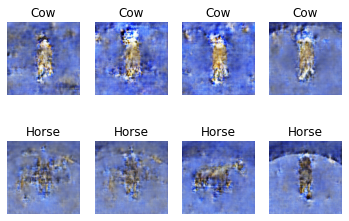

8601 [D loss: 0.060359, acc.: 96.88%] [G loss: 8.213305]
8602 [D loss: 0.036782, acc.: 100.00%] [G loss: 8.300484]
8603 [D loss: 0.135513, acc.: 95.31%] [G loss: 7.779433]
8604 [D loss: 0.081061, acc.: 96.88%] [G loss: 8.268358]
8605 [D loss: 0.115618, acc.: 93.75%] [G loss: 7.825899]
8606 [D loss: 0.122454, acc.: 95.31%] [G loss: 8.140506]
8607 [D loss: 0.189336, acc.: 90.62%] [G loss: 9.824986]
8608 [D loss: 0.068562, acc.: 98.44%] [G loss: 9.067560]
8609 [D loss: 0.110059, acc.: 93.75%] [G loss: 7.883113]
8610 [D loss: 0.217538, acc.: 92.19%] [G loss: 6.720596]
8611 [D loss: 0.169771, acc.: 92.19%] [G loss: 6.882730]
8612 [D loss: 0.076464, acc.: 96.88%] [G loss: 6.432400]
8613 [D loss: 0.076053, acc.: 96.88%] [G loss: 8.129300]
8614 [D loss: 0.046473, acc.: 96.88%] [G loss: 8.204586]
8615 [D loss: 0.069793, acc.: 96.88%] [G loss: 7.608645]
8616 [D loss: 0.035334, acc.: 98.44%] [G loss: 9.320958]
8617 [D loss: 0.094083, acc.: 95.31%] [G loss: 8.996795]
8618 [D loss: 0.061516, acc.: 

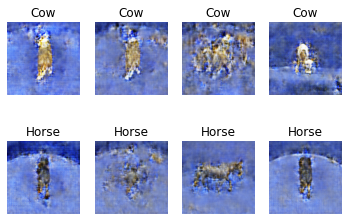

8701 [D loss: 0.013626, acc.: 100.00%] [G loss: 9.805900]
8702 [D loss: 0.017830, acc.: 100.00%] [G loss: 8.332998]
8703 [D loss: 0.089023, acc.: 95.31%] [G loss: 6.907870]
8704 [D loss: 0.027867, acc.: 100.00%] [G loss: 7.719407]
8705 [D loss: 0.050571, acc.: 98.44%] [G loss: 8.072209]
8706 [D loss: 0.159160, acc.: 96.88%] [G loss: 7.832413]
8707 [D loss: 0.030956, acc.: 98.44%] [G loss: 8.615878]
8708 [D loss: 0.127243, acc.: 95.31%] [G loss: 9.871440]
8709 [D loss: 0.086490, acc.: 95.31%] [G loss: 9.498032]
8710 [D loss: 0.077078, acc.: 98.44%] [G loss: 6.329099]
8711 [D loss: 0.076026, acc.: 96.88%] [G loss: 8.638337]
8712 [D loss: 0.034079, acc.: 98.44%] [G loss: 9.594374]
8713 [D loss: 0.123567, acc.: 98.44%] [G loss: 9.283644]
8714 [D loss: 0.172732, acc.: 90.62%] [G loss: 6.413439]
8715 [D loss: 0.141106, acc.: 95.31%] [G loss: 8.214895]
8716 [D loss: 0.053808, acc.: 96.88%] [G loss: 7.732297]
8717 [D loss: 0.123381, acc.: 93.75%] [G loss: 8.592947]
8718 [D loss: 0.037501, acc.

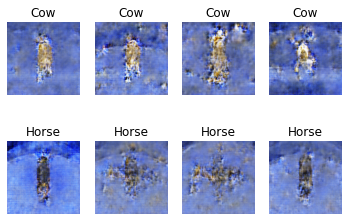

8801 [D loss: 0.010570, acc.: 100.00%] [G loss: 8.944820]
8802 [D loss: 0.071291, acc.: 98.44%] [G loss: 8.398287]
8803 [D loss: 0.086704, acc.: 96.88%] [G loss: 7.428704]
8804 [D loss: 0.103518, acc.: 95.31%] [G loss: 7.880607]
8805 [D loss: 0.049178, acc.: 98.44%] [G loss: 7.149347]
8806 [D loss: 0.136903, acc.: 93.75%] [G loss: 6.658017]
8807 [D loss: 0.043190, acc.: 98.44%] [G loss: 10.214011]
8808 [D loss: 0.112373, acc.: 95.31%] [G loss: 10.384031]
8809 [D loss: 0.049705, acc.: 98.44%] [G loss: 9.131319]
8810 [D loss: 0.012486, acc.: 100.00%] [G loss: 11.019726]
8811 [D loss: 0.087651, acc.: 95.31%] [G loss: 9.284439]
8812 [D loss: 0.081427, acc.: 96.88%] [G loss: 7.642635]
8813 [D loss: 0.072840, acc.: 96.88%] [G loss: 8.411657]
8814 [D loss: 0.091661, acc.: 95.31%] [G loss: 7.057664]
8815 [D loss: 0.097144, acc.: 95.31%] [G loss: 7.907784]
8816 [D loss: 0.081745, acc.: 96.88%] [G loss: 7.693929]
8817 [D loss: 0.053474, acc.: 96.88%] [G loss: 8.639874]
8818 [D loss: 0.032786, ac

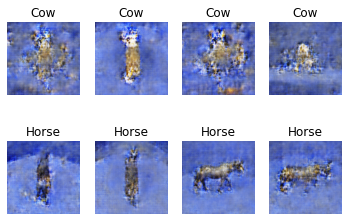

8901 [D loss: 0.056015, acc.: 96.88%] [G loss: 6.657835]
8902 [D loss: 0.059067, acc.: 98.44%] [G loss: 8.045452]
8903 [D loss: 0.024905, acc.: 100.00%] [G loss: 8.791657]
8904 [D loss: 0.054207, acc.: 96.88%] [G loss: 7.325235]
8905 [D loss: 0.082655, acc.: 96.88%] [G loss: 6.683359]
8906 [D loss: 0.039064, acc.: 100.00%] [G loss: 6.888553]
8907 [D loss: 0.028420, acc.: 100.00%] [G loss: 8.668822]
8908 [D loss: 0.089015, acc.: 96.88%] [G loss: 7.469184]
8909 [D loss: 0.032206, acc.: 98.44%] [G loss: 7.014685]
8910 [D loss: 0.036053, acc.: 100.00%] [G loss: 6.184009]
8911 [D loss: 0.121573, acc.: 95.31%] [G loss: 6.802026]
8912 [D loss: 0.036540, acc.: 98.44%] [G loss: 7.756187]
8913 [D loss: 0.021483, acc.: 98.44%] [G loss: 8.691734]
8914 [D loss: 0.152010, acc.: 96.88%] [G loss: 7.603369]
8915 [D loss: 0.033728, acc.: 100.00%] [G loss: 6.865384]
8916 [D loss: 0.045654, acc.: 100.00%] [G loss: 6.161600]
8917 [D loss: 0.092943, acc.: 93.75%] [G loss: 7.686769]
8918 [D loss: 0.034703, a

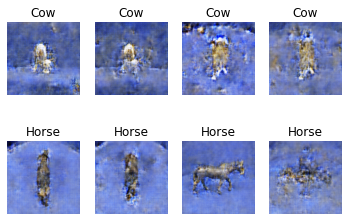

9001 [D loss: 0.025111, acc.: 98.44%] [G loss: 8.602823]
9002 [D loss: 0.053894, acc.: 98.44%] [G loss: 7.168404]
9003 [D loss: 0.228990, acc.: 90.62%] [G loss: 8.285369]
9004 [D loss: 0.097614, acc.: 95.31%] [G loss: 7.983753]
9005 [D loss: 0.116371, acc.: 96.88%] [G loss: 8.613512]
9006 [D loss: 0.188985, acc.: 93.75%] [G loss: 5.903763]
9007 [D loss: 0.023724, acc.: 100.00%] [G loss: 5.469113]
9008 [D loss: 0.164274, acc.: 92.19%] [G loss: 5.859056]
9009 [D loss: 0.079109, acc.: 98.44%] [G loss: 7.170187]
9010 [D loss: 0.068457, acc.: 96.88%] [G loss: 7.373882]
9011 [D loss: 0.047484, acc.: 98.44%] [G loss: 8.816832]
9012 [D loss: 0.032184, acc.: 100.00%] [G loss: 8.085328]
9013 [D loss: 0.108421, acc.: 92.19%] [G loss: 6.405147]
9014 [D loss: 0.088667, acc.: 96.88%] [G loss: 5.951011]
9015 [D loss: 0.059470, acc.: 96.88%] [G loss: 6.778697]
9016 [D loss: 0.122916, acc.: 95.31%] [G loss: 7.968979]
9017 [D loss: 0.043458, acc.: 100.00%] [G loss: 7.477304]
9018 [D loss: 0.048236, acc.

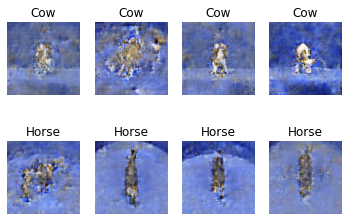

9101 [D loss: 0.018559, acc.: 100.00%] [G loss: 8.547283]
9102 [D loss: 0.113970, acc.: 93.75%] [G loss: 6.849328]
9103 [D loss: 0.017759, acc.: 100.00%] [G loss: 7.640344]
9104 [D loss: 0.044498, acc.: 98.44%] [G loss: 7.916317]
9105 [D loss: 0.128597, acc.: 95.31%] [G loss: 7.960019]
9106 [D loss: 0.020864, acc.: 100.00%] [G loss: 8.049643]
9107 [D loss: 0.068200, acc.: 98.44%] [G loss: 9.043091]
9108 [D loss: 0.085657, acc.: 98.44%] [G loss: 8.241050]
9109 [D loss: 0.077797, acc.: 98.44%] [G loss: 7.316524]
9110 [D loss: 0.066263, acc.: 95.31%] [G loss: 8.175579]
9111 [D loss: 0.048275, acc.: 98.44%] [G loss: 9.384501]
9112 [D loss: 0.270030, acc.: 87.50%] [G loss: 6.447516]
9113 [D loss: 0.091444, acc.: 96.88%] [G loss: 5.560523]
9114 [D loss: 0.155756, acc.: 96.88%] [G loss: 6.377046]
9115 [D loss: 0.094817, acc.: 95.31%] [G loss: 8.998988]
9116 [D loss: 0.146705, acc.: 96.88%] [G loss: 9.973318]
9117 [D loss: 0.022483, acc.: 100.00%] [G loss: 7.434307]
9118 [D loss: 0.101940, acc

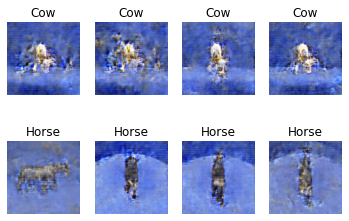

9201 [D loss: 0.027172, acc.: 100.00%] [G loss: 8.128661]
9202 [D loss: 0.028801, acc.: 100.00%] [G loss: 7.811993]
9203 [D loss: 0.054071, acc.: 96.88%] [G loss: 7.924508]
9204 [D loss: 0.021903, acc.: 98.44%] [G loss: 8.524754]
9205 [D loss: 0.082303, acc.: 98.44%] [G loss: 8.150487]
9206 [D loss: 0.054070, acc.: 96.88%] [G loss: 6.067430]
9207 [D loss: 0.054412, acc.: 98.44%] [G loss: 6.352582]
9208 [D loss: 0.040651, acc.: 96.88%] [G loss: 8.417603]
9209 [D loss: 0.026496, acc.: 100.00%] [G loss: 7.571504]
9210 [D loss: 0.072438, acc.: 96.88%] [G loss: 6.288666]
9211 [D loss: 0.113283, acc.: 95.31%] [G loss: 7.889118]
9212 [D loss: 0.031557, acc.: 100.00%] [G loss: 9.034028]
9213 [D loss: 0.037118, acc.: 98.44%] [G loss: 7.704828]
9214 [D loss: 0.209636, acc.: 93.75%] [G loss: 6.553710]
9215 [D loss: 0.068121, acc.: 95.31%] [G loss: 6.536665]
9216 [D loss: 0.221146, acc.: 90.62%] [G loss: 8.556069]
9217 [D loss: 0.013482, acc.: 100.00%] [G loss: 8.858021]
9218 [D loss: 0.105574, ac

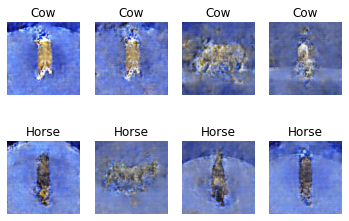

9301 [D loss: 0.089733, acc.: 96.88%] [G loss: 7.529523]
9302 [D loss: 0.060329, acc.: 95.31%] [G loss: 6.502960]
9303 [D loss: 0.008244, acc.: 100.00%] [G loss: 11.426878]
9304 [D loss: 0.008977, acc.: 100.00%] [G loss: 10.681648]
9305 [D loss: 0.045824, acc.: 98.44%] [G loss: 7.661475]
9306 [D loss: 0.017194, acc.: 100.00%] [G loss: 7.183593]
9307 [D loss: 0.029971, acc.: 98.44%] [G loss: 8.096538]
9308 [D loss: 0.013961, acc.: 100.00%] [G loss: 7.815799]
9309 [D loss: 0.163339, acc.: 93.75%] [G loss: 7.202757]
9310 [D loss: 0.115592, acc.: 93.75%] [G loss: 5.789988]
9311 [D loss: 0.056254, acc.: 96.88%] [G loss: 7.527142]
9312 [D loss: 0.113957, acc.: 96.88%] [G loss: 7.064786]
9313 [D loss: 0.176234, acc.: 90.62%] [G loss: 7.461462]
9314 [D loss: 0.049945, acc.: 98.44%] [G loss: 8.951530]
9315 [D loss: 0.035759, acc.: 98.44%] [G loss: 8.087637]
9316 [D loss: 0.143850, acc.: 96.88%] [G loss: 9.863518]
9317 [D loss: 0.135289, acc.: 95.31%] [G loss: 5.319195]
9318 [D loss: 0.039398, a

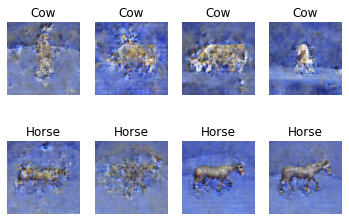

9401 [D loss: 0.032913, acc.: 98.44%] [G loss: 10.186508]
9402 [D loss: 0.345468, acc.: 92.19%] [G loss: 5.705096]
9403 [D loss: 0.071700, acc.: 98.44%] [G loss: 7.700212]
9404 [D loss: 0.019471, acc.: 100.00%] [G loss: 7.106518]
9405 [D loss: 0.185213, acc.: 93.75%] [G loss: 5.833539]
9406 [D loss: 0.037965, acc.: 100.00%] [G loss: 6.091470]
9407 [D loss: 0.048453, acc.: 98.44%] [G loss: 6.896732]
9408 [D loss: 0.100937, acc.: 96.88%] [G loss: 8.048219]
9409 [D loss: 0.049042, acc.: 98.44%] [G loss: 8.438544]
9410 [D loss: 0.100172, acc.: 96.88%] [G loss: 8.125113]
9411 [D loss: 0.129452, acc.: 96.88%] [G loss: 6.454810]
9412 [D loss: 0.031931, acc.: 100.00%] [G loss: 7.995669]
9413 [D loss: 0.179281, acc.: 89.06%] [G loss: 6.268429]
9414 [D loss: 0.031475, acc.: 98.44%] [G loss: 6.442827]
9415 [D loss: 0.035639, acc.: 98.44%] [G loss: 7.344396]
9416 [D loss: 0.105614, acc.: 95.31%] [G loss: 7.399002]
9417 [D loss: 0.075463, acc.: 96.88%] [G loss: 6.330678]
9418 [D loss: 0.036250, acc

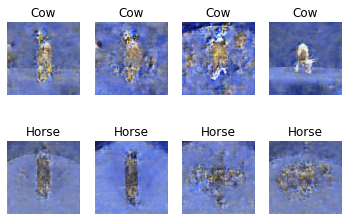

9501 [D loss: 0.015799, acc.: 100.00%] [G loss: 8.014494]
9502 [D loss: 0.094451, acc.: 96.88%] [G loss: 7.152690]
9503 [D loss: 0.021551, acc.: 100.00%] [G loss: 7.535465]
9504 [D loss: 0.106799, acc.: 95.31%] [G loss: 8.905193]
9505 [D loss: 0.103277, acc.: 95.31%] [G loss: 7.595510]
9506 [D loss: 0.078275, acc.: 95.31%] [G loss: 7.124276]
9507 [D loss: 0.020632, acc.: 100.00%] [G loss: 8.504123]
9508 [D loss: 0.141936, acc.: 96.88%] [G loss: 6.695124]
9509 [D loss: 0.020606, acc.: 100.00%] [G loss: 9.092583]
9510 [D loss: 0.081791, acc.: 96.88%] [G loss: 6.859125]
9511 [D loss: 0.056139, acc.: 96.88%] [G loss: 7.128204]
9512 [D loss: 0.124363, acc.: 96.88%] [G loss: 6.493004]
9513 [D loss: 0.143046, acc.: 92.19%] [G loss: 6.381763]
9514 [D loss: 0.163038, acc.: 90.62%] [G loss: 6.590772]
9515 [D loss: 0.124469, acc.: 96.88%] [G loss: 8.823219]
9516 [D loss: 0.003736, acc.: 100.00%] [G loss: 8.405613]
9517 [D loss: 0.060580, acc.: 95.31%] [G loss: 6.998261]
9518 [D loss: 0.090818, ac

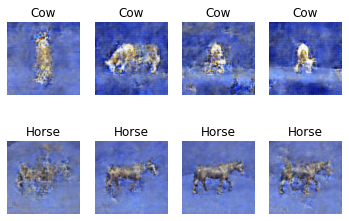

9601 [D loss: 0.043553, acc.: 98.44%] [G loss: 6.753029]
9602 [D loss: 0.198058, acc.: 93.75%] [G loss: 8.136584]
9603 [D loss: 0.018714, acc.: 100.00%] [G loss: 7.813414]
9604 [D loss: 0.119437, acc.: 95.31%] [G loss: 7.478558]
9605 [D loss: 0.050506, acc.: 96.88%] [G loss: 7.305084]
9606 [D loss: 0.078686, acc.: 98.44%] [G loss: 6.650922]
9607 [D loss: 0.072785, acc.: 95.31%] [G loss: 6.263048]
9608 [D loss: 0.061317, acc.: 98.44%] [G loss: 6.673530]
9609 [D loss: 0.071343, acc.: 96.88%] [G loss: 7.677137]
9610 [D loss: 0.085783, acc.: 95.31%] [G loss: 8.512506]
9611 [D loss: 0.175484, acc.: 96.88%] [G loss: 6.735069]
9612 [D loss: 0.110652, acc.: 93.75%] [G loss: 6.664041]
9613 [D loss: 0.029266, acc.: 98.44%] [G loss: 9.632914]
9614 [D loss: 0.076221, acc.: 96.88%] [G loss: 7.290400]
9615 [D loss: 0.010092, acc.: 100.00%] [G loss: 7.482556]
9616 [D loss: 0.185021, acc.: 95.31%] [G loss: 7.194454]
9617 [D loss: 0.126111, acc.: 90.62%] [G loss: 7.140401]
9618 [D loss: 0.099312, acc.:

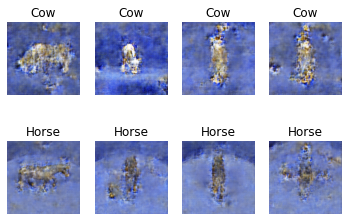

9701 [D loss: 0.033442, acc.: 98.44%] [G loss: 5.997099]
9702 [D loss: 0.089173, acc.: 98.44%] [G loss: 6.668145]
9703 [D loss: 0.079779, acc.: 96.88%] [G loss: 6.231395]
9704 [D loss: 0.114215, acc.: 93.75%] [G loss: 7.499045]
9705 [D loss: 0.053913, acc.: 98.44%] [G loss: 7.758830]
9706 [D loss: 0.046412, acc.: 98.44%] [G loss: 7.701829]
9707 [D loss: 0.017715, acc.: 100.00%] [G loss: 7.484613]
9708 [D loss: 0.062249, acc.: 96.88%] [G loss: 7.364980]
9709 [D loss: 0.058919, acc.: 98.44%] [G loss: 6.780485]
9710 [D loss: 0.071486, acc.: 98.44%] [G loss: 7.539359]
9711 [D loss: 0.136703, acc.: 96.88%] [G loss: 5.836854]
9712 [D loss: 0.048450, acc.: 98.44%] [G loss: 6.011879]
9713 [D loss: 0.137574, acc.: 95.31%] [G loss: 6.135397]
9714 [D loss: 0.097606, acc.: 95.31%] [G loss: 7.722134]
9715 [D loss: 0.087726, acc.: 96.88%] [G loss: 7.459751]
9716 [D loss: 0.099161, acc.: 96.88%] [G loss: 7.142447]
9717 [D loss: 0.131808, acc.: 93.75%] [G loss: 6.279170]
9718 [D loss: 0.163977, acc.: 

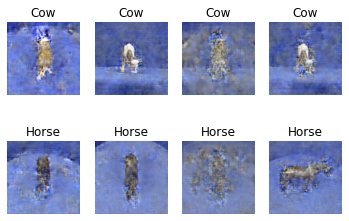

9801 [D loss: 0.111227, acc.: 93.75%] [G loss: 7.020374]
9802 [D loss: 0.105966, acc.: 96.88%] [G loss: 8.579157]
9803 [D loss: 0.056117, acc.: 96.88%] [G loss: 6.835716]
9804 [D loss: 0.053855, acc.: 98.44%] [G loss: 6.590470]
9805 [D loss: 0.028048, acc.: 100.00%] [G loss: 8.712419]
9806 [D loss: 0.092248, acc.: 96.88%] [G loss: 10.411953]
9807 [D loss: 0.032170, acc.: 98.44%] [G loss: 8.088892]
9808 [D loss: 0.013110, acc.: 100.00%] [G loss: 7.609304]
9809 [D loss: 0.230695, acc.: 93.75%] [G loss: 7.384016]
9810 [D loss: 0.077888, acc.: 95.31%] [G loss: 6.469790]
9811 [D loss: 0.130143, acc.: 96.88%] [G loss: 7.583385]
9812 [D loss: 0.020811, acc.: 100.00%] [G loss: 6.799365]
9813 [D loss: 0.109197, acc.: 93.75%] [G loss: 7.870749]
9814 [D loss: 0.107122, acc.: 98.44%] [G loss: 8.004258]
9815 [D loss: 0.049688, acc.: 98.44%] [G loss: 7.253943]
9816 [D loss: 0.092342, acc.: 96.88%] [G loss: 6.732380]
9817 [D loss: 0.080925, acc.: 98.44%] [G loss: 8.358685]
9818 [D loss: 0.140019, acc

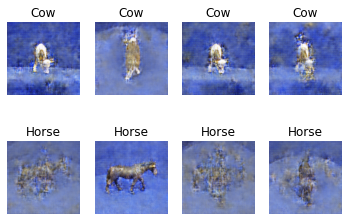

9901 [D loss: 0.185317, acc.: 93.75%] [G loss: 6.210523]
9902 [D loss: 0.037747, acc.: 98.44%] [G loss: 7.245538]
9903 [D loss: 0.130032, acc.: 95.31%] [G loss: 7.465432]
9904 [D loss: 0.028917, acc.: 98.44%] [G loss: 7.656039]
9905 [D loss: 0.059665, acc.: 96.88%] [G loss: 7.120470]
9906 [D loss: 0.046686, acc.: 98.44%] [G loss: 6.543856]
9907 [D loss: 0.047198, acc.: 96.88%] [G loss: 7.611760]
9908 [D loss: 0.104013, acc.: 95.31%] [G loss: 7.500092]
9909 [D loss: 0.042940, acc.: 96.88%] [G loss: 9.278029]
9910 [D loss: 0.119966, acc.: 95.31%] [G loss: 8.446213]
9911 [D loss: 0.040549, acc.: 98.44%] [G loss: 7.347544]
9912 [D loss: 0.031367, acc.: 98.44%] [G loss: 7.328412]
9913 [D loss: 0.343508, acc.: 81.25%] [G loss: 7.912294]
9914 [D loss: 0.096965, acc.: 96.88%] [G loss: 5.623000]
9915 [D loss: 0.067323, acc.: 96.88%] [G loss: 5.434145]
9916 [D loss: 0.135468, acc.: 95.31%] [G loss: 6.165715]
9917 [D loss: 0.044739, acc.: 98.44%] [G loss: 5.667602]
9918 [D loss: 0.101483, acc.: 9

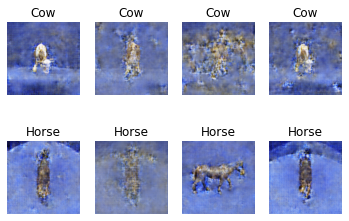

10001 [D loss: 0.081068, acc.: 96.88%] [G loss: 6.238327]
10002 [D loss: 0.153745, acc.: 92.19%] [G loss: 4.610787]
10003 [D loss: 0.099104, acc.: 93.75%] [G loss: 5.589114]
10004 [D loss: 0.057607, acc.: 96.88%] [G loss: 6.248435]
10005 [D loss: 0.076650, acc.: 96.88%] [G loss: 6.320388]
10006 [D loss: 0.011276, acc.: 100.00%] [G loss: 8.072583]
10007 [D loss: 0.112318, acc.: 95.31%] [G loss: 6.933135]
10008 [D loss: 0.277906, acc.: 90.62%] [G loss: 6.391508]
10009 [D loss: 0.127670, acc.: 93.75%] [G loss: 6.323740]
10010 [D loss: 0.050556, acc.: 98.44%] [G loss: 8.337044]
10011 [D loss: 0.054042, acc.: 96.88%] [G loss: 7.999908]
10012 [D loss: 0.194342, acc.: 98.44%] [G loss: 7.157049]
10013 [D loss: 0.021953, acc.: 98.44%] [G loss: 5.860178]
10014 [D loss: 0.029000, acc.: 100.00%] [G loss: 7.143647]
10015 [D loss: 0.032066, acc.: 98.44%] [G loss: 6.391460]
10016 [D loss: 0.118094, acc.: 96.88%] [G loss: 5.894651]
10017 [D loss: 0.049577, acc.: 98.44%] [G loss: 6.154658]
10018 [D los

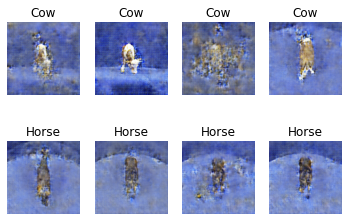

10101 [D loss: 0.020008, acc.: 100.00%] [G loss: 7.007494]
10102 [D loss: 0.146976, acc.: 95.31%] [G loss: 6.203562]
10103 [D loss: 0.138514, acc.: 95.31%] [G loss: 7.257725]
10104 [D loss: 0.061907, acc.: 98.44%] [G loss: 9.370058]
10105 [D loss: 0.102268, acc.: 95.31%] [G loss: 7.219069]
10106 [D loss: 0.200931, acc.: 92.19%] [G loss: 6.671379]
10107 [D loss: 0.109262, acc.: 96.88%] [G loss: 5.291510]
10108 [D loss: 0.058554, acc.: 98.44%] [G loss: 5.935384]
10109 [D loss: 0.117424, acc.: 93.75%] [G loss: 5.832738]
10110 [D loss: 0.172692, acc.: 90.62%] [G loss: 6.671574]
10111 [D loss: 0.103265, acc.: 96.88%] [G loss: 7.309137]
10112 [D loss: 0.022389, acc.: 100.00%] [G loss: 7.547988]
10113 [D loss: 0.151526, acc.: 96.88%] [G loss: 6.787184]
10114 [D loss: 0.051582, acc.: 98.44%] [G loss: 5.964422]
10115 [D loss: 0.033934, acc.: 98.44%] [G loss: 7.270595]
10116 [D loss: 0.027625, acc.: 100.00%] [G loss: 5.863197]
10117 [D loss: 0.132170, acc.: 98.44%] [G loss: 6.532963]
10118 [D lo

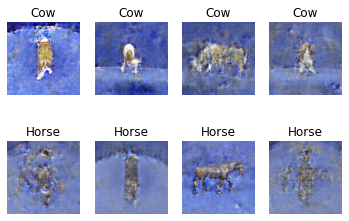

10201 [D loss: 0.156043, acc.: 93.75%] [G loss: 7.695759]
10202 [D loss: 0.019034, acc.: 100.00%] [G loss: 6.772590]
10203 [D loss: 0.211493, acc.: 93.75%] [G loss: 5.730887]
10204 [D loss: 0.033611, acc.: 98.44%] [G loss: 7.032061]
10205 [D loss: 0.156594, acc.: 95.31%] [G loss: 5.029078]
10206 [D loss: 0.070891, acc.: 96.88%] [G loss: 6.373759]
10207 [D loss: 0.189318, acc.: 90.62%] [G loss: 6.715467]
10208 [D loss: 0.062000, acc.: 98.44%] [G loss: 5.663143]
10209 [D loss: 0.082234, acc.: 95.31%] [G loss: 6.471538]
10210 [D loss: 0.015725, acc.: 100.00%] [G loss: 6.770225]
10211 [D loss: 0.064213, acc.: 95.31%] [G loss: 6.294825]
10212 [D loss: 0.018057, acc.: 100.00%] [G loss: 8.076998]
10213 [D loss: 0.028365, acc.: 98.44%] [G loss: 7.707213]
10214 [D loss: 0.054739, acc.: 98.44%] [G loss: 7.835632]
10215 [D loss: 0.111335, acc.: 93.75%] [G loss: 9.173187]
10216 [D loss: 0.071050, acc.: 98.44%] [G loss: 12.918095]
10217 [D loss: 0.009151, acc.: 100.00%] [G loss: 9.171196]
10218 [D 

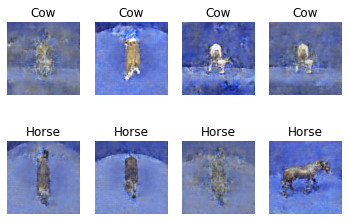

10301 [D loss: 0.011264, acc.: 100.00%] [G loss: 7.625302]
10302 [D loss: 0.053344, acc.: 98.44%] [G loss: 6.662094]
10303 [D loss: 0.087151, acc.: 96.88%] [G loss: 6.622165]
10304 [D loss: 0.080440, acc.: 95.31%] [G loss: 7.201844]
10305 [D loss: 0.102020, acc.: 95.31%] [G loss: 5.907579]
10306 [D loss: 0.040360, acc.: 98.44%] [G loss: 5.441548]
10307 [D loss: 0.035808, acc.: 98.44%] [G loss: 6.625402]
10308 [D loss: 0.127229, acc.: 96.88%] [G loss: 6.719430]
10309 [D loss: 0.017422, acc.: 100.00%] [G loss: 6.640606]
10310 [D loss: 0.116747, acc.: 93.75%] [G loss: 7.486908]
10311 [D loss: 0.004785, acc.: 100.00%] [G loss: 8.300545]
10312 [D loss: 0.081320, acc.: 96.88%] [G loss: 5.696592]
10313 [D loss: 0.068169, acc.: 98.44%] [G loss: 6.236439]
10314 [D loss: 0.037534, acc.: 100.00%] [G loss: 5.474296]
10315 [D loss: 0.039542, acc.: 98.44%] [G loss: 5.960643]
10316 [D loss: 0.046749, acc.: 96.88%] [G loss: 6.598989]
10317 [D loss: 0.082315, acc.: 98.44%] [G loss: 7.447528]
10318 [D l

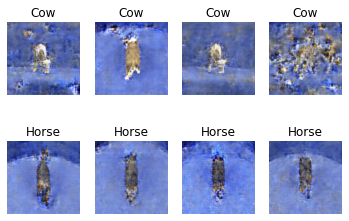

10401 [D loss: 0.083236, acc.: 98.44%] [G loss: 5.768778]
10402 [D loss: 0.160779, acc.: 95.31%] [G loss: 5.865664]
10403 [D loss: 0.114283, acc.: 95.31%] [G loss: 6.567764]
10404 [D loss: 0.085543, acc.: 96.88%] [G loss: 6.015824]
10405 [D loss: 0.120521, acc.: 90.62%] [G loss: 5.910036]
10406 [D loss: 0.075908, acc.: 98.44%] [G loss: 6.003554]
10407 [D loss: 0.044877, acc.: 98.44%] [G loss: 5.884239]
10408 [D loss: 0.001839, acc.: 100.00%] [G loss: 8.156824]
10409 [D loss: 0.237116, acc.: 93.75%] [G loss: 5.403628]
10410 [D loss: 0.016717, acc.: 100.00%] [G loss: 5.444387]
10411 [D loss: 0.056979, acc.: 96.88%] [G loss: 5.718478]
10412 [D loss: 0.132661, acc.: 96.88%] [G loss: 6.262967]
10413 [D loss: 0.179360, acc.: 92.19%] [G loss: 5.305762]
10414 [D loss: 0.029981, acc.: 100.00%] [G loss: 5.075170]
10415 [D loss: 0.059232, acc.: 98.44%] [G loss: 6.711214]
10416 [D loss: 0.049988, acc.: 98.44%] [G loss: 6.304989]
10417 [D loss: 0.067103, acc.: 98.44%] [G loss: 5.929842]
10418 [D lo

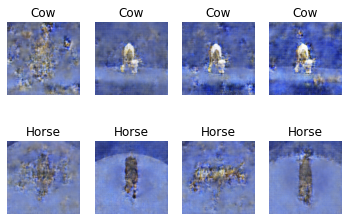

10501 [D loss: 0.109288, acc.: 96.88%] [G loss: 6.370445]
10502 [D loss: 0.091438, acc.: 96.88%] [G loss: 6.361593]
10503 [D loss: 0.069985, acc.: 96.88%] [G loss: 6.323511]
10504 [D loss: 0.011298, acc.: 100.00%] [G loss: 5.754086]
10505 [D loss: 0.065157, acc.: 96.88%] [G loss: 6.270717]
10506 [D loss: 0.063321, acc.: 98.44%] [G loss: 7.291410]
10507 [D loss: 0.117561, acc.: 96.88%] [G loss: 9.371429]
10508 [D loss: 0.098185, acc.: 96.88%] [G loss: 5.891723]
10509 [D loss: 0.080212, acc.: 96.88%] [G loss: 5.891733]
10510 [D loss: 0.028871, acc.: 100.00%] [G loss: 7.258746]
10511 [D loss: 0.102254, acc.: 96.88%] [G loss: 5.711620]
10512 [D loss: 0.115268, acc.: 96.88%] [G loss: 6.022008]
10513 [D loss: 0.040337, acc.: 96.88%] [G loss: 7.396911]
10514 [D loss: 0.105805, acc.: 95.31%] [G loss: 6.945786]
10515 [D loss: 0.222864, acc.: 87.50%] [G loss: 5.243137]
10516 [D loss: 0.015318, acc.: 100.00%] [G loss: 5.949825]
10517 [D loss: 0.055210, acc.: 98.44%] [G loss: 6.168384]
10518 [D lo

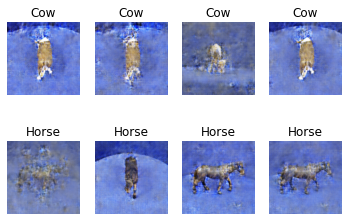

10601 [D loss: 0.123650, acc.: 93.75%] [G loss: 7.569432]
10602 [D loss: 0.071633, acc.: 96.88%] [G loss: 6.600834]
10603 [D loss: 0.158308, acc.: 90.62%] [G loss: 6.544761]
10604 [D loss: 0.048803, acc.: 98.44%] [G loss: 6.134117]
10605 [D loss: 0.195950, acc.: 95.31%] [G loss: 8.017662]
10606 [D loss: 0.165289, acc.: 95.31%] [G loss: 7.589375]
10607 [D loss: 0.005665, acc.: 100.00%] [G loss: 9.029722]
10608 [D loss: 0.044823, acc.: 98.44%] [G loss: 5.967487]
10609 [D loss: 0.027959, acc.: 100.00%] [G loss: 6.687966]
10610 [D loss: 0.006952, acc.: 100.00%] [G loss: 6.213653]
10611 [D loss: 0.070292, acc.: 96.88%] [G loss: 7.221279]
10612 [D loss: 0.041569, acc.: 98.44%] [G loss: 7.848939]
10613 [D loss: 0.024993, acc.: 98.44%] [G loss: 8.029214]
10614 [D loss: 0.098107, acc.: 96.88%] [G loss: 6.801107]
10615 [D loss: 0.177579, acc.: 92.19%] [G loss: 5.589171]
10616 [D loss: 0.077650, acc.: 98.44%] [G loss: 5.614486]
10617 [D loss: 0.095039, acc.: 96.88%] [G loss: 5.701988]
10618 [D lo

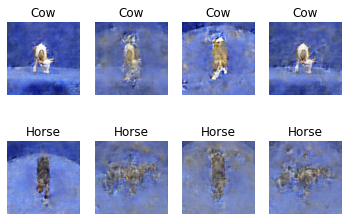

10701 [D loss: 0.003468, acc.: 100.00%] [G loss: 9.845216]
10702 [D loss: 0.072397, acc.: 98.44%] [G loss: 6.403104]
10703 [D loss: 0.083545, acc.: 98.44%] [G loss: 5.652502]
10704 [D loss: 0.204248, acc.: 92.19%] [G loss: 5.519363]
10705 [D loss: 0.043107, acc.: 98.44%] [G loss: 5.180829]
10706 [D loss: 0.047508, acc.: 98.44%] [G loss: 5.802458]
10707 [D loss: 0.162056, acc.: 93.75%] [G loss: 5.512214]
10708 [D loss: 0.040069, acc.: 98.44%] [G loss: 6.791629]
10709 [D loss: 0.076266, acc.: 95.31%] [G loss: 8.448309]
10710 [D loss: 0.032334, acc.: 98.44%] [G loss: 7.128811]
10711 [D loss: 0.010730, acc.: 100.00%] [G loss: 6.403823]
10712 [D loss: 0.141262, acc.: 95.31%] [G loss: 5.761534]
10713 [D loss: 0.123928, acc.: 96.88%] [G loss: 5.378333]
10714 [D loss: 0.090889, acc.: 95.31%] [G loss: 7.146668]
10715 [D loss: 0.020018, acc.: 100.00%] [G loss: 6.510741]
10716 [D loss: 0.071414, acc.: 96.88%] [G loss: 6.593928]
10717 [D loss: 0.176559, acc.: 95.31%] [G loss: 5.206618]
10718 [D lo

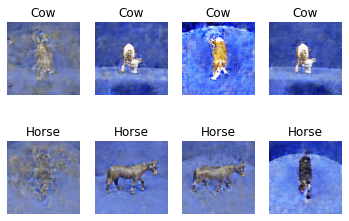

10801 [D loss: 0.018271, acc.: 100.00%] [G loss: 6.336781]
10802 [D loss: 0.181756, acc.: 95.31%] [G loss: 5.875959]
10803 [D loss: 0.055114, acc.: 98.44%] [G loss: 5.298110]
10804 [D loss: 0.227614, acc.: 93.75%] [G loss: 5.943146]
10805 [D loss: 0.146967, acc.: 93.75%] [G loss: 5.646627]
10806 [D loss: 0.016031, acc.: 100.00%] [G loss: 6.292861]
10807 [D loss: 0.088679, acc.: 96.88%] [G loss: 6.440395]
10808 [D loss: 0.063909, acc.: 98.44%] [G loss: 5.559637]
10809 [D loss: 0.131507, acc.: 96.88%] [G loss: 5.672301]
10810 [D loss: 0.157372, acc.: 93.75%] [G loss: 5.229062]
10811 [D loss: 0.028130, acc.: 100.00%] [G loss: 4.685371]
10812 [D loss: 0.031572, acc.: 100.00%] [G loss: 5.865874]
10813 [D loss: 0.143465, acc.: 93.75%] [G loss: 5.205419]
10814 [D loss: 0.087066, acc.: 98.44%] [G loss: 6.363339]
10815 [D loss: 0.074013, acc.: 96.88%] [G loss: 5.248067]
10816 [D loss: 0.080183, acc.: 96.88%] [G loss: 5.670645]
10817 [D loss: 0.098868, acc.: 96.88%] [G loss: 5.115533]
10818 [D l

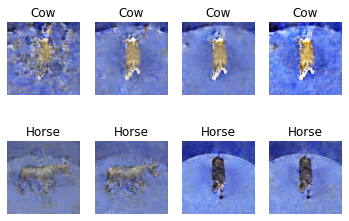

10901 [D loss: 0.081324, acc.: 96.88%] [G loss: 5.277096]
10902 [D loss: 0.033476, acc.: 98.44%] [G loss: 5.864033]
10903 [D loss: 0.035562, acc.: 98.44%] [G loss: 5.923933]
10904 [D loss: 0.041324, acc.: 96.88%] [G loss: 7.078178]
10905 [D loss: 0.023773, acc.: 100.00%] [G loss: 5.481098]
10906 [D loss: 0.010764, acc.: 100.00%] [G loss: 5.512847]
10907 [D loss: 0.015993, acc.: 100.00%] [G loss: 5.927834]
10908 [D loss: 0.056027, acc.: 96.88%] [G loss: 6.355505]
10909 [D loss: 0.006582, acc.: 100.00%] [G loss: 6.543839]
10910 [D loss: 0.235210, acc.: 96.88%] [G loss: 5.591197]
10911 [D loss: 0.193079, acc.: 90.62%] [G loss: 4.325082]
10912 [D loss: 0.057040, acc.: 98.44%] [G loss: 4.760623]
10913 [D loss: 0.012128, acc.: 100.00%] [G loss: 6.215884]
10914 [D loss: 0.010026, acc.: 100.00%] [G loss: 6.217385]
10915 [D loss: 0.076503, acc.: 98.44%] [G loss: 6.314422]
10916 [D loss: 0.052245, acc.: 98.44%] [G loss: 4.772002]
10917 [D loss: 0.104772, acc.: 96.88%] [G loss: 7.465694]
10918 [D

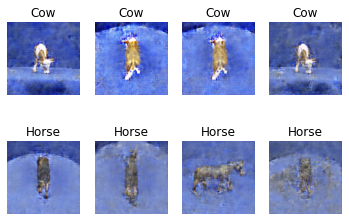

11001 [D loss: 0.145916, acc.: 95.31%] [G loss: 5.846913]
11002 [D loss: 0.020840, acc.: 100.00%] [G loss: 4.374513]
11003 [D loss: 0.071006, acc.: 98.44%] [G loss: 4.015272]
11004 [D loss: 0.162538, acc.: 95.31%] [G loss: 5.040359]
11005 [D loss: 0.180286, acc.: 93.75%] [G loss: 4.005883]
11006 [D loss: 0.050238, acc.: 98.44%] [G loss: 5.264306]
11007 [D loss: 0.041546, acc.: 98.44%] [G loss: 5.585943]
11008 [D loss: 0.034850, acc.: 98.44%] [G loss: 6.791004]
11009 [D loss: 0.075628, acc.: 98.44%] [G loss: 5.937213]
11010 [D loss: 0.081345, acc.: 96.88%] [G loss: 5.475483]
11011 [D loss: 0.067181, acc.: 96.88%] [G loss: 5.235512]
11012 [D loss: 0.025825, acc.: 98.44%] [G loss: 6.430089]
11013 [D loss: 0.009310, acc.: 100.00%] [G loss: 6.922002]
11014 [D loss: 0.071564, acc.: 95.31%] [G loss: 5.705476]
11015 [D loss: 0.094777, acc.: 98.44%] [G loss: 5.509463]
11016 [D loss: 0.155766, acc.: 95.31%] [G loss: 5.359766]
11017 [D loss: 0.056453, acc.: 96.88%] [G loss: 6.238678]
11018 [D los

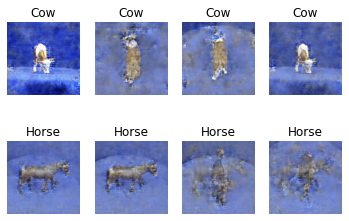

11101 [D loss: 0.105991, acc.: 98.44%] [G loss: 5.352571]
11102 [D loss: 0.095606, acc.: 96.88%] [G loss: 5.661827]
11103 [D loss: 0.035497, acc.: 98.44%] [G loss: 6.083803]
11104 [D loss: 0.078991, acc.: 98.44%] [G loss: 7.495411]
11105 [D loss: 0.031151, acc.: 98.44%] [G loss: 6.714786]
11106 [D loss: 0.275738, acc.: 87.50%] [G loss: 4.906432]
11107 [D loss: 0.023781, acc.: 100.00%] [G loss: 6.131131]
11108 [D loss: 0.108768, acc.: 96.88%] [G loss: 6.249214]
11109 [D loss: 0.108846, acc.: 96.88%] [G loss: 5.593708]
11110 [D loss: 0.144347, acc.: 93.75%] [G loss: 5.040199]
11111 [D loss: 0.124448, acc.: 93.75%] [G loss: 5.265862]
11112 [D loss: 0.031855, acc.: 98.44%] [G loss: 5.023153]
11113 [D loss: 0.058454, acc.: 96.88%] [G loss: 5.487974]
11114 [D loss: 0.057322, acc.: 98.44%] [G loss: 4.317601]
11115 [D loss: 0.063419, acc.: 96.88%] [G loss: 6.255655]
11116 [D loss: 0.045013, acc.: 96.88%] [G loss: 5.928161]
11117 [D loss: 0.084942, acc.: 98.44%] [G loss: 6.585629]
11118 [D loss

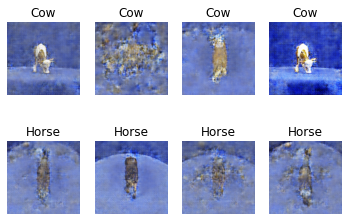

11201 [D loss: 0.017732, acc.: 100.00%] [G loss: 8.376875]
11202 [D loss: 0.102077, acc.: 98.44%] [G loss: 7.486403]
11203 [D loss: 0.267341, acc.: 89.06%] [G loss: 4.257192]
11204 [D loss: 0.031078, acc.: 100.00%] [G loss: 6.375278]
11205 [D loss: 0.121799, acc.: 96.88%] [G loss: 5.792940]
11206 [D loss: 0.114668, acc.: 95.31%] [G loss: 5.857472]
11207 [D loss: 0.046121, acc.: 98.44%] [G loss: 6.273164]
11208 [D loss: 0.060707, acc.: 96.88%] [G loss: 5.153679]
11209 [D loss: 0.076238, acc.: 96.88%] [G loss: 4.869488]
11210 [D loss: 0.021840, acc.: 100.00%] [G loss: 5.022768]
11211 [D loss: 0.065127, acc.: 95.31%] [G loss: 5.426640]
11212 [D loss: 0.020588, acc.: 100.00%] [G loss: 7.172934]
11213 [D loss: 0.075745, acc.: 96.88%] [G loss: 6.415093]
11214 [D loss: 0.234096, acc.: 93.75%] [G loss: 6.058871]
11215 [D loss: 0.063656, acc.: 98.44%] [G loss: 5.368381]
11216 [D loss: 0.024098, acc.: 100.00%] [G loss: 5.933617]
11217 [D loss: 0.035523, acc.: 98.44%] [G loss: 5.572186]
11218 [D 

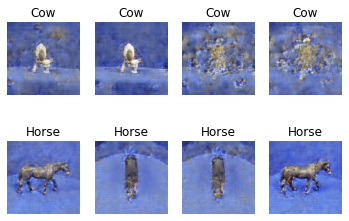

11301 [D loss: 0.039489, acc.: 98.44%] [G loss: 5.163051]
11302 [D loss: 0.097931, acc.: 96.88%] [G loss: 4.930939]
11303 [D loss: 0.052427, acc.: 98.44%] [G loss: 6.476128]
11304 [D loss: 0.107671, acc.: 98.44%] [G loss: 6.612088]
11305 [D loss: 0.065606, acc.: 96.88%] [G loss: 6.993839]
11306 [D loss: 0.057840, acc.: 98.44%] [G loss: 5.519147]
11307 [D loss: 0.076476, acc.: 98.44%] [G loss: 6.123759]
11308 [D loss: 0.135238, acc.: 96.88%] [G loss: 6.456586]
11309 [D loss: 0.145600, acc.: 93.75%] [G loss: 7.264358]
11310 [D loss: 0.117669, acc.: 93.75%] [G loss: 5.952330]
11311 [D loss: 0.158552, acc.: 93.75%] [G loss: 5.311767]
11312 [D loss: 0.057980, acc.: 98.44%] [G loss: 6.550656]
11313 [D loss: 0.142289, acc.: 93.75%] [G loss: 5.215615]
11314 [D loss: 0.066061, acc.: 98.44%] [G loss: 5.512794]
11315 [D loss: 0.190361, acc.: 93.75%] [G loss: 4.256039]
11316 [D loss: 0.090683, acc.: 96.88%] [G loss: 5.754298]
11317 [D loss: 0.069534, acc.: 98.44%] [G loss: 6.037485]
11318 [D loss:

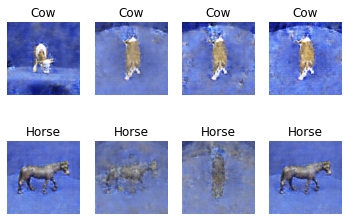

11401 [D loss: 0.073033, acc.: 96.88%] [G loss: 6.426699]
11402 [D loss: 0.050790, acc.: 98.44%] [G loss: 9.166285]
11403 [D loss: 0.061325, acc.: 98.44%] [G loss: 4.919217]
11404 [D loss: 0.162896, acc.: 90.62%] [G loss: 5.457357]
11405 [D loss: 0.096927, acc.: 96.88%] [G loss: 7.777785]
11406 [D loss: 0.040959, acc.: 98.44%] [G loss: 7.603200]
11407 [D loss: 0.048856, acc.: 98.44%] [G loss: 6.535555]
11408 [D loss: 0.065707, acc.: 98.44%] [G loss: 5.964758]
11409 [D loss: 0.061221, acc.: 96.88%] [G loss: 5.879837]
11410 [D loss: 0.112659, acc.: 96.88%] [G loss: 5.788562]
11411 [D loss: 0.049656, acc.: 98.44%] [G loss: 5.436246]
11412 [D loss: 0.089470, acc.: 98.44%] [G loss: 4.893261]
11413 [D loss: 0.006646, acc.: 100.00%] [G loss: 6.785752]
11414 [D loss: 0.125311, acc.: 96.88%] [G loss: 7.241458]
11415 [D loss: 0.019757, acc.: 100.00%] [G loss: 5.265379]
11416 [D loss: 0.067551, acc.: 96.88%] [G loss: 6.246886]
11417 [D loss: 0.295720, acc.: 90.62%] [G loss: 4.322623]
11418 [D los

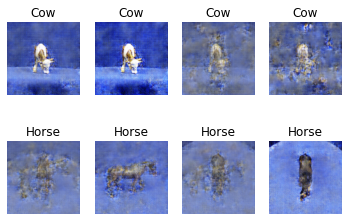

11501 [D loss: 0.057969, acc.: 98.44%] [G loss: 6.169494]
11502 [D loss: 0.015456, acc.: 100.00%] [G loss: 6.606836]
11503 [D loss: 0.018578, acc.: 100.00%] [G loss: 6.793068]
11504 [D loss: 0.080880, acc.: 96.88%] [G loss: 6.640958]
11505 [D loss: 0.064422, acc.: 98.44%] [G loss: 7.078746]
11506 [D loss: 0.019215, acc.: 100.00%] [G loss: 6.221354]
11507 [D loss: 0.107938, acc.: 96.88%] [G loss: 4.950590]
11508 [D loss: 0.060206, acc.: 98.44%] [G loss: 5.490894]
11509 [D loss: 0.206236, acc.: 95.31%] [G loss: 4.731937]
11510 [D loss: 0.032428, acc.: 100.00%] [G loss: 5.260530]
11511 [D loss: 0.195986, acc.: 95.31%] [G loss: 5.141361]
11512 [D loss: 0.028156, acc.: 100.00%] [G loss: 4.850476]
11513 [D loss: 0.033199, acc.: 98.44%] [G loss: 5.496305]
11514 [D loss: 0.122021, acc.: 96.88%] [G loss: 5.468185]
11515 [D loss: 0.045918, acc.: 98.44%] [G loss: 4.992785]
11516 [D loss: 0.057195, acc.: 98.44%] [G loss: 6.217190]
11517 [D loss: 0.108724, acc.: 96.88%] [G loss: 5.580030]
11518 [D 

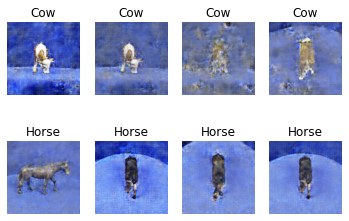

11601 [D loss: 0.151134, acc.: 93.75%] [G loss: 4.610156]
11602 [D loss: 0.045505, acc.: 100.00%] [G loss: 3.499808]
11603 [D loss: 0.079351, acc.: 96.88%] [G loss: 4.317751]
11604 [D loss: 0.021135, acc.: 98.44%] [G loss: 6.096329]
11605 [D loss: 0.070192, acc.: 98.44%] [G loss: 4.564244]
11606 [D loss: 0.105529, acc.: 96.88%] [G loss: 5.182641]
11607 [D loss: 0.054562, acc.: 96.88%] [G loss: 6.197450]
11608 [D loss: 0.292619, acc.: 93.75%] [G loss: 6.076482]
11609 [D loss: 0.133402, acc.: 95.31%] [G loss: 5.189957]
11610 [D loss: 0.103787, acc.: 95.31%] [G loss: 4.709665]
11611 [D loss: 0.037048, acc.: 98.44%] [G loss: 5.022166]
11612 [D loss: 0.094674, acc.: 96.88%] [G loss: 5.119298]
11613 [D loss: 0.144490, acc.: 95.31%] [G loss: 5.937824]
11614 [D loss: 0.135128, acc.: 92.19%] [G loss: 6.049904]
11615 [D loss: 0.081344, acc.: 98.44%] [G loss: 6.946833]
11616 [D loss: 0.068258, acc.: 96.88%] [G loss: 5.496906]
11617 [D loss: 0.159867, acc.: 95.31%] [G loss: 4.784268]
11618 [D loss

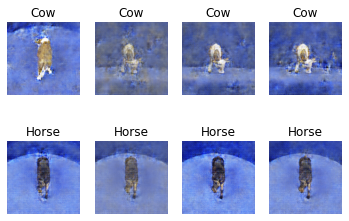

11701 [D loss: 0.100937, acc.: 96.88%] [G loss: 4.974221]
11702 [D loss: 0.126899, acc.: 98.44%] [G loss: 4.707377]
11703 [D loss: 0.025282, acc.: 100.00%] [G loss: 4.792313]
11704 [D loss: 0.103702, acc.: 95.31%] [G loss: 5.160272]
11705 [D loss: 0.030039, acc.: 98.44%] [G loss: 5.197983]
11706 [D loss: 0.129278, acc.: 95.31%] [G loss: 4.584052]
11707 [D loss: 0.037155, acc.: 100.00%] [G loss: 4.764487]
11708 [D loss: 0.223860, acc.: 93.75%] [G loss: 4.385311]
11709 [D loss: 0.126580, acc.: 95.31%] [G loss: 4.115983]
11710 [D loss: 0.071966, acc.: 96.88%] [G loss: 5.434100]
11711 [D loss: 0.145394, acc.: 96.88%] [G loss: 4.423910]
11712 [D loss: 0.056233, acc.: 96.88%] [G loss: 4.702428]
11713 [D loss: 0.091514, acc.: 98.44%] [G loss: 5.088616]
11714 [D loss: 0.062555, acc.: 98.44%] [G loss: 4.019940]
11715 [D loss: 0.076470, acc.: 96.88%] [G loss: 3.762110]
11716 [D loss: 0.055388, acc.: 96.88%] [G loss: 4.330894]
11717 [D loss: 0.091384, acc.: 96.88%] [G loss: 4.423028]
11718 [D los

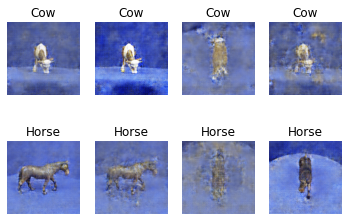

11801 [D loss: 0.023543, acc.: 98.44%] [G loss: 4.765406]
11802 [D loss: 0.062625, acc.: 98.44%] [G loss: 5.130167]
11803 [D loss: 0.086169, acc.: 98.44%] [G loss: 5.446820]
11804 [D loss: 0.086327, acc.: 98.44%] [G loss: 5.329272]
11805 [D loss: 0.067728, acc.: 96.88%] [G loss: 4.528474]
11806 [D loss: 0.050976, acc.: 98.44%] [G loss: 4.975570]
11807 [D loss: 0.020427, acc.: 100.00%] [G loss: 6.772942]
11808 [D loss: 0.027782, acc.: 100.00%] [G loss: 5.568607]
11809 [D loss: 0.167408, acc.: 95.31%] [G loss: 5.251599]
11810 [D loss: 0.072394, acc.: 98.44%] [G loss: 3.507469]
11811 [D loss: 0.070684, acc.: 98.44%] [G loss: 5.263462]
11812 [D loss: 0.123486, acc.: 95.31%] [G loss: 4.467160]
11813 [D loss: 0.060922, acc.: 96.88%] [G loss: 5.108229]
11814 [D loss: 0.092811, acc.: 98.44%] [G loss: 5.793700]
11815 [D loss: 0.011813, acc.: 100.00%] [G loss: 5.474795]
11816 [D loss: 0.089471, acc.: 96.88%] [G loss: 4.889604]
11817 [D loss: 0.241371, acc.: 93.75%] [G loss: 4.245916]
11818 [D lo

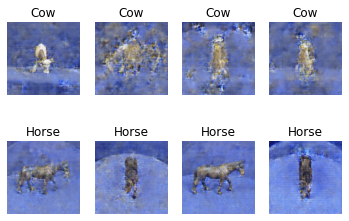

11901 [D loss: 0.067059, acc.: 96.88%] [G loss: 4.874382]
11902 [D loss: 0.200829, acc.: 93.75%] [G loss: 4.191568]
11903 [D loss: 0.077326, acc.: 96.88%] [G loss: 4.921338]
11904 [D loss: 0.025699, acc.: 100.00%] [G loss: 5.142142]
11905 [D loss: 0.165648, acc.: 95.31%] [G loss: 4.053065]
11906 [D loss: 0.083205, acc.: 96.88%] [G loss: 4.559246]
11907 [D loss: 0.120051, acc.: 96.88%] [G loss: 4.643086]
11908 [D loss: 0.052814, acc.: 98.44%] [G loss: 5.474944]
11909 [D loss: 0.104227, acc.: 96.88%] [G loss: 5.163668]
11910 [D loss: 0.164470, acc.: 93.75%] [G loss: 3.825469]
11911 [D loss: 0.054519, acc.: 98.44%] [G loss: 5.598653]
11912 [D loss: 0.127467, acc.: 95.31%] [G loss: 3.893677]
11913 [D loss: 0.057203, acc.: 96.88%] [G loss: 5.198997]
11914 [D loss: 0.142362, acc.: 95.31%] [G loss: 4.781297]
11915 [D loss: 0.136133, acc.: 92.19%] [G loss: 4.035159]
11916 [D loss: 0.057362, acc.: 98.44%] [G loss: 6.183558]
11917 [D loss: 0.028946, acc.: 98.44%] [G loss: 6.815319]
11918 [D loss

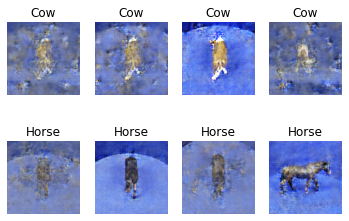

12001 [D loss: 0.197275, acc.: 96.88%] [G loss: 3.477992]
12002 [D loss: 0.049443, acc.: 98.44%] [G loss: 4.182608]
12003 [D loss: 0.164579, acc.: 90.62%] [G loss: 4.026013]
12004 [D loss: 0.094149, acc.: 96.88%] [G loss: 3.941153]
12005 [D loss: 0.015036, acc.: 100.00%] [G loss: 5.232328]
12006 [D loss: 0.081431, acc.: 96.88%] [G loss: 5.094408]
12007 [D loss: 0.136929, acc.: 96.88%] [G loss: 4.448384]
12008 [D loss: 0.027333, acc.: 98.44%] [G loss: 4.608539]
12009 [D loss: 0.035592, acc.: 98.44%] [G loss: 5.108555]
12010 [D loss: 0.163437, acc.: 95.31%] [G loss: 3.947345]
12011 [D loss: 0.164563, acc.: 92.19%] [G loss: 4.414413]
12012 [D loss: 0.055430, acc.: 98.44%] [G loss: 5.215719]
12013 [D loss: 0.092028, acc.: 95.31%] [G loss: 6.510285]
12014 [D loss: 0.108026, acc.: 95.31%] [G loss: 6.207910]
12015 [D loss: 0.288443, acc.: 93.75%] [G loss: 4.530907]
12016 [D loss: 0.058957, acc.: 100.00%] [G loss: 4.683674]
12017 [D loss: 0.111370, acc.: 96.88%] [G loss: 4.352215]
12018 [D los

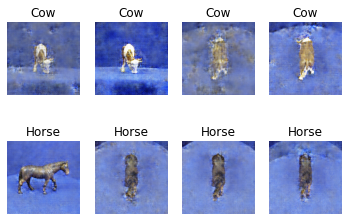

12101 [D loss: 0.309499, acc.: 89.06%] [G loss: 4.153107]
12102 [D loss: 0.167017, acc.: 96.88%] [G loss: 4.486128]
12103 [D loss: 0.068194, acc.: 98.44%] [G loss: 4.518637]
12104 [D loss: 0.123783, acc.: 95.31%] [G loss: 4.491589]
12105 [D loss: 0.043260, acc.: 100.00%] [G loss: 3.921805]
12106 [D loss: 0.086311, acc.: 96.88%] [G loss: 4.541473]
12107 [D loss: 0.099117, acc.: 96.88%] [G loss: 4.575204]
12108 [D loss: 0.104588, acc.: 96.88%] [G loss: 4.537443]
12109 [D loss: 0.190092, acc.: 90.62%] [G loss: 4.669142]
12110 [D loss: 0.033836, acc.: 100.00%] [G loss: 4.973196]
12111 [D loss: 0.061079, acc.: 98.44%] [G loss: 4.372867]
12112 [D loss: 0.094961, acc.: 98.44%] [G loss: 5.461473]
12113 [D loss: 0.038651, acc.: 98.44%] [G loss: 5.261957]
12114 [D loss: 0.164589, acc.: 93.75%] [G loss: 5.723899]
12115 [D loss: 0.116181, acc.: 95.31%] [G loss: 6.350550]
12116 [D loss: 0.147832, acc.: 93.75%] [G loss: 5.540960]
12117 [D loss: 0.045870, acc.: 98.44%] [G loss: 5.413221]
12118 [D los

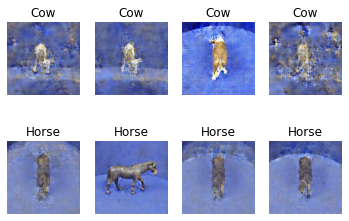

12201 [D loss: 0.082161, acc.: 98.44%] [G loss: 5.343966]
12202 [D loss: 0.065255, acc.: 98.44%] [G loss: 4.409025]
12203 [D loss: 0.067953, acc.: 96.88%] [G loss: 5.272740]
12204 [D loss: 0.215695, acc.: 95.31%] [G loss: 5.513409]
12205 [D loss: 0.114036, acc.: 96.88%] [G loss: 4.934282]
12206 [D loss: 0.120978, acc.: 96.88%] [G loss: 4.794428]
12207 [D loss: 0.130919, acc.: 95.31%] [G loss: 4.842451]
12208 [D loss: 0.128687, acc.: 96.88%] [G loss: 5.535162]
12209 [D loss: 0.043825, acc.: 98.44%] [G loss: 5.260610]
12210 [D loss: 0.061522, acc.: 96.88%] [G loss: 5.079263]
12211 [D loss: 0.117418, acc.: 96.88%] [G loss: 4.182334]
12212 [D loss: 0.034295, acc.: 100.00%] [G loss: 5.435533]
12213 [D loss: 0.057324, acc.: 98.44%] [G loss: 4.746151]
12214 [D loss: 0.110895, acc.: 93.75%] [G loss: 5.687930]
12215 [D loss: 0.040427, acc.: 98.44%] [G loss: 5.696925]
12216 [D loss: 0.051255, acc.: 98.44%] [G loss: 7.600029]
12217 [D loss: 0.177347, acc.: 95.31%] [G loss: 6.096420]
12218 [D loss

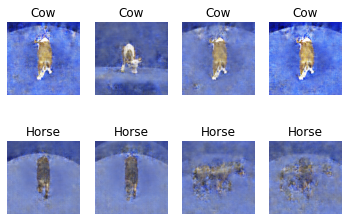

12301 [D loss: 0.067292, acc.: 96.88%] [G loss: 4.384621]
12302 [D loss: 0.110503, acc.: 96.88%] [G loss: 4.550799]
12303 [D loss: 0.029366, acc.: 100.00%] [G loss: 5.238770]
12304 [D loss: 0.147538, acc.: 95.31%] [G loss: 4.345724]
12305 [D loss: 0.213168, acc.: 92.19%] [G loss: 3.208718]
12306 [D loss: 0.067321, acc.: 98.44%] [G loss: 4.523631]
12307 [D loss: 0.032698, acc.: 98.44%] [G loss: 4.805623]
12308 [D loss: 0.139546, acc.: 93.75%] [G loss: 5.054118]
12309 [D loss: 0.077592, acc.: 98.44%] [G loss: 4.803083]
12310 [D loss: 0.422629, acc.: 87.50%] [G loss: 3.947471]
12311 [D loss: 0.091799, acc.: 96.88%] [G loss: 3.549357]
12312 [D loss: 0.032286, acc.: 100.00%] [G loss: 3.870425]
12313 [D loss: 0.126927, acc.: 95.31%] [G loss: 4.194243]
12314 [D loss: 0.048502, acc.: 100.00%] [G loss: 4.230083]
12315 [D loss: 0.011589, acc.: 100.00%] [G loss: 4.938538]
12316 [D loss: 0.005762, acc.: 100.00%] [G loss: 5.169543]
12317 [D loss: 0.094999, acc.: 95.31%] [G loss: 4.941321]
12318 [D 

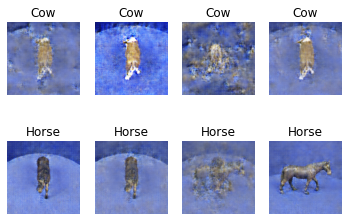

12401 [D loss: 0.094809, acc.: 96.88%] [G loss: 5.277971]
12402 [D loss: 0.032135, acc.: 100.00%] [G loss: 5.957633]
12403 [D loss: 0.031697, acc.: 98.44%] [G loss: 4.398521]
12404 [D loss: 0.142822, acc.: 95.31%] [G loss: 4.367581]
12405 [D loss: 0.295784, acc.: 89.06%] [G loss: 3.590123]
12406 [D loss: 0.086880, acc.: 98.44%] [G loss: 3.233495]
12407 [D loss: 0.163090, acc.: 93.75%] [G loss: 5.505917]
12408 [D loss: 0.310321, acc.: 93.75%] [G loss: 6.701946]
12409 [D loss: 0.042207, acc.: 98.44%] [G loss: 5.241528]
12410 [D loss: 0.193265, acc.: 93.75%] [G loss: 5.661959]
12411 [D loss: 0.087311, acc.: 98.44%] [G loss: 3.321080]
12412 [D loss: 0.072870, acc.: 98.44%] [G loss: 4.648540]
12413 [D loss: 0.081600, acc.: 98.44%] [G loss: 3.845119]
12414 [D loss: 0.017309, acc.: 100.00%] [G loss: 4.701791]
12415 [D loss: 0.178474, acc.: 95.31%] [G loss: 4.786847]
12416 [D loss: 0.052244, acc.: 98.44%] [G loss: 4.370978]
12417 [D loss: 0.189969, acc.: 93.75%] [G loss: 4.099702]
12418 [D los

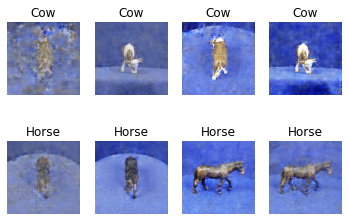

12501 [D loss: 0.141757, acc.: 93.75%] [G loss: 3.868986]
12502 [D loss: 0.057435, acc.: 98.44%] [G loss: 3.881047]
12503 [D loss: 0.117537, acc.: 96.88%] [G loss: 3.716017]
12504 [D loss: 0.055973, acc.: 98.44%] [G loss: 4.404335]
12505 [D loss: 0.106557, acc.: 96.88%] [G loss: 4.414943]
12506 [D loss: 0.055966, acc.: 98.44%] [G loss: 4.353299]
12507 [D loss: 0.089296, acc.: 96.88%] [G loss: 4.056113]
12508 [D loss: 0.127323, acc.: 98.44%] [G loss: 3.905555]
12509 [D loss: 0.176823, acc.: 93.75%] [G loss: 4.399562]
12510 [D loss: 0.098809, acc.: 95.31%] [G loss: 4.582439]
12511 [D loss: 0.091719, acc.: 98.44%] [G loss: 4.767874]
12512 [D loss: 0.073308, acc.: 98.44%] [G loss: 4.140345]
12513 [D loss: 0.052856, acc.: 98.44%] [G loss: 4.532174]
12514 [D loss: 0.091205, acc.: 98.44%] [G loss: 3.988731]
12515 [D loss: 0.107843, acc.: 95.31%] [G loss: 4.185148]
12516 [D loss: 0.151222, acc.: 93.75%] [G loss: 3.882861]
12517 [D loss: 0.147267, acc.: 95.31%] [G loss: 3.522477]
12518 [D loss:

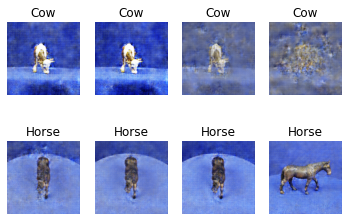

12601 [D loss: 0.120237, acc.: 95.31%] [G loss: 4.055489]
12602 [D loss: 0.169823, acc.: 93.75%] [G loss: 3.912892]
12603 [D loss: 0.132586, acc.: 96.88%] [G loss: 4.107702]
12604 [D loss: 0.047847, acc.: 98.44%] [G loss: 5.658211]
12605 [D loss: 0.218909, acc.: 93.75%] [G loss: 4.814381]
12606 [D loss: 0.118259, acc.: 96.88%] [G loss: 4.976577]
12607 [D loss: 0.116277, acc.: 95.31%] [G loss: 4.208398]
12608 [D loss: 0.147537, acc.: 93.75%] [G loss: 3.657893]
12609 [D loss: 0.156507, acc.: 93.75%] [G loss: 3.802507]
12610 [D loss: 0.130567, acc.: 96.88%] [G loss: 4.232631]
12611 [D loss: 0.057460, acc.: 98.44%] [G loss: 4.618950]
12612 [D loss: 0.097850, acc.: 93.75%] [G loss: 4.547570]
12613 [D loss: 0.083022, acc.: 96.88%] [G loss: 4.447672]
12614 [D loss: 0.178974, acc.: 95.31%] [G loss: 3.897256]
12615 [D loss: 0.086995, acc.: 98.44%] [G loss: 4.437488]
12616 [D loss: 0.117647, acc.: 96.88%] [G loss: 4.853827]
12617 [D loss: 0.103973, acc.: 96.88%] [G loss: 4.647452]
12618 [D loss:

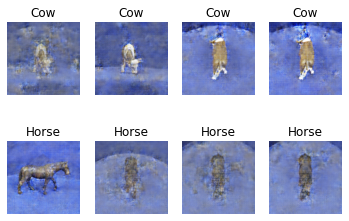

12701 [D loss: 0.103828, acc.: 95.31%] [G loss: 4.322124]
12702 [D loss: 0.112771, acc.: 96.88%] [G loss: 4.759121]
12703 [D loss: 0.015931, acc.: 100.00%] [G loss: 3.923220]
12704 [D loss: 0.171789, acc.: 96.88%] [G loss: 4.589732]
12705 [D loss: 0.068481, acc.: 96.88%] [G loss: 4.417175]
12706 [D loss: 0.022673, acc.: 100.00%] [G loss: 4.096021]
12707 [D loss: 0.037232, acc.: 98.44%] [G loss: 4.582590]
12708 [D loss: 0.037957, acc.: 98.44%] [G loss: 3.982622]
12709 [D loss: 0.092037, acc.: 98.44%] [G loss: 4.725370]
12710 [D loss: 0.139976, acc.: 95.31%] [G loss: 5.290008]
12711 [D loss: 0.086290, acc.: 98.44%] [G loss: 4.867221]
12712 [D loss: 0.081176, acc.: 96.88%] [G loss: 4.392550]
12713 [D loss: 0.094098, acc.: 96.88%] [G loss: 4.493122]
12714 [D loss: 0.076178, acc.: 96.88%] [G loss: 4.959203]
12715 [D loss: 0.118802, acc.: 98.44%] [G loss: 4.519307]
12716 [D loss: 0.098954, acc.: 95.31%] [G loss: 4.227580]
12717 [D loss: 0.102456, acc.: 96.88%] [G loss: 3.905854]
12718 [D los

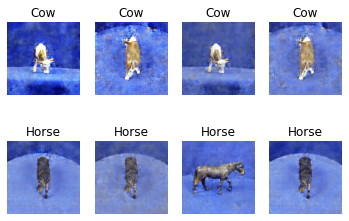

12801 [D loss: 0.139854, acc.: 96.88%] [G loss: 3.860509]
12802 [D loss: 0.025918, acc.: 100.00%] [G loss: 5.102187]
12803 [D loss: 0.123990, acc.: 98.44%] [G loss: 4.757770]
12804 [D loss: 0.190548, acc.: 93.75%] [G loss: 4.368170]
12805 [D loss: 0.089586, acc.: 98.44%] [G loss: 4.084324]
12806 [D loss: 0.069020, acc.: 96.88%] [G loss: 4.685441]
12807 [D loss: 0.049345, acc.: 98.44%] [G loss: 4.151818]
12808 [D loss: 0.032715, acc.: 100.00%] [G loss: 4.416148]
12809 [D loss: 0.292066, acc.: 92.19%] [G loss: 3.474936]
12810 [D loss: 0.206189, acc.: 93.75%] [G loss: 4.246801]
12811 [D loss: 0.125865, acc.: 95.31%] [G loss: 4.009168]
12812 [D loss: 0.181038, acc.: 95.31%] [G loss: 3.890555]
12813 [D loss: 0.106180, acc.: 96.88%] [G loss: 3.300681]
12814 [D loss: 0.115072, acc.: 96.88%] [G loss: 4.355167]
12815 [D loss: 0.046739, acc.: 98.44%] [G loss: 4.507504]
12816 [D loss: 0.116226, acc.: 95.31%] [G loss: 4.684722]
12817 [D loss: 0.063976, acc.: 98.44%] [G loss: 4.185200]
12818 [D los

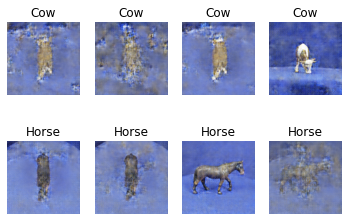

12901 [D loss: 0.117210, acc.: 98.44%] [G loss: 4.480322]
12902 [D loss: 0.106424, acc.: 96.88%] [G loss: 4.565995]
12903 [D loss: 0.144703, acc.: 95.31%] [G loss: 4.806845]
12904 [D loss: 0.242957, acc.: 93.75%] [G loss: 4.558086]
12905 [D loss: 0.167355, acc.: 93.75%] [G loss: 4.112912]
12906 [D loss: 0.178997, acc.: 95.31%] [G loss: 4.358850]
12907 [D loss: 0.158460, acc.: 93.75%] [G loss: 4.103797]
12908 [D loss: 0.132852, acc.: 96.88%] [G loss: 3.934815]
12909 [D loss: 0.071992, acc.: 95.31%] [G loss: 4.650180]
12910 [D loss: 0.157077, acc.: 93.75%] [G loss: 4.511032]
12911 [D loss: 0.031324, acc.: 98.44%] [G loss: 6.313591]
12912 [D loss: 0.017443, acc.: 100.00%] [G loss: 6.351517]
12913 [D loss: 0.055335, acc.: 98.44%] [G loss: 5.297670]
12914 [D loss: 0.086549, acc.: 96.88%] [G loss: 5.064622]
12915 [D loss: 0.006975, acc.: 100.00%] [G loss: 6.177088]
12916 [D loss: 0.039907, acc.: 98.44%] [G loss: 4.983082]
12917 [D loss: 0.131810, acc.: 95.31%] [G loss: 4.823424]
12918 [D los

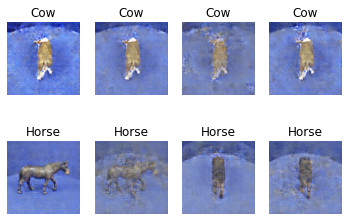

13001 [D loss: 0.013788, acc.: 100.00%] [G loss: 5.062375]
13002 [D loss: 0.007826, acc.: 100.00%] [G loss: 4.959410]
13003 [D loss: 0.444712, acc.: 90.62%] [G loss: 6.747639]
13004 [D loss: 0.237041, acc.: 87.50%] [G loss: 5.096829]
13005 [D loss: 0.012673, acc.: 100.00%] [G loss: 5.245141]
13006 [D loss: 0.072289, acc.: 96.88%] [G loss: 4.391442]
13007 [D loss: 0.215504, acc.: 95.31%] [G loss: 4.126047]
13008 [D loss: 0.043450, acc.: 98.44%] [G loss: 3.598276]
13009 [D loss: 0.103636, acc.: 96.88%] [G loss: 4.461593]
13010 [D loss: 0.024769, acc.: 100.00%] [G loss: 4.499631]
13011 [D loss: 0.084982, acc.: 96.88%] [G loss: 4.304029]
13012 [D loss: 0.024442, acc.: 100.00%] [G loss: 4.834572]
13013 [D loss: 0.077188, acc.: 98.44%] [G loss: 3.562208]
13014 [D loss: 0.015086, acc.: 100.00%] [G loss: 3.804111]
13015 [D loss: 0.197651, acc.: 95.31%] [G loss: 3.311342]
13016 [D loss: 0.020908, acc.: 100.00%] [G loss: 4.071137]
13017 [D loss: 0.170204, acc.: 93.75%] [G loss: 3.644641]
13018 [

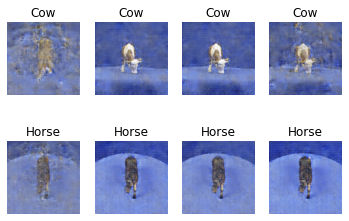

13101 [D loss: 0.135647, acc.: 95.31%] [G loss: 4.027133]
13102 [D loss: 0.085054, acc.: 96.88%] [G loss: 4.923753]
13103 [D loss: 0.048954, acc.: 98.44%] [G loss: 4.525076]
13104 [D loss: 0.230940, acc.: 93.75%] [G loss: 5.054680]
13105 [D loss: 0.066388, acc.: 98.44%] [G loss: 4.801992]
13106 [D loss: 0.083558, acc.: 96.88%] [G loss: 5.336704]
13107 [D loss: 0.035707, acc.: 98.44%] [G loss: 4.707198]
13108 [D loss: 0.183231, acc.: 93.75%] [G loss: 4.151925]
13109 [D loss: 0.078398, acc.: 96.88%] [G loss: 4.319973]
13110 [D loss: 0.058805, acc.: 96.88%] [G loss: 4.381565]
13111 [D loss: 0.054994, acc.: 96.88%] [G loss: 4.558264]
13112 [D loss: 0.182773, acc.: 95.31%] [G loss: 3.765573]
13113 [D loss: 0.050208, acc.: 98.44%] [G loss: 4.456468]
13114 [D loss: 0.366104, acc.: 89.06%] [G loss: 3.894097]
13115 [D loss: 0.187712, acc.: 93.75%] [G loss: 3.938535]
13116 [D loss: 0.070390, acc.: 98.44%] [G loss: 4.947207]
13117 [D loss: 0.156817, acc.: 95.31%] [G loss: 4.473199]
13118 [D loss:

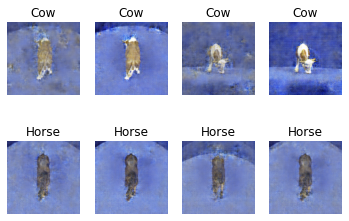

13201 [D loss: 0.066361, acc.: 98.44%] [G loss: 3.951676]
13202 [D loss: 0.122681, acc.: 95.31%] [G loss: 4.069281]
13203 [D loss: 0.103740, acc.: 96.88%] [G loss: 3.423192]
13204 [D loss: 0.318200, acc.: 90.62%] [G loss: 3.807879]
13205 [D loss: 0.081595, acc.: 98.44%] [G loss: 3.788414]
13206 [D loss: 0.161560, acc.: 95.31%] [G loss: 4.186637]
13207 [D loss: 0.100309, acc.: 96.88%] [G loss: 3.800545]
13208 [D loss: 0.051401, acc.: 98.44%] [G loss: 4.150458]
13209 [D loss: 0.034820, acc.: 100.00%] [G loss: 4.206329]
13210 [D loss: 0.123192, acc.: 96.88%] [G loss: 3.797441]
13211 [D loss: 0.054326, acc.: 98.44%] [G loss: 4.014292]
13212 [D loss: 0.134010, acc.: 95.31%] [G loss: 3.939162]
13213 [D loss: 0.154334, acc.: 96.88%] [G loss: 3.624783]
13214 [D loss: 0.120463, acc.: 96.88%] [G loss: 3.443819]
13215 [D loss: 0.057868, acc.: 98.44%] [G loss: 3.885970]
13216 [D loss: 0.096739, acc.: 95.31%] [G loss: 4.001118]
13217 [D loss: 0.153091, acc.: 95.31%] [G loss: 3.578421]
13218 [D loss

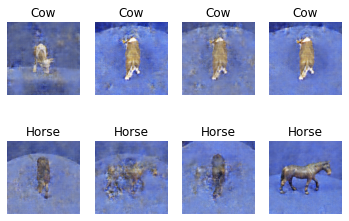

13301 [D loss: 0.032769, acc.: 98.44%] [G loss: 5.038084]
13302 [D loss: 0.047090, acc.: 98.44%] [G loss: 5.345859]
13303 [D loss: 0.089191, acc.: 98.44%] [G loss: 4.381768]
13304 [D loss: 0.021516, acc.: 100.00%] [G loss: 4.597955]
13305 [D loss: 0.171204, acc.: 93.75%] [G loss: 4.793030]
13306 [D loss: 0.078592, acc.: 98.44%] [G loss: 3.569125]
13307 [D loss: 0.112501, acc.: 96.88%] [G loss: 4.550879]
13308 [D loss: 0.049139, acc.: 98.44%] [G loss: 4.202152]
13309 [D loss: 0.020510, acc.: 100.00%] [G loss: 4.520269]
13310 [D loss: 0.075697, acc.: 98.44%] [G loss: 4.493391]
13311 [D loss: 0.081774, acc.: 98.44%] [G loss: 4.572017]
13312 [D loss: 0.062642, acc.: 98.44%] [G loss: 4.428739]
13313 [D loss: 0.134756, acc.: 96.88%] [G loss: 4.083684]
13314 [D loss: 0.178016, acc.: 95.31%] [G loss: 3.905818]
13315 [D loss: 0.147399, acc.: 96.88%] [G loss: 3.332354]
13316 [D loss: 0.034157, acc.: 100.00%] [G loss: 4.058198]
13317 [D loss: 0.073606, acc.: 98.44%] [G loss: 4.778155]
13318 [D lo

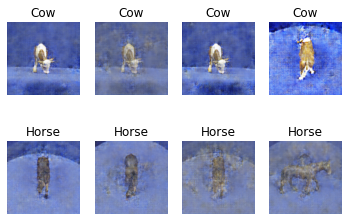

13401 [D loss: 0.156993, acc.: 95.31%] [G loss: 5.242079]
13402 [D loss: 0.040207, acc.: 98.44%] [G loss: 5.555621]
13403 [D loss: 0.083030, acc.: 96.88%] [G loss: 5.310956]
13404 [D loss: 0.053996, acc.: 96.88%] [G loss: 3.957531]
13405 [D loss: 0.201194, acc.: 93.75%] [G loss: 5.428655]
13406 [D loss: 0.146114, acc.: 96.88%] [G loss: 3.797031]
13407 [D loss: 0.070239, acc.: 96.88%] [G loss: 4.865582]
13408 [D loss: 0.033676, acc.: 100.00%] [G loss: 4.274455]
13409 [D loss: 0.160480, acc.: 95.31%] [G loss: 4.112359]
13410 [D loss: 0.120164, acc.: 96.88%] [G loss: 4.856052]
13411 [D loss: 0.082234, acc.: 98.44%] [G loss: 4.663533]
13412 [D loss: 0.138135, acc.: 95.31%] [G loss: 4.392896]
13413 [D loss: 0.065498, acc.: 98.44%] [G loss: 5.251434]
13414 [D loss: 0.051899, acc.: 98.44%] [G loss: 4.393885]
13415 [D loss: 0.031648, acc.: 98.44%] [G loss: 4.830109]
13416 [D loss: 0.145420, acc.: 95.31%] [G loss: 4.559437]
13417 [D loss: 0.056254, acc.: 98.44%] [G loss: 5.517411]
13418 [D loss

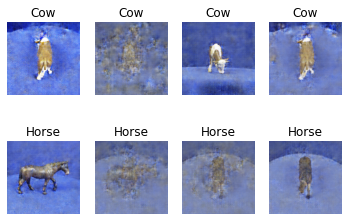

13501 [D loss: 0.026297, acc.: 100.00%] [G loss: 5.123644]
13502 [D loss: 0.039518, acc.: 98.44%] [G loss: 4.800150]
13503 [D loss: 0.184743, acc.: 95.31%] [G loss: 4.432979]
13504 [D loss: 0.031887, acc.: 100.00%] [G loss: 4.509206]
13505 [D loss: 0.080848, acc.: 96.88%] [G loss: 5.118365]
13506 [D loss: 0.051459, acc.: 98.44%] [G loss: 7.136348]
13507 [D loss: 0.038118, acc.: 98.44%] [G loss: 5.700690]
13508 [D loss: 0.033265, acc.: 98.44%] [G loss: 6.022483]
13509 [D loss: 0.103222, acc.: 96.88%] [G loss: 6.303464]
13510 [D loss: 0.019502, acc.: 100.00%] [G loss: 5.081857]
13511 [D loss: 0.151400, acc.: 95.31%] [G loss: 4.642464]
13512 [D loss: 0.071881, acc.: 98.44%] [G loss: 5.090569]
13513 [D loss: 0.136595, acc.: 95.31%] [G loss: 3.997253]
13514 [D loss: 0.030931, acc.: 100.00%] [G loss: 3.887418]
13515 [D loss: 0.055798, acc.: 98.44%] [G loss: 4.477372]
13516 [D loss: 0.073151, acc.: 98.44%] [G loss: 4.707361]
13517 [D loss: 0.067537, acc.: 98.44%] [G loss: 5.868761]
13518 [D l

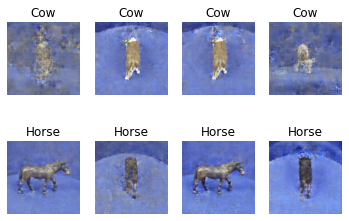

13601 [D loss: 0.089247, acc.: 96.88%] [G loss: 3.664755]
13602 [D loss: 0.161297, acc.: 96.88%] [G loss: 4.159043]
13603 [D loss: 0.070832, acc.: 98.44%] [G loss: 3.649896]
13604 [D loss: 0.129480, acc.: 95.31%] [G loss: 3.878892]
13605 [D loss: 0.024190, acc.: 100.00%] [G loss: 4.656613]
13606 [D loss: 0.195203, acc.: 93.75%] [G loss: 3.754475]
13607 [D loss: 0.076444, acc.: 98.44%] [G loss: 4.001517]
13608 [D loss: 0.060738, acc.: 98.44%] [G loss: 4.087758]
13609 [D loss: 0.281269, acc.: 90.62%] [G loss: 4.019258]
13610 [D loss: 0.203558, acc.: 93.75%] [G loss: 3.138398]
13611 [D loss: 0.082397, acc.: 98.44%] [G loss: 3.429849]
13612 [D loss: 0.064215, acc.: 98.44%] [G loss: 3.942192]
13613 [D loss: 0.087968, acc.: 96.88%] [G loss: 3.874234]
13614 [D loss: 0.046629, acc.: 98.44%] [G loss: 4.112414]
13615 [D loss: 0.014711, acc.: 100.00%] [G loss: 4.400183]
13616 [D loss: 0.056704, acc.: 98.44%] [G loss: 4.803931]
13617 [D loss: 0.207879, acc.: 93.75%] [G loss: 4.251572]
13618 [D los

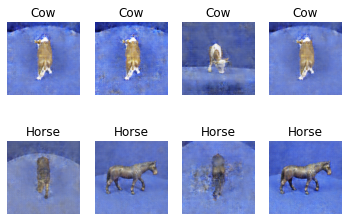

13701 [D loss: 0.117606, acc.: 95.31%] [G loss: 4.229588]
13702 [D loss: 0.098263, acc.: 95.31%] [G loss: 4.989037]
13703 [D loss: 0.029991, acc.: 100.00%] [G loss: 4.462535]
13704 [D loss: 0.042731, acc.: 98.44%] [G loss: 4.907793]
13705 [D loss: 0.372366, acc.: 89.06%] [G loss: 3.838252]
13706 [D loss: 0.148072, acc.: 95.31%] [G loss: 2.764593]
13707 [D loss: 0.050476, acc.: 98.44%] [G loss: 4.286168]
13708 [D loss: 0.193854, acc.: 93.75%] [G loss: 3.964431]
13709 [D loss: 0.100892, acc.: 95.31%] [G loss: 4.066396]
13710 [D loss: 0.169678, acc.: 95.31%] [G loss: 3.648184]
13711 [D loss: 0.121479, acc.: 95.31%] [G loss: 3.629316]
13712 [D loss: 0.204867, acc.: 92.19%] [G loss: 4.132700]
13713 [D loss: 0.099710, acc.: 95.31%] [G loss: 4.050113]
13714 [D loss: 0.164306, acc.: 95.31%] [G loss: 4.589345]
13715 [D loss: 0.121481, acc.: 96.88%] [G loss: 4.523179]
13716 [D loss: 0.130355, acc.: 95.31%] [G loss: 4.450794]
13717 [D loss: 0.083286, acc.: 96.88%] [G loss: 4.569628]
13718 [D loss

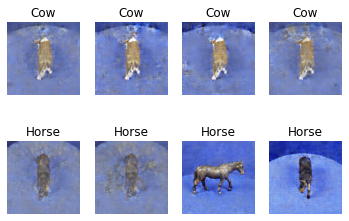

13801 [D loss: 0.149308, acc.: 95.31%] [G loss: 3.641047]
13802 [D loss: 0.041908, acc.: 98.44%] [G loss: 5.385164]
13803 [D loss: 0.089377, acc.: 95.31%] [G loss: 5.541345]
13804 [D loss: 0.027110, acc.: 100.00%] [G loss: 4.485308]
13805 [D loss: 0.095969, acc.: 96.88%] [G loss: 4.735403]
13806 [D loss: 0.121531, acc.: 98.44%] [G loss: 4.208489]
13807 [D loss: 0.048950, acc.: 98.44%] [G loss: 4.772462]
13808 [D loss: 0.081833, acc.: 98.44%] [G loss: 4.494950]
13809 [D loss: 0.188650, acc.: 95.31%] [G loss: 4.977684]
13810 [D loss: 0.038736, acc.: 100.00%] [G loss: 5.024385]
13811 [D loss: 0.190388, acc.: 95.31%] [G loss: 4.488528]
13812 [D loss: 0.044799, acc.: 100.00%] [G loss: 4.725193]
13813 [D loss: 0.112419, acc.: 96.88%] [G loss: 3.849674]
13814 [D loss: 0.089331, acc.: 98.44%] [G loss: 3.433761]
13815 [D loss: 0.053179, acc.: 98.44%] [G loss: 3.623076]
13816 [D loss: 0.085491, acc.: 98.44%] [G loss: 4.188089]
13817 [D loss: 0.056788, acc.: 96.88%] [G loss: 5.426152]
13818 [D lo

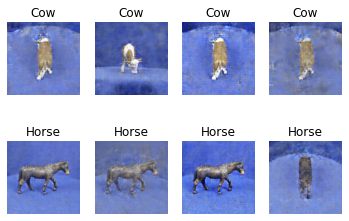

13901 [D loss: 0.079589, acc.: 96.88%] [G loss: 3.830692]
13902 [D loss: 0.115144, acc.: 96.88%] [G loss: 3.753492]
13903 [D loss: 0.109725, acc.: 96.88%] [G loss: 4.654243]
13904 [D loss: 0.023396, acc.: 100.00%] [G loss: 3.988812]
13905 [D loss: 0.076847, acc.: 96.88%] [G loss: 3.777777]
13906 [D loss: 0.193414, acc.: 95.31%] [G loss: 4.115108]
13907 [D loss: 0.067694, acc.: 98.44%] [G loss: 5.038313]
13908 [D loss: 0.023544, acc.: 100.00%] [G loss: 4.211870]
13909 [D loss: 0.095792, acc.: 96.88%] [G loss: 4.607019]
13910 [D loss: 0.190949, acc.: 93.75%] [G loss: 4.227781]
13911 [D loss: 0.179554, acc.: 92.19%] [G loss: 3.507838]
13912 [D loss: 0.180859, acc.: 95.31%] [G loss: 3.464965]
13913 [D loss: 0.111404, acc.: 96.88%] [G loss: 3.194629]
13914 [D loss: 0.081976, acc.: 96.88%] [G loss: 3.782873]
13915 [D loss: 0.189829, acc.: 93.75%] [G loss: 4.194357]
13916 [D loss: 0.039083, acc.: 98.44%] [G loss: 4.880841]
13917 [D loss: 0.035340, acc.: 100.00%] [G loss: 4.749919]
13918 [D lo

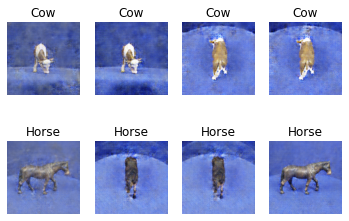

14001 [D loss: 0.064384, acc.: 98.44%] [G loss: 4.012989]
14002 [D loss: 0.054728, acc.: 96.88%] [G loss: 4.720644]
14003 [D loss: 0.195243, acc.: 92.19%] [G loss: 4.883094]
14004 [D loss: 0.094770, acc.: 96.88%] [G loss: 3.675652]
14005 [D loss: 0.135809, acc.: 95.31%] [G loss: 4.376814]
14006 [D loss: 0.120203, acc.: 96.88%] [G loss: 3.966685]
14007 [D loss: 0.076942, acc.: 96.88%] [G loss: 3.794283]
14008 [D loss: 0.135075, acc.: 95.31%] [G loss: 4.000180]
14009 [D loss: 0.232501, acc.: 92.19%] [G loss: 4.826348]
14010 [D loss: 0.040904, acc.: 98.44%] [G loss: 4.849805]
14011 [D loss: 0.097263, acc.: 98.44%] [G loss: 3.992781]
14012 [D loss: 0.070084, acc.: 96.88%] [G loss: 5.253104]
14013 [D loss: 0.166184, acc.: 93.75%] [G loss: 6.423208]
14014 [D loss: 0.030738, acc.: 100.00%] [G loss: 3.747030]
14015 [D loss: 0.034052, acc.: 100.00%] [G loss: 4.771416]
14016 [D loss: 0.068277, acc.: 98.44%] [G loss: 4.873210]
14017 [D loss: 0.128393, acc.: 95.31%] [G loss: 4.346675]
14018 [D los

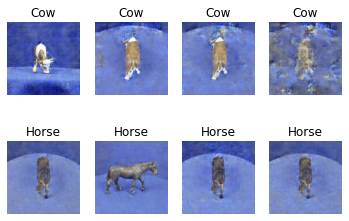

14101 [D loss: 0.102061, acc.: 96.88%] [G loss: 5.428792]
14102 [D loss: 0.025977, acc.: 100.00%] [G loss: 4.817275]
14103 [D loss: 0.137628, acc.: 96.88%] [G loss: 6.141129]
14104 [D loss: 0.123760, acc.: 96.88%] [G loss: 4.675363]
14105 [D loss: 0.048259, acc.: 98.44%] [G loss: 4.241967]
14106 [D loss: 0.053335, acc.: 98.44%] [G loss: 4.460487]
14107 [D loss: 0.127758, acc.: 96.88%] [G loss: 4.338016]
14108 [D loss: 0.105897, acc.: 96.88%] [G loss: 3.609900]
14109 [D loss: 0.121006, acc.: 93.75%] [G loss: 4.238321]
14110 [D loss: 0.024517, acc.: 100.00%] [G loss: 4.776803]
14111 [D loss: 0.156846, acc.: 95.31%] [G loss: 3.970055]
14112 [D loss: 0.065476, acc.: 98.44%] [G loss: 3.928599]
14113 [D loss: 0.229867, acc.: 92.19%] [G loss: 4.004892]
14114 [D loss: 0.096208, acc.: 95.31%] [G loss: 3.992407]
14115 [D loss: 0.174928, acc.: 93.75%] [G loss: 3.273247]
14116 [D loss: 0.082942, acc.: 98.44%] [G loss: 4.399044]
14117 [D loss: 0.179837, acc.: 93.75%] [G loss: 3.779231]
14118 [D los

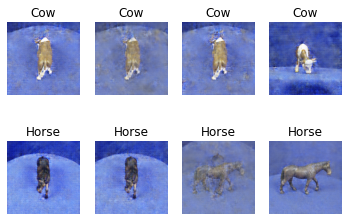

14201 [D loss: 0.206890, acc.: 95.31%] [G loss: 3.688045]
14202 [D loss: 0.139574, acc.: 95.31%] [G loss: 4.363478]
14203 [D loss: 0.069950, acc.: 98.44%] [G loss: 3.364765]
14204 [D loss: 0.124679, acc.: 95.31%] [G loss: 3.877983]
14205 [D loss: 0.172090, acc.: 95.31%] [G loss: 4.004472]
14206 [D loss: 0.117398, acc.: 96.88%] [G loss: 4.030517]
14207 [D loss: 0.093949, acc.: 98.44%] [G loss: 4.088125]
14208 [D loss: 0.060307, acc.: 98.44%] [G loss: 3.664067]
14209 [D loss: 0.073071, acc.: 98.44%] [G loss: 4.477069]
14210 [D loss: 0.020348, acc.: 100.00%] [G loss: 4.419757]
14211 [D loss: 0.032218, acc.: 98.44%] [G loss: 3.964359]
14212 [D loss: 0.056346, acc.: 98.44%] [G loss: 4.423671]
14213 [D loss: 0.016561, acc.: 100.00%] [G loss: 4.616859]
14214 [D loss: 0.298943, acc.: 93.75%] [G loss: 3.429548]
14215 [D loss: 0.125475, acc.: 96.88%] [G loss: 4.340640]
14216 [D loss: 0.068502, acc.: 98.44%] [G loss: 3.957007]
14217 [D loss: 0.018676, acc.: 100.00%] [G loss: 4.140441]
14218 [D lo

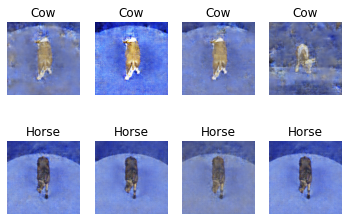

14301 [D loss: 0.209204, acc.: 93.75%] [G loss: 4.162902]
14302 [D loss: 0.117225, acc.: 96.88%] [G loss: 4.210236]
14303 [D loss: 0.111035, acc.: 96.88%] [G loss: 3.541090]
14304 [D loss: 0.126743, acc.: 96.88%] [G loss: 5.442908]
14305 [D loss: 0.016145, acc.: 100.00%] [G loss: 5.577894]
14306 [D loss: 0.082171, acc.: 98.44%] [G loss: 4.587583]
14307 [D loss: 0.125417, acc.: 93.75%] [G loss: 5.076423]
14308 [D loss: 0.107279, acc.: 93.75%] [G loss: 4.459426]
14309 [D loss: 0.163920, acc.: 95.31%] [G loss: 3.263100]
14310 [D loss: 0.083365, acc.: 95.31%] [G loss: 3.778502]
14311 [D loss: 0.081566, acc.: 96.88%] [G loss: 4.404067]
14312 [D loss: 0.093972, acc.: 96.88%] [G loss: 3.642601]
14313 [D loss: 0.160943, acc.: 95.31%] [G loss: 3.792404]
14314 [D loss: 0.011504, acc.: 100.00%] [G loss: 4.262494]
14315 [D loss: 0.111510, acc.: 96.88%] [G loss: 4.879899]
14316 [D loss: 0.052905, acc.: 96.88%] [G loss: 4.449671]
14317 [D loss: 0.170398, acc.: 95.31%] [G loss: 4.730968]
14318 [D los

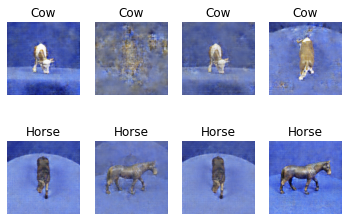

14401 [D loss: 0.065023, acc.: 98.44%] [G loss: 5.626660]
14402 [D loss: 0.189805, acc.: 93.75%] [G loss: 3.716241]
14403 [D loss: 0.103082, acc.: 98.44%] [G loss: 3.906600]
14404 [D loss: 0.106324, acc.: 96.88%] [G loss: 4.133106]
14405 [D loss: 0.077167, acc.: 98.44%] [G loss: 4.634385]
14406 [D loss: 0.045034, acc.: 100.00%] [G loss: 4.341446]
14407 [D loss: 0.104799, acc.: 96.88%] [G loss: 4.845023]
14408 [D loss: 0.073752, acc.: 98.44%] [G loss: 4.195990]
14409 [D loss: 0.030958, acc.: 98.44%] [G loss: 4.245107]
14410 [D loss: 0.016916, acc.: 100.00%] [G loss: 4.594280]
14411 [D loss: 0.010925, acc.: 100.00%] [G loss: 5.257485]
14412 [D loss: 0.132797, acc.: 96.88%] [G loss: 4.280824]
14413 [D loss: 0.012722, acc.: 100.00%] [G loss: 5.113792]
14414 [D loss: 0.011906, acc.: 100.00%] [G loss: 4.738644]
14415 [D loss: 0.064594, acc.: 98.44%] [G loss: 4.774460]
14416 [D loss: 0.048878, acc.: 98.44%] [G loss: 4.913672]
14417 [D loss: 0.155980, acc.: 96.88%] [G loss: 4.525693]
14418 [D 

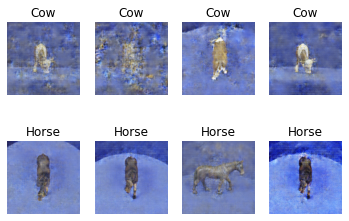

14501 [D loss: 0.233449, acc.: 93.75%] [G loss: 3.889254]
14502 [D loss: 0.027520, acc.: 100.00%] [G loss: 4.522243]
14503 [D loss: 0.073499, acc.: 98.44%] [G loss: 4.151211]
14504 [D loss: 0.055689, acc.: 98.44%] [G loss: 4.556044]
14505 [D loss: 0.250887, acc.: 92.19%] [G loss: 3.533239]
14506 [D loss: 0.249242, acc.: 90.62%] [G loss: 3.737381]
14507 [D loss: 0.176032, acc.: 95.31%] [G loss: 3.791715]
14508 [D loss: 0.190325, acc.: 92.19%] [G loss: 3.543610]
14509 [D loss: 0.061571, acc.: 98.44%] [G loss: 3.339476]
14510 [D loss: 0.078110, acc.: 96.88%] [G loss: 4.253105]
14511 [D loss: 0.027781, acc.: 100.00%] [G loss: 4.504215]
14512 [D loss: 0.217649, acc.: 93.75%] [G loss: 3.839767]
14513 [D loss: 0.058720, acc.: 98.44%] [G loss: 3.968142]
14514 [D loss: 0.083380, acc.: 98.44%] [G loss: 4.390622]
14515 [D loss: 0.100477, acc.: 95.31%] [G loss: 5.369506]
14516 [D loss: 0.250124, acc.: 95.31%] [G loss: 5.162828]
14517 [D loss: 0.103568, acc.: 96.88%] [G loss: 4.583962]
14518 [D los

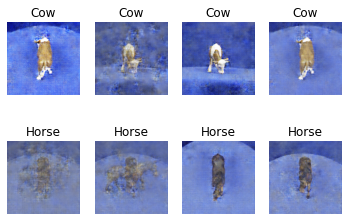

14601 [D loss: 0.039519, acc.: 100.00%] [G loss: 3.901800]
14602 [D loss: 0.127049, acc.: 93.75%] [G loss: 3.769943]
14603 [D loss: 0.037827, acc.: 98.44%] [G loss: 4.835358]
14604 [D loss: 0.081926, acc.: 98.44%] [G loss: 5.099545]
14605 [D loss: 0.277985, acc.: 90.62%] [G loss: 4.220729]
14606 [D loss: 0.038984, acc.: 100.00%] [G loss: 4.110877]
14607 [D loss: 0.112408, acc.: 95.31%] [G loss: 4.138906]
14608 [D loss: 0.046214, acc.: 98.44%] [G loss: 4.207281]
14609 [D loss: 0.104188, acc.: 95.31%] [G loss: 4.636227]
14610 [D loss: 0.231322, acc.: 92.19%] [G loss: 4.090758]
14611 [D loss: 0.109985, acc.: 96.88%] [G loss: 4.654301]
14612 [D loss: 0.126064, acc.: 95.31%] [G loss: 3.435072]
14613 [D loss: 0.114945, acc.: 96.88%] [G loss: 3.517791]
14614 [D loss: 0.213425, acc.: 93.75%] [G loss: 4.321928]
14615 [D loss: 0.105528, acc.: 96.88%] [G loss: 5.135389]
14616 [D loss: 0.076982, acc.: 96.88%] [G loss: 3.869252]
14617 [D loss: 0.072357, acc.: 98.44%] [G loss: 4.296929]
14618 [D los

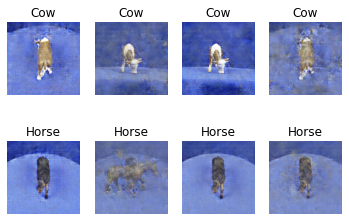

14701 [D loss: 0.179277, acc.: 95.31%] [G loss: 3.631244]
14702 [D loss: 0.089805, acc.: 96.88%] [G loss: 3.999787]
14703 [D loss: 0.153884, acc.: 95.31%] [G loss: 5.749682]
14704 [D loss: 0.128777, acc.: 95.31%] [G loss: 4.260440]
14705 [D loss: 0.135353, acc.: 96.88%] [G loss: 4.263159]
14706 [D loss: 0.157804, acc.: 93.75%] [G loss: 3.756094]
14707 [D loss: 0.043760, acc.: 100.00%] [G loss: 3.738349]
14708 [D loss: 0.176490, acc.: 93.75%] [G loss: 4.246244]
14709 [D loss: 0.071963, acc.: 98.44%] [G loss: 4.418289]
14710 [D loss: 0.166754, acc.: 95.31%] [G loss: 3.472459]
14711 [D loss: 0.077637, acc.: 98.44%] [G loss: 3.702520]
14712 [D loss: 0.105989, acc.: 96.88%] [G loss: 3.942649]
14713 [D loss: 0.150255, acc.: 95.31%] [G loss: 3.356724]
14714 [D loss: 0.286779, acc.: 92.19%] [G loss: 3.679348]
14715 [D loss: 0.168645, acc.: 93.75%] [G loss: 4.183747]
14716 [D loss: 0.072830, acc.: 98.44%] [G loss: 3.395246]
14717 [D loss: 0.206710, acc.: 93.75%] [G loss: 3.027373]
14718 [D loss

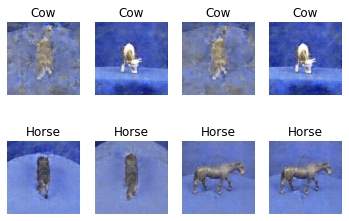

14801 [D loss: 0.388832, acc.: 92.19%] [G loss: 3.715126]
14802 [D loss: 0.202781, acc.: 92.19%] [G loss: 4.633387]
14803 [D loss: 0.036246, acc.: 100.00%] [G loss: 3.504375]
14804 [D loss: 0.056277, acc.: 96.88%] [G loss: 4.553061]
14805 [D loss: 0.078772, acc.: 98.44%] [G loss: 4.228364]
14806 [D loss: 0.087743, acc.: 96.88%] [G loss: 4.665050]
14807 [D loss: 0.132173, acc.: 95.31%] [G loss: 5.387014]
14808 [D loss: 0.177375, acc.: 95.31%] [G loss: 2.929503]
14809 [D loss: 0.063181, acc.: 98.44%] [G loss: 3.659176]
14810 [D loss: 0.041312, acc.: 100.00%] [G loss: 3.715752]
14811 [D loss: 0.070261, acc.: 98.44%] [G loss: 4.059806]
14812 [D loss: 0.063949, acc.: 98.44%] [G loss: 4.208782]
14813 [D loss: 0.012447, acc.: 100.00%] [G loss: 6.567041]
14814 [D loss: 0.140660, acc.: 95.31%] [G loss: 3.702575]
14815 [D loss: 0.213028, acc.: 93.75%] [G loss: 3.971966]
14816 [D loss: 0.067780, acc.: 98.44%] [G loss: 3.917019]
14817 [D loss: 0.105657, acc.: 96.88%] [G loss: 4.222548]
14818 [D lo

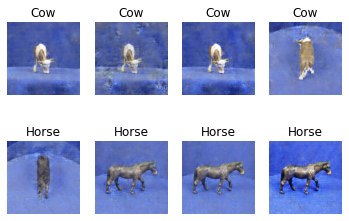

14901 [D loss: 0.163151, acc.: 95.31%] [G loss: 3.987209]
14902 [D loss: 0.054483, acc.: 98.44%] [G loss: 4.483679]
14903 [D loss: 0.144116, acc.: 95.31%] [G loss: 3.420994]
14904 [D loss: 0.088811, acc.: 96.88%] [G loss: 4.553658]
14905 [D loss: 0.164912, acc.: 95.31%] [G loss: 5.613666]
14906 [D loss: 0.072706, acc.: 98.44%] [G loss: 3.851078]
14907 [D loss: 0.074664, acc.: 96.88%] [G loss: 4.864826]
14908 [D loss: 0.057868, acc.: 98.44%] [G loss: 4.779451]
14909 [D loss: 0.097354, acc.: 98.44%] [G loss: 4.466496]
14910 [D loss: 0.084853, acc.: 96.88%] [G loss: 4.237281]
14911 [D loss: 0.056621, acc.: 96.88%] [G loss: 4.770068]
14912 [D loss: 0.052796, acc.: 98.44%] [G loss: 4.859036]
14913 [D loss: 0.016466, acc.: 100.00%] [G loss: 4.759059]
14914 [D loss: 0.048406, acc.: 98.44%] [G loss: 4.927251]
14915 [D loss: 0.010559, acc.: 100.00%] [G loss: 4.775663]
14916 [D loss: 0.161715, acc.: 96.88%] [G loss: 4.526700]
14917 [D loss: 0.012096, acc.: 100.00%] [G loss: 4.324741]
14918 [D lo

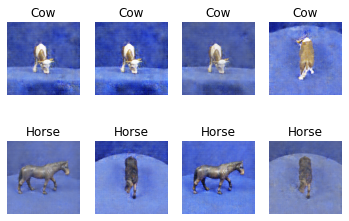

15001 [D loss: 0.158797, acc.: 93.75%] [G loss: 3.408907]
15002 [D loss: 0.157863, acc.: 96.88%] [G loss: 3.355156]
15003 [D loss: 0.263041, acc.: 92.19%] [G loss: 4.555159]
15004 [D loss: 0.030349, acc.: 100.00%] [G loss: 4.091018]
15005 [D loss: 0.069986, acc.: 98.44%] [G loss: 3.399818]
15006 [D loss: 0.120862, acc.: 96.88%] [G loss: 3.609953]
15007 [D loss: 0.125957, acc.: 96.88%] [G loss: 3.374725]
15008 [D loss: 0.139138, acc.: 96.88%] [G loss: 3.752074]
15009 [D loss: 0.020526, acc.: 100.00%] [G loss: 4.097645]
15010 [D loss: 0.135264, acc.: 96.88%] [G loss: 3.617473]
15011 [D loss: 0.282184, acc.: 90.62%] [G loss: 3.725876]
15012 [D loss: 0.141268, acc.: 96.88%] [G loss: 3.835995]
15013 [D loss: 0.102066, acc.: 96.88%] [G loss: 3.602171]
15014 [D loss: 0.063423, acc.: 98.44%] [G loss: 3.774562]
15015 [D loss: 0.023750, acc.: 100.00%] [G loss: 3.943245]
15016 [D loss: 0.122650, acc.: 96.88%] [G loss: 3.582184]
15017 [D loss: 0.063863, acc.: 98.44%] [G loss: 3.902143]
15018 [D lo

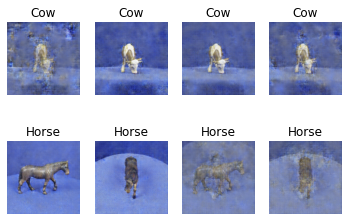

15101 [D loss: 0.085535, acc.: 96.88%] [G loss: 4.381777]
15102 [D loss: 0.091987, acc.: 98.44%] [G loss: 4.421953]
15103 [D loss: 0.165542, acc.: 95.31%] [G loss: 3.778253]
15104 [D loss: 0.032004, acc.: 100.00%] [G loss: 3.686116]
15105 [D loss: 0.027535, acc.: 100.00%] [G loss: 4.826033]
15106 [D loss: 0.108645, acc.: 96.88%] [G loss: 5.473411]
15107 [D loss: 0.160554, acc.: 95.31%] [G loss: 4.758200]
15108 [D loss: 0.033394, acc.: 100.00%] [G loss: 4.138867]
15109 [D loss: 0.102603, acc.: 96.88%] [G loss: 4.386876]
15110 [D loss: 0.049987, acc.: 98.44%] [G loss: 4.315886]
15111 [D loss: 0.062898, acc.: 98.44%] [G loss: 4.514948]
15112 [D loss: 0.235273, acc.: 90.62%] [G loss: 3.499748]
15113 [D loss: 0.044397, acc.: 100.00%] [G loss: 3.714518]
15114 [D loss: 0.105500, acc.: 96.88%] [G loss: 3.471669]
15115 [D loss: 0.090525, acc.: 96.88%] [G loss: 4.124352]
15116 [D loss: 0.042582, acc.: 98.44%] [G loss: 3.977009]
15117 [D loss: 0.114006, acc.: 96.88%] [G loss: 3.884785]
15118 [D l

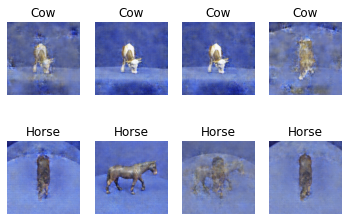

15201 [D loss: 0.043648, acc.: 98.44%] [G loss: 4.498226]
15202 [D loss: 0.015795, acc.: 100.00%] [G loss: 5.103866]
15203 [D loss: 0.172794, acc.: 96.88%] [G loss: 4.139804]
15204 [D loss: 0.147994, acc.: 96.88%] [G loss: 3.599597]
15205 [D loss: 0.030128, acc.: 100.00%] [G loss: 3.540232]
15206 [D loss: 0.185052, acc.: 93.75%] [G loss: 3.144760]
15207 [D loss: 0.031782, acc.: 100.00%] [G loss: 4.205670]
15208 [D loss: 0.175184, acc.: 95.31%] [G loss: 3.618284]
15209 [D loss: 0.044731, acc.: 100.00%] [G loss: 3.755078]
15210 [D loss: 0.093568, acc.: 96.88%] [G loss: 4.059335]
15211 [D loss: 0.054754, acc.: 98.44%] [G loss: 4.167385]
15212 [D loss: 0.064303, acc.: 98.44%] [G loss: 4.149729]
15213 [D loss: 0.136270, acc.: 95.31%] [G loss: 3.763899]
15214 [D loss: 0.257192, acc.: 93.75%] [G loss: 3.436122]
15215 [D loss: 0.033509, acc.: 100.00%] [G loss: 4.038412]
15216 [D loss: 0.241826, acc.: 93.75%] [G loss: 4.328298]
15217 [D loss: 0.028677, acc.: 100.00%] [G loss: 4.892871]
15218 [D

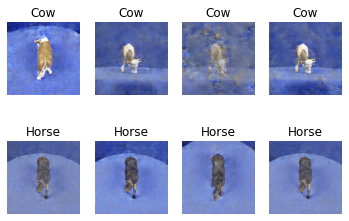

15301 [D loss: 0.071711, acc.: 98.44%] [G loss: 4.091379]
15302 [D loss: 0.062096, acc.: 96.88%] [G loss: 4.328526]
15303 [D loss: 0.148794, acc.: 95.31%] [G loss: 3.555746]
15304 [D loss: 0.128163, acc.: 96.88%] [G loss: 4.007371]
15305 [D loss: 0.061940, acc.: 98.44%] [G loss: 4.333024]
15306 [D loss: 0.025988, acc.: 100.00%] [G loss: 3.927268]
15307 [D loss: 0.087624, acc.: 96.88%] [G loss: 4.331654]
15308 [D loss: 0.094086, acc.: 96.88%] [G loss: 4.306633]
15309 [D loss: 0.054865, acc.: 98.44%] [G loss: 4.572667]
15310 [D loss: 0.062974, acc.: 98.44%] [G loss: 4.193210]
15311 [D loss: 0.061881, acc.: 98.44%] [G loss: 4.521872]
15312 [D loss: 0.066202, acc.: 98.44%] [G loss: 7.059320]
15313 [D loss: 0.089021, acc.: 96.88%] [G loss: 6.118867]
15314 [D loss: 0.011907, acc.: 100.00%] [G loss: 6.080878]
15315 [D loss: 0.241542, acc.: 92.19%] [G loss: 5.574132]
15316 [D loss: 0.095267, acc.: 96.88%] [G loss: 6.439960]
15317 [D loss: 0.146208, acc.: 93.75%] [G loss: 3.952979]
15318 [D los

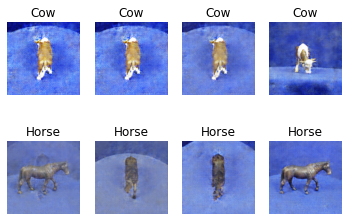

15401 [D loss: 0.049181, acc.: 98.44%] [G loss: 4.371346]
15402 [D loss: 0.060703, acc.: 98.44%] [G loss: 4.432046]
15403 [D loss: 0.067872, acc.: 98.44%] [G loss: 4.191929]
15404 [D loss: 0.034108, acc.: 98.44%] [G loss: 4.379532]
15405 [D loss: 0.231863, acc.: 95.31%] [G loss: 4.115475]
15406 [D loss: 0.110276, acc.: 95.31%] [G loss: 3.778216]
15407 [D loss: 0.020716, acc.: 100.00%] [G loss: 4.158712]
15408 [D loss: 0.112320, acc.: 96.88%] [G loss: 3.737606]
15409 [D loss: 0.111206, acc.: 96.88%] [G loss: 3.745851]
15410 [D loss: 0.161270, acc.: 95.31%] [G loss: 3.857413]
15411 [D loss: 0.028272, acc.: 100.00%] [G loss: 4.008102]
15412 [D loss: 0.035913, acc.: 100.00%] [G loss: 4.662147]
15413 [D loss: 0.089709, acc.: 96.88%] [G loss: 5.672669]
15414 [D loss: 0.142638, acc.: 95.31%] [G loss: 4.313878]
15415 [D loss: 0.226196, acc.: 92.19%] [G loss: 4.049337]
15416 [D loss: 0.050595, acc.: 98.44%] [G loss: 4.086936]
15417 [D loss: 0.033219, acc.: 100.00%] [G loss: 3.927673]
15418 [D l

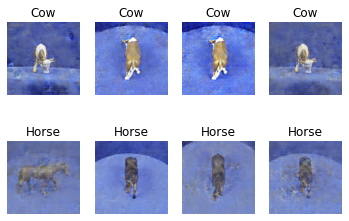

15501 [D loss: 0.053786, acc.: 98.44%] [G loss: 3.985790]
15502 [D loss: 0.077049, acc.: 98.44%] [G loss: 4.600443]
15503 [D loss: 0.015135, acc.: 100.00%] [G loss: 4.284155]
15504 [D loss: 0.053996, acc.: 98.44%] [G loss: 5.202809]
15505 [D loss: 0.041578, acc.: 98.44%] [G loss: 5.600745]
15506 [D loss: 0.004983, acc.: 100.00%] [G loss: 4.972394]
15507 [D loss: 0.077494, acc.: 96.88%] [G loss: 5.776308]
15508 [D loss: 0.075754, acc.: 96.88%] [G loss: 5.691513]
15509 [D loss: 0.107675, acc.: 98.44%] [G loss: 5.103349]
15510 [D loss: 0.037417, acc.: 98.44%] [G loss: 4.301836]
15511 [D loss: 0.020504, acc.: 100.00%] [G loss: 4.563931]
15512 [D loss: 0.020533, acc.: 100.00%] [G loss: 4.729720]
15513 [D loss: 0.080213, acc.: 98.44%] [G loss: 4.462832]
15514 [D loss: 0.023329, acc.: 98.44%] [G loss: 5.481005]
15515 [D loss: 0.129869, acc.: 96.88%] [G loss: 5.133079]
15516 [D loss: 0.010233, acc.: 100.00%] [G loss: 5.035657]
15517 [D loss: 0.297634, acc.: 92.19%] [G loss: 3.712773]
15518 [D 

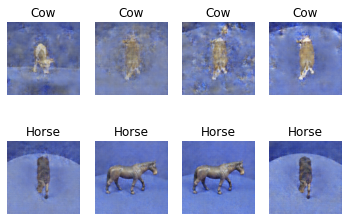

15601 [D loss: 0.095398, acc.: 96.88%] [G loss: 4.253274]
15602 [D loss: 0.028597, acc.: 100.00%] [G loss: 3.575360]
15603 [D loss: 0.071070, acc.: 98.44%] [G loss: 4.165224]
15604 [D loss: 0.178666, acc.: 95.31%] [G loss: 4.456971]
15605 [D loss: 0.174795, acc.: 95.31%] [G loss: 3.188703]
15606 [D loss: 0.077042, acc.: 98.44%] [G loss: 3.268327]
15607 [D loss: 0.190240, acc.: 93.75%] [G loss: 3.731469]
15608 [D loss: 0.085756, acc.: 98.44%] [G loss: 3.920268]
15609 [D loss: 0.076539, acc.: 98.44%] [G loss: 3.998886]
15610 [D loss: 0.080382, acc.: 96.88%] [G loss: 4.387374]
15611 [D loss: 0.072643, acc.: 98.44%] [G loss: 4.102079]
15612 [D loss: 0.018070, acc.: 100.00%] [G loss: 5.012750]
15613 [D loss: 0.004935, acc.: 100.00%] [G loss: 5.574381]
15614 [D loss: 0.117032, acc.: 96.88%] [G loss: 3.926208]
15615 [D loss: 0.014928, acc.: 100.00%] [G loss: 5.492199]
15616 [D loss: 0.120279, acc.: 96.88%] [G loss: 4.626394]
15617 [D loss: 0.125430, acc.: 96.88%] [G loss: 4.277842]
15618 [D l

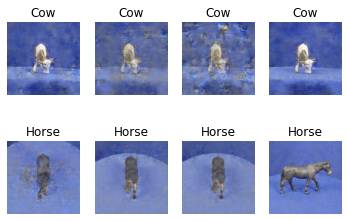

15701 [D loss: 0.012325, acc.: 100.00%] [G loss: 5.261103]
15702 [D loss: 0.004845, acc.: 100.00%] [G loss: 5.759830]
15703 [D loss: 0.176566, acc.: 95.31%] [G loss: 5.263151]
15704 [D loss: 0.022554, acc.: 100.00%] [G loss: 3.579668]
15705 [D loss: 0.204313, acc.: 95.31%] [G loss: 3.978248]
15706 [D loss: 0.141394, acc.: 95.31%] [G loss: 4.223264]
15707 [D loss: 0.075499, acc.: 98.44%] [G loss: 3.649820]
15708 [D loss: 0.084354, acc.: 96.88%] [G loss: 4.294533]
15709 [D loss: 0.091310, acc.: 95.31%] [G loss: 4.000936]
15710 [D loss: 0.051336, acc.: 98.44%] [G loss: 4.230380]
15711 [D loss: 0.193600, acc.: 93.75%] [G loss: 4.073772]
15712 [D loss: 0.096168, acc.: 96.88%] [G loss: 3.728067]
15713 [D loss: 0.122235, acc.: 95.31%] [G loss: 3.894283]
15714 [D loss: 0.190718, acc.: 95.31%] [G loss: 3.931540]
15715 [D loss: 0.165250, acc.: 93.75%] [G loss: 3.277175]
15716 [D loss: 0.056418, acc.: 98.44%] [G loss: 3.459614]
15717 [D loss: 0.072251, acc.: 98.44%] [G loss: 4.738595]
15718 [D lo

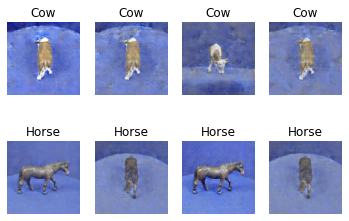

15801 [D loss: 0.154550, acc.: 95.31%] [G loss: 3.823816]
15802 [D loss: 0.087203, acc.: 98.44%] [G loss: 3.612309]
15803 [D loss: 0.054586, acc.: 98.44%] [G loss: 3.408576]
15804 [D loss: 0.137317, acc.: 98.44%] [G loss: 3.631113]
15805 [D loss: 0.270578, acc.: 92.19%] [G loss: 3.614947]
15806 [D loss: 0.079315, acc.: 98.44%] [G loss: 3.976906]
15807 [D loss: 0.046291, acc.: 98.44%] [G loss: 3.842795]
15808 [D loss: 0.041893, acc.: 98.44%] [G loss: 4.157731]
15809 [D loss: 0.280502, acc.: 92.19%] [G loss: 3.823772]
15810 [D loss: 0.016314, acc.: 100.00%] [G loss: 4.777437]
15811 [D loss: 0.099983, acc.: 95.31%] [G loss: 4.374224]
15812 [D loss: 0.172241, acc.: 93.75%] [G loss: 3.559681]
15813 [D loss: 0.038556, acc.: 100.00%] [G loss: 4.055126]
15814 [D loss: 0.081066, acc.: 96.88%] [G loss: 4.561941]
15815 [D loss: 0.015028, acc.: 100.00%] [G loss: 5.425526]
15816 [D loss: 0.091768, acc.: 95.31%] [G loss: 5.110435]
15817 [D loss: 0.045541, acc.: 98.44%] [G loss: 5.372186]
15818 [D lo

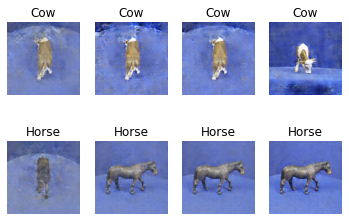

15901 [D loss: 0.072414, acc.: 98.44%] [G loss: 4.824455]
15902 [D loss: 0.097099, acc.: 98.44%] [G loss: 4.336762]
15903 [D loss: 0.056764, acc.: 98.44%] [G loss: 4.842306]
15904 [D loss: 0.023276, acc.: 100.00%] [G loss: 4.809340]
15905 [D loss: 0.100584, acc.: 96.88%] [G loss: 4.615036]
15906 [D loss: 0.144976, acc.: 95.31%] [G loss: 4.285699]
15907 [D loss: 0.121739, acc.: 95.31%] [G loss: 3.795556]
15908 [D loss: 0.085626, acc.: 98.44%] [G loss: 4.608603]
15909 [D loss: 0.043390, acc.: 98.44%] [G loss: 4.991496]
15910 [D loss: 0.139415, acc.: 96.88%] [G loss: 4.438108]
15911 [D loss: 0.121024, acc.: 96.88%] [G loss: 3.740279]
15912 [D loss: 0.138763, acc.: 95.31%] [G loss: 3.509893]
15913 [D loss: 0.095872, acc.: 96.88%] [G loss: 3.748457]
15914 [D loss: 0.083221, acc.: 96.88%] [G loss: 4.699985]
15915 [D loss: 0.203583, acc.: 93.75%] [G loss: 3.532395]
15916 [D loss: 0.085412, acc.: 98.44%] [G loss: 3.759844]
15917 [D loss: 0.152451, acc.: 93.75%] [G loss: 3.357240]
15918 [D loss

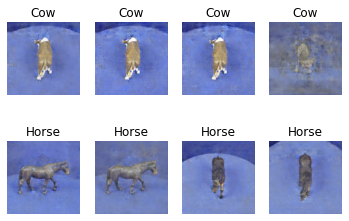

16001 [D loss: 0.063472, acc.: 98.44%] [G loss: 4.062200]
16002 [D loss: 0.145726, acc.: 95.31%] [G loss: 3.696783]
16003 [D loss: 0.094082, acc.: 96.88%] [G loss: 3.545302]
16004 [D loss: 0.123128, acc.: 96.88%] [G loss: 3.438250]
16005 [D loss: 0.056633, acc.: 98.44%] [G loss: 3.332435]
16006 [D loss: 0.061762, acc.: 98.44%] [G loss: 3.350890]
16007 [D loss: 0.058261, acc.: 98.44%] [G loss: 3.512466]
16008 [D loss: 0.064097, acc.: 98.44%] [G loss: 4.050232]
16009 [D loss: 0.023816, acc.: 100.00%] [G loss: 4.217746]
16010 [D loss: 0.044174, acc.: 98.44%] [G loss: 3.811806]
16011 [D loss: 0.028221, acc.: 100.00%] [G loss: 4.053341]
16012 [D loss: 0.044237, acc.: 98.44%] [G loss: 4.524319]
16013 [D loss: 0.192929, acc.: 95.31%] [G loss: 4.570001]
16014 [D loss: 0.182303, acc.: 93.75%] [G loss: 2.870369]
16015 [D loss: 0.078965, acc.: 98.44%] [G loss: 3.660570]
16016 [D loss: 0.067259, acc.: 98.44%] [G loss: 4.293759]
16017 [D loss: 0.061206, acc.: 98.44%] [G loss: 4.646465]
16018 [D los

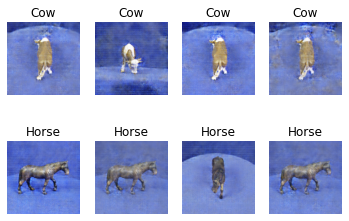

16101 [D loss: 0.044513, acc.: 98.44%] [G loss: 4.035200]
16102 [D loss: 0.197181, acc.: 93.75%] [G loss: 3.870109]
16103 [D loss: 0.106534, acc.: 96.88%] [G loss: 3.799544]
16104 [D loss: 0.041688, acc.: 98.44%] [G loss: 4.277131]
16105 [D loss: 0.055679, acc.: 98.44%] [G loss: 4.391693]
16106 [D loss: 0.115522, acc.: 98.44%] [G loss: 3.631953]
16107 [D loss: 0.130006, acc.: 96.88%] [G loss: 3.820925]
16108 [D loss: 0.063619, acc.: 98.44%] [G loss: 4.773619]
16109 [D loss: 0.025261, acc.: 100.00%] [G loss: 5.105733]
16110 [D loss: 0.058815, acc.: 98.44%] [G loss: 4.367867]
16111 [D loss: 0.093183, acc.: 95.31%] [G loss: 4.650581]
16112 [D loss: 0.039525, acc.: 98.44%] [G loss: 4.162022]
16113 [D loss: 0.276059, acc.: 92.19%] [G loss: 3.348629]
16114 [D loss: 0.229821, acc.: 93.75%] [G loss: 3.381621]
16115 [D loss: 0.036327, acc.: 100.00%] [G loss: 3.506476]
16116 [D loss: 0.091095, acc.: 96.88%] [G loss: 3.746271]
16117 [D loss: 0.043525, acc.: 100.00%] [G loss: 3.275028]
16118 [D lo

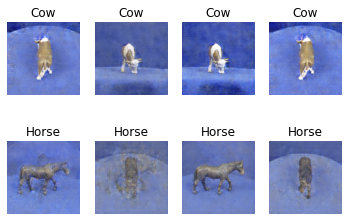

16201 [D loss: 0.055726, acc.: 96.88%] [G loss: 4.834105]
16202 [D loss: 0.015382, acc.: 100.00%] [G loss: 5.369100]
16203 [D loss: 0.036409, acc.: 98.44%] [G loss: 6.619263]
16204 [D loss: 0.013364, acc.: 100.00%] [G loss: 6.440342]
16205 [D loss: 0.237596, acc.: 95.31%] [G loss: 4.881766]
16206 [D loss: 0.074682, acc.: 98.44%] [G loss: 3.971010]
16207 [D loss: 0.063046, acc.: 98.44%] [G loss: 3.760943]
16208 [D loss: 0.071046, acc.: 98.44%] [G loss: 3.968555]
16209 [D loss: 0.063295, acc.: 98.44%] [G loss: 3.761910]
16210 [D loss: 0.057174, acc.: 98.44%] [G loss: 4.229237]
16211 [D loss: 0.063074, acc.: 98.44%] [G loss: 3.858988]
16212 [D loss: 0.140270, acc.: 95.31%] [G loss: 4.039358]
16213 [D loss: 0.157452, acc.: 96.88%] [G loss: 4.244073]
16214 [D loss: 0.184037, acc.: 93.75%] [G loss: 4.928465]
16215 [D loss: 0.150162, acc.: 93.75%] [G loss: 6.571476]
16216 [D loss: 0.100475, acc.: 93.75%] [G loss: 4.904822]
16217 [D loss: 0.064347, acc.: 96.88%] [G loss: 3.613752]
16218 [D los

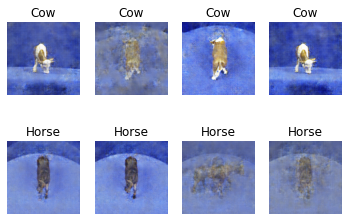

16301 [D loss: 0.181471, acc.: 95.31%] [G loss: 3.636073]
16302 [D loss: 0.076342, acc.: 98.44%] [G loss: 3.299235]
16303 [D loss: 0.019211, acc.: 100.00%] [G loss: 4.362092]
16304 [D loss: 0.087878, acc.: 98.44%] [G loss: 4.451187]
16305 [D loss: 0.015501, acc.: 100.00%] [G loss: 4.555453]
16306 [D loss: 0.225894, acc.: 93.75%] [G loss: 3.974889]
16307 [D loss: 0.021623, acc.: 100.00%] [G loss: 3.991562]
16308 [D loss: 0.107265, acc.: 96.88%] [G loss: 4.064674]
16309 [D loss: 0.163408, acc.: 95.31%] [G loss: 3.746436]
16310 [D loss: 0.101486, acc.: 96.88%] [G loss: 3.650020]
16311 [D loss: 0.074647, acc.: 98.44%] [G loss: 3.723690]
16312 [D loss: 0.192559, acc.: 95.31%] [G loss: 3.627000]
16313 [D loss: 0.114939, acc.: 96.88%] [G loss: 3.781290]
16314 [D loss: 0.120189, acc.: 96.88%] [G loss: 4.048027]
16315 [D loss: 0.062303, acc.: 98.44%] [G loss: 3.777706]
16316 [D loss: 0.028044, acc.: 100.00%] [G loss: 3.746025]
16317 [D loss: 0.182483, acc.: 95.31%] [G loss: 3.335558]
16318 [D l

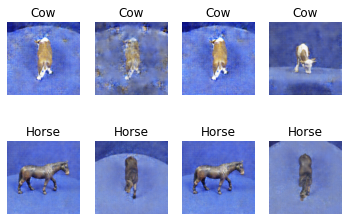

16401 [D loss: 0.019629, acc.: 100.00%] [G loss: 4.475160]
16402 [D loss: 0.194434, acc.: 95.31%] [G loss: 3.791031]
16403 [D loss: 0.056263, acc.: 98.44%] [G loss: 4.278774]
16404 [D loss: 0.136677, acc.: 95.31%] [G loss: 3.546265]
16405 [D loss: 0.026344, acc.: 100.00%] [G loss: 3.903249]
16406 [D loss: 0.172780, acc.: 92.19%] [G loss: 3.848143]
16407 [D loss: 0.086877, acc.: 96.88%] [G loss: 3.511567]
16408 [D loss: 0.285878, acc.: 90.62%] [G loss: 4.511180]
16409 [D loss: 0.120227, acc.: 96.88%] [G loss: 3.437154]
16410 [D loss: 0.120353, acc.: 95.31%] [G loss: 3.264644]
16411 [D loss: 0.088822, acc.: 98.44%] [G loss: 3.385904]
16412 [D loss: 0.090182, acc.: 98.44%] [G loss: 4.019792]
16413 [D loss: 0.070814, acc.: 98.44%] [G loss: 3.760749]
16414 [D loss: 0.142068, acc.: 95.31%] [G loss: 4.387046]
16415 [D loss: 0.174521, acc.: 95.31%] [G loss: 3.490947]
16416 [D loss: 0.071087, acc.: 98.44%] [G loss: 4.060640]
16417 [D loss: 0.036269, acc.: 100.00%] [G loss: 3.759007]
16418 [D lo

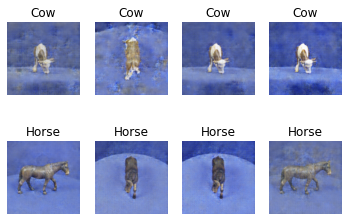

16501 [D loss: 0.088715, acc.: 98.44%] [G loss: 3.954546]
16502 [D loss: 0.128807, acc.: 95.31%] [G loss: 4.066350]
16503 [D loss: 0.052404, acc.: 98.44%] [G loss: 3.705822]
16504 [D loss: 0.104204, acc.: 96.88%] [G loss: 4.080803]
16505 [D loss: 0.031569, acc.: 98.44%] [G loss: 4.444094]
16506 [D loss: 0.182615, acc.: 95.31%] [G loss: 4.506004]
16507 [D loss: 0.082843, acc.: 96.88%] [G loss: 3.771698]
16508 [D loss: 0.021719, acc.: 100.00%] [G loss: 3.722303]
16509 [D loss: 0.087087, acc.: 96.88%] [G loss: 4.093843]
16510 [D loss: 0.086193, acc.: 96.88%] [G loss: 3.887009]
16511 [D loss: 0.054298, acc.: 98.44%] [G loss: 3.706317]
16512 [D loss: 0.065170, acc.: 98.44%] [G loss: 3.362868]
16513 [D loss: 0.026961, acc.: 100.00%] [G loss: 3.978755]
16514 [D loss: 0.018295, acc.: 100.00%] [G loss: 4.884695]
16515 [D loss: 0.011571, acc.: 100.00%] [G loss: 4.307285]
16516 [D loss: 0.061760, acc.: 98.44%] [G loss: 4.483377]
16517 [D loss: 0.134909, acc.: 96.88%] [G loss: 3.981386]
16518 [D l

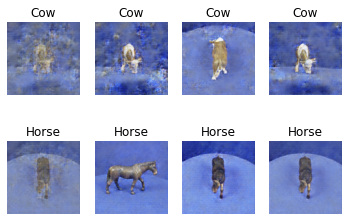

16601 [D loss: 0.034694, acc.: 100.00%] [G loss: 4.203649]
16602 [D loss: 0.077052, acc.: 98.44%] [G loss: 3.906439]
16603 [D loss: 0.132961, acc.: 96.88%] [G loss: 3.639030]
16604 [D loss: 0.024145, acc.: 100.00%] [G loss: 3.805375]
16605 [D loss: 0.111362, acc.: 96.88%] [G loss: 4.023212]
16606 [D loss: 0.154232, acc.: 96.88%] [G loss: 4.549641]
16607 [D loss: 0.071280, acc.: 98.44%] [G loss: 4.566859]
16608 [D loss: 0.126231, acc.: 95.31%] [G loss: 4.582838]
16609 [D loss: 0.057270, acc.: 98.44%] [G loss: 4.845764]
16610 [D loss: 0.022978, acc.: 100.00%] [G loss: 5.159381]
16611 [D loss: 0.017454, acc.: 100.00%] [G loss: 4.912217]
16612 [D loss: 0.149060, acc.: 96.88%] [G loss: 4.458414]
16613 [D loss: 0.098561, acc.: 96.88%] [G loss: 4.324395]
16614 [D loss: 0.025325, acc.: 100.00%] [G loss: 4.333162]
16615 [D loss: 0.044498, acc.: 98.44%] [G loss: 4.231942]
16616 [D loss: 0.124179, acc.: 96.88%] [G loss: 3.849285]
16617 [D loss: 0.014299, acc.: 100.00%] [G loss: 4.285814]
16618 [D

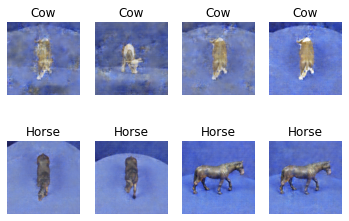

16701 [D loss: 0.059826, acc.: 98.44%] [G loss: 5.040026]
16702 [D loss: 0.098636, acc.: 96.88%] [G loss: 3.923847]
16703 [D loss: 0.099422, acc.: 98.44%] [G loss: 4.423563]
16704 [D loss: 0.102130, acc.: 96.88%] [G loss: 4.494133]
16705 [D loss: 0.100413, acc.: 96.88%] [G loss: 3.760629]
16706 [D loss: 0.041432, acc.: 98.44%] [G loss: 3.909305]
16707 [D loss: 0.051707, acc.: 98.44%] [G loss: 3.579437]
16708 [D loss: 0.117774, acc.: 96.88%] [G loss: 3.723650]
16709 [D loss: 0.026901, acc.: 100.00%] [G loss: 4.336751]
16710 [D loss: 0.015367, acc.: 100.00%] [G loss: 5.549160]
16711 [D loss: 0.119753, acc.: 96.88%] [G loss: 4.690926]
16712 [D loss: 0.081965, acc.: 98.44%] [G loss: 4.902755]
16713 [D loss: 0.087563, acc.: 98.44%] [G loss: 4.187386]
16714 [D loss: 0.028709, acc.: 98.44%] [G loss: 4.945418]
16715 [D loss: 0.014673, acc.: 100.00%] [G loss: 4.745162]
16716 [D loss: 0.165872, acc.: 93.75%] [G loss: 4.530146]
16717 [D loss: 0.181221, acc.: 95.31%] [G loss: 4.676921]
16718 [D lo

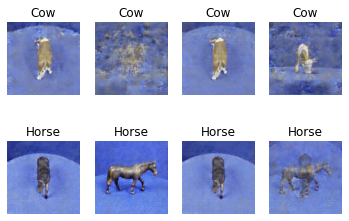

16801 [D loss: 0.018812, acc.: 100.00%] [G loss: 4.567529]
16802 [D loss: 0.053340, acc.: 98.44%] [G loss: 4.763037]
16803 [D loss: 0.021352, acc.: 98.44%] [G loss: 4.543630]
16804 [D loss: 0.112065, acc.: 96.88%] [G loss: 6.280412]
16805 [D loss: 0.039607, acc.: 98.44%] [G loss: 4.917064]
16806 [D loss: 0.159343, acc.: 96.88%] [G loss: 4.033287]
16807 [D loss: 0.077431, acc.: 96.88%] [G loss: 4.357128]
16808 [D loss: 0.014474, acc.: 100.00%] [G loss: 4.263539]
16809 [D loss: 0.064261, acc.: 98.44%] [G loss: 4.710885]
16810 [D loss: 0.162472, acc.: 96.88%] [G loss: 4.861439]
16811 [D loss: 0.012951, acc.: 100.00%] [G loss: 3.864003]
16812 [D loss: 0.270641, acc.: 93.75%] [G loss: 3.523842]
16813 [D loss: 0.030646, acc.: 100.00%] [G loss: 3.955553]
16814 [D loss: 0.174460, acc.: 95.31%] [G loss: 3.829817]
16815 [D loss: 0.053138, acc.: 98.44%] [G loss: 5.194004]
16816 [D loss: 0.138642, acc.: 93.75%] [G loss: 4.987751]
16817 [D loss: 0.105798, acc.: 96.88%] [G loss: 3.692410]
16818 [D l

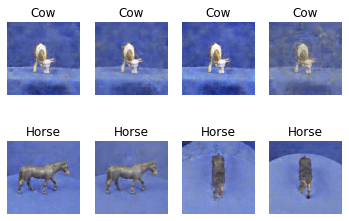

16901 [D loss: 0.081285, acc.: 96.88%] [G loss: 4.197326]
16902 [D loss: 0.073900, acc.: 96.88%] [G loss: 3.347776]
16903 [D loss: 0.087562, acc.: 98.44%] [G loss: 4.177110]
16904 [D loss: 0.140076, acc.: 96.88%] [G loss: 3.502378]
16905 [D loss: 0.167903, acc.: 96.88%] [G loss: 3.712522]
16906 [D loss: 0.230078, acc.: 90.62%] [G loss: 4.175206]
16907 [D loss: 0.098412, acc.: 96.88%] [G loss: 4.488537]
16908 [D loss: 0.120163, acc.: 96.88%] [G loss: 3.164410]
16909 [D loss: 0.105886, acc.: 96.88%] [G loss: 4.165965]
16910 [D loss: 0.024643, acc.: 100.00%] [G loss: 4.461064]
16911 [D loss: 0.073915, acc.: 96.88%] [G loss: 4.825510]
16912 [D loss: 0.031147, acc.: 100.00%] [G loss: 4.413004]
16913 [D loss: 0.160867, acc.: 95.31%] [G loss: 3.454695]
16914 [D loss: 0.015841, acc.: 100.00%] [G loss: 4.347761]
16915 [D loss: 0.288388, acc.: 90.62%] [G loss: 3.255275]
16916 [D loss: 0.132222, acc.: 95.31%] [G loss: 3.308812]
16917 [D loss: 0.098413, acc.: 98.44%] [G loss: 3.800595]
16918 [D lo

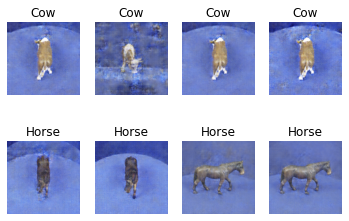

17001 [D loss: 0.159679, acc.: 93.75%] [G loss: 3.750413]
17002 [D loss: 0.145901, acc.: 96.88%] [G loss: 3.906232]
17003 [D loss: 0.079003, acc.: 96.88%] [G loss: 3.873587]
17004 [D loss: 0.014455, acc.: 100.00%] [G loss: 4.936341]
17005 [D loss: 0.149752, acc.: 96.88%] [G loss: 3.876582]
17006 [D loss: 0.013506, acc.: 100.00%] [G loss: 4.177197]
17007 [D loss: 0.126590, acc.: 96.88%] [G loss: 4.333369]
17008 [D loss: 0.155217, acc.: 95.31%] [G loss: 3.815771]
17009 [D loss: 0.169233, acc.: 95.31%] [G loss: 3.844709]
17010 [D loss: 0.045379, acc.: 98.44%] [G loss: 3.769369]
17011 [D loss: 0.064935, acc.: 98.44%] [G loss: 3.585659]
17012 [D loss: 0.216968, acc.: 93.75%] [G loss: 3.380839]
17013 [D loss: 0.032137, acc.: 100.00%] [G loss: 3.542150]
17014 [D loss: 0.075223, acc.: 98.44%] [G loss: 3.776832]
17015 [D loss: 0.103182, acc.: 98.44%] [G loss: 3.582765]
17016 [D loss: 0.129630, acc.: 96.88%] [G loss: 4.122469]
17017 [D loss: 0.095194, acc.: 96.88%] [G loss: 3.783008]
17018 [D lo

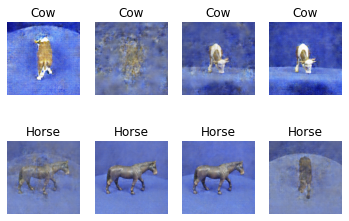

17101 [D loss: 0.089018, acc.: 96.88%] [G loss: 4.092053]
17102 [D loss: 0.055492, acc.: 98.44%] [G loss: 4.066775]
17103 [D loss: 0.178187, acc.: 93.75%] [G loss: 3.832938]
17104 [D loss: 0.040325, acc.: 100.00%] [G loss: 4.216918]
17105 [D loss: 0.161945, acc.: 95.31%] [G loss: 3.988925]
17106 [D loss: 0.067869, acc.: 98.44%] [G loss: 3.741482]
17107 [D loss: 0.047195, acc.: 98.44%] [G loss: 4.714349]
17108 [D loss: 0.016400, acc.: 100.00%] [G loss: 4.963532]
17109 [D loss: 0.204714, acc.: 93.75%] [G loss: 4.487641]
17110 [D loss: 0.071845, acc.: 98.44%] [G loss: 4.364007]
17111 [D loss: 0.158933, acc.: 96.88%] [G loss: 3.495108]
17112 [D loss: 0.119021, acc.: 95.31%] [G loss: 3.534262]
17113 [D loss: 0.169162, acc.: 93.75%] [G loss: 3.798702]
17114 [D loss: 0.147348, acc.: 95.31%] [G loss: 3.859234]
17115 [D loss: 0.231496, acc.: 93.75%] [G loss: 3.612592]
17116 [D loss: 0.080821, acc.: 98.44%] [G loss: 3.717656]
17117 [D loss: 0.173690, acc.: 95.31%] [G loss: 3.171449]
17118 [D los

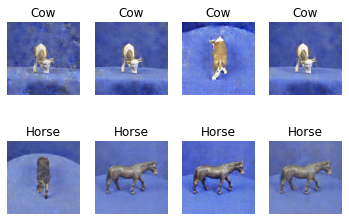

17201 [D loss: 0.078280, acc.: 98.44%] [G loss: 5.131415]
17202 [D loss: 0.011340, acc.: 100.00%] [G loss: 5.347257]
17203 [D loss: 0.130112, acc.: 96.88%] [G loss: 6.909909]
17204 [D loss: 0.213738, acc.: 93.75%] [G loss: 3.820640]
17205 [D loss: 0.085144, acc.: 96.88%] [G loss: 5.112427]
17206 [D loss: 0.049950, acc.: 98.44%] [G loss: 3.853158]
17207 [D loss: 0.082366, acc.: 95.31%] [G loss: 4.150122]
17208 [D loss: 0.027954, acc.: 100.00%] [G loss: 3.965511]
17209 [D loss: 0.047915, acc.: 100.00%] [G loss: 3.317887]
17210 [D loss: 0.080011, acc.: 96.88%] [G loss: 4.145755]
17211 [D loss: 0.064572, acc.: 98.44%] [G loss: 4.810803]
17212 [D loss: 0.114306, acc.: 96.88%] [G loss: 4.642607]
17213 [D loss: 0.143970, acc.: 96.88%] [G loss: 3.909286]
17214 [D loss: 0.038141, acc.: 100.00%] [G loss: 3.703754]
17215 [D loss: 0.101927, acc.: 96.88%] [G loss: 3.932463]
17216 [D loss: 0.133930, acc.: 95.31%] [G loss: 4.716555]
17217 [D loss: 0.147898, acc.: 95.31%] [G loss: 4.168913]
17218 [D l

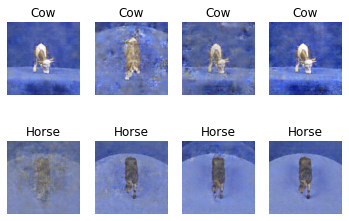

17301 [D loss: 0.084565, acc.: 96.88%] [G loss: 3.522359]
17302 [D loss: 0.116918, acc.: 96.88%] [G loss: 3.089266]
17303 [D loss: 0.054246, acc.: 100.00%] [G loss: 3.699111]
17304 [D loss: 0.138577, acc.: 95.31%] [G loss: 4.520774]
17305 [D loss: 0.118590, acc.: 98.44%] [G loss: 4.209726]
17306 [D loss: 0.031554, acc.: 100.00%] [G loss: 3.247929]
17307 [D loss: 0.132029, acc.: 96.88%] [G loss: 4.360438]
17308 [D loss: 0.084948, acc.: 96.88%] [G loss: 4.434727]
17309 [D loss: 0.087265, acc.: 98.44%] [G loss: 3.675375]
17310 [D loss: 0.034020, acc.: 100.00%] [G loss: 3.686608]
17311 [D loss: 0.024022, acc.: 100.00%] [G loss: 3.819709]
17312 [D loss: 0.197102, acc.: 93.75%] [G loss: 3.864307]
17313 [D loss: 0.009607, acc.: 100.00%] [G loss: 5.136563]
17314 [D loss: 0.211608, acc.: 93.75%] [G loss: 4.753672]
17315 [D loss: 0.140370, acc.: 95.31%] [G loss: 3.868649]
17316 [D loss: 0.033855, acc.: 100.00%] [G loss: 4.025670]
17317 [D loss: 0.055942, acc.: 98.44%] [G loss: 3.497966]
17318 [D

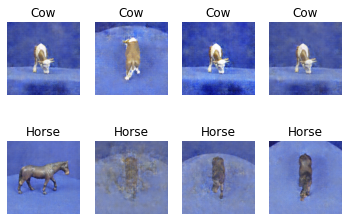

17401 [D loss: 0.155519, acc.: 95.31%] [G loss: 3.953487]
17402 [D loss: 0.035017, acc.: 100.00%] [G loss: 4.754465]
17403 [D loss: 0.273665, acc.: 92.19%] [G loss: 5.406652]
17404 [D loss: 0.099154, acc.: 98.44%] [G loss: 3.747813]
17405 [D loss: 0.062347, acc.: 98.44%] [G loss: 3.789266]
17406 [D loss: 0.108620, acc.: 98.44%] [G loss: 3.587219]
17407 [D loss: 0.053756, acc.: 98.44%] [G loss: 4.114074]
17408 [D loss: 0.111612, acc.: 96.88%] [G loss: 3.669428]
17409 [D loss: 0.075944, acc.: 98.44%] [G loss: 4.010103]
17410 [D loss: 0.129636, acc.: 96.88%] [G loss: 3.629699]
17411 [D loss: 0.198486, acc.: 93.75%] [G loss: 4.056589]
17412 [D loss: 0.021445, acc.: 100.00%] [G loss: 3.925550]
17413 [D loss: 0.023628, acc.: 100.00%] [G loss: 4.035631]
17414 [D loss: 0.106419, acc.: 96.88%] [G loss: 3.737392]
17415 [D loss: 0.158533, acc.: 95.31%] [G loss: 3.385659]
17416 [D loss: 0.169289, acc.: 95.31%] [G loss: 3.311594]
17417 [D loss: 0.203090, acc.: 93.75%] [G loss: 3.075421]
17418 [D lo

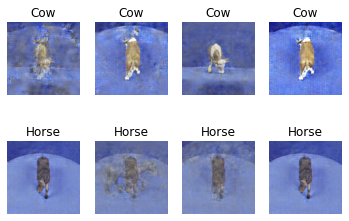

17501 [D loss: 0.108027, acc.: 96.88%] [G loss: 4.647720]
17502 [D loss: 0.063993, acc.: 98.44%] [G loss: 4.349502]
17503 [D loss: 0.008407, acc.: 100.00%] [G loss: 5.408487]
17504 [D loss: 0.192149, acc.: 96.88%] [G loss: 4.638799]
17505 [D loss: 0.079140, acc.: 98.44%] [G loss: 3.848583]
17506 [D loss: 0.076321, acc.: 98.44%] [G loss: 5.022984]
17507 [D loss: 0.068906, acc.: 98.44%] [G loss: 5.056934]
17508 [D loss: 0.068652, acc.: 98.44%] [G loss: 5.531713]
17509 [D loss: 0.055057, acc.: 98.44%] [G loss: 5.495575]
17510 [D loss: 0.205771, acc.: 92.19%] [G loss: 4.815260]
17511 [D loss: 0.082681, acc.: 96.88%] [G loss: 5.459518]
17512 [D loss: 0.051499, acc.: 98.44%] [G loss: 5.332806]
17513 [D loss: 0.133774, acc.: 96.88%] [G loss: 4.742231]
17514 [D loss: 0.073605, acc.: 98.44%] [G loss: 3.446421]
17515 [D loss: 0.065715, acc.: 98.44%] [G loss: 4.063375]
17516 [D loss: 0.106104, acc.: 96.88%] [G loss: 3.885417]
17517 [D loss: 0.072961, acc.: 98.44%] [G loss: 5.797190]
17518 [D loss

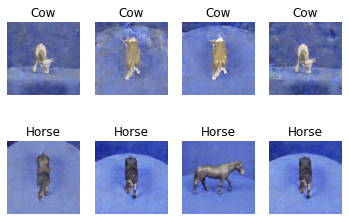

17601 [D loss: 0.111343, acc.: 96.88%] [G loss: 3.877702]
17602 [D loss: 0.228093, acc.: 93.75%] [G loss: 3.518382]
17603 [D loss: 0.039950, acc.: 100.00%] [G loss: 4.012817]
17604 [D loss: 0.094374, acc.: 93.75%] [G loss: 4.898059]
17605 [D loss: 0.128965, acc.: 95.31%] [G loss: 4.298939]
17606 [D loss: 0.049527, acc.: 98.44%] [G loss: 4.102771]
17607 [D loss: 0.105592, acc.: 96.88%] [G loss: 3.747818]
17608 [D loss: 0.097780, acc.: 96.88%] [G loss: 4.092159]
17609 [D loss: 0.134972, acc.: 93.75%] [G loss: 3.532066]
17610 [D loss: 0.041488, acc.: 98.44%] [G loss: 3.935386]
17611 [D loss: 0.162728, acc.: 95.31%] [G loss: 3.351300]
17612 [D loss: 0.120280, acc.: 96.88%] [G loss: 4.274454]
17613 [D loss: 0.084528, acc.: 98.44%] [G loss: 4.410120]
17614 [D loss: 0.016104, acc.: 100.00%] [G loss: 4.939995]
17615 [D loss: 0.109603, acc.: 96.88%] [G loss: 3.701344]
17616 [D loss: 0.044115, acc.: 98.44%] [G loss: 4.778956]
17617 [D loss: 0.015758, acc.: 100.00%] [G loss: 4.400865]
17618 [D lo

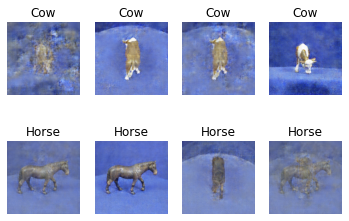

17701 [D loss: 0.146458, acc.: 96.88%] [G loss: 3.702819]
17702 [D loss: 0.058109, acc.: 98.44%] [G loss: 4.046929]
17703 [D loss: 0.039779, acc.: 100.00%] [G loss: 3.841626]
17704 [D loss: 0.130809, acc.: 95.31%] [G loss: 3.911329]
17705 [D loss: 0.138198, acc.: 95.31%] [G loss: 3.704082]
17706 [D loss: 0.099682, acc.: 93.75%] [G loss: 2.998633]
17707 [D loss: 0.144672, acc.: 96.88%] [G loss: 3.596923]
17708 [D loss: 0.083478, acc.: 96.88%] [G loss: 3.405222]
17709 [D loss: 0.201373, acc.: 92.19%] [G loss: 4.406594]
17710 [D loss: 0.024372, acc.: 100.00%] [G loss: 4.331645]
17711 [D loss: 0.049040, acc.: 100.00%] [G loss: 3.881135]
17712 [D loss: 0.041373, acc.: 98.44%] [G loss: 4.758721]
17713 [D loss: 0.195949, acc.: 95.31%] [G loss: 4.051279]
17714 [D loss: 0.199851, acc.: 93.75%] [G loss: 3.442739]
17715 [D loss: 0.122305, acc.: 95.31%] [G loss: 3.224572]
17716 [D loss: 0.142518, acc.: 95.31%] [G loss: 3.862439]
17717 [D loss: 0.100656, acc.: 96.88%] [G loss: 3.608728]
17718 [D lo

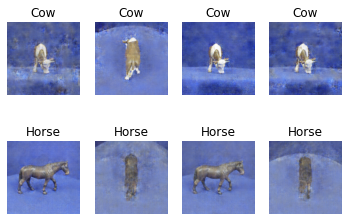

17801 [D loss: 0.107129, acc.: 96.88%] [G loss: 3.702589]
17802 [D loss: 0.102268, acc.: 96.88%] [G loss: 3.663318]
17803 [D loss: 0.083681, acc.: 96.88%] [G loss: 3.875784]
17804 [D loss: 0.178314, acc.: 95.31%] [G loss: 4.149420]
17805 [D loss: 0.063483, acc.: 98.44%] [G loss: 3.125553]
17806 [D loss: 0.085501, acc.: 96.88%] [G loss: 3.736502]
17807 [D loss: 0.016419, acc.: 100.00%] [G loss: 4.588910]
17808 [D loss: 0.121308, acc.: 96.88%] [G loss: 5.106852]
17809 [D loss: 0.050524, acc.: 98.44%] [G loss: 4.453474]
17810 [D loss: 0.129673, acc.: 96.88%] [G loss: 4.072332]
17811 [D loss: 0.071188, acc.: 98.44%] [G loss: 4.292476]
17812 [D loss: 0.063067, acc.: 98.44%] [G loss: 4.036413]
17813 [D loss: 0.099043, acc.: 95.31%] [G loss: 4.999204]
17814 [D loss: 0.095448, acc.: 98.44%] [G loss: 4.474424]
17815 [D loss: 0.009651, acc.: 100.00%] [G loss: 4.932361]
17816 [D loss: 0.079782, acc.: 98.44%] [G loss: 4.149453]
17817 [D loss: 0.014316, acc.: 100.00%] [G loss: 4.573378]
17818 [D lo

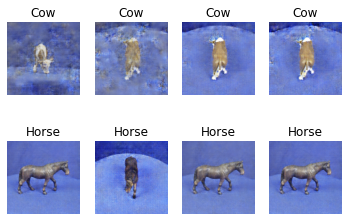

17901 [D loss: 0.154681, acc.: 93.75%] [G loss: 4.426103]
17902 [D loss: 0.058055, acc.: 98.44%] [G loss: 4.251668]
17903 [D loss: 0.113349, acc.: 96.88%] [G loss: 3.821719]
17904 [D loss: 0.142091, acc.: 95.31%] [G loss: 4.580849]
17905 [D loss: 0.016083, acc.: 100.00%] [G loss: 5.239743]
17906 [D loss: 0.068033, acc.: 98.44%] [G loss: 5.396202]
17907 [D loss: 0.117916, acc.: 96.88%] [G loss: 4.920960]
17908 [D loss: 0.022792, acc.: 100.00%] [G loss: 4.173774]
17909 [D loss: 0.238001, acc.: 90.62%] [G loss: 3.157800]
17910 [D loss: 0.034424, acc.: 100.00%] [G loss: 3.086421]
17911 [D loss: 0.157865, acc.: 93.75%] [G loss: 3.017215]
17912 [D loss: 0.034569, acc.: 100.00%] [G loss: 3.377460]
17913 [D loss: 0.110840, acc.: 96.88%] [G loss: 3.304978]
17914 [D loss: 0.112043, acc.: 96.88%] [G loss: 3.354605]
17915 [D loss: 0.079089, acc.: 98.44%] [G loss: 3.841515]
17916 [D loss: 0.105673, acc.: 95.31%] [G loss: 3.924975]
17917 [D loss: 0.023378, acc.: 100.00%] [G loss: 3.726385]
17918 [D 

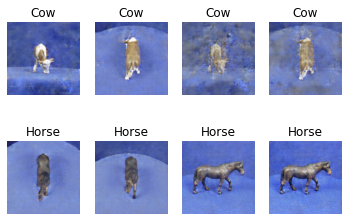

18001 [D loss: 0.081962, acc.: 98.44%] [G loss: 3.499520]
18002 [D loss: 0.184766, acc.: 93.75%] [G loss: 3.597977]
18003 [D loss: 0.113263, acc.: 96.88%] [G loss: 3.515389]
18004 [D loss: 0.159960, acc.: 93.75%] [G loss: 3.149315]
18005 [D loss: 0.097169, acc.: 96.88%] [G loss: 3.416644]
18006 [D loss: 0.111033, acc.: 96.88%] [G loss: 3.272857]
18007 [D loss: 0.080264, acc.: 98.44%] [G loss: 3.095609]
18008 [D loss: 0.119494, acc.: 96.88%] [G loss: 3.484794]
18009 [D loss: 0.033869, acc.: 100.00%] [G loss: 3.535019]
18010 [D loss: 0.115875, acc.: 96.88%] [G loss: 3.703700]
18011 [D loss: 0.081592, acc.: 96.88%] [G loss: 3.914284]
18012 [D loss: 0.275763, acc.: 92.19%] [G loss: 3.312227]
18013 [D loss: 0.123029, acc.: 95.31%] [G loss: 2.980102]
18014 [D loss: 0.042715, acc.: 100.00%] [G loss: 3.392403]
18015 [D loss: 0.061315, acc.: 98.44%] [G loss: 4.416000]
18016 [D loss: 0.124303, acc.: 96.88%] [G loss: 3.582903]
18017 [D loss: 0.035439, acc.: 100.00%] [G loss: 4.026983]
18018 [D lo

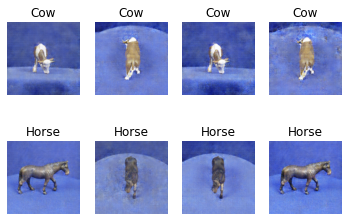

18101 [D loss: 0.124761, acc.: 96.88%] [G loss: 4.309358]
18102 [D loss: 0.067688, acc.: 98.44%] [G loss: 4.112304]
18103 [D loss: 0.157392, acc.: 96.88%] [G loss: 4.214072]
18104 [D loss: 0.082937, acc.: 96.88%] [G loss: 4.135820]
18105 [D loss: 0.121664, acc.: 96.88%] [G loss: 4.478338]
18106 [D loss: 0.082020, acc.: 96.88%] [G loss: 3.801970]
18107 [D loss: 0.043045, acc.: 98.44%] [G loss: 5.421294]
18108 [D loss: 0.106419, acc.: 96.88%] [G loss: 6.265200]
18109 [D loss: 0.082212, acc.: 98.44%] [G loss: 3.642198]
18110 [D loss: 0.118129, acc.: 96.88%] [G loss: 4.648499]
18111 [D loss: 0.153699, acc.: 93.75%] [G loss: 3.730513]
18112 [D loss: 0.146019, acc.: 95.31%] [G loss: 3.679161]
18113 [D loss: 0.091577, acc.: 96.88%] [G loss: 3.815391]
18114 [D loss: 0.178204, acc.: 95.31%] [G loss: 3.248743]
18115 [D loss: 0.037638, acc.: 98.44%] [G loss: 4.818321]
18116 [D loss: 0.244482, acc.: 90.62%] [G loss: 3.784054]
18117 [D loss: 0.053243, acc.: 100.00%] [G loss: 3.474461]
18118 [D loss

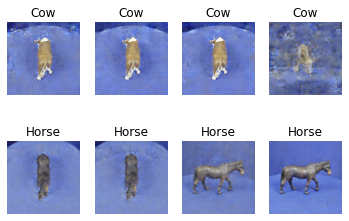

18201 [D loss: 0.149836, acc.: 95.31%] [G loss: 3.500456]
18202 [D loss: 0.081078, acc.: 98.44%] [G loss: 3.924207]
18203 [D loss: 0.030012, acc.: 98.44%] [G loss: 3.876607]
18204 [D loss: 0.132742, acc.: 96.88%] [G loss: 4.073514]
18205 [D loss: 0.259346, acc.: 92.19%] [G loss: 3.189043]
18206 [D loss: 0.076001, acc.: 98.44%] [G loss: 3.216913]
18207 [D loss: 0.089344, acc.: 98.44%] [G loss: 3.409511]
18208 [D loss: 0.063531, acc.: 98.44%] [G loss: 3.665977]
18209 [D loss: 0.065429, acc.: 98.44%] [G loss: 4.114583]
18210 [D loss: 0.135468, acc.: 96.88%] [G loss: 3.204132]
18211 [D loss: 0.120117, acc.: 96.88%] [G loss: 3.191903]
18212 [D loss: 0.269838, acc.: 92.19%] [G loss: 3.865104]
18213 [D loss: 0.068488, acc.: 98.44%] [G loss: 3.921779]
18214 [D loss: 0.173084, acc.: 93.75%] [G loss: 3.569280]
18215 [D loss: 0.032355, acc.: 100.00%] [G loss: 3.890496]
18216 [D loss: 0.089510, acc.: 98.44%] [G loss: 3.419803]
18217 [D loss: 0.106941, acc.: 96.88%] [G loss: 4.910556]
18218 [D loss

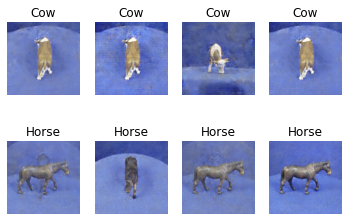

18301 [D loss: 0.141502, acc.: 95.31%] [G loss: 3.726138]
18302 [D loss: 0.276670, acc.: 92.19%] [G loss: 4.012259]
18303 [D loss: 0.178148, acc.: 95.31%] [G loss: 3.719924]
18304 [D loss: 0.130477, acc.: 96.88%] [G loss: 3.665046]
18305 [D loss: 0.032666, acc.: 100.00%] [G loss: 3.789943]
18306 [D loss: 0.041527, acc.: 98.44%] [G loss: 4.055069]
18307 [D loss: 0.153213, acc.: 96.88%] [G loss: 3.387105]
18308 [D loss: 0.019193, acc.: 100.00%] [G loss: 4.012923]
18309 [D loss: 0.172608, acc.: 95.31%] [G loss: 3.543901]
18310 [D loss: 0.062305, acc.: 98.44%] [G loss: 4.132968]
18311 [D loss: 0.094154, acc.: 98.44%] [G loss: 3.397914]
18312 [D loss: 0.347864, acc.: 90.62%] [G loss: 2.933224]
18313 [D loss: 0.208957, acc.: 93.75%] [G loss: 3.212841]
18314 [D loss: 0.247829, acc.: 93.75%] [G loss: 2.917042]
18315 [D loss: 0.125018, acc.: 96.88%] [G loss: 3.235524]
18316 [D loss: 0.040764, acc.: 100.00%] [G loss: 3.469701]
18317 [D loss: 0.074934, acc.: 98.44%] [G loss: 2.817387]
18318 [D lo

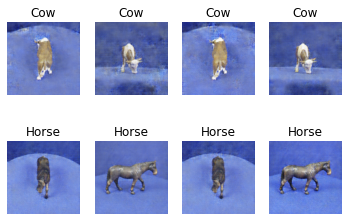

18401 [D loss: 0.015702, acc.: 100.00%] [G loss: 3.943356]
18402 [D loss: 0.089740, acc.: 96.88%] [G loss: 4.063019]
18403 [D loss: 0.243203, acc.: 93.75%] [G loss: 4.264812]
18404 [D loss: 0.070679, acc.: 98.44%] [G loss: 5.024855]
18405 [D loss: 0.164867, acc.: 95.31%] [G loss: 3.554776]
18406 [D loss: 0.167152, acc.: 95.31%] [G loss: 3.592636]
18407 [D loss: 0.075052, acc.: 98.44%] [G loss: 4.294939]
18408 [D loss: 0.177660, acc.: 95.31%] [G loss: 4.083492]
18409 [D loss: 0.097770, acc.: 96.88%] [G loss: 4.231126]
18410 [D loss: 0.078634, acc.: 98.44%] [G loss: 3.939025]
18411 [D loss: 0.077356, acc.: 98.44%] [G loss: 4.037206]
18412 [D loss: 0.013521, acc.: 100.00%] [G loss: 4.957071]
18413 [D loss: 0.302392, acc.: 92.19%] [G loss: 3.419221]
18414 [D loss: 0.022408, acc.: 100.00%] [G loss: 4.460191]
18415 [D loss: 0.056097, acc.: 98.44%] [G loss: 3.617147]
18416 [D loss: 0.171779, acc.: 95.31%] [G loss: 4.364927]
18417 [D loss: 0.218794, acc.: 92.19%] [G loss: 2.850390]
18418 [D lo

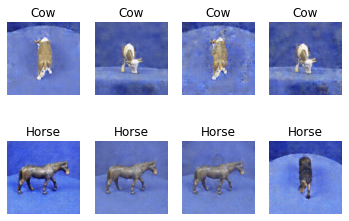

18501 [D loss: 0.091162, acc.: 98.44%] [G loss: 3.398938]
18502 [D loss: 0.070710, acc.: 98.44%] [G loss: 3.590790]
18503 [D loss: 0.071523, acc.: 98.44%] [G loss: 3.474180]
18504 [D loss: 0.244827, acc.: 92.19%] [G loss: 3.481119]
18505 [D loss: 0.219246, acc.: 92.19%] [G loss: 2.844907]
18506 [D loss: 0.063574, acc.: 98.44%] [G loss: 2.914101]
18507 [D loss: 0.074065, acc.: 98.44%] [G loss: 3.121132]
18508 [D loss: 0.087501, acc.: 96.88%] [G loss: 3.842962]
18509 [D loss: 0.074603, acc.: 98.44%] [G loss: 3.467012]
18510 [D loss: 0.034957, acc.: 100.00%] [G loss: 3.527593]
18511 [D loss: 0.188036, acc.: 93.75%] [G loss: 3.933480]
18512 [D loss: 0.086999, acc.: 96.88%] [G loss: 3.885154]
18513 [D loss: 0.233551, acc.: 92.19%] [G loss: 3.658069]
18514 [D loss: 0.160399, acc.: 96.88%] [G loss: 2.883911]
18515 [D loss: 0.039930, acc.: 100.00%] [G loss: 3.630749]
18516 [D loss: 0.067466, acc.: 98.44%] [G loss: 4.093495]
18517 [D loss: 0.108555, acc.: 95.31%] [G loss: 3.766056]
18518 [D los

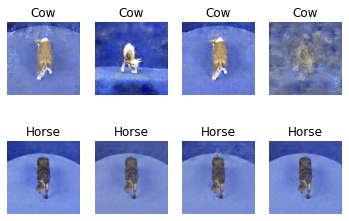

18601 [D loss: 0.082730, acc.: 98.44%] [G loss: 4.579175]
18602 [D loss: 0.123056, acc.: 95.31%] [G loss: 4.241848]
18603 [D loss: 0.023712, acc.: 100.00%] [G loss: 4.849779]
18604 [D loss: 0.015707, acc.: 100.00%] [G loss: 4.439696]
18605 [D loss: 0.010675, acc.: 100.00%] [G loss: 5.109855]
18606 [D loss: 0.014404, acc.: 100.00%] [G loss: 4.887819]
18607 [D loss: 0.093733, acc.: 98.44%] [G loss: 4.724447]
18608 [D loss: 0.015087, acc.: 100.00%] [G loss: 5.137939]
18609 [D loss: 0.107536, acc.: 96.88%] [G loss: 4.537395]
18610 [D loss: 0.081326, acc.: 96.88%] [G loss: 3.991502]
18611 [D loss: 0.198738, acc.: 93.75%] [G loss: 3.587538]
18612 [D loss: 0.024154, acc.: 100.00%] [G loss: 4.231432]
18613 [D loss: 0.115309, acc.: 95.31%] [G loss: 3.987360]
18614 [D loss: 0.106963, acc.: 96.88%] [G loss: 4.206801]
18615 [D loss: 0.122999, acc.: 96.88%] [G loss: 4.003515]
18616 [D loss: 0.142062, acc.: 96.88%] [G loss: 4.898500]
18617 [D loss: 0.149162, acc.: 95.31%] [G loss: 4.396984]
18618 [D

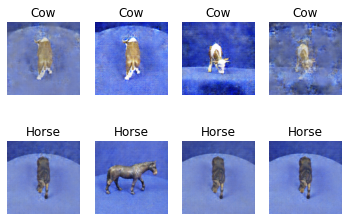

18701 [D loss: 0.047872, acc.: 100.00%] [G loss: 3.861742]
18702 [D loss: 0.161214, acc.: 92.19%] [G loss: 3.535907]
18703 [D loss: 0.037912, acc.: 98.44%] [G loss: 3.983580]
18704 [D loss: 0.059069, acc.: 98.44%] [G loss: 3.910641]
18705 [D loss: 0.046791, acc.: 98.44%] [G loss: 5.338546]
18706 [D loss: 0.018349, acc.: 100.00%] [G loss: 4.945634]
18707 [D loss: 0.183646, acc.: 93.75%] [G loss: 5.448986]
18708 [D loss: 0.025191, acc.: 100.00%] [G loss: 4.957147]
18709 [D loss: 0.247319, acc.: 93.75%] [G loss: 4.393564]
18710 [D loss: 0.070271, acc.: 98.44%] [G loss: 4.132175]
18711 [D loss: 0.060299, acc.: 98.44%] [G loss: 5.706522]
18712 [D loss: 0.020992, acc.: 100.00%] [G loss: 5.499386]
18713 [D loss: 0.091617, acc.: 96.88%] [G loss: 3.937930]
18714 [D loss: 0.149321, acc.: 93.75%] [G loss: 4.666776]
18715 [D loss: 0.056070, acc.: 98.44%] [G loss: 4.779448]
18716 [D loss: 0.032551, acc.: 100.00%] [G loss: 4.331629]
18717 [D loss: 0.226196, acc.: 92.19%] [G loss: 4.200458]
18718 [D 

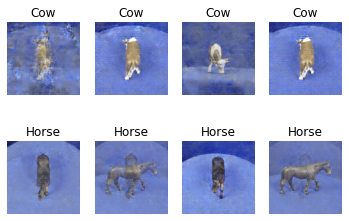

18801 [D loss: 0.086269, acc.: 98.44%] [G loss: 3.696734]
18802 [D loss: 0.131886, acc.: 95.31%] [G loss: 4.593942]
18803 [D loss: 0.069410, acc.: 98.44%] [G loss: 3.858503]
18804 [D loss: 0.225337, acc.: 93.75%] [G loss: 5.393317]
18805 [D loss: 0.056227, acc.: 98.44%] [G loss: 4.895928]
18806 [D loss: 0.034297, acc.: 100.00%] [G loss: 3.435819]
18807 [D loss: 0.072962, acc.: 98.44%] [G loss: 3.642025]
18808 [D loss: 0.219027, acc.: 92.19%] [G loss: 4.456265]
18809 [D loss: 0.064013, acc.: 98.44%] [G loss: 3.074624]
18810 [D loss: 0.058236, acc.: 98.44%] [G loss: 3.642175]
18811 [D loss: 0.020418, acc.: 100.00%] [G loss: 4.211161]
18812 [D loss: 0.113415, acc.: 96.88%] [G loss: 4.474732]
18813 [D loss: 0.020514, acc.: 100.00%] [G loss: 3.928518]
18814 [D loss: 0.070589, acc.: 98.44%] [G loss: 4.608948]
18815 [D loss: 0.042470, acc.: 98.44%] [G loss: 7.303962]
18816 [D loss: 0.013205, acc.: 100.00%] [G loss: 5.896099]
18817 [D loss: 0.163838, acc.: 95.31%] [G loss: 5.999349]
18818 [D l

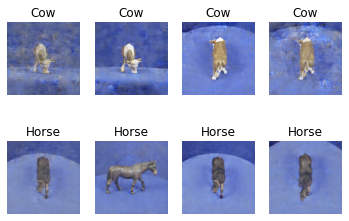

18901 [D loss: 0.044858, acc.: 98.44%] [G loss: 4.027242]
18902 [D loss: 0.168084, acc.: 95.31%] [G loss: 3.279482]
18903 [D loss: 0.145750, acc.: 95.31%] [G loss: 2.810001]
18904 [D loss: 0.105309, acc.: 96.88%] [G loss: 3.356106]
18905 [D loss: 0.086548, acc.: 96.88%] [G loss: 3.485041]
18906 [D loss: 0.156300, acc.: 95.31%] [G loss: 3.657621]
18907 [D loss: 0.065251, acc.: 98.44%] [G loss: 3.329948]
18908 [D loss: 0.136957, acc.: 95.31%] [G loss: 3.529900]
18909 [D loss: 0.178317, acc.: 95.31%] [G loss: 3.341747]
18910 [D loss: 0.121750, acc.: 95.31%] [G loss: 3.214395]
18911 [D loss: 0.120477, acc.: 96.88%] [G loss: 3.299839]
18912 [D loss: 0.160789, acc.: 95.31%] [G loss: 2.758695]
18913 [D loss: 0.091531, acc.: 98.44%] [G loss: 3.379661]
18914 [D loss: 0.114749, acc.: 96.88%] [G loss: 3.140730]
18915 [D loss: 0.148399, acc.: 96.88%] [G loss: 3.346519]
18916 [D loss: 0.231443, acc.: 93.75%] [G loss: 3.586257]
18917 [D loss: 0.080047, acc.: 98.44%] [G loss: 2.916301]
18918 [D loss:

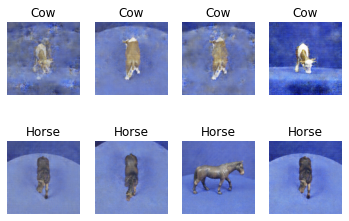

19001 [D loss: 0.050860, acc.: 98.44%] [G loss: 4.139100]
19002 [D loss: 0.056064, acc.: 98.44%] [G loss: 4.869855]
19003 [D loss: 0.091704, acc.: 96.88%] [G loss: 5.136932]
19004 [D loss: 0.175310, acc.: 95.31%] [G loss: 3.806574]
19005 [D loss: 0.092185, acc.: 96.88%] [G loss: 3.797703]
19006 [D loss: 0.075621, acc.: 98.44%] [G loss: 3.584854]
19007 [D loss: 0.049818, acc.: 98.44%] [G loss: 4.027917]
19008 [D loss: 0.161728, acc.: 95.31%] [G loss: 3.572850]
19009 [D loss: 0.117308, acc.: 96.88%] [G loss: 3.465183]
19010 [D loss: 0.059709, acc.: 98.44%] [G loss: 3.676881]
19011 [D loss: 0.022869, acc.: 100.00%] [G loss: 4.079741]
19012 [D loss: 0.047821, acc.: 98.44%] [G loss: 4.320770]
19013 [D loss: 0.232988, acc.: 93.75%] [G loss: 5.856077]
19014 [D loss: 0.203078, acc.: 93.75%] [G loss: 5.035394]
19015 [D loss: 0.153939, acc.: 95.31%] [G loss: 5.302813]
19016 [D loss: 0.110452, acc.: 95.31%] [G loss: 5.170629]
19017 [D loss: 0.130331, acc.: 96.88%] [G loss: 3.071307]
19018 [D loss

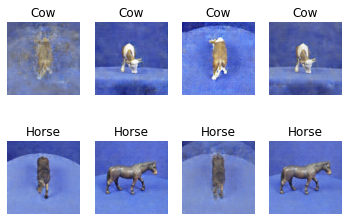

19101 [D loss: 0.082090, acc.: 98.44%] [G loss: 4.426135]
19102 [D loss: 0.166538, acc.: 93.75%] [G loss: 4.584515]
19103 [D loss: 0.064921, acc.: 98.44%] [G loss: 3.722251]
19104 [D loss: 0.042680, acc.: 98.44%] [G loss: 4.622370]
19105 [D loss: 0.140411, acc.: 95.31%] [G loss: 3.486696]
19106 [D loss: 0.195894, acc.: 95.31%] [G loss: 4.206422]
19107 [D loss: 0.081867, acc.: 96.88%] [G loss: 4.114166]
19108 [D loss: 0.147019, acc.: 96.88%] [G loss: 3.522265]
19109 [D loss: 0.124513, acc.: 96.88%] [G loss: 3.231604]
19110 [D loss: 0.031702, acc.: 100.00%] [G loss: 3.420583]
19111 [D loss: 0.103865, acc.: 96.88%] [G loss: 3.867191]
19112 [D loss: 0.074997, acc.: 96.88%] [G loss: 4.094267]
19113 [D loss: 0.140660, acc.: 96.88%] [G loss: 4.000635]
19114 [D loss: 0.145972, acc.: 95.31%] [G loss: 4.065648]
19115 [D loss: 0.198720, acc.: 92.19%] [G loss: 3.947120]
19116 [D loss: 0.082985, acc.: 98.44%] [G loss: 3.375500]
19117 [D loss: 0.070637, acc.: 96.88%] [G loss: 4.253324]
19118 [D loss

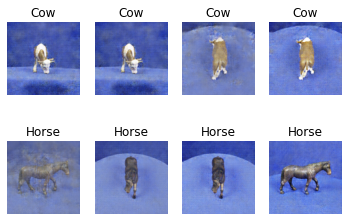

19201 [D loss: 0.099506, acc.: 95.31%] [G loss: 4.022444]
19202 [D loss: 0.014306, acc.: 100.00%] [G loss: 4.577660]
19203 [D loss: 0.175651, acc.: 95.31%] [G loss: 4.376177]
19204 [D loss: 0.092272, acc.: 96.88%] [G loss: 4.591851]
19205 [D loss: 0.021963, acc.: 100.00%] [G loss: 4.808481]
19206 [D loss: 0.130218, acc.: 96.88%] [G loss: 3.766214]
19207 [D loss: 0.020098, acc.: 100.00%] [G loss: 4.210748]
19208 [D loss: 0.101602, acc.: 96.88%] [G loss: 4.300111]
19209 [D loss: 0.090839, acc.: 96.88%] [G loss: 4.917710]
19210 [D loss: 0.016209, acc.: 100.00%] [G loss: 4.304500]
19211 [D loss: 0.110248, acc.: 96.88%] [G loss: 4.549832]
19212 [D loss: 0.126226, acc.: 95.31%] [G loss: 5.280070]
19213 [D loss: 0.086090, acc.: 98.44%] [G loss: 4.197783]
19214 [D loss: 0.101604, acc.: 96.88%] [G loss: 4.522605]
19215 [D loss: 0.107972, acc.: 95.31%] [G loss: 4.371660]
19216 [D loss: 0.051930, acc.: 98.44%] [G loss: 4.419814]
19217 [D loss: 0.160688, acc.: 95.31%] [G loss: 4.415572]
19218 [D l

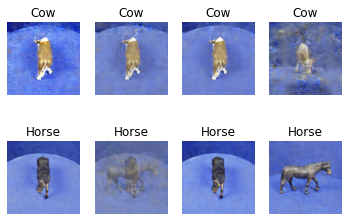

19301 [D loss: 0.074494, acc.: 98.44%] [G loss: 5.134386]
19302 [D loss: 0.078976, acc.: 96.88%] [G loss: 4.162654]
19303 [D loss: 0.052688, acc.: 98.44%] [G loss: 5.078607]
19304 [D loss: 0.066655, acc.: 98.44%] [G loss: 5.283344]
19305 [D loss: 0.056072, acc.: 98.44%] [G loss: 4.248771]
19306 [D loss: 0.086914, acc.: 96.88%] [G loss: 6.275161]
19307 [D loss: 0.121293, acc.: 96.88%] [G loss: 4.724809]
19308 [D loss: 0.096503, acc.: 96.88%] [G loss: 3.444448]
19309 [D loss: 0.126628, acc.: 96.88%] [G loss: 4.165081]
19310 [D loss: 0.051072, acc.: 98.44%] [G loss: 4.313355]
19311 [D loss: 0.048614, acc.: 98.44%] [G loss: 4.616816]
19312 [D loss: 0.014984, acc.: 100.00%] [G loss: 5.076397]
19313 [D loss: 0.251273, acc.: 93.75%] [G loss: 4.149074]
19314 [D loss: 0.018527, acc.: 100.00%] [G loss: 4.568370]
19315 [D loss: 0.028458, acc.: 100.00%] [G loss: 5.453871]
19316 [D loss: 0.169748, acc.: 93.75%] [G loss: 3.734169]
19317 [D loss: 0.189993, acc.: 93.75%] [G loss: 4.578722]
19318 [D lo

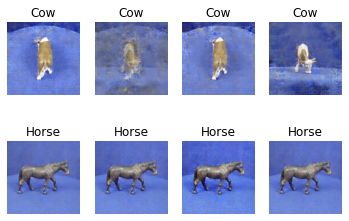

19401 [D loss: 0.021159, acc.: 98.44%] [G loss: 5.371633]
19402 [D loss: 0.183227, acc.: 95.31%] [G loss: 4.850653]
19403 [D loss: 0.122279, acc.: 96.88%] [G loss: 4.672488]
19404 [D loss: 0.113989, acc.: 96.88%] [G loss: 3.639302]
19405 [D loss: 0.021351, acc.: 100.00%] [G loss: 3.678784]
19406 [D loss: 0.044744, acc.: 98.44%] [G loss: 4.798828]
19407 [D loss: 0.035539, acc.: 98.44%] [G loss: 4.550744]
19408 [D loss: 0.137739, acc.: 96.88%] [G loss: 4.320415]
19409 [D loss: 0.115704, acc.: 95.31%] [G loss: 3.818022]
19410 [D loss: 0.102980, acc.: 96.88%] [G loss: 3.881996]
19411 [D loss: 0.126476, acc.: 96.88%] [G loss: 3.907102]
19412 [D loss: 0.080250, acc.: 98.44%] [G loss: 3.876615]
19413 [D loss: 0.033559, acc.: 100.00%] [G loss: 4.075529]
19414 [D loss: 0.066652, acc.: 98.44%] [G loss: 4.728944]
19415 [D loss: 0.081010, acc.: 96.88%] [G loss: 4.439569]
19416 [D loss: 0.098446, acc.: 96.88%] [G loss: 3.798913]
19417 [D loss: 0.072850, acc.: 98.44%] [G loss: 4.449969]
19418 [D los

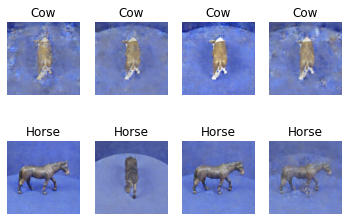

19501 [D loss: 0.056144, acc.: 98.44%] [G loss: 3.645842]
19502 [D loss: 0.051888, acc.: 98.44%] [G loss: 3.964691]
19503 [D loss: 0.082982, acc.: 96.88%] [G loss: 3.416989]
19504 [D loss: 0.079535, acc.: 98.44%] [G loss: 3.218781]
19505 [D loss: 0.095846, acc.: 96.88%] [G loss: 4.750975]
19506 [D loss: 0.109356, acc.: 96.88%] [G loss: 3.799603]
19507 [D loss: 0.102467, acc.: 98.44%] [G loss: 3.545785]
19508 [D loss: 0.083979, acc.: 98.44%] [G loss: 3.826302]
19509 [D loss: 0.069160, acc.: 98.44%] [G loss: 4.260443]
19510 [D loss: 0.118631, acc.: 95.31%] [G loss: 7.001428]
19511 [D loss: 0.026683, acc.: 100.00%] [G loss: 3.854431]
19512 [D loss: 0.088422, acc.: 96.88%] [G loss: 3.594757]
19513 [D loss: 0.102025, acc.: 96.88%] [G loss: 3.695537]
19514 [D loss: 0.141373, acc.: 95.31%] [G loss: 5.326902]
19515 [D loss: 0.025628, acc.: 100.00%] [G loss: 5.719838]
19516 [D loss: 0.068911, acc.: 98.44%] [G loss: 3.893414]
19517 [D loss: 0.075628, acc.: 98.44%] [G loss: 4.924819]
19518 [D los

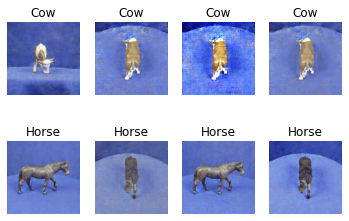

19601 [D loss: 0.057942, acc.: 98.44%] [G loss: 4.223833]
19602 [D loss: 0.025819, acc.: 100.00%] [G loss: 4.159333]
19603 [D loss: 0.104975, acc.: 96.88%] [G loss: 5.541033]
19604 [D loss: 0.117435, acc.: 96.88%] [G loss: 4.455489]
19605 [D loss: 0.069729, acc.: 98.44%] [G loss: 4.311898]
19606 [D loss: 0.067370, acc.: 98.44%] [G loss: 4.546092]
19607 [D loss: 0.148203, acc.: 95.31%] [G loss: 3.705378]
19608 [D loss: 0.114605, acc.: 96.88%] [G loss: 3.271468]
19609 [D loss: 0.074509, acc.: 98.44%] [G loss: 3.173940]
19610 [D loss: 0.079952, acc.: 98.44%] [G loss: 3.148213]
19611 [D loss: 0.028912, acc.: 100.00%] [G loss: 3.985218]
19612 [D loss: 0.108348, acc.: 96.88%] [G loss: 4.341818]
19613 [D loss: 0.108329, acc.: 96.88%] [G loss: 3.918865]
19614 [D loss: 0.044226, acc.: 98.44%] [G loss: 4.761708]
19615 [D loss: 0.027565, acc.: 100.00%] [G loss: 3.754824]
19616 [D loss: 0.018569, acc.: 100.00%] [G loss: 4.197488]
19617 [D loss: 0.119383, acc.: 96.88%] [G loss: 4.679013]
19618 [D l

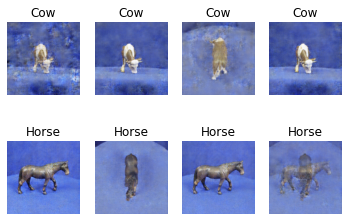

19701 [D loss: 0.060746, acc.: 98.44%] [G loss: 4.032724]
19702 [D loss: 0.059435, acc.: 98.44%] [G loss: 4.291907]
19703 [D loss: 0.076784, acc.: 98.44%] [G loss: 4.258229]
19704 [D loss: 0.115919, acc.: 96.88%] [G loss: 4.825787]
19705 [D loss: 0.203962, acc.: 95.31%] [G loss: 4.328946]
19706 [D loss: 0.067482, acc.: 98.44%] [G loss: 3.766345]
19707 [D loss: 0.015418, acc.: 100.00%] [G loss: 4.398711]
19708 [D loss: 0.151756, acc.: 95.31%] [G loss: 4.179557]
19709 [D loss: 0.070098, acc.: 98.44%] [G loss: 3.681657]
19710 [D loss: 0.209186, acc.: 92.19%] [G loss: 3.973094]
19711 [D loss: 0.145771, acc.: 95.31%] [G loss: 4.348436]
19712 [D loss: 0.065611, acc.: 96.88%] [G loss: 4.702387]
19713 [D loss: 0.061297, acc.: 98.44%] [G loss: 5.456626]
19714 [D loss: 0.213262, acc.: 93.75%] [G loss: 4.792407]
19715 [D loss: 0.043158, acc.: 98.44%] [G loss: 4.775708]
19716 [D loss: 0.059912, acc.: 98.44%] [G loss: 4.215278]
19717 [D loss: 0.081764, acc.: 98.44%] [G loss: 5.290283]
19718 [D loss

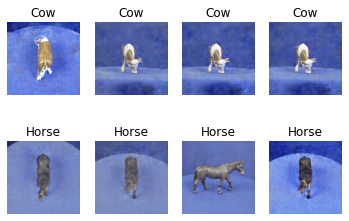

19801 [D loss: 0.090366, acc.: 96.88%] [G loss: 4.332768]
19802 [D loss: 0.062994, acc.: 98.44%] [G loss: 3.484286]
19803 [D loss: 0.108302, acc.: 96.88%] [G loss: 4.825311]
19804 [D loss: 0.071120, acc.: 96.88%] [G loss: 5.311916]
19805 [D loss: 0.118199, acc.: 95.31%] [G loss: 3.982190]
19806 [D loss: 0.048562, acc.: 100.00%] [G loss: 4.290859]
19807 [D loss: 0.025708, acc.: 100.00%] [G loss: 4.239069]
19808 [D loss: 0.069755, acc.: 98.44%] [G loss: 3.893235]
19809 [D loss: 0.014704, acc.: 100.00%] [G loss: 5.292435]
19810 [D loss: 0.196790, acc.: 93.75%] [G loss: 4.421868]
19811 [D loss: 0.135188, acc.: 96.88%] [G loss: 3.408010]
19812 [D loss: 0.087243, acc.: 98.44%] [G loss: 3.877324]
19813 [D loss: 0.020881, acc.: 100.00%] [G loss: 4.482211]
19814 [D loss: 0.052890, acc.: 98.44%] [G loss: 4.422140]
19815 [D loss: 0.096598, acc.: 98.44%] [G loss: 3.949735]
19816 [D loss: 0.071301, acc.: 98.44%] [G loss: 4.265938]
19817 [D loss: 0.258815, acc.: 93.75%] [G loss: 3.213360]
19818 [D l

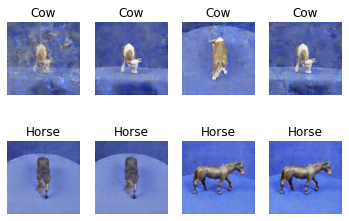

19901 [D loss: 0.045515, acc.: 98.44%] [G loss: 4.907729]
19902 [D loss: 0.124385, acc.: 96.88%] [G loss: 6.430068]
19903 [D loss: 0.100680, acc.: 96.88%] [G loss: 4.976110]
19904 [D loss: 0.135494, acc.: 96.88%] [G loss: 4.456623]
19905 [D loss: 0.010978, acc.: 100.00%] [G loss: 4.516101]
19906 [D loss: 0.157642, acc.: 95.31%] [G loss: 3.751815]
19907 [D loss: 0.047215, acc.: 98.44%] [G loss: 5.139262]
19908 [D loss: 0.084998, acc.: 98.44%] [G loss: 5.543996]
19909 [D loss: 0.159164, acc.: 93.75%] [G loss: 3.638155]
19910 [D loss: 0.090747, acc.: 96.88%] [G loss: 4.695220]
19911 [D loss: 0.078508, acc.: 96.88%] [G loss: 4.415071]
19912 [D loss: 0.113297, acc.: 96.88%] [G loss: 4.064012]
19913 [D loss: 0.056641, acc.: 98.44%] [G loss: 5.549741]
19914 [D loss: 0.205687, acc.: 95.31%] [G loss: 4.918704]
19915 [D loss: 0.068121, acc.: 98.44%] [G loss: 4.819424]
19916 [D loss: 0.036963, acc.: 100.00%] [G loss: 4.393304]
19917 [D loss: 0.136424, acc.: 95.31%] [G loss: 5.994594]
19918 [D los

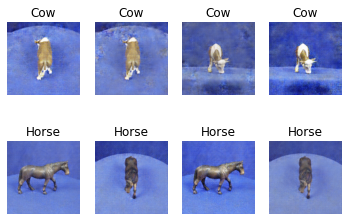

20001 [D loss: 0.062950, acc.: 98.44%] [G loss: 4.544170]
20002 [D loss: 0.011913, acc.: 100.00%] [G loss: 6.111959]
20003 [D loss: 0.058924, acc.: 98.44%] [G loss: 5.626595]
20004 [D loss: 0.080364, acc.: 98.44%] [G loss: 4.304570]
20005 [D loss: 0.008898, acc.: 100.00%] [G loss: 5.326960]
20006 [D loss: 0.010699, acc.: 100.00%] [G loss: 4.739632]
20007 [D loss: 0.208950, acc.: 93.75%] [G loss: 6.672743]
20008 [D loss: 0.199088, acc.: 90.62%] [G loss: 7.709087]
20009 [D loss: 0.103964, acc.: 96.88%] [G loss: 4.049588]
20010 [D loss: 0.174434, acc.: 93.75%] [G loss: 4.613576]
20011 [D loss: 0.046054, acc.: 98.44%] [G loss: 3.658933]
20012 [D loss: 0.116846, acc.: 98.44%] [G loss: 3.315785]
20013 [D loss: 0.174204, acc.: 93.75%] [G loss: 5.106534]
20014 [D loss: 0.185362, acc.: 95.31%] [G loss: 3.467674]
20015 [D loss: 0.075406, acc.: 98.44%] [G loss: 4.611182]
20016 [D loss: 0.183438, acc.: 93.75%] [G loss: 4.204956]
20017 [D loss: 0.126303, acc.: 96.88%] [G loss: 3.905555]
20018 [D lo

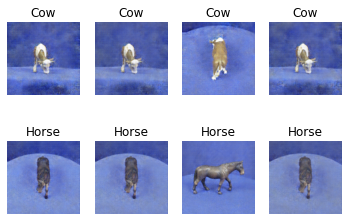

20101 [D loss: 0.017728, acc.: 100.00%] [G loss: 4.705854]
20102 [D loss: 0.224609, acc.: 92.19%] [G loss: 5.126863]
20103 [D loss: 0.041228, acc.: 98.44%] [G loss: 5.145381]
20104 [D loss: 0.293169, acc.: 93.75%] [G loss: 6.463500]
20105 [D loss: 0.045288, acc.: 96.88%] [G loss: 4.319227]
20106 [D loss: 0.096739, acc.: 98.44%] [G loss: 4.080647]
20107 [D loss: 0.140292, acc.: 93.75%] [G loss: 4.129943]
20108 [D loss: 0.083922, acc.: 98.44%] [G loss: 4.083096]
20109 [D loss: 0.202781, acc.: 95.31%] [G loss: 3.502701]
20110 [D loss: 0.064563, acc.: 98.44%] [G loss: 3.312413]
20111 [D loss: 0.107145, acc.: 96.88%] [G loss: 3.365626]
20112 [D loss: 0.337500, acc.: 87.50%] [G loss: 3.019125]
20113 [D loss: 0.040605, acc.: 100.00%] [G loss: 3.351607]
20114 [D loss: 0.160941, acc.: 95.31%] [G loss: 3.626844]
20115 [D loss: 0.061183, acc.: 98.44%] [G loss: 3.733236]
20116 [D loss: 0.019324, acc.: 100.00%] [G loss: 3.754409]
20117 [D loss: 0.062313, acc.: 98.44%] [G loss: 3.882983]
20118 [D lo

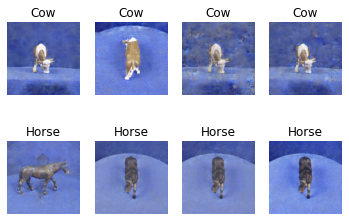

20201 [D loss: 0.073385, acc.: 98.44%] [G loss: 3.254792]
20202 [D loss: 0.039811, acc.: 100.00%] [G loss: 3.563788]
20203 [D loss: 0.126649, acc.: 95.31%] [G loss: 3.580206]
20204 [D loss: 0.023031, acc.: 100.00%] [G loss: 3.809938]
20205 [D loss: 0.047731, acc.: 98.44%] [G loss: 4.027250]
20206 [D loss: 0.067198, acc.: 98.44%] [G loss: 4.018046]
20207 [D loss: 0.165816, acc.: 95.31%] [G loss: 4.679658]
20208 [D loss: 0.170977, acc.: 95.31%] [G loss: 4.621554]
20209 [D loss: 0.163308, acc.: 95.31%] [G loss: 3.141798]
20210 [D loss: 0.119550, acc.: 96.88%] [G loss: 3.559394]
20211 [D loss: 0.056244, acc.: 98.44%] [G loss: 3.710893]
20212 [D loss: 0.202561, acc.: 93.75%] [G loss: 3.681964]
20213 [D loss: 0.129761, acc.: 96.88%] [G loss: 4.224162]
20214 [D loss: 0.086055, acc.: 96.88%] [G loss: 4.089537]
20215 [D loss: 0.104437, acc.: 96.88%] [G loss: 5.172462]
20216 [D loss: 0.076597, acc.: 98.44%] [G loss: 3.603174]
20217 [D loss: 0.031127, acc.: 100.00%] [G loss: 4.263546]
20218 [D lo

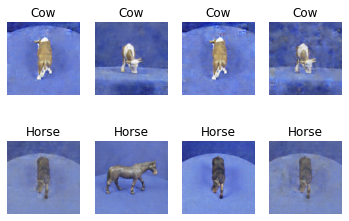

20301 [D loss: 0.085085, acc.: 98.44%] [G loss: 3.499904]
20302 [D loss: 0.164924, acc.: 93.75%] [G loss: 3.741415]
20303 [D loss: 0.089304, acc.: 98.44%] [G loss: 3.316350]
20304 [D loss: 0.018917, acc.: 100.00%] [G loss: 4.366585]
20305 [D loss: 0.056799, acc.: 98.44%] [G loss: 3.837873]
20306 [D loss: 0.153704, acc.: 92.19%] [G loss: 5.287433]
20307 [D loss: 0.016760, acc.: 100.00%] [G loss: 4.415091]
20308 [D loss: 0.077650, acc.: 98.44%] [G loss: 4.892195]
20309 [D loss: 0.300264, acc.: 92.19%] [G loss: 3.568928]
20310 [D loss: 0.152766, acc.: 95.31%] [G loss: 3.474608]
20311 [D loss: 0.195777, acc.: 95.31%] [G loss: 3.845117]
20312 [D loss: 0.020840, acc.: 100.00%] [G loss: 3.975569]
20313 [D loss: 0.102730, acc.: 96.88%] [G loss: 3.550653]
20314 [D loss: 0.194371, acc.: 90.62%] [G loss: 3.570239]
20315 [D loss: 0.204212, acc.: 93.75%] [G loss: 3.261553]
20316 [D loss: 0.068278, acc.: 98.44%] [G loss: 3.436386]
20317 [D loss: 0.178125, acc.: 93.75%] [G loss: 3.067811]
20318 [D lo

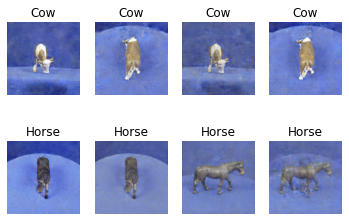

20401 [D loss: 0.112965, acc.: 96.88%] [G loss: 3.591661]
20402 [D loss: 0.096446, acc.: 96.88%] [G loss: 3.512647]
20403 [D loss: 0.058051, acc.: 98.44%] [G loss: 4.052826]
20404 [D loss: 0.136846, acc.: 95.31%] [G loss: 3.980452]
20405 [D loss: 0.095648, acc.: 96.88%] [G loss: 3.359753]
20406 [D loss: 0.085474, acc.: 98.44%] [G loss: 3.398674]
20407 [D loss: 0.101208, acc.: 96.88%] [G loss: 3.806526]
20408 [D loss: 0.155042, acc.: 95.31%] [G loss: 4.032610]
20409 [D loss: 0.021571, acc.: 100.00%] [G loss: 4.264275]
20410 [D loss: 0.154759, acc.: 95.31%] [G loss: 5.819754]
20411 [D loss: 0.095872, acc.: 96.88%] [G loss: 3.485141]
20412 [D loss: 0.207658, acc.: 95.31%] [G loss: 3.552490]
20413 [D loss: 0.092813, acc.: 96.88%] [G loss: 3.761248]
20414 [D loss: 0.142205, acc.: 95.31%] [G loss: 3.240600]
20415 [D loss: 0.102505, acc.: 96.88%] [G loss: 3.413929]
20416 [D loss: 0.150096, acc.: 95.31%] [G loss: 3.722305]
20417 [D loss: 0.034540, acc.: 100.00%] [G loss: 3.844779]
20418 [D los

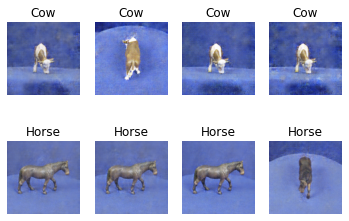

20501 [D loss: 0.050912, acc.: 98.44%] [G loss: 3.780154]
20502 [D loss: 0.090406, acc.: 96.88%] [G loss: 3.490269]
20503 [D loss: 0.136180, acc.: 96.88%] [G loss: 3.633497]
20504 [D loss: 0.073867, acc.: 96.88%] [G loss: 4.088316]
20505 [D loss: 0.017562, acc.: 100.00%] [G loss: 4.233507]
20506 [D loss: 0.159697, acc.: 95.31%] [G loss: 3.808112]
20507 [D loss: 0.157561, acc.: 95.31%] [G loss: 4.756121]
20508 [D loss: 0.131547, acc.: 92.19%] [G loss: 3.997287]
20509 [D loss: 0.023832, acc.: 100.00%] [G loss: 4.846291]
20510 [D loss: 0.107258, acc.: 96.88%] [G loss: 4.491986]
20511 [D loss: 0.086828, acc.: 98.44%] [G loss: 5.678132]
20512 [D loss: 0.067350, acc.: 96.88%] [G loss: 4.297236]
20513 [D loss: 0.065554, acc.: 98.44%] [G loss: 5.062767]
20514 [D loss: 0.081963, acc.: 98.44%] [G loss: 3.632070]
20515 [D loss: 0.103205, acc.: 96.88%] [G loss: 4.058937]
20516 [D loss: 0.094559, acc.: 96.88%] [G loss: 4.139678]
20517 [D loss: 0.173760, acc.: 93.75%] [G loss: 4.310908]
20518 [D los

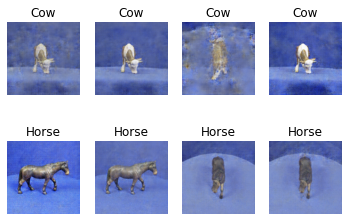

20601 [D loss: 0.122958, acc.: 96.88%] [G loss: 3.977090]
20602 [D loss: 0.182027, acc.: 93.75%] [G loss: 3.702320]
20603 [D loss: 0.066749, acc.: 98.44%] [G loss: 4.104851]
20604 [D loss: 0.066218, acc.: 98.44%] [G loss: 4.952086]
20605 [D loss: 0.007411, acc.: 100.00%] [G loss: 6.206597]
20606 [D loss: 0.047460, acc.: 98.44%] [G loss: 4.380991]
20607 [D loss: 0.104888, acc.: 96.88%] [G loss: 4.436793]
20608 [D loss: 0.022963, acc.: 100.00%] [G loss: 4.971251]
20609 [D loss: 0.014539, acc.: 100.00%] [G loss: 4.924086]
20610 [D loss: 0.158615, acc.: 96.88%] [G loss: 4.889642]
20611 [D loss: 0.065351, acc.: 98.44%] [G loss: 4.105083]
20612 [D loss: 0.168449, acc.: 96.88%] [G loss: 4.255689]
20613 [D loss: 0.109762, acc.: 96.88%] [G loss: 4.245370]
20614 [D loss: 0.031630, acc.: 100.00%] [G loss: 4.519859]
20615 [D loss: 0.076692, acc.: 98.44%] [G loss: 4.164605]
20616 [D loss: 0.166739, acc.: 95.31%] [G loss: 3.877684]
20617 [D loss: 0.133969, acc.: 95.31%] [G loss: 4.450203]
20618 [D l

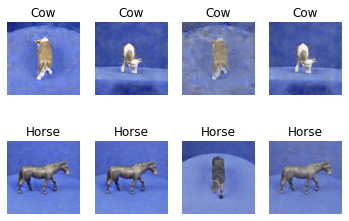

20701 [D loss: 0.102638, acc.: 96.88%] [G loss: 3.545275]
20702 [D loss: 0.053982, acc.: 98.44%] [G loss: 3.669881]
20703 [D loss: 0.069715, acc.: 95.31%] [G loss: 4.279455]
20704 [D loss: 0.018652, acc.: 100.00%] [G loss: 4.346282]
20705 [D loss: 0.063026, acc.: 98.44%] [G loss: 4.715021]
20706 [D loss: 0.012077, acc.: 100.00%] [G loss: 5.185118]
20707 [D loss: 0.034138, acc.: 98.44%] [G loss: 5.641642]
20708 [D loss: 0.086363, acc.: 96.88%] [G loss: 4.443103]
20709 [D loss: 0.176239, acc.: 93.75%] [G loss: 5.911479]
20710 [D loss: 0.056262, acc.: 98.44%] [G loss: 4.200684]
20711 [D loss: 0.017380, acc.: 100.00%] [G loss: 5.381239]
20712 [D loss: 0.082435, acc.: 96.88%] [G loss: 5.033046]
20713 [D loss: 0.032330, acc.: 98.44%] [G loss: 4.750544]
20714 [D loss: 0.161001, acc.: 95.31%] [G loss: 5.221205]
20715 [D loss: 0.102976, acc.: 98.44%] [G loss: 4.890581]
20716 [D loss: 0.052916, acc.: 98.44%] [G loss: 4.504110]
20717 [D loss: 0.148895, acc.: 96.88%] [G loss: 4.175431]
20718 [D lo

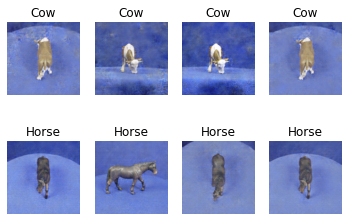

20801 [D loss: 0.088643, acc.: 98.44%] [G loss: 4.102495]
20802 [D loss: 0.019496, acc.: 100.00%] [G loss: 3.977602]
20803 [D loss: 0.032763, acc.: 98.44%] [G loss: 4.763506]
20804 [D loss: 0.070421, acc.: 98.44%] [G loss: 4.505182]
20805 [D loss: 0.017367, acc.: 100.00%] [G loss: 5.613413]
20806 [D loss: 0.017632, acc.: 100.00%] [G loss: 4.228848]
20807 [D loss: 0.134636, acc.: 96.88%] [G loss: 5.395692]
20808 [D loss: 0.075163, acc.: 98.44%] [G loss: 4.241582]
20809 [D loss: 0.139257, acc.: 96.88%] [G loss: 4.106739]
20810 [D loss: 0.257915, acc.: 92.19%] [G loss: 3.346348]
20811 [D loss: 0.134573, acc.: 95.31%] [G loss: 3.056328]
20812 [D loss: 0.024868, acc.: 100.00%] [G loss: 3.467821]
20813 [D loss: 0.146043, acc.: 95.31%] [G loss: 3.691921]
20814 [D loss: 0.032115, acc.: 100.00%] [G loss: 4.034849]
20815 [D loss: 0.049014, acc.: 96.88%] [G loss: 4.578790]
20816 [D loss: 0.040912, acc.: 98.44%] [G loss: 4.558705]
20817 [D loss: 0.057399, acc.: 98.44%] [G loss: 4.621588]
20818 [D 

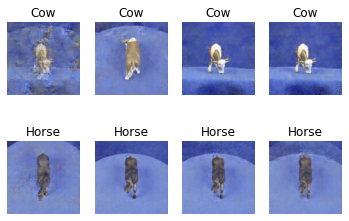

20901 [D loss: 0.056106, acc.: 96.88%] [G loss: 4.080626]
20902 [D loss: 0.095890, acc.: 98.44%] [G loss: 4.747904]
20903 [D loss: 0.109096, acc.: 96.88%] [G loss: 3.692153]
20904 [D loss: 0.131040, acc.: 95.31%] [G loss: 3.411833]
20905 [D loss: 0.136178, acc.: 95.31%] [G loss: 3.642664]
20906 [D loss: 0.131434, acc.: 96.88%] [G loss: 3.195176]
20907 [D loss: 0.085632, acc.: 96.88%] [G loss: 3.398233]
20908 [D loss: 0.060160, acc.: 98.44%] [G loss: 3.295441]
20909 [D loss: 0.068549, acc.: 98.44%] [G loss: 3.902059]
20910 [D loss: 0.132234, acc.: 95.31%] [G loss: 4.245562]
20911 [D loss: 0.095960, acc.: 98.44%] [G loss: 4.730527]
20912 [D loss: 0.042447, acc.: 98.44%] [G loss: 3.525759]
20913 [D loss: 0.071571, acc.: 98.44%] [G loss: 4.193076]
20914 [D loss: 0.162035, acc.: 95.31%] [G loss: 3.890967]
20915 [D loss: 0.029959, acc.: 100.00%] [G loss: 4.254905]
20916 [D loss: 0.066480, acc.: 98.44%] [G loss: 4.862723]
20917 [D loss: 0.018212, acc.: 100.00%] [G loss: 4.276468]
20918 [D los

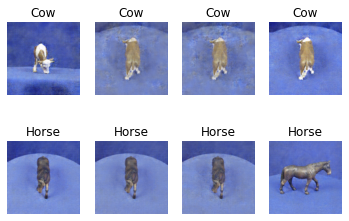

21001 [D loss: 0.150873, acc.: 95.31%] [G loss: 4.134277]
21002 [D loss: 0.161010, acc.: 93.75%] [G loss: 4.689612]
21003 [D loss: 0.056327, acc.: 98.44%] [G loss: 5.377463]
21004 [D loss: 0.039146, acc.: 98.44%] [G loss: 4.628494]
21005 [D loss: 0.147033, acc.: 95.31%] [G loss: 3.355343]
21006 [D loss: 0.044513, acc.: 98.44%] [G loss: 4.114469]
21007 [D loss: 0.063179, acc.: 98.44%] [G loss: 4.964544]
21008 [D loss: 0.115466, acc.: 96.88%] [G loss: 3.644114]
21009 [D loss: 0.040539, acc.: 100.00%] [G loss: 4.272183]
21010 [D loss: 0.028796, acc.: 100.00%] [G loss: 3.484891]
21011 [D loss: 0.240221, acc.: 92.19%] [G loss: 4.176160]
21012 [D loss: 0.014961, acc.: 100.00%] [G loss: 4.353310]
21013 [D loss: 0.181126, acc.: 95.31%] [G loss: 3.789877]
21014 [D loss: 0.017609, acc.: 100.00%] [G loss: 5.055480]
21015 [D loss: 0.099360, acc.: 96.88%] [G loss: 5.482384]
21016 [D loss: 0.093974, acc.: 96.88%] [G loss: 5.102783]
21017 [D loss: 0.029864, acc.: 100.00%] [G loss: 3.858613]
21018 [D 

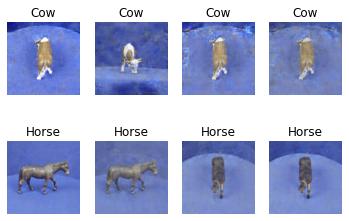

21101 [D loss: 0.094019, acc.: 96.88%] [G loss: 4.156145]
21102 [D loss: 0.086015, acc.: 96.88%] [G loss: 4.073901]
21103 [D loss: 0.098801, acc.: 96.88%] [G loss: 4.288357]
21104 [D loss: 0.087587, acc.: 96.88%] [G loss: 3.694575]
21105 [D loss: 0.080240, acc.: 98.44%] [G loss: 3.965670]
21106 [D loss: 0.070425, acc.: 98.44%] [G loss: 3.602289]
21107 [D loss: 0.084869, acc.: 96.88%] [G loss: 3.634378]
21108 [D loss: 0.038866, acc.: 98.44%] [G loss: 4.806768]
21109 [D loss: 0.186942, acc.: 95.31%] [G loss: 3.932689]
21110 [D loss: 0.079367, acc.: 96.88%] [G loss: 3.678276]
21111 [D loss: 0.121049, acc.: 96.88%] [G loss: 4.011628]
21112 [D loss: 0.021646, acc.: 100.00%] [G loss: 3.940966]
21113 [D loss: 0.125426, acc.: 95.31%] [G loss: 3.719790]
21114 [D loss: 0.352128, acc.: 92.19%] [G loss: 3.656390]
21115 [D loss: 0.089593, acc.: 98.44%] [G loss: 2.952498]
21116 [D loss: 0.039633, acc.: 100.00%] [G loss: 4.562396]
21117 [D loss: 0.113539, acc.: 96.88%] [G loss: 3.373906]
21118 [D los

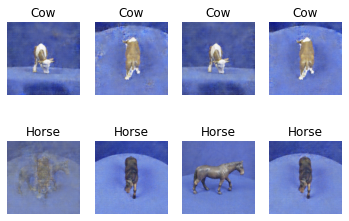

21201 [D loss: 0.057436, acc.: 98.44%] [G loss: 4.892823]
21202 [D loss: 0.160053, acc.: 96.88%] [G loss: 3.888593]
21203 [D loss: 0.074150, acc.: 98.44%] [G loss: 3.805604]
21204 [D loss: 0.066868, acc.: 98.44%] [G loss: 3.914946]
21205 [D loss: 0.026675, acc.: 100.00%] [G loss: 3.915962]
21206 [D loss: 0.018053, acc.: 100.00%] [G loss: 3.904018]
21207 [D loss: 0.161103, acc.: 95.31%] [G loss: 3.887031]
21208 [D loss: 0.177375, acc.: 95.31%] [G loss: 3.654799]
21209 [D loss: 0.041433, acc.: 98.44%] [G loss: 3.695962]
21210 [D loss: 0.055733, acc.: 96.88%] [G loss: 3.848590]
21211 [D loss: 0.227098, acc.: 95.31%] [G loss: 4.328769]
21212 [D loss: 0.029990, acc.: 100.00%] [G loss: 3.848721]
21213 [D loss: 0.157555, acc.: 96.88%] [G loss: 4.532255]
21214 [D loss: 0.290794, acc.: 90.62%] [G loss: 3.667879]
21215 [D loss: 0.063292, acc.: 98.44%] [G loss: 3.460828]
21216 [D loss: 0.060988, acc.: 98.44%] [G loss: 3.242263]
21217 [D loss: 0.055228, acc.: 98.44%] [G loss: 4.217928]
21218 [D lo

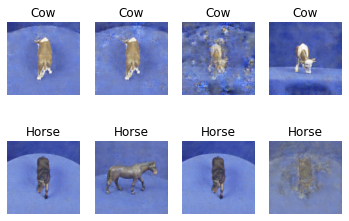

21301 [D loss: 0.027987, acc.: 100.00%] [G loss: 3.312255]
21302 [D loss: 0.066759, acc.: 98.44%] [G loss: 4.210154]
21303 [D loss: 0.165637, acc.: 95.31%] [G loss: 3.871936]
21304 [D loss: 0.060944, acc.: 98.44%] [G loss: 3.776332]
21305 [D loss: 0.064219, acc.: 98.44%] [G loss: 3.460896]
21306 [D loss: 0.023647, acc.: 100.00%] [G loss: 4.053698]
21307 [D loss: 0.119799, acc.: 96.88%] [G loss: 3.965705]
21308 [D loss: 0.062579, acc.: 98.44%] [G loss: 3.858788]
21309 [D loss: 0.138296, acc.: 95.31%] [G loss: 4.421327]
21310 [D loss: 0.014215, acc.: 100.00%] [G loss: 4.954278]
21311 [D loss: 0.111188, acc.: 96.88%] [G loss: 3.561659]
21312 [D loss: 0.016767, acc.: 100.00%] [G loss: 4.031406]
21313 [D loss: 0.170884, acc.: 93.75%] [G loss: 4.008400]
21314 [D loss: 0.080684, acc.: 98.44%] [G loss: 3.724087]
21315 [D loss: 0.022950, acc.: 100.00%] [G loss: 4.389074]
21316 [D loss: 0.018484, acc.: 100.00%] [G loss: 4.205327]
21317 [D loss: 0.201342, acc.: 93.75%] [G loss: 3.944947]
21318 [D

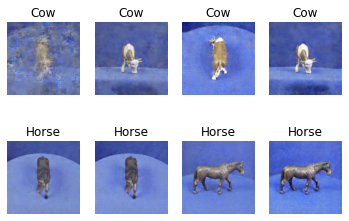

21401 [D loss: 0.213454, acc.: 95.31%] [G loss: 3.626892]
21402 [D loss: 0.072992, acc.: 98.44%] [G loss: 3.738240]
21403 [D loss: 0.025611, acc.: 100.00%] [G loss: 3.593009]
21404 [D loss: 0.125330, acc.: 95.31%] [G loss: 4.052665]
21405 [D loss: 0.129206, acc.: 95.31%] [G loss: 4.786677]
21406 [D loss: 0.090561, acc.: 98.44%] [G loss: 3.625451]
21407 [D loss: 0.125664, acc.: 96.88%] [G loss: 3.462475]
21408 [D loss: 0.055076, acc.: 98.44%] [G loss: 4.028123]
21409 [D loss: 0.059866, acc.: 98.44%] [G loss: 4.423574]
21410 [D loss: 0.020273, acc.: 100.00%] [G loss: 4.050309]
21411 [D loss: 0.191621, acc.: 93.75%] [G loss: 3.875257]
21412 [D loss: 0.046041, acc.: 98.44%] [G loss: 4.113972]
21413 [D loss: 0.164531, acc.: 95.31%] [G loss: 4.195968]
21414 [D loss: 0.028397, acc.: 100.00%] [G loss: 3.884461]
21415 [D loss: 0.012092, acc.: 100.00%] [G loss: 4.766598]
21416 [D loss: 0.058075, acc.: 98.44%] [G loss: 4.974015]
21417 [D loss: 0.030674, acc.: 98.44%] [G loss: 4.790129]
21418 [D l

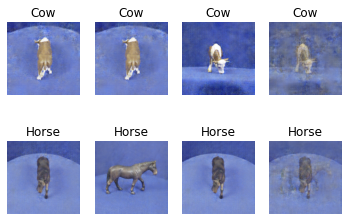

21501 [D loss: 0.073224, acc.: 98.44%] [G loss: 4.041802]
21502 [D loss: 0.011784, acc.: 100.00%] [G loss: 4.594315]
21503 [D loss: 0.068641, acc.: 98.44%] [G loss: 4.458009]
21504 [D loss: 0.079163, acc.: 98.44%] [G loss: 4.594709]
21505 [D loss: 0.199865, acc.: 95.31%] [G loss: 3.925423]
21506 [D loss: 0.122058, acc.: 96.88%] [G loss: 3.986741]
21507 [D loss: 0.156864, acc.: 95.31%] [G loss: 3.444264]
21508 [D loss: 0.140458, acc.: 95.31%] [G loss: 4.833164]
21509 [D loss: 0.073178, acc.: 98.44%] [G loss: 3.632188]
21510 [D loss: 0.201272, acc.: 92.19%] [G loss: 4.084556]
21511 [D loss: 0.088598, acc.: 96.88%] [G loss: 3.978135]
21512 [D loss: 0.144916, acc.: 95.31%] [G loss: 3.016201]
21513 [D loss: 0.094195, acc.: 96.88%] [G loss: 4.118516]
21514 [D loss: 0.156260, acc.: 95.31%] [G loss: 4.177211]
21515 [D loss: 0.153335, acc.: 95.31%] [G loss: 3.041884]
21516 [D loss: 0.070007, acc.: 98.44%] [G loss: 4.240965]
21517 [D loss: 0.092139, acc.: 98.44%] [G loss: 3.838186]
21518 [D loss

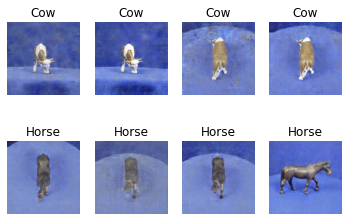

21601 [D loss: 0.120265, acc.: 96.88%] [G loss: 4.556845]
21602 [D loss: 0.046796, acc.: 98.44%] [G loss: 5.270317]
21603 [D loss: 0.119421, acc.: 96.88%] [G loss: 4.237988]
21604 [D loss: 0.064755, acc.: 98.44%] [G loss: 4.157724]
21605 [D loss: 0.024746, acc.: 98.44%] [G loss: 4.715497]
21606 [D loss: 0.021478, acc.: 100.00%] [G loss: 5.460836]
21607 [D loss: 0.154825, acc.: 96.88%] [G loss: 5.695367]
21608 [D loss: 0.023154, acc.: 100.00%] [G loss: 4.617939]
21609 [D loss: 0.015370, acc.: 100.00%] [G loss: 5.098360]
21610 [D loss: 0.076813, acc.: 96.88%] [G loss: 5.484242]
21611 [D loss: 0.168131, acc.: 95.31%] [G loss: 4.286717]
21612 [D loss: 0.091562, acc.: 98.44%] [G loss: 4.586885]
21613 [D loss: 0.076299, acc.: 96.88%] [G loss: 5.759691]
21614 [D loss: 0.206540, acc.: 93.75%] [G loss: 4.158965]
21615 [D loss: 0.027247, acc.: 100.00%] [G loss: 3.685945]
21616 [D loss: 0.126041, acc.: 96.88%] [G loss: 3.758527]
21617 [D loss: 0.101514, acc.: 96.88%] [G loss: 3.905579]
21618 [D l

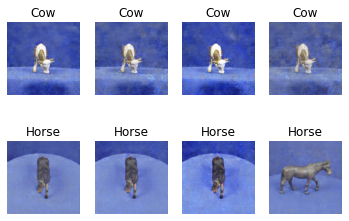

21701 [D loss: 0.014150, acc.: 100.00%] [G loss: 4.700038]
21702 [D loss: 0.120587, acc.: 96.88%] [G loss: 3.461544]
21703 [D loss: 0.121242, acc.: 96.88%] [G loss: 4.151970]
21704 [D loss: 0.068517, acc.: 98.44%] [G loss: 4.423249]
21705 [D loss: 0.111914, acc.: 96.88%] [G loss: 7.546405]
21706 [D loss: 0.200880, acc.: 93.75%] [G loss: 4.103280]
21707 [D loss: 0.176614, acc.: 95.31%] [G loss: 3.302611]
21708 [D loss: 0.117299, acc.: 96.88%] [G loss: 3.448490]
21709 [D loss: 0.063018, acc.: 98.44%] [G loss: 3.243436]
21710 [D loss: 0.255239, acc.: 92.19%] [G loss: 3.283092]
21711 [D loss: 0.074930, acc.: 98.44%] [G loss: 2.923407]
21712 [D loss: 0.043490, acc.: 100.00%] [G loss: 3.321790]
21713 [D loss: 0.132641, acc.: 95.31%] [G loss: 3.707009]
21714 [D loss: 0.023365, acc.: 100.00%] [G loss: 3.684129]
21715 [D loss: 0.071431, acc.: 98.44%] [G loss: 4.217922]
21716 [D loss: 0.075751, acc.: 96.88%] [G loss: 4.429075]
21717 [D loss: 0.164065, acc.: 93.75%] [G loss: 3.522017]
21718 [D lo

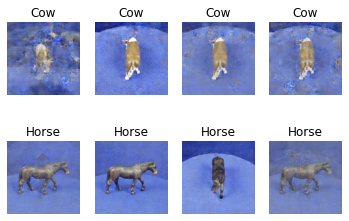

21801 [D loss: 0.145903, acc.: 95.31%] [G loss: 3.394959]
21802 [D loss: 0.163911, acc.: 95.31%] [G loss: 4.516844]
21803 [D loss: 0.095428, acc.: 96.88%] [G loss: 3.375951]
21804 [D loss: 0.123548, acc.: 95.31%] [G loss: 4.485118]
21805 [D loss: 0.069028, acc.: 98.44%] [G loss: 3.837725]
21806 [D loss: 0.033040, acc.: 100.00%] [G loss: 3.886534]
21807 [D loss: 0.186442, acc.: 95.31%] [G loss: 4.077677]
21808 [D loss: 0.056209, acc.: 98.44%] [G loss: 4.008092]
21809 [D loss: 0.047824, acc.: 100.00%] [G loss: 4.243433]
21810 [D loss: 0.056929, acc.: 98.44%] [G loss: 5.439363]
21811 [D loss: 0.067001, acc.: 98.44%] [G loss: 4.982270]
21812 [D loss: 0.186659, acc.: 93.75%] [G loss: 5.190201]
21813 [D loss: 0.027190, acc.: 100.00%] [G loss: 3.964114]
21814 [D loss: 0.096736, acc.: 98.44%] [G loss: 3.561114]
21815 [D loss: 0.186665, acc.: 95.31%] [G loss: 5.150743]
21816 [D loss: 0.136494, acc.: 95.31%] [G loss: 3.469896]
21817 [D loss: 0.060957, acc.: 98.44%] [G loss: 4.172823]
21818 [D lo

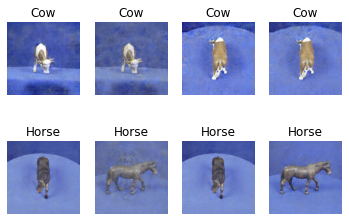

21901 [D loss: 0.019638, acc.: 100.00%] [G loss: 3.875846]
21902 [D loss: 0.155090, acc.: 95.31%] [G loss: 4.055752]
21903 [D loss: 0.033793, acc.: 100.00%] [G loss: 3.692577]
21904 [D loss: 0.155036, acc.: 95.31%] [G loss: 4.284876]
21905 [D loss: 0.112833, acc.: 96.88%] [G loss: 3.418315]
21906 [D loss: 0.096393, acc.: 96.88%] [G loss: 4.294217]
21907 [D loss: 0.041640, acc.: 98.44%] [G loss: 4.671133]
21908 [D loss: 0.043995, acc.: 98.44%] [G loss: 3.911414]
21909 [D loss: 0.033685, acc.: 100.00%] [G loss: 3.650018]
21910 [D loss: 0.063056, acc.: 98.44%] [G loss: 4.230114]
21911 [D loss: 0.143442, acc.: 96.88%] [G loss: 4.791046]
21912 [D loss: 0.072159, acc.: 98.44%] [G loss: 4.799700]
21913 [D loss: 0.063736, acc.: 98.44%] [G loss: 3.642033]
21914 [D loss: 0.175546, acc.: 96.88%] [G loss: 3.975213]
21915 [D loss: 0.074260, acc.: 98.44%] [G loss: 4.318133]
21916 [D loss: 0.088684, acc.: 96.88%] [G loss: 4.866045]
21917 [D loss: 0.045010, acc.: 98.44%] [G loss: 4.448264]
21918 [D lo

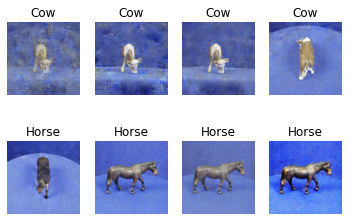

22001 [D loss: 0.092852, acc.: 96.88%] [G loss: 4.151175]
22002 [D loss: 0.013655, acc.: 100.00%] [G loss: 4.881797]
22003 [D loss: 0.077380, acc.: 98.44%] [G loss: 3.723059]
22004 [D loss: 0.019781, acc.: 100.00%] [G loss: 5.424047]
22005 [D loss: 0.051807, acc.: 98.44%] [G loss: 4.011077]
22006 [D loss: 0.013453, acc.: 100.00%] [G loss: 4.832844]
22007 [D loss: 0.031147, acc.: 98.44%] [G loss: 4.645719]
22008 [D loss: 0.040962, acc.: 98.44%] [G loss: 5.702422]
22009 [D loss: 0.098820, acc.: 96.88%] [G loss: 5.873837]
22010 [D loss: 0.044387, acc.: 98.44%] [G loss: 4.709531]
22011 [D loss: 0.097434, acc.: 96.88%] [G loss: 4.064787]
22012 [D loss: 0.017671, acc.: 100.00%] [G loss: 4.810128]
22013 [D loss: 0.061156, acc.: 98.44%] [G loss: 4.583970]
22014 [D loss: 0.084962, acc.: 96.88%] [G loss: 4.775103]
22015 [D loss: 0.186406, acc.: 95.31%] [G loss: 4.571217]
22016 [D loss: 0.097816, acc.: 98.44%] [G loss: 4.407149]
22017 [D loss: 0.261559, acc.: 92.19%] [G loss: 3.808118]
22018 [D l

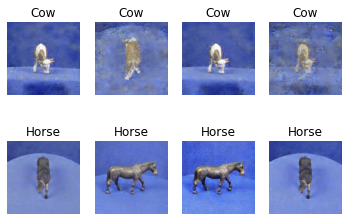

22101 [D loss: 0.079566, acc.: 98.44%] [G loss: 4.184180]
22102 [D loss: 0.067990, acc.: 98.44%] [G loss: 4.193204]
22103 [D loss: 0.060594, acc.: 98.44%] [G loss: 4.299098]
22104 [D loss: 0.165489, acc.: 93.75%] [G loss: 4.383932]
22105 [D loss: 0.128055, acc.: 95.31%] [G loss: 5.304891]
22106 [D loss: 0.207981, acc.: 95.31%] [G loss: 3.710367]
22107 [D loss: 0.197508, acc.: 93.75%] [G loss: 3.286040]
22108 [D loss: 0.080808, acc.: 98.44%] [G loss: 3.304046]
22109 [D loss: 0.115090, acc.: 96.88%] [G loss: 3.354999]
22110 [D loss: 0.158561, acc.: 95.31%] [G loss: 4.048599]
22111 [D loss: 0.100650, acc.: 96.88%] [G loss: 3.485259]
22112 [D loss: 0.059018, acc.: 98.44%] [G loss: 3.733755]
22113 [D loss: 0.092626, acc.: 95.31%] [G loss: 4.134961]
22114 [D loss: 0.178772, acc.: 95.31%] [G loss: 3.806591]
22115 [D loss: 0.168273, acc.: 95.31%] [G loss: 3.565312]
22116 [D loss: 0.100827, acc.: 96.88%] [G loss: 3.506339]
22117 [D loss: 0.175363, acc.: 95.31%] [G loss: 3.623710]
22118 [D loss:

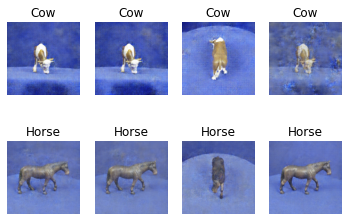

22201 [D loss: 0.081670, acc.: 96.88%] [G loss: 4.412919]
22202 [D loss: 0.098915, acc.: 96.88%] [G loss: 3.425098]
22203 [D loss: 0.097039, acc.: 96.88%] [G loss: 3.476907]
22204 [D loss: 0.075266, acc.: 98.44%] [G loss: 3.610959]
22205 [D loss: 0.044742, acc.: 98.44%] [G loss: 3.752609]
22206 [D loss: 0.130961, acc.: 96.88%] [G loss: 3.752037]
22207 [D loss: 0.100095, acc.: 96.88%] [G loss: 3.845536]
22208 [D loss: 0.158923, acc.: 93.75%] [G loss: 4.298643]
22209 [D loss: 0.190714, acc.: 93.75%] [G loss: 4.477687]
22210 [D loss: 0.126477, acc.: 95.31%] [G loss: 3.944698]
22211 [D loss: 0.181650, acc.: 92.19%] [G loss: 3.894869]
22212 [D loss: 0.136080, acc.: 96.88%] [G loss: 4.329717]
22213 [D loss: 0.222483, acc.: 92.19%] [G loss: 2.847925]
22214 [D loss: 0.094902, acc.: 96.88%] [G loss: 3.346528]
22215 [D loss: 0.051051, acc.: 98.44%] [G loss: 4.095364]
22216 [D loss: 0.073610, acc.: 98.44%] [G loss: 4.033143]
22217 [D loss: 0.070189, acc.: 98.44%] [G loss: 3.687071]
22218 [D loss:

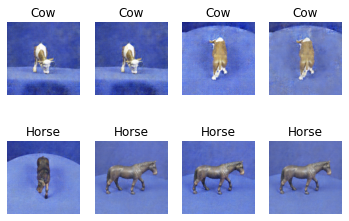

22301 [D loss: 0.058762, acc.: 98.44%] [G loss: 4.837051]
22302 [D loss: 0.025690, acc.: 100.00%] [G loss: 6.151411]
22303 [D loss: 0.012656, acc.: 100.00%] [G loss: 5.586996]
22304 [D loss: 0.189475, acc.: 96.88%] [G loss: 5.103259]
22305 [D loss: 0.302797, acc.: 93.75%] [G loss: 4.331991]
22306 [D loss: 0.201029, acc.: 93.75%] [G loss: 4.742946]
22307 [D loss: 0.103505, acc.: 96.88%] [G loss: 3.526407]
22308 [D loss: 0.100426, acc.: 96.88%] [G loss: 3.566031]
22309 [D loss: 0.080106, acc.: 98.44%] [G loss: 3.631841]
22310 [D loss: 0.071045, acc.: 98.44%] [G loss: 3.464912]
22311 [D loss: 0.021760, acc.: 100.00%] [G loss: 3.679204]
22312 [D loss: 0.020853, acc.: 100.00%] [G loss: 3.684431]
22313 [D loss: 0.078922, acc.: 98.44%] [G loss: 3.543436]
22314 [D loss: 0.103152, acc.: 96.88%] [G loss: 3.930482]
22315 [D loss: 0.069057, acc.: 98.44%] [G loss: 3.609590]
22316 [D loss: 0.149640, acc.: 93.75%] [G loss: 3.872311]
22317 [D loss: 0.126510, acc.: 95.31%] [G loss: 3.798194]
22318 [D l

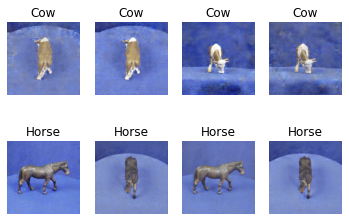

22401 [D loss: 0.226838, acc.: 92.19%] [G loss: 3.376800]
22402 [D loss: 0.025144, acc.: 100.00%] [G loss: 3.822243]
22403 [D loss: 0.202329, acc.: 93.75%] [G loss: 3.984691]
22404 [D loss: 0.039048, acc.: 98.44%] [G loss: 4.161493]
22405 [D loss: 0.120214, acc.: 96.88%] [G loss: 3.240470]
22406 [D loss: 0.107512, acc.: 96.88%] [G loss: 4.145586]
22407 [D loss: 0.042715, acc.: 100.00%] [G loss: 3.452387]
22408 [D loss: 0.107009, acc.: 96.88%] [G loss: 4.336634]
22409 [D loss: 0.186336, acc.: 93.75%] [G loss: 3.328638]
22410 [D loss: 0.113871, acc.: 96.88%] [G loss: 3.340047]
22411 [D loss: 0.086617, acc.: 98.44%] [G loss: 3.769192]
22412 [D loss: 0.082370, acc.: 98.44%] [G loss: 3.769055]
22413 [D loss: 0.075841, acc.: 98.44%] [G loss: 3.827975]
22414 [D loss: 0.019330, acc.: 100.00%] [G loss: 4.144825]
22415 [D loss: 0.129955, acc.: 96.88%] [G loss: 3.783773]
22416 [D loss: 0.066752, acc.: 98.44%] [G loss: 4.262698]
22417 [D loss: 0.142897, acc.: 95.31%] [G loss: 3.889981]
22418 [D lo

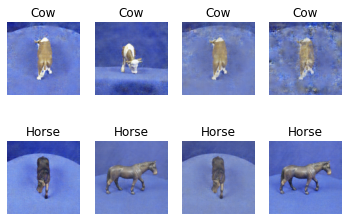

22501 [D loss: 0.155131, acc.: 95.31%] [G loss: 3.924826]
22502 [D loss: 0.060713, acc.: 98.44%] [G loss: 3.657785]
22503 [D loss: 0.024437, acc.: 100.00%] [G loss: 4.171331]
22504 [D loss: 0.156480, acc.: 95.31%] [G loss: 4.043764]
22505 [D loss: 0.067709, acc.: 98.44%] [G loss: 5.648291]
22506 [D loss: 0.140278, acc.: 95.31%] [G loss: 4.478414]
22507 [D loss: 0.108204, acc.: 96.88%] [G loss: 4.778207]
22508 [D loss: 0.019868, acc.: 100.00%] [G loss: 4.191531]
22509 [D loss: 0.095495, acc.: 96.88%] [G loss: 5.595097]
22510 [D loss: 0.107143, acc.: 96.88%] [G loss: 3.873200]
22511 [D loss: 0.112030, acc.: 95.31%] [G loss: 3.294476]
22512 [D loss: 0.051073, acc.: 98.44%] [G loss: 4.603458]
22513 [D loss: 0.193690, acc.: 95.31%] [G loss: 3.491493]
22514 [D loss: 0.119577, acc.: 96.88%] [G loss: 3.818636]
22515 [D loss: 0.102919, acc.: 96.88%] [G loss: 2.986254]
22516 [D loss: 0.051314, acc.: 100.00%] [G loss: 3.126982]
22517 [D loss: 0.029443, acc.: 100.00%] [G loss: 3.470682]
22518 [D l

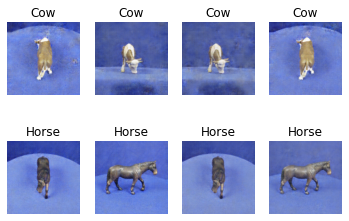

22601 [D loss: 0.118791, acc.: 96.88%] [G loss: 4.501812]
22602 [D loss: 0.080325, acc.: 98.44%] [G loss: 4.400589]
22603 [D loss: 0.040947, acc.: 100.00%] [G loss: 3.446148]
22604 [D loss: 0.119390, acc.: 95.31%] [G loss: 5.085472]
22605 [D loss: 0.094873, acc.: 96.88%] [G loss: 3.942189]
22606 [D loss: 0.130955, acc.: 96.88%] [G loss: 3.727972]
22607 [D loss: 0.129856, acc.: 98.44%] [G loss: 3.154882]
22608 [D loss: 0.078058, acc.: 98.44%] [G loss: 3.798836]
22609 [D loss: 0.084301, acc.: 98.44%] [G loss: 3.902463]
22610 [D loss: 0.019995, acc.: 100.00%] [G loss: 3.983593]
22611 [D loss: 0.175808, acc.: 95.31%] [G loss: 4.893811]
22612 [D loss: 0.068832, acc.: 98.44%] [G loss: 4.314291]
22613 [D loss: 0.054072, acc.: 98.44%] [G loss: 4.527772]
22614 [D loss: 0.264833, acc.: 92.19%] [G loss: 4.271670]
22615 [D loss: 0.074517, acc.: 98.44%] [G loss: 3.865625]
22616 [D loss: 0.012526, acc.: 100.00%] [G loss: 4.934450]
22617 [D loss: 0.199918, acc.: 93.75%] [G loss: 3.056419]
22618 [D lo

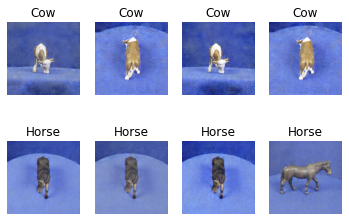

22701 [D loss: 0.116558, acc.: 96.88%] [G loss: 3.571628]
22702 [D loss: 0.088309, acc.: 98.44%] [G loss: 3.190981]
22703 [D loss: 0.050578, acc.: 98.44%] [G loss: 3.704852]
22704 [D loss: 0.126395, acc.: 95.31%] [G loss: 3.915052]
22705 [D loss: 0.119284, acc.: 95.31%] [G loss: 4.463761]
22706 [D loss: 0.135484, acc.: 96.88%] [G loss: 3.756727]
22707 [D loss: 0.088693, acc.: 98.44%] [G loss: 3.714000]
22708 [D loss: 0.091201, acc.: 98.44%] [G loss: 4.011480]
22709 [D loss: 0.043539, acc.: 100.00%] [G loss: 4.196319]
22710 [D loss: 0.235300, acc.: 93.75%] [G loss: 4.141834]
22711 [D loss: 0.024014, acc.: 100.00%] [G loss: 3.863402]
22712 [D loss: 0.086285, acc.: 96.88%] [G loss: 4.455299]
22713 [D loss: 0.093451, acc.: 98.44%] [G loss: 4.270180]
22714 [D loss: 0.025914, acc.: 100.00%] [G loss: 4.343976]
22715 [D loss: 0.011996, acc.: 100.00%] [G loss: 4.841064]
22716 [D loss: 0.138395, acc.: 96.88%] [G loss: 4.718575]
22717 [D loss: 0.094470, acc.: 98.44%] [G loss: 3.664004]
22718 [D l

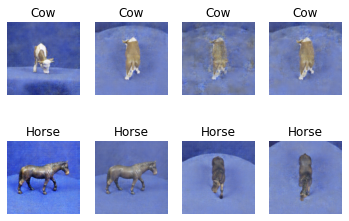

22801 [D loss: 0.057360, acc.: 98.44%] [G loss: 4.199217]
22802 [D loss: 0.100904, acc.: 96.88%] [G loss: 4.175178]
22803 [D loss: 0.124575, acc.: 96.88%] [G loss: 4.643206]
22804 [D loss: 0.169261, acc.: 95.31%] [G loss: 3.764273]
22805 [D loss: 0.149475, acc.: 95.31%] [G loss: 3.190022]
22806 [D loss: 0.091493, acc.: 96.88%] [G loss: 3.744749]
22807 [D loss: 0.219746, acc.: 93.75%] [G loss: 3.341293]
22808 [D loss: 0.109918, acc.: 96.88%] [G loss: 3.848561]
22809 [D loss: 0.212985, acc.: 93.75%] [G loss: 2.694006]
22810 [D loss: 0.065153, acc.: 98.44%] [G loss: 3.370340]
22811 [D loss: 0.065415, acc.: 98.44%] [G loss: 3.954054]
22812 [D loss: 0.130658, acc.: 96.88%] [G loss: 5.322924]
22813 [D loss: 0.088677, acc.: 96.88%] [G loss: 3.470063]
22814 [D loss: 0.185982, acc.: 93.75%] [G loss: 3.166302]
22815 [D loss: 0.020123, acc.: 100.00%] [G loss: 4.108553]
22816 [D loss: 0.169532, acc.: 93.75%] [G loss: 3.125605]
22817 [D loss: 0.085176, acc.: 98.44%] [G loss: 4.301735]
22818 [D loss

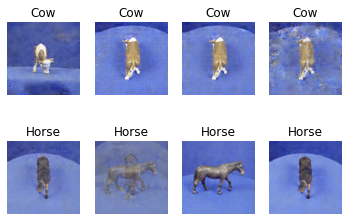

22901 [D loss: 0.052108, acc.: 100.00%] [G loss: 4.006566]
22902 [D loss: 0.197480, acc.: 93.75%] [G loss: 3.362300]
22903 [D loss: 0.093597, acc.: 98.44%] [G loss: 4.349915]
22904 [D loss: 0.072602, acc.: 98.44%] [G loss: 3.630750]
22905 [D loss: 0.097318, acc.: 98.44%] [G loss: 4.464576]
22906 [D loss: 0.109348, acc.: 96.88%] [G loss: 3.881448]
22907 [D loss: 0.127551, acc.: 95.31%] [G loss: 3.529889]
22908 [D loss: 0.138998, acc.: 95.31%] [G loss: 3.497246]
22909 [D loss: 0.037214, acc.: 100.00%] [G loss: 4.385511]
22910 [D loss: 0.021298, acc.: 100.00%] [G loss: 4.430202]
22911 [D loss: 0.282877, acc.: 95.31%] [G loss: 3.810600]
22912 [D loss: 0.027997, acc.: 100.00%] [G loss: 3.432716]
22913 [D loss: 0.150940, acc.: 95.31%] [G loss: 3.098838]
22914 [D loss: 0.160093, acc.: 95.31%] [G loss: 3.200877]
22915 [D loss: 0.086685, acc.: 98.44%] [G loss: 3.289333]
22916 [D loss: 0.033227, acc.: 100.00%] [G loss: 3.735592]
22917 [D loss: 0.154598, acc.: 95.31%] [G loss: 3.277826]
22918 [D 

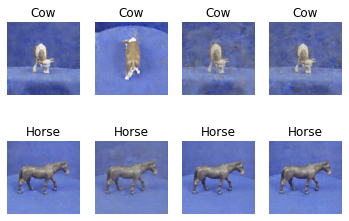

23001 [D loss: 0.182365, acc.: 95.31%] [G loss: 3.623664]
23002 [D loss: 0.166792, acc.: 95.31%] [G loss: 3.770108]
23003 [D loss: 0.184346, acc.: 96.88%] [G loss: 3.787967]
23004 [D loss: 0.042181, acc.: 98.44%] [G loss: 4.650235]
23005 [D loss: 0.089454, acc.: 98.44%] [G loss: 3.805343]
23006 [D loss: 0.062936, acc.: 98.44%] [G loss: 3.185751]
23007 [D loss: 0.029627, acc.: 100.00%] [G loss: 3.588524]
23008 [D loss: 0.251026, acc.: 93.75%] [G loss: 3.495211]
23009 [D loss: 0.085431, acc.: 98.44%] [G loss: 3.223700]
23010 [D loss: 0.069715, acc.: 98.44%] [G loss: 3.580327]
23011 [D loss: 0.146019, acc.: 95.31%] [G loss: 3.391664]
23012 [D loss: 0.046838, acc.: 98.44%] [G loss: 3.848019]
23013 [D loss: 0.027783, acc.: 100.00%] [G loss: 3.444948]
23014 [D loss: 0.090267, acc.: 96.88%] [G loss: 3.762350]
23015 [D loss: 0.020334, acc.: 100.00%] [G loss: 3.596389]
23016 [D loss: 0.014366, acc.: 100.00%] [G loss: 4.239658]
23017 [D loss: 0.148255, acc.: 95.31%] [G loss: 3.739564]
23018 [D l

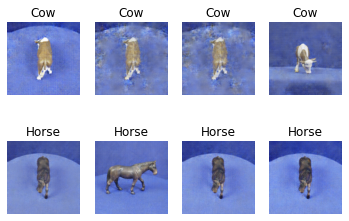

23101 [D loss: 0.024147, acc.: 100.00%] [G loss: 3.729484]
23102 [D loss: 0.122056, acc.: 98.44%] [G loss: 3.892709]
23103 [D loss: 0.071933, acc.: 98.44%] [G loss: 4.353905]
23104 [D loss: 0.151458, acc.: 96.88%] [G loss: 3.897935]
23105 [D loss: 0.059084, acc.: 98.44%] [G loss: 3.963492]
23106 [D loss: 0.209441, acc.: 93.75%] [G loss: 3.538076]
23107 [D loss: 0.079748, acc.: 98.44%] [G loss: 3.833398]
23108 [D loss: 0.076979, acc.: 98.44%] [G loss: 3.187167]
23109 [D loss: 0.026431, acc.: 100.00%] [G loss: 3.974863]
23110 [D loss: 0.098359, acc.: 96.88%] [G loss: 3.378421]
23111 [D loss: 0.057697, acc.: 98.44%] [G loss: 3.812689]
23112 [D loss: 0.024446, acc.: 100.00%] [G loss: 3.814469]
23113 [D loss: 0.111481, acc.: 96.88%] [G loss: 3.940565]
23114 [D loss: 0.048930, acc.: 98.44%] [G loss: 4.067353]
23115 [D loss: 0.062013, acc.: 98.44%] [G loss: 4.213787]
23116 [D loss: 0.191026, acc.: 93.75%] [G loss: 4.181926]
23117 [D loss: 0.112399, acc.: 96.88%] [G loss: 3.811310]
23118 [D lo

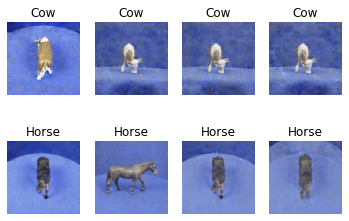

23201 [D loss: 0.113855, acc.: 96.88%] [G loss: 3.693536]
23202 [D loss: 0.197206, acc.: 93.75%] [G loss: 3.372885]
23203 [D loss: 0.119688, acc.: 98.44%] [G loss: 3.319575]
23204 [D loss: 0.075149, acc.: 98.44%] [G loss: 3.077596]
23205 [D loss: 0.083813, acc.: 98.44%] [G loss: 3.277135]
23206 [D loss: 0.110742, acc.: 96.88%] [G loss: 3.660782]
23207 [D loss: 0.105527, acc.: 96.88%] [G loss: 4.567775]
23208 [D loss: 0.059773, acc.: 98.44%] [G loss: 4.867224]
23209 [D loss: 0.130327, acc.: 95.31%] [G loss: 3.953939]
23210 [D loss: 0.131610, acc.: 96.88%] [G loss: 3.981257]
23211 [D loss: 0.109751, acc.: 96.88%] [G loss: 4.253803]
23212 [D loss: 0.092917, acc.: 98.44%] [G loss: 3.311414]
23213 [D loss: 0.103698, acc.: 96.88%] [G loss: 3.559455]
23214 [D loss: 0.152047, acc.: 95.31%] [G loss: 3.459813]
23215 [D loss: 0.153181, acc.: 96.88%] [G loss: 3.609172]
23216 [D loss: 0.091146, acc.: 96.88%] [G loss: 3.663519]
23217 [D loss: 0.030120, acc.: 98.44%] [G loss: 4.495026]
23218 [D loss:

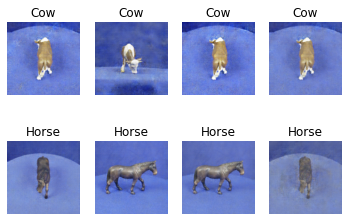

23301 [D loss: 0.026302, acc.: 100.00%] [G loss: 3.488431]
23302 [D loss: 0.067799, acc.: 98.44%] [G loss: 4.409030]
23303 [D loss: 0.027933, acc.: 100.00%] [G loss: 3.756944]
23304 [D loss: 0.051263, acc.: 98.44%] [G loss: 4.242131]
23305 [D loss: 0.289552, acc.: 93.75%] [G loss: 5.303050]
23306 [D loss: 0.028899, acc.: 100.00%] [G loss: 3.567707]
23307 [D loss: 0.079938, acc.: 98.44%] [G loss: 3.895634]
23308 [D loss: 0.115112, acc.: 96.88%] [G loss: 3.407089]
23309 [D loss: 0.143380, acc.: 95.31%] [G loss: 3.145023]
23310 [D loss: 0.035534, acc.: 100.00%] [G loss: 3.821675]
23311 [D loss: 0.025687, acc.: 100.00%] [G loss: 4.029456]
23312 [D loss: 0.169803, acc.: 95.31%] [G loss: 4.189269]
23313 [D loss: 0.070949, acc.: 98.44%] [G loss: 3.752499]
23314 [D loss: 0.219262, acc.: 93.75%] [G loss: 5.082622]
23315 [D loss: 0.056988, acc.: 98.44%] [G loss: 4.713716]
23316 [D loss: 0.094304, acc.: 98.44%] [G loss: 5.041544]
23317 [D loss: 0.229557, acc.: 92.19%] [G loss: 3.777971]
23318 [D 

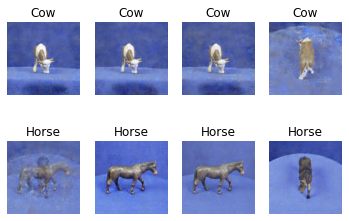

23401 [D loss: 0.032960, acc.: 100.00%] [G loss: 3.469753]
23402 [D loss: 0.022453, acc.: 100.00%] [G loss: 3.827481]
23403 [D loss: 0.066232, acc.: 98.44%] [G loss: 3.927992]
23404 [D loss: 0.015528, acc.: 100.00%] [G loss: 3.960617]
23405 [D loss: 0.063178, acc.: 98.44%] [G loss: 4.956890]
23406 [D loss: 0.220060, acc.: 93.75%] [G loss: 4.226763]
23407 [D loss: 0.060617, acc.: 98.44%] [G loss: 3.609126]
23408 [D loss: 0.137636, acc.: 96.88%] [G loss: 3.229715]
23409 [D loss: 0.074452, acc.: 98.44%] [G loss: 3.233139]
23410 [D loss: 0.059613, acc.: 98.44%] [G loss: 3.636645]
23411 [D loss: 0.154430, acc.: 95.31%] [G loss: 3.889205]
23412 [D loss: 0.125491, acc.: 96.88%] [G loss: 3.953214]
23413 [D loss: 0.032271, acc.: 100.00%] [G loss: 4.337109]
23414 [D loss: 0.111798, acc.: 96.88%] [G loss: 3.770338]
23415 [D loss: 0.023741, acc.: 100.00%] [G loss: 3.753105]
23416 [D loss: 0.065104, acc.: 98.44%] [G loss: 4.161040]
23417 [D loss: 0.181287, acc.: 95.31%] [G loss: 4.214522]
23418 [D 

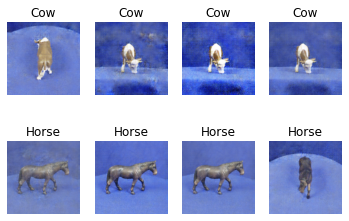

23501 [D loss: 0.075823, acc.: 98.44%] [G loss: 3.871633]
23502 [D loss: 0.044104, acc.: 98.44%] [G loss: 4.458702]
23503 [D loss: 0.033084, acc.: 98.44%] [G loss: 5.619585]
23504 [D loss: 0.027001, acc.: 100.00%] [G loss: 4.147089]
23505 [D loss: 0.140160, acc.: 95.31%] [G loss: 3.915601]
23506 [D loss: 0.093866, acc.: 96.88%] [G loss: 4.068231]
23507 [D loss: 0.083122, acc.: 96.88%] [G loss: 3.876525]
23508 [D loss: 0.176755, acc.: 93.75%] [G loss: 3.594238]
23509 [D loss: 0.134296, acc.: 96.88%] [G loss: 3.330741]
23510 [D loss: 0.206475, acc.: 93.75%] [G loss: 3.374643]
23511 [D loss: 0.122344, acc.: 96.88%] [G loss: 3.353487]
23512 [D loss: 0.072808, acc.: 98.44%] [G loss: 3.001986]
23513 [D loss: 0.147826, acc.: 96.88%] [G loss: 3.273329]
23514 [D loss: 0.060285, acc.: 98.44%] [G loss: 3.459733]
23515 [D loss: 0.198954, acc.: 95.31%] [G loss: 3.655607]
23516 [D loss: 0.051200, acc.: 98.44%] [G loss: 4.087304]
23517 [D loss: 0.121263, acc.: 96.88%] [G loss: 4.076856]
23518 [D loss

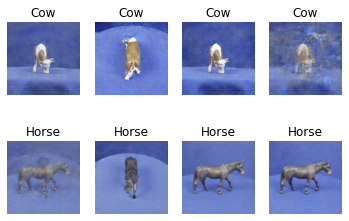

23601 [D loss: 0.032335, acc.: 100.00%] [G loss: 3.995214]
23602 [D loss: 0.078054, acc.: 98.44%] [G loss: 4.364487]
23603 [D loss: 0.077098, acc.: 98.44%] [G loss: 3.608109]
23604 [D loss: 0.152572, acc.: 95.31%] [G loss: 3.544959]
23605 [D loss: 0.221700, acc.: 95.31%] [G loss: 3.710904]
23606 [D loss: 0.054916, acc.: 98.44%] [G loss: 4.352903]
23607 [D loss: 0.058747, acc.: 98.44%] [G loss: 4.871595]
23608 [D loss: 0.107674, acc.: 96.88%] [G loss: 3.889908]
23609 [D loss: 0.032407, acc.: 100.00%] [G loss: 4.604740]
23610 [D loss: 0.054282, acc.: 98.44%] [G loss: 4.659584]
23611 [D loss: 0.098147, acc.: 96.88%] [G loss: 5.255044]
23612 [D loss: 0.175184, acc.: 95.31%] [G loss: 3.817491]
23613 [D loss: 0.021411, acc.: 100.00%] [G loss: 4.679276]
23614 [D loss: 0.123800, acc.: 96.88%] [G loss: 4.159304]
23615 [D loss: 0.053463, acc.: 98.44%] [G loss: 4.461643]
23616 [D loss: 0.097531, acc.: 96.88%] [G loss: 4.014950]
23617 [D loss: 0.225906, acc.: 92.19%] [G loss: 4.217973]
23618 [D lo

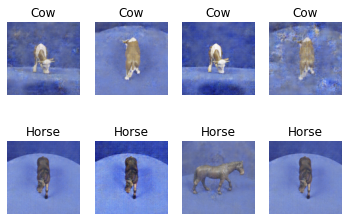

23701 [D loss: 0.015588, acc.: 100.00%] [G loss: 4.623076]
23702 [D loss: 0.078060, acc.: 96.88%] [G loss: 5.791871]
23703 [D loss: 0.051675, acc.: 98.44%] [G loss: 4.322830]
23704 [D loss: 0.043616, acc.: 98.44%] [G loss: 4.772184]
23705 [D loss: 0.096942, acc.: 96.88%] [G loss: 6.289032]
23706 [D loss: 0.214626, acc.: 95.31%] [G loss: 4.538260]
23707 [D loss: 0.233699, acc.: 92.19%] [G loss: 5.740981]
23708 [D loss: 0.048939, acc.: 98.44%] [G loss: 5.522234]
23709 [D loss: 0.223221, acc.: 93.75%] [G loss: 3.869679]
23710 [D loss: 0.108281, acc.: 98.44%] [G loss: 3.079596]
23711 [D loss: 0.114469, acc.: 96.88%] [G loss: 3.631859]
23712 [D loss: 0.023474, acc.: 100.00%] [G loss: 3.930704]
23713 [D loss: 0.150658, acc.: 95.31%] [G loss: 3.594565]
23714 [D loss: 0.027741, acc.: 100.00%] [G loss: 3.467615]
23715 [D loss: 0.113120, acc.: 96.88%] [G loss: 3.755108]
23716 [D loss: 0.077658, acc.: 98.44%] [G loss: 3.580832]
23717 [D loss: 0.091992, acc.: 96.88%] [G loss: 3.892910]
23718 [D lo

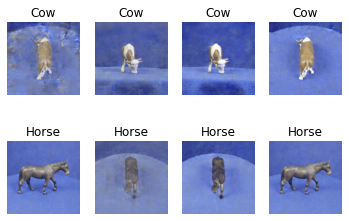

23801 [D loss: 0.050267, acc.: 100.00%] [G loss: 3.665535]
23802 [D loss: 0.078226, acc.: 96.88%] [G loss: 5.251740]
23803 [D loss: 0.043311, acc.: 98.44%] [G loss: 4.012617]
23804 [D loss: 0.085041, acc.: 96.88%] [G loss: 4.610474]
23805 [D loss: 0.087315, acc.: 96.88%] [G loss: 3.576072]
23806 [D loss: 0.118026, acc.: 96.88%] [G loss: 3.725404]
23807 [D loss: 0.216059, acc.: 92.19%] [G loss: 4.104786]
23808 [D loss: 0.153400, acc.: 95.31%] [G loss: 3.299756]
23809 [D loss: 0.299449, acc.: 92.19%] [G loss: 5.917863]
23810 [D loss: 0.081662, acc.: 98.44%] [G loss: 3.372505]
23811 [D loss: 0.197929, acc.: 95.31%] [G loss: 3.638537]
23812 [D loss: 0.048526, acc.: 100.00%] [G loss: 2.941165]
23813 [D loss: 0.119168, acc.: 96.88%] [G loss: 3.531729]
23814 [D loss: 0.062011, acc.: 98.44%] [G loss: 3.293562]
23815 [D loss: 0.139753, acc.: 93.75%] [G loss: 3.313396]
23816 [D loss: 0.128069, acc.: 96.88%] [G loss: 3.353799]
23817 [D loss: 0.097495, acc.: 98.44%] [G loss: 3.192986]
23818 [D los

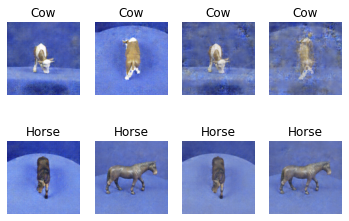

23901 [D loss: 0.110024, acc.: 96.88%] [G loss: 4.224789]
23902 [D loss: 0.027266, acc.: 100.00%] [G loss: 5.775169]
23903 [D loss: 0.013772, acc.: 100.00%] [G loss: 5.454487]
23904 [D loss: 0.117323, acc.: 96.88%] [G loss: 4.873339]
23905 [D loss: 0.100674, acc.: 96.88%] [G loss: 5.162702]
23906 [D loss: 0.116178, acc.: 95.31%] [G loss: 4.797412]
23907 [D loss: 0.017188, acc.: 100.00%] [G loss: 4.266274]
23908 [D loss: 0.101240, acc.: 96.88%] [G loss: 4.289646]
23909 [D loss: 0.028445, acc.: 100.00%] [G loss: 3.075814]
23910 [D loss: 0.088272, acc.: 98.44%] [G loss: 5.665037]
23911 [D loss: 0.044764, acc.: 98.44%] [G loss: 3.729180]
23912 [D loss: 0.068927, acc.: 98.44%] [G loss: 4.256880]
23913 [D loss: 0.024087, acc.: 100.00%] [G loss: 5.313976]
23914 [D loss: 0.112396, acc.: 96.88%] [G loss: 5.846171]
23915 [D loss: 0.122998, acc.: 96.88%] [G loss: 4.704268]
23916 [D loss: 0.122534, acc.: 96.88%] [G loss: 4.078069]
23917 [D loss: 0.071370, acc.: 98.44%] [G loss: 5.132261]
23918 [D 

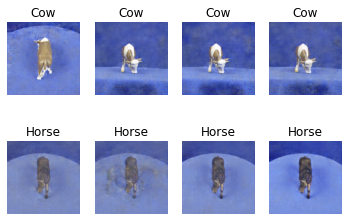

24001 [D loss: 0.081699, acc.: 98.44%] [G loss: 3.467774]
24002 [D loss: 0.091397, acc.: 96.88%] [G loss: 3.500801]
24003 [D loss: 0.125915, acc.: 95.31%] [G loss: 4.472610]
24004 [D loss: 0.059526, acc.: 98.44%] [G loss: 4.329513]
24005 [D loss: 0.236579, acc.: 92.19%] [G loss: 3.406442]
24006 [D loss: 0.035200, acc.: 100.00%] [G loss: 3.365615]
24007 [D loss: 0.034159, acc.: 100.00%] [G loss: 3.313532]
24008 [D loss: 0.023788, acc.: 100.00%] [G loss: 4.100633]
24009 [D loss: 0.105818, acc.: 96.88%] [G loss: 3.938252]
24010 [D loss: 0.025263, acc.: 100.00%] [G loss: 3.874287]
24011 [D loss: 0.061808, acc.: 98.44%] [G loss: 4.131344]
24012 [D loss: 0.007854, acc.: 100.00%] [G loss: 5.539912]
24013 [D loss: 0.017052, acc.: 100.00%] [G loss: 4.532642]
24014 [D loss: 0.281154, acc.: 93.75%] [G loss: 5.172163]
24015 [D loss: 0.112305, acc.: 96.88%] [G loss: 5.222610]
24016 [D loss: 0.098695, acc.: 98.44%] [G loss: 3.696999]
24017 [D loss: 0.077381, acc.: 98.44%] [G loss: 3.527785]
24018 [D

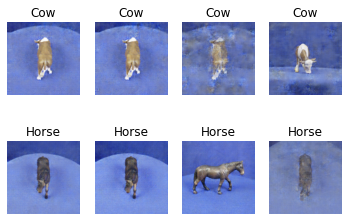

24101 [D loss: 0.039183, acc.: 100.00%] [G loss: 3.823384]
24102 [D loss: 0.179337, acc.: 93.75%] [G loss: 4.695810]
24103 [D loss: 0.170996, acc.: 95.31%] [G loss: 3.718001]
24104 [D loss: 0.102463, acc.: 96.88%] [G loss: 3.988196]
24105 [D loss: 0.112532, acc.: 96.88%] [G loss: 3.792169]
24106 [D loss: 0.075287, acc.: 98.44%] [G loss: 3.625563]
24107 [D loss: 0.112635, acc.: 96.88%] [G loss: 3.229164]
24108 [D loss: 0.028797, acc.: 100.00%] [G loss: 3.753569]
24109 [D loss: 0.128867, acc.: 95.31%] [G loss: 3.445720]
24110 [D loss: 0.173504, acc.: 95.31%] [G loss: 4.089841]
24111 [D loss: 0.138649, acc.: 96.88%] [G loss: 4.296637]
24112 [D loss: 0.061975, acc.: 98.44%] [G loss: 3.853992]
24113 [D loss: 0.129473, acc.: 95.31%] [G loss: 2.976235]
24114 [D loss: 0.102232, acc.: 98.44%] [G loss: 3.393243]
24115 [D loss: 0.111573, acc.: 96.88%] [G loss: 3.293617]
24116 [D loss: 0.071117, acc.: 98.44%] [G loss: 3.071603]
24117 [D loss: 0.113584, acc.: 96.88%] [G loss: 3.326225]
24118 [D los

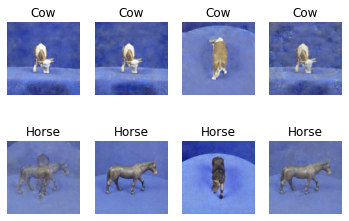

24201 [D loss: 0.139469, acc.: 96.88%] [G loss: 3.645244]
24202 [D loss: 0.156881, acc.: 93.75%] [G loss: 6.276800]
24203 [D loss: 0.046892, acc.: 98.44%] [G loss: 4.937283]
24204 [D loss: 0.140452, acc.: 96.88%] [G loss: 4.656811]
24205 [D loss: 0.135304, acc.: 96.88%] [G loss: 3.582185]
24206 [D loss: 0.071995, acc.: 98.44%] [G loss: 4.205735]
24207 [D loss: 0.066417, acc.: 98.44%] [G loss: 4.084946]
24208 [D loss: 0.111996, acc.: 96.88%] [G loss: 3.710462]
24209 [D loss: 0.040081, acc.: 100.00%] [G loss: 3.894111]
24210 [D loss: 0.064453, acc.: 98.44%] [G loss: 4.145458]
24211 [D loss: 0.121947, acc.: 96.88%] [G loss: 4.573465]
24212 [D loss: 0.015126, acc.: 100.00%] [G loss: 6.102394]
24213 [D loss: 0.233943, acc.: 93.75%] [G loss: 5.835443]
24214 [D loss: 0.184861, acc.: 95.31%] [G loss: 3.799411]
24215 [D loss: 0.166371, acc.: 93.75%] [G loss: 3.882133]
24216 [D loss: 0.194382, acc.: 95.31%] [G loss: 4.773833]
24217 [D loss: 0.081751, acc.: 98.44%] [G loss: 3.029565]
24218 [D los

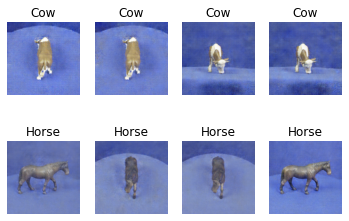

24301 [D loss: 0.089907, acc.: 98.44%] [G loss: 2.741340]
24302 [D loss: 0.080255, acc.: 98.44%] [G loss: 2.850988]
24303 [D loss: 0.030309, acc.: 100.00%] [G loss: 3.201941]
24304 [D loss: 0.195968, acc.: 95.31%] [G loss: 3.239323]
24305 [D loss: 0.054984, acc.: 98.44%] [G loss: 3.305497]
24306 [D loss: 0.163566, acc.: 95.31%] [G loss: 2.938972]
24307 [D loss: 0.240652, acc.: 93.75%] [G loss: 3.133426]
24308 [D loss: 0.109005, acc.: 96.88%] [G loss: 2.776639]
24309 [D loss: 0.189357, acc.: 93.75%] [G loss: 3.139549]
24310 [D loss: 0.122411, acc.: 96.88%] [G loss: 2.947695]
24311 [D loss: 0.107627, acc.: 96.88%] [G loss: 3.083232]
24312 [D loss: 0.087386, acc.: 98.44%] [G loss: 3.365217]
24313 [D loss: 0.022940, acc.: 100.00%] [G loss: 3.264898]
24314 [D loss: 0.193288, acc.: 93.75%] [G loss: 3.704547]
24315 [D loss: 0.156961, acc.: 95.31%] [G loss: 2.941191]
24316 [D loss: 0.078360, acc.: 98.44%] [G loss: 3.097452]
24317 [D loss: 0.141876, acc.: 95.31%] [G loss: 3.648004]
24318 [D los

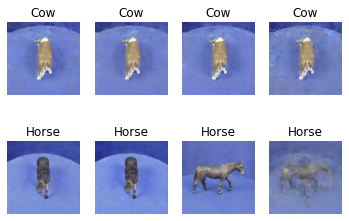

24401 [D loss: 0.161841, acc.: 95.31%] [G loss: 3.047439]
24402 [D loss: 0.073275, acc.: 98.44%] [G loss: 3.019743]
24403 [D loss: 0.118291, acc.: 96.88%] [G loss: 3.066217]
24404 [D loss: 0.111936, acc.: 96.88%] [G loss: 3.384149]
24405 [D loss: 0.066453, acc.: 98.44%] [G loss: 3.294365]
24406 [D loss: 0.157569, acc.: 95.31%] [G loss: 3.384137]
24407 [D loss: 0.104788, acc.: 96.88%] [G loss: 3.347839]
24408 [D loss: 0.123342, acc.: 96.88%] [G loss: 3.724389]
24409 [D loss: 0.124084, acc.: 96.88%] [G loss: 3.143370]
24410 [D loss: 0.030657, acc.: 100.00%] [G loss: 3.585588]
24411 [D loss: 0.154914, acc.: 95.31%] [G loss: 3.490901]
24412 [D loss: 0.190889, acc.: 93.75%] [G loss: 3.748783]
24413 [D loss: 0.152202, acc.: 95.31%] [G loss: 3.345582]
24414 [D loss: 0.173017, acc.: 95.31%] [G loss: 3.241827]
24415 [D loss: 0.211291, acc.: 93.75%] [G loss: 2.851915]
24416 [D loss: 0.117084, acc.: 96.88%] [G loss: 3.466697]
24417 [D loss: 0.089447, acc.: 98.44%] [G loss: 2.848595]
24418 [D loss

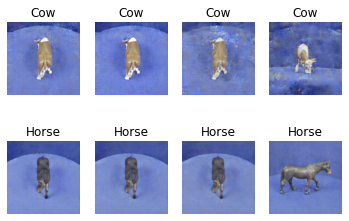

24501 [D loss: 0.018810, acc.: 100.00%] [G loss: 3.632481]
24502 [D loss: 0.058752, acc.: 98.44%] [G loss: 3.813036]
24503 [D loss: 0.014691, acc.: 100.00%] [G loss: 4.051193]
24504 [D loss: 0.011239, acc.: 100.00%] [G loss: 4.457071]
24505 [D loss: 0.092190, acc.: 98.44%] [G loss: 4.009977]
24506 [D loss: 0.056498, acc.: 98.44%] [G loss: 4.214550]
24507 [D loss: 0.061942, acc.: 98.44%] [G loss: 3.846905]
24508 [D loss: 0.216619, acc.: 93.75%] [G loss: 4.218266]
24509 [D loss: 0.190600, acc.: 93.75%] [G loss: 3.664824]
24510 [D loss: 0.181396, acc.: 95.31%] [G loss: 3.466624]
24511 [D loss: 0.063431, acc.: 98.44%] [G loss: 3.604105]
24512 [D loss: 0.225072, acc.: 95.31%] [G loss: 3.125291]
24513 [D loss: 0.133397, acc.: 96.88%] [G loss: 3.088556]
24514 [D loss: 0.085883, acc.: 98.44%] [G loss: 3.109251]
24515 [D loss: 0.144158, acc.: 95.31%] [G loss: 3.438964]
24516 [D loss: 0.068431, acc.: 98.44%] [G loss: 3.248423]
24517 [D loss: 0.112315, acc.: 96.88%] [G loss: 3.276835]
24518 [D lo

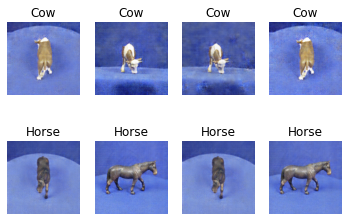

24601 [D loss: 0.024969, acc.: 100.00%] [G loss: 3.814471]
24602 [D loss: 0.097026, acc.: 96.88%] [G loss: 4.007802]
24603 [D loss: 0.178355, acc.: 95.31%] [G loss: 3.717460]
24604 [D loss: 0.129860, acc.: 96.88%] [G loss: 3.399721]
24605 [D loss: 0.029144, acc.: 100.00%] [G loss: 3.533738]
24606 [D loss: 0.051223, acc.: 98.44%] [G loss: 3.793920]
24607 [D loss: 0.146905, acc.: 95.31%] [G loss: 3.509097]
24608 [D loss: 0.065069, acc.: 98.44%] [G loss: 3.428786]
24609 [D loss: 0.236951, acc.: 93.75%] [G loss: 3.524860]
24610 [D loss: 0.112204, acc.: 96.88%] [G loss: 4.064537]
24611 [D loss: 0.096374, acc.: 96.88%] [G loss: 3.552223]
24612 [D loss: 0.113870, acc.: 96.88%] [G loss: 3.155972]
24613 [D loss: 0.092956, acc.: 96.88%] [G loss: 3.632413]
24614 [D loss: 0.127532, acc.: 96.88%] [G loss: 3.034315]
24615 [D loss: 0.107304, acc.: 96.88%] [G loss: 3.782948]
24616 [D loss: 0.169242, acc.: 95.31%] [G loss: 3.776950]
24617 [D loss: 0.049351, acc.: 100.00%] [G loss: 3.434180]
24618 [D lo

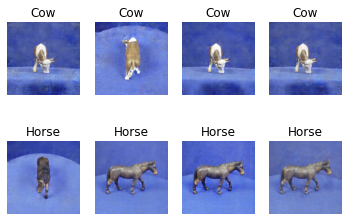

24701 [D loss: 0.132192, acc.: 96.88%] [G loss: 3.829419]
24702 [D loss: 0.031915, acc.: 100.00%] [G loss: 3.643654]
24703 [D loss: 0.174939, acc.: 95.31%] [G loss: 3.059446]
24704 [D loss: 0.093103, acc.: 98.44%] [G loss: 3.972534]
24705 [D loss: 0.140505, acc.: 95.31%] [G loss: 3.341226]
24706 [D loss: 0.177820, acc.: 96.88%] [G loss: 4.922784]
24707 [D loss: 0.019318, acc.: 100.00%] [G loss: 3.892500]
24708 [D loss: 0.166576, acc.: 95.31%] [G loss: 4.023979]
24709 [D loss: 0.187914, acc.: 95.31%] [G loss: 3.541853]
24710 [D loss: 0.037112, acc.: 100.00%] [G loss: 3.187255]
24711 [D loss: 0.076552, acc.: 98.44%] [G loss: 3.200736]
24712 [D loss: 0.103915, acc.: 96.88%] [G loss: 3.232823]
24713 [D loss: 0.076650, acc.: 98.44%] [G loss: 3.134818]
24714 [D loss: 0.089791, acc.: 98.44%] [G loss: 3.147122]
24715 [D loss: 0.120963, acc.: 96.88%] [G loss: 3.083628]
24716 [D loss: 0.119931, acc.: 96.88%] [G loss: 3.009118]
24717 [D loss: 0.109659, acc.: 96.88%] [G loss: 3.575670]
24718 [D lo

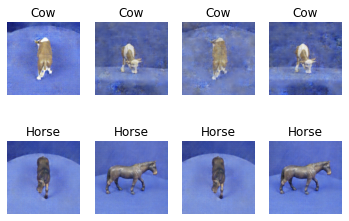

24801 [D loss: 0.080817, acc.: 98.44%] [G loss: 3.534093]
24802 [D loss: 0.024191, acc.: 100.00%] [G loss: 4.001682]
24803 [D loss: 0.073908, acc.: 98.44%] [G loss: 4.356461]
24804 [D loss: 0.021156, acc.: 100.00%] [G loss: 3.773129]
24805 [D loss: 0.086630, acc.: 96.88%] [G loss: 4.304934]
24806 [D loss: 0.070776, acc.: 98.44%] [G loss: 4.079879]
24807 [D loss: 0.085456, acc.: 96.88%] [G loss: 3.450530]
24808 [D loss: 0.085906, acc.: 96.88%] [G loss: 4.137477]
24809 [D loss: 0.114144, acc.: 96.88%] [G loss: 3.738326]
24810 [D loss: 0.076151, acc.: 98.44%] [G loss: 3.932728]
24811 [D loss: 0.038084, acc.: 98.44%] [G loss: 5.001302]
24812 [D loss: 0.061265, acc.: 98.44%] [G loss: 5.251832]
24813 [D loss: 0.158357, acc.: 95.31%] [G loss: 4.138792]
24814 [D loss: 0.063066, acc.: 98.44%] [G loss: 4.449419]
24815 [D loss: 0.118385, acc.: 95.31%] [G loss: 4.541456]
24816 [D loss: 0.104903, acc.: 96.88%] [G loss: 6.997899]
24817 [D loss: 0.101612, acc.: 96.88%] [G loss: 3.628669]
24818 [D los

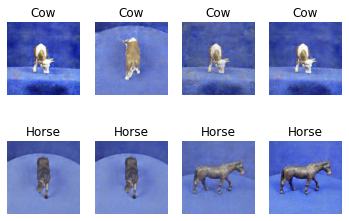

24901 [D loss: 0.109495, acc.: 96.88%] [G loss: 3.971113]
24902 [D loss: 0.071944, acc.: 98.44%] [G loss: 4.438410]
24903 [D loss: 0.071792, acc.: 98.44%] [G loss: 3.980904]
24904 [D loss: 0.158053, acc.: 95.31%] [G loss: 3.890664]
24905 [D loss: 0.203747, acc.: 93.75%] [G loss: 3.814819]
24906 [D loss: 0.066650, acc.: 98.44%] [G loss: 3.858814]
24907 [D loss: 0.028637, acc.: 100.00%] [G loss: 3.746083]
24908 [D loss: 0.023810, acc.: 100.00%] [G loss: 4.004190]
24909 [D loss: 0.009616, acc.: 100.00%] [G loss: 5.326433]
24910 [D loss: 0.136913, acc.: 96.88%] [G loss: 4.912945]
24911 [D loss: 0.108482, acc.: 96.88%] [G loss: 4.887405]
24912 [D loss: 0.018485, acc.: 100.00%] [G loss: 4.119820]
24913 [D loss: 0.074739, acc.: 98.44%] [G loss: 4.123905]
24914 [D loss: 0.210685, acc.: 95.31%] [G loss: 4.700755]
24915 [D loss: 0.094990, acc.: 96.88%] [G loss: 3.956921]
24916 [D loss: 0.019469, acc.: 100.00%] [G loss: 3.948154]
24917 [D loss: 0.118042, acc.: 96.88%] [G loss: 3.614990]
24918 [D 

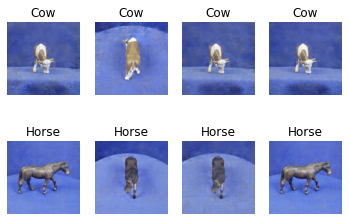

25001 [D loss: 0.173476, acc.: 93.75%] [G loss: 4.758939]
25002 [D loss: 0.042435, acc.: 100.00%] [G loss: 3.477858]
25003 [D loss: 0.256631, acc.: 90.62%] [G loss: 4.002146]
25004 [D loss: 0.018586, acc.: 100.00%] [G loss: 4.204160]
25005 [D loss: 0.116774, acc.: 96.88%] [G loss: 3.398195]
25006 [D loss: 0.161211, acc.: 95.31%] [G loss: 2.960264]
25007 [D loss: 0.051105, acc.: 100.00%] [G loss: 2.783916]
25008 [D loss: 0.170889, acc.: 95.31%] [G loss: 3.585021]
25009 [D loss: 0.116450, acc.: 96.88%] [G loss: 3.869071]
25010 [D loss: 0.136126, acc.: 96.88%] [G loss: 3.811752]
25011 [D loss: 0.104880, acc.: 96.88%] [G loss: 3.930999]
25012 [D loss: 0.132896, acc.: 95.31%] [G loss: 3.641709]
25013 [D loss: 0.104249, acc.: 96.88%] [G loss: 3.468820]
25014 [D loss: 0.087860, acc.: 96.88%] [G loss: 4.235810]
25015 [D loss: 0.092080, acc.: 96.88%] [G loss: 4.721143]
25016 [D loss: 0.076069, acc.: 98.44%] [G loss: 3.839981]
25017 [D loss: 0.132662, acc.: 96.88%] [G loss: 3.960964]
25018 [D lo

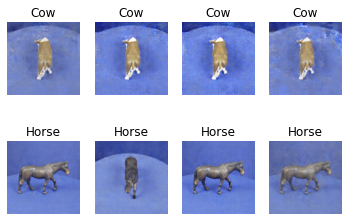

25101 [D loss: 0.164457, acc.: 95.31%] [G loss: 3.495103]
25102 [D loss: 0.068708, acc.: 98.44%] [G loss: 3.474349]
25103 [D loss: 0.177248, acc.: 93.75%] [G loss: 4.567300]
25104 [D loss: 0.038026, acc.: 98.44%] [G loss: 4.901749]
25105 [D loss: 0.234764, acc.: 92.19%] [G loss: 3.925961]
25106 [D loss: 0.068190, acc.: 98.44%] [G loss: 3.966478]
25107 [D loss: 0.048976, acc.: 98.44%] [G loss: 3.550519]
25108 [D loss: 0.058597, acc.: 98.44%] [G loss: 3.880708]
25109 [D loss: 0.055385, acc.: 98.44%] [G loss: 3.677189]
25110 [D loss: 0.107206, acc.: 95.31%] [G loss: 4.682420]
25111 [D loss: 0.169742, acc.: 95.31%] [G loss: 4.930828]
25112 [D loss: 0.070434, acc.: 98.44%] [G loss: 4.088548]
25113 [D loss: 0.020823, acc.: 100.00%] [G loss: 5.641082]
25114 [D loss: 0.202724, acc.: 95.31%] [G loss: 5.068635]
25115 [D loss: 0.182658, acc.: 96.88%] [G loss: 3.889988]
25116 [D loss: 0.151393, acc.: 95.31%] [G loss: 2.783083]
25117 [D loss: 0.079055, acc.: 98.44%] [G loss: 3.150069]
25118 [D loss

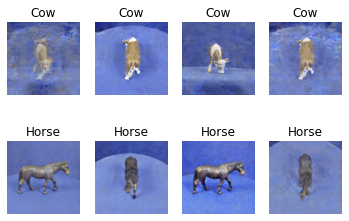

25201 [D loss: 0.100277, acc.: 96.88%] [G loss: 4.145630]
25202 [D loss: 0.015802, acc.: 100.00%] [G loss: 4.498698]
25203 [D loss: 0.143576, acc.: 95.31%] [G loss: 4.039382]
25204 [D loss: 0.018468, acc.: 100.00%] [G loss: 3.735605]
25205 [D loss: 0.131818, acc.: 96.88%] [G loss: 5.652804]
25206 [D loss: 0.109056, acc.: 96.88%] [G loss: 4.314024]
25207 [D loss: 0.212924, acc.: 93.75%] [G loss: 5.086554]
25208 [D loss: 0.026652, acc.: 100.00%] [G loss: 3.616301]
25209 [D loss: 0.100689, acc.: 96.88%] [G loss: 3.121000]
25210 [D loss: 0.052155, acc.: 98.44%] [G loss: 4.279073]
25211 [D loss: 0.027620, acc.: 100.00%] [G loss: 3.805898]
25212 [D loss: 0.145075, acc.: 96.88%] [G loss: 4.980291]
25213 [D loss: 0.109884, acc.: 96.88%] [G loss: 4.899915]
25214 [D loss: 0.188299, acc.: 93.75%] [G loss: 3.989196]
25215 [D loss: 0.169825, acc.: 95.31%] [G loss: 4.278837]
25216 [D loss: 0.051462, acc.: 100.00%] [G loss: 3.734860]
25217 [D loss: 0.025814, acc.: 100.00%] [G loss: 3.878754]
25218 [D

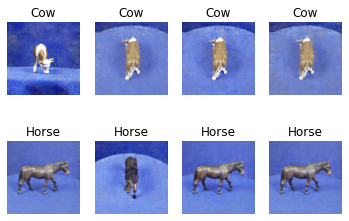

25301 [D loss: 0.140409, acc.: 95.31%] [G loss: 4.357518]
25302 [D loss: 0.094189, acc.: 98.44%] [G loss: 3.490158]
25303 [D loss: 0.098399, acc.: 96.88%] [G loss: 3.554779]
25304 [D loss: 0.075318, acc.: 98.44%] [G loss: 3.824948]
25305 [D loss: 0.022934, acc.: 100.00%] [G loss: 4.192769]
25306 [D loss: 0.019384, acc.: 100.00%] [G loss: 3.775758]
25307 [D loss: 0.104857, acc.: 96.88%] [G loss: 3.864637]
25308 [D loss: 0.157609, acc.: 95.31%] [G loss: 3.003017]
25309 [D loss: 0.292079, acc.: 90.62%] [G loss: 2.848520]
25310 [D loss: 0.048052, acc.: 100.00%] [G loss: 3.295837]
25311 [D loss: 0.062234, acc.: 98.44%] [G loss: 3.585703]
25312 [D loss: 0.080355, acc.: 96.88%] [G loss: 3.756195]
25313 [D loss: 0.111538, acc.: 96.88%] [G loss: 3.273784]
25314 [D loss: 0.168205, acc.: 95.31%] [G loss: 3.064012]
25315 [D loss: 0.069772, acc.: 98.44%] [G loss: 3.489117]
25316 [D loss: 0.045739, acc.: 98.44%] [G loss: 3.721803]
25317 [D loss: 0.150105, acc.: 96.88%] [G loss: 3.683016]
25318 [D lo

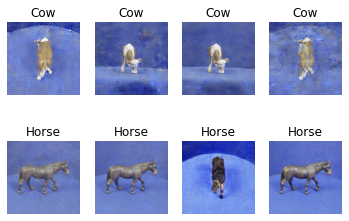

25401 [D loss: 0.105939, acc.: 96.88%] [G loss: 4.178882]
25402 [D loss: 0.064346, acc.: 98.44%] [G loss: 3.606119]
25403 [D loss: 0.173327, acc.: 95.31%] [G loss: 3.152206]
25404 [D loss: 0.013700, acc.: 100.00%] [G loss: 4.435292]
25405 [D loss: 0.092118, acc.: 96.88%] [G loss: 3.251432]
25406 [D loss: 0.125827, acc.: 96.88%] [G loss: 4.508934]
25407 [D loss: 0.087212, acc.: 98.44%] [G loss: 3.536926]
25408 [D loss: 0.075623, acc.: 98.44%] [G loss: 4.358274]
25409 [D loss: 0.072074, acc.: 98.44%] [G loss: 4.178020]
25410 [D loss: 0.115477, acc.: 95.31%] [G loss: 5.537185]
25411 [D loss: 0.043786, acc.: 100.00%] [G loss: 4.317256]
25412 [D loss: 0.179014, acc.: 95.31%] [G loss: 3.537427]
25413 [D loss: 0.089145, acc.: 96.88%] [G loss: 3.751831]
25414 [D loss: 0.016893, acc.: 100.00%] [G loss: 3.928387]
25415 [D loss: 0.132199, acc.: 96.88%] [G loss: 3.469483]
25416 [D loss: 0.056502, acc.: 98.44%] [G loss: 4.079540]
25417 [D loss: 0.072430, acc.: 98.44%] [G loss: 4.583324]
25418 [D lo

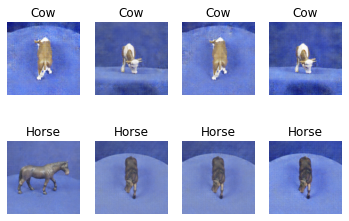

25501 [D loss: 0.113101, acc.: 96.88%] [G loss: 4.229920]
25502 [D loss: 0.102972, acc.: 96.88%] [G loss: 4.399650]
25503 [D loss: 0.088723, acc.: 98.44%] [G loss: 4.572043]
25504 [D loss: 0.020280, acc.: 100.00%] [G loss: 5.318890]
25505 [D loss: 0.068225, acc.: 98.44%] [G loss: 4.024289]
25506 [D loss: 0.110415, acc.: 96.88%] [G loss: 4.953871]
25507 [D loss: 0.054952, acc.: 98.44%] [G loss: 3.760771]
25508 [D loss: 0.101187, acc.: 96.88%] [G loss: 4.263742]
25509 [D loss: 0.181283, acc.: 93.75%] [G loss: 3.302736]
25510 [D loss: 0.172181, acc.: 93.75%] [G loss: 3.208800]
25511 [D loss: 0.094588, acc.: 98.44%] [G loss: 4.530514]
25512 [D loss: 0.029389, acc.: 100.00%] [G loss: 3.611432]
25513 [D loss: 0.137870, acc.: 95.31%] [G loss: 3.957393]
25514 [D loss: 0.111666, acc.: 96.88%] [G loss: 4.298804]
25515 [D loss: 0.026341, acc.: 100.00%] [G loss: 4.092178]
25516 [D loss: 0.100855, acc.: 96.88%] [G loss: 3.667591]
25517 [D loss: 0.089839, acc.: 96.88%] [G loss: 4.740749]
25518 [D lo

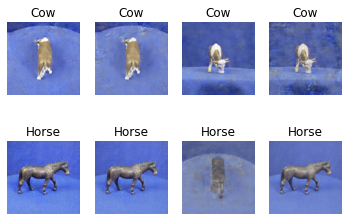

25601 [D loss: 0.051040, acc.: 98.44%] [G loss: 4.234585]
25602 [D loss: 0.076828, acc.: 98.44%] [G loss: 3.738418]
25603 [D loss: 0.141355, acc.: 93.75%] [G loss: 4.301960]
25604 [D loss: 0.083408, acc.: 96.88%] [G loss: 4.665195]
25605 [D loss: 0.108361, acc.: 96.88%] [G loss: 5.426435]
25606 [D loss: 0.095014, acc.: 96.88%] [G loss: 5.219580]
25607 [D loss: 0.066375, acc.: 98.44%] [G loss: 4.749433]
25608 [D loss: 0.037196, acc.: 100.00%] [G loss: 4.098103]
25609 [D loss: 0.199891, acc.: 93.75%] [G loss: 4.917254]
25610 [D loss: 0.098888, acc.: 96.88%] [G loss: 4.553198]
25611 [D loss: 0.127560, acc.: 95.31%] [G loss: 4.400977]
25612 [D loss: 0.046653, acc.: 100.00%] [G loss: 2.986097]
25613 [D loss: 0.029611, acc.: 100.00%] [G loss: 4.545125]
25614 [D loss: 0.102870, acc.: 95.31%] [G loss: 3.666498]
25615 [D loss: 0.079971, acc.: 96.88%] [G loss: 4.104249]
25616 [D loss: 0.054083, acc.: 98.44%] [G loss: 3.603847]
25617 [D loss: 0.065514, acc.: 98.44%] [G loss: 4.239713]
25618 [D lo

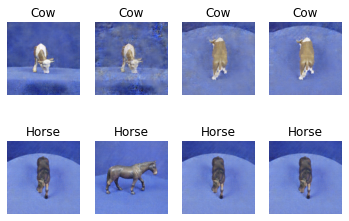

25701 [D loss: 0.062524, acc.: 98.44%] [G loss: 4.045978]
25702 [D loss: 0.138412, acc.: 93.75%] [G loss: 5.000460]
25703 [D loss: 0.093404, acc.: 96.88%] [G loss: 5.351158]
25704 [D loss: 0.032279, acc.: 100.00%] [G loss: 4.462974]
25705 [D loss: 0.021580, acc.: 100.00%] [G loss: 5.070453]
25706 [D loss: 0.012941, acc.: 100.00%] [G loss: 5.424726]
25707 [D loss: 0.062293, acc.: 98.44%] [G loss: 5.525901]
25708 [D loss: 0.080066, acc.: 98.44%] [G loss: 5.599288]
25709 [D loss: 0.070346, acc.: 98.44%] [G loss: 4.938375]
25710 [D loss: 0.129513, acc.: 96.88%] [G loss: 4.865205]
25711 [D loss: 0.113177, acc.: 96.88%] [G loss: 3.877178]
25712 [D loss: 0.085303, acc.: 96.88%] [G loss: 4.957014]
25713 [D loss: 0.188298, acc.: 93.75%] [G loss: 3.995643]
25714 [D loss: 0.120024, acc.: 95.31%] [G loss: 5.273576]
25715 [D loss: 0.120386, acc.: 95.31%] [G loss: 4.808094]
25716 [D loss: 0.105351, acc.: 96.88%] [G loss: 4.083372]
25717 [D loss: 0.100533, acc.: 96.88%] [G loss: 4.177914]
25718 [D lo

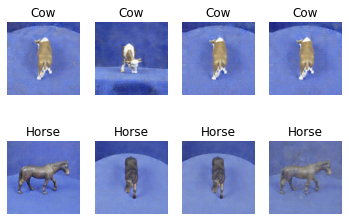

25801 [D loss: 0.118224, acc.: 96.88%] [G loss: 3.472222]
25802 [D loss: 0.026740, acc.: 100.00%] [G loss: 4.290922]
25803 [D loss: 0.171882, acc.: 95.31%] [G loss: 3.842402]
25804 [D loss: 0.014897, acc.: 100.00%] [G loss: 4.589806]
25805 [D loss: 0.095255, acc.: 96.88%] [G loss: 4.362136]
25806 [D loss: 0.089325, acc.: 98.44%] [G loss: 3.698177]
25807 [D loss: 0.112945, acc.: 96.88%] [G loss: 3.744082]
25808 [D loss: 0.027497, acc.: 100.00%] [G loss: 3.924445]
25809 [D loss: 0.156188, acc.: 96.88%] [G loss: 4.520942]
25810 [D loss: 0.085481, acc.: 96.88%] [G loss: 4.663452]
25811 [D loss: 0.202535, acc.: 93.75%] [G loss: 3.693906]
25812 [D loss: 0.041093, acc.: 100.00%] [G loss: 3.655064]
25813 [D loss: 0.089799, acc.: 96.88%] [G loss: 4.508353]
25814 [D loss: 0.098459, acc.: 96.88%] [G loss: 4.208855]
25815 [D loss: 0.075073, acc.: 98.44%] [G loss: 3.195944]
25816 [D loss: 0.219451, acc.: 93.75%] [G loss: 3.652099]
25817 [D loss: 0.057762, acc.: 98.44%] [G loss: 4.167038]
25818 [D l

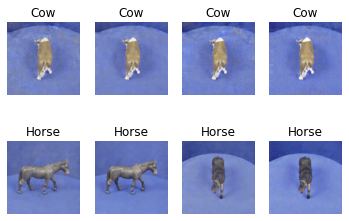

25901 [D loss: 0.031170, acc.: 100.00%] [G loss: 3.608327]
25902 [D loss: 0.066074, acc.: 98.44%] [G loss: 3.472026]
25903 [D loss: 0.078351, acc.: 98.44%] [G loss: 4.549374]
25904 [D loss: 0.175653, acc.: 95.31%] [G loss: 3.945159]
25905 [D loss: 0.015954, acc.: 100.00%] [G loss: 4.100444]
25906 [D loss: 0.073372, acc.: 98.44%] [G loss: 3.294099]
25907 [D loss: 0.115748, acc.: 96.88%] [G loss: 4.223789]
25908 [D loss: 0.070326, acc.: 98.44%] [G loss: 4.234860]
25909 [D loss: 0.073075, acc.: 98.44%] [G loss: 3.894398]
25910 [D loss: 0.113241, acc.: 96.88%] [G loss: 4.735333]
25911 [D loss: 0.130890, acc.: 95.31%] [G loss: 3.599286]
25912 [D loss: 0.175097, acc.: 95.31%] [G loss: 5.707091]
25913 [D loss: 0.078423, acc.: 98.44%] [G loss: 3.554837]
25914 [D loss: 0.067631, acc.: 98.44%] [G loss: 3.661222]
25915 [D loss: 0.109964, acc.: 96.88%] [G loss: 3.912284]
25916 [D loss: 0.020724, acc.: 100.00%] [G loss: 4.959525]
25917 [D loss: 0.043987, acc.: 98.44%] [G loss: 6.444239]
25918 [D lo

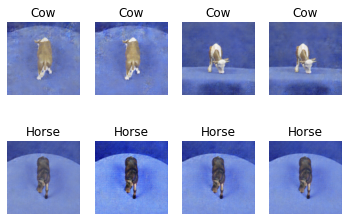

26001 [D loss: 0.065774, acc.: 98.44%] [G loss: 4.534799]
26002 [D loss: 0.120619, acc.: 96.88%] [G loss: 3.332152]
26003 [D loss: 0.091576, acc.: 98.44%] [G loss: 4.374857]
26004 [D loss: 0.018492, acc.: 100.00%] [G loss: 4.024648]
26005 [D loss: 0.350544, acc.: 89.06%] [G loss: 4.197988]
26006 [D loss: 0.030793, acc.: 100.00%] [G loss: 3.735015]
26007 [D loss: 0.102336, acc.: 98.44%] [G loss: 3.279383]
26008 [D loss: 0.119278, acc.: 96.88%] [G loss: 3.555485]
26009 [D loss: 0.044004, acc.: 100.00%] [G loss: 2.978014]
26010 [D loss: 0.072629, acc.: 98.44%] [G loss: 3.631881]
26011 [D loss: 0.086332, acc.: 96.88%] [G loss: 3.801210]
26012 [D loss: 0.162102, acc.: 95.31%] [G loss: 3.564885]
26013 [D loss: 0.106317, acc.: 96.88%] [G loss: 3.922773]
26014 [D loss: 0.117187, acc.: 96.88%] [G loss: 3.728367]
26015 [D loss: 0.097152, acc.: 96.88%] [G loss: 3.952930]
26016 [D loss: 0.065620, acc.: 98.44%] [G loss: 3.681617]
26017 [D loss: 0.095041, acc.: 96.88%] [G loss: 3.929297]
26018 [D lo

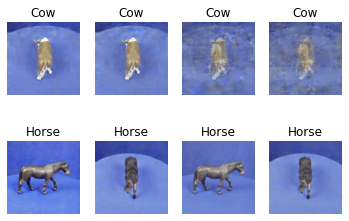

26101 [D loss: 0.030831, acc.: 100.00%] [G loss: 4.006467]
26102 [D loss: 0.023513, acc.: 100.00%] [G loss: 4.500504]
26103 [D loss: 0.009131, acc.: 100.00%] [G loss: 4.888528]
26104 [D loss: 0.141267, acc.: 96.88%] [G loss: 4.271242]
26105 [D loss: 0.065387, acc.: 98.44%] [G loss: 3.727974]
26106 [D loss: 0.057817, acc.: 98.44%] [G loss: 5.192059]
26107 [D loss: 0.126579, acc.: 96.88%] [G loss: 4.293338]
26108 [D loss: 0.060301, acc.: 98.44%] [G loss: 4.053212]
26109 [D loss: 0.018773, acc.: 100.00%] [G loss: 4.817300]
26110 [D loss: 0.071358, acc.: 98.44%] [G loss: 3.524821]
26111 [D loss: 0.054994, acc.: 98.44%] [G loss: 4.640413]
26112 [D loss: 0.053352, acc.: 98.44%] [G loss: 4.868673]
26113 [D loss: 0.135172, acc.: 96.88%] [G loss: 4.418757]
26114 [D loss: 0.069533, acc.: 98.44%] [G loss: 4.022328]
26115 [D loss: 0.105260, acc.: 96.88%] [G loss: 4.085301]
26116 [D loss: 0.068039, acc.: 98.44%] [G loss: 3.743347]
26117 [D loss: 0.104016, acc.: 96.88%] [G loss: 3.775430]
26118 [D l

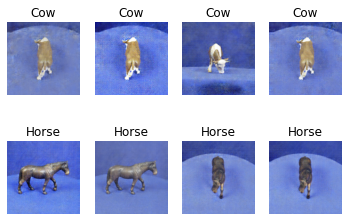

26201 [D loss: 0.086770, acc.: 96.88%] [G loss: 4.399199]
26202 [D loss: 0.041027, acc.: 98.44%] [G loss: 4.523411]
26203 [D loss: 0.128390, acc.: 96.88%] [G loss: 5.414176]
26204 [D loss: 0.084352, acc.: 98.44%] [G loss: 5.504558]
26205 [D loss: 0.095556, acc.: 96.88%] [G loss: 4.917824]
26206 [D loss: 0.019582, acc.: 100.00%] [G loss: 5.131397]
26207 [D loss: 0.123858, acc.: 96.88%] [G loss: 3.618945]
26208 [D loss: 0.019162, acc.: 100.00%] [G loss: 3.769862]
26209 [D loss: 0.136499, acc.: 95.31%] [G loss: 4.306168]
26210 [D loss: 0.088059, acc.: 96.88%] [G loss: 4.580976]
26211 [D loss: 0.138797, acc.: 95.31%] [G loss: 4.519705]
26212 [D loss: 0.078430, acc.: 98.44%] [G loss: 3.716931]
26213 [D loss: 0.115225, acc.: 96.88%] [G loss: 3.808553]
26214 [D loss: 0.152331, acc.: 95.31%] [G loss: 3.486013]
26215 [D loss: 0.095753, acc.: 96.88%] [G loss: 5.017622]
26216 [D loss: 0.083651, acc.: 96.88%] [G loss: 4.954370]
26217 [D loss: 0.134421, acc.: 96.88%] [G loss: 2.933267]
26218 [D los

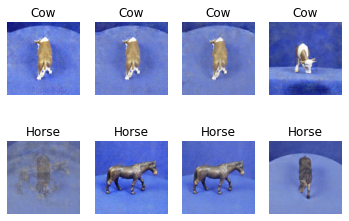

26301 [D loss: 0.190844, acc.: 93.75%] [G loss: 4.040391]
26302 [D loss: 0.075169, acc.: 98.44%] [G loss: 2.903504]
26303 [D loss: 0.111050, acc.: 96.88%] [G loss: 3.154445]
26304 [D loss: 0.036498, acc.: 100.00%] [G loss: 3.668857]
26305 [D loss: 0.085071, acc.: 96.88%] [G loss: 4.925778]
26306 [D loss: 0.110936, acc.: 96.88%] [G loss: 3.878772]
26307 [D loss: 0.142146, acc.: 96.88%] [G loss: 4.349818]
26308 [D loss: 0.063199, acc.: 98.44%] [G loss: 3.887984]
26309 [D loss: 0.024798, acc.: 100.00%] [G loss: 4.181787]
26310 [D loss: 0.117778, acc.: 96.88%] [G loss: 4.056327]
26311 [D loss: 0.056942, acc.: 98.44%] [G loss: 5.108446]
26312 [D loss: 0.004847, acc.: 100.00%] [G loss: 6.007120]
26313 [D loss: 0.227647, acc.: 93.75%] [G loss: 3.701510]
26314 [D loss: 0.250466, acc.: 92.19%] [G loss: 4.238024]
26315 [D loss: 0.026229, acc.: 100.00%] [G loss: 3.608742]
26316 [D loss: 0.034597, acc.: 100.00%] [G loss: 3.847956]
26317 [D loss: 0.074337, acc.: 98.44%] [G loss: 4.571437]
26318 [D 

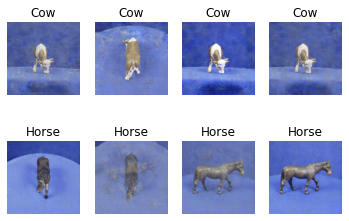

26401 [D loss: 0.047164, acc.: 98.44%] [G loss: 5.477694]
26402 [D loss: 0.061315, acc.: 98.44%] [G loss: 4.963261]
26403 [D loss: 0.126851, acc.: 96.88%] [G loss: 4.543904]
26404 [D loss: 0.101245, acc.: 96.88%] [G loss: 5.193981]
26405 [D loss: 0.243327, acc.: 93.75%] [G loss: 5.258688]
26406 [D loss: 0.094852, acc.: 96.88%] [G loss: 4.047785]
26407 [D loss: 0.067196, acc.: 98.44%] [G loss: 4.423299]
26408 [D loss: 0.055767, acc.: 98.44%] [G loss: 4.594394]
26409 [D loss: 0.017833, acc.: 100.00%] [G loss: 5.352186]
26410 [D loss: 0.095302, acc.: 98.44%] [G loss: 5.236714]
26411 [D loss: 0.117062, acc.: 96.88%] [G loss: 3.653906]
26412 [D loss: 0.053828, acc.: 98.44%] [G loss: 3.862727]
26413 [D loss: 0.121313, acc.: 96.88%] [G loss: 4.235618]
26414 [D loss: 0.061318, acc.: 98.44%] [G loss: 5.284547]
26415 [D loss: 0.221180, acc.: 95.31%] [G loss: 5.721439]
26416 [D loss: 0.012665, acc.: 100.00%] [G loss: 5.310144]
26417 [D loss: 0.090287, acc.: 96.88%] [G loss: 3.942216]
26418 [D los

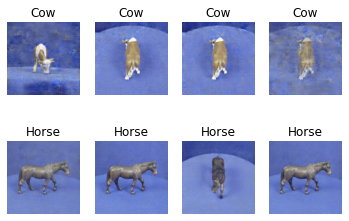

26501 [D loss: 0.105683, acc.: 96.88%] [G loss: 3.492537]
26502 [D loss: 0.073728, acc.: 98.44%] [G loss: 3.880155]
26503 [D loss: 0.121363, acc.: 96.88%] [G loss: 3.861652]
26504 [D loss: 0.194683, acc.: 95.31%] [G loss: 3.630160]
26505 [D loss: 0.032150, acc.: 100.00%] [G loss: 3.383847]
26506 [D loss: 0.059089, acc.: 98.44%] [G loss: 4.219701]
26507 [D loss: 0.114709, acc.: 96.88%] [G loss: 4.108525]
26508 [D loss: 0.083097, acc.: 98.44%] [G loss: 3.696580]
26509 [D loss: 0.228588, acc.: 92.19%] [G loss: 3.751195]
26510 [D loss: 0.018807, acc.: 100.00%] [G loss: 4.078157]
26511 [D loss: 0.079096, acc.: 98.44%] [G loss: 3.652528]
26512 [D loss: 0.134822, acc.: 96.88%] [G loss: 4.468480]
26513 [D loss: 0.111493, acc.: 96.88%] [G loss: 3.565753]
26514 [D loss: 0.114298, acc.: 96.88%] [G loss: 3.822541]
26515 [D loss: 0.036690, acc.: 100.00%] [G loss: 3.989653]
26516 [D loss: 0.055962, acc.: 98.44%] [G loss: 4.013431]
26517 [D loss: 0.068966, acc.: 98.44%] [G loss: 4.649835]
26518 [D lo

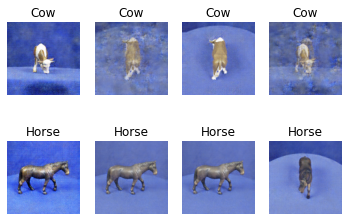

26601 [D loss: 0.134444, acc.: 95.31%] [G loss: 4.050140]
26602 [D loss: 0.085945, acc.: 96.88%] [G loss: 4.220631]
26603 [D loss: 0.070331, acc.: 98.44%] [G loss: 3.693580]
26604 [D loss: 0.078492, acc.: 98.44%] [G loss: 3.459582]
26605 [D loss: 0.064437, acc.: 98.44%] [G loss: 3.825455]
26606 [D loss: 0.053231, acc.: 98.44%] [G loss: 3.791742]
26607 [D loss: 0.152140, acc.: 95.31%] [G loss: 3.758377]
26608 [D loss: 0.188500, acc.: 93.75%] [G loss: 3.420774]
26609 [D loss: 0.024776, acc.: 100.00%] [G loss: 4.060614]
26610 [D loss: 0.078786, acc.: 98.44%] [G loss: 3.547930]
26611 [D loss: 0.095589, acc.: 96.88%] [G loss: 3.900474]
26612 [D loss: 0.101029, acc.: 96.88%] [G loss: 3.677012]
26613 [D loss: 0.183657, acc.: 95.31%] [G loss: 3.800686]
26614 [D loss: 0.134994, acc.: 95.31%] [G loss: 4.446515]
26615 [D loss: 0.095460, acc.: 96.88%] [G loss: 4.046219]
26616 [D loss: 0.022509, acc.: 100.00%] [G loss: 4.026646]
26617 [D loss: 0.119320, acc.: 96.88%] [G loss: 3.990191]
26618 [D los

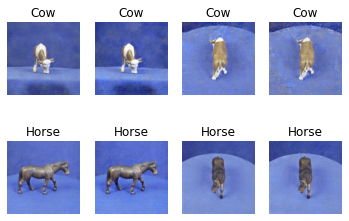

26701 [D loss: 0.090912, acc.: 98.44%] [G loss: 2.595368]
26702 [D loss: 0.030444, acc.: 100.00%] [G loss: 3.925410]
26703 [D loss: 0.167440, acc.: 95.31%] [G loss: 4.255352]
26704 [D loss: 0.132210, acc.: 95.31%] [G loss: 4.560529]
26705 [D loss: 0.217624, acc.: 92.19%] [G loss: 4.369133]
26706 [D loss: 0.034471, acc.: 100.00%] [G loss: 3.285747]
26707 [D loss: 0.070580, acc.: 98.44%] [G loss: 4.572509]
26708 [D loss: 0.041116, acc.: 100.00%] [G loss: 3.419737]
26709 [D loss: 0.030887, acc.: 100.00%] [G loss: 4.250679]
26710 [D loss: 0.025826, acc.: 100.00%] [G loss: 4.142666]
26711 [D loss: 0.075564, acc.: 98.44%] [G loss: 3.514085]
26712 [D loss: 0.017452, acc.: 100.00%] [G loss: 3.806997]
26713 [D loss: 0.219050, acc.: 95.31%] [G loss: 4.266373]
26714 [D loss: 0.018620, acc.: 100.00%] [G loss: 4.374454]
26715 [D loss: 0.141127, acc.: 95.31%] [G loss: 3.649282]
26716 [D loss: 0.073485, acc.: 98.44%] [G loss: 3.211345]
26717 [D loss: 0.020050, acc.: 100.00%] [G loss: 3.597962]
26718 

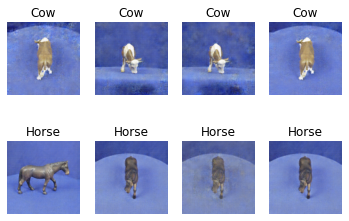

26801 [D loss: 0.238163, acc.: 93.75%] [G loss: 3.837109]
26802 [D loss: 0.221970, acc.: 93.75%] [G loss: 3.138701]
26803 [D loss: 0.041358, acc.: 100.00%] [G loss: 2.846761]
26804 [D loss: 0.110927, acc.: 96.88%] [G loss: 3.467071]
26805 [D loss: 0.065088, acc.: 98.44%] [G loss: 2.953815]
26806 [D loss: 0.105014, acc.: 96.88%] [G loss: 4.037757]
26807 [D loss: 0.128709, acc.: 96.88%] [G loss: 3.694126]
26808 [D loss: 0.095091, acc.: 96.88%] [G loss: 3.770453]
26809 [D loss: 0.117088, acc.: 96.88%] [G loss: 3.441537]
26810 [D loss: 0.068792, acc.: 98.44%] [G loss: 4.161953]
26811 [D loss: 0.104442, acc.: 96.88%] [G loss: 4.536800]
26812 [D loss: 0.063012, acc.: 98.44%] [G loss: 4.039909]
26813 [D loss: 0.016936, acc.: 100.00%] [G loss: 4.388352]
26814 [D loss: 0.109084, acc.: 96.88%] [G loss: 3.834459]
26815 [D loss: 0.060789, acc.: 98.44%] [G loss: 4.392333]
26816 [D loss: 0.142784, acc.: 95.31%] [G loss: 3.827388]
26817 [D loss: 0.067898, acc.: 98.44%] [G loss: 3.388096]
26818 [D los

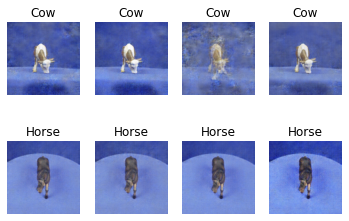

26901 [D loss: 0.091432, acc.: 96.88%] [G loss: 4.040559]
26902 [D loss: 0.016878, acc.: 100.00%] [G loss: 4.478166]
26903 [D loss: 0.019364, acc.: 100.00%] [G loss: 4.457706]
26904 [D loss: 0.019244, acc.: 100.00%] [G loss: 4.041401]
26905 [D loss: 0.199959, acc.: 95.31%] [G loss: 3.683852]
26906 [D loss: 0.063418, acc.: 98.44%] [G loss: 3.576320]
26907 [D loss: 0.098295, acc.: 98.44%] [G loss: 3.861028]
26908 [D loss: 0.179115, acc.: 95.31%] [G loss: 3.728917]
26909 [D loss: 0.133662, acc.: 95.31%] [G loss: 4.563589]
26910 [D loss: 0.159125, acc.: 93.75%] [G loss: 3.392597]
26911 [D loss: 0.051970, acc.: 98.44%] [G loss: 4.286883]
26912 [D loss: 0.074934, acc.: 98.44%] [G loss: 3.582686]
26913 [D loss: 0.187690, acc.: 93.75%] [G loss: 3.360040]
26914 [D loss: 0.071024, acc.: 98.44%] [G loss: 3.664272]
26915 [D loss: 0.021716, acc.: 100.00%] [G loss: 4.350736]
26916 [D loss: 0.162298, acc.: 93.75%] [G loss: 4.118553]
26917 [D loss: 0.030171, acc.: 100.00%] [G loss: 4.357263]
26918 [D 

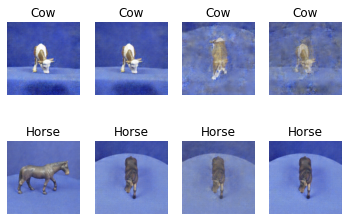

27001 [D loss: 0.199079, acc.: 95.31%] [G loss: 5.509326]
27002 [D loss: 0.045385, acc.: 98.44%] [G loss: 4.885531]
27003 [D loss: 0.270743, acc.: 93.75%] [G loss: 4.193280]
27004 [D loss: 0.184423, acc.: 96.88%] [G loss: 3.529284]
27005 [D loss: 0.114988, acc.: 98.44%] [G loss: 3.788642]
27006 [D loss: 0.072493, acc.: 98.44%] [G loss: 3.122097]
27007 [D loss: 0.024112, acc.: 100.00%] [G loss: 3.630991]
27008 [D loss: 0.134188, acc.: 96.88%] [G loss: 3.879031]
27009 [D loss: 0.201179, acc.: 95.31%] [G loss: 4.243155]
27010 [D loss: 0.137332, acc.: 96.88%] [G loss: 3.285598]
27011 [D loss: 0.028617, acc.: 100.00%] [G loss: 3.115247]
27012 [D loss: 0.075871, acc.: 98.44%] [G loss: 3.216496]
27013 [D loss: 0.139490, acc.: 95.31%] [G loss: 3.458963]
27014 [D loss: 0.089648, acc.: 98.44%] [G loss: 3.810533]
27015 [D loss: 0.143663, acc.: 95.31%] [G loss: 3.989105]
27016 [D loss: 0.063722, acc.: 98.44%] [G loss: 3.400146]
27017 [D loss: 0.280569, acc.: 92.19%] [G loss: 2.836221]
27018 [D los

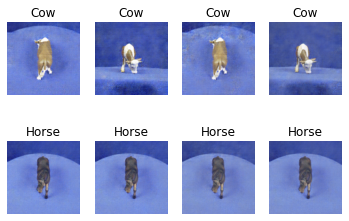

27101 [D loss: 0.121941, acc.: 96.88%] [G loss: 3.649916]
27102 [D loss: 0.080292, acc.: 98.44%] [G loss: 3.309123]
27103 [D loss: 0.154326, acc.: 95.31%] [G loss: 3.312155]
27104 [D loss: 0.073223, acc.: 98.44%] [G loss: 3.273816]
27105 [D loss: 0.143834, acc.: 95.31%] [G loss: 3.902674]
27106 [D loss: 0.113920, acc.: 96.88%] [G loss: 3.376091]
27107 [D loss: 0.185749, acc.: 92.19%] [G loss: 3.653366]
27108 [D loss: 0.106775, acc.: 96.88%] [G loss: 3.930096]
27109 [D loss: 0.037522, acc.: 100.00%] [G loss: 3.486008]
27110 [D loss: 0.027870, acc.: 100.00%] [G loss: 3.281091]
27111 [D loss: 0.114656, acc.: 96.88%] [G loss: 3.989601]
27112 [D loss: 0.288483, acc.: 93.75%] [G loss: 4.272872]
27113 [D loss: 0.075524, acc.: 98.44%] [G loss: 3.575402]
27114 [D loss: 0.073951, acc.: 98.44%] [G loss: 3.502851]
27115 [D loss: 0.098598, acc.: 96.88%] [G loss: 3.331773]
27116 [D loss: 0.030776, acc.: 100.00%] [G loss: 3.619834]
27117 [D loss: 0.074429, acc.: 98.44%] [G loss: 3.682027]
27118 [D lo

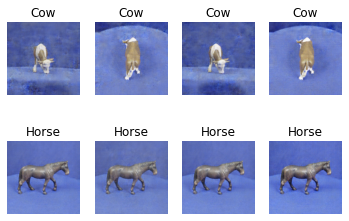

27201 [D loss: 0.057043, acc.: 98.44%] [G loss: 4.535580]
27202 [D loss: 0.118658, acc.: 96.88%] [G loss: 4.397047]
27203 [D loss: 0.115536, acc.: 95.31%] [G loss: 4.024933]
27204 [D loss: 0.072689, acc.: 98.44%] [G loss: 3.964058]
27205 [D loss: 0.022858, acc.: 100.00%] [G loss: 3.239531]
27206 [D loss: 0.087238, acc.: 98.44%] [G loss: 3.583193]
27207 [D loss: 0.129572, acc.: 96.88%] [G loss: 5.122728]
27208 [D loss: 0.056224, acc.: 98.44%] [G loss: 4.382440]
27209 [D loss: 0.127085, acc.: 95.31%] [G loss: 4.010928]
27210 [D loss: 0.110718, acc.: 96.88%] [G loss: 3.696725]
27211 [D loss: 0.098739, acc.: 96.88%] [G loss: 4.349527]
27212 [D loss: 0.202193, acc.: 93.75%] [G loss: 5.574223]
27213 [D loss: 0.174513, acc.: 95.31%] [G loss: 3.587589]
27214 [D loss: 0.117164, acc.: 96.88%] [G loss: 3.050225]
27215 [D loss: 0.042338, acc.: 100.00%] [G loss: 3.171803]
27216 [D loss: 0.024251, acc.: 100.00%] [G loss: 3.952773]
27217 [D loss: 0.096828, acc.: 96.88%] [G loss: 3.295603]
27218 [D lo

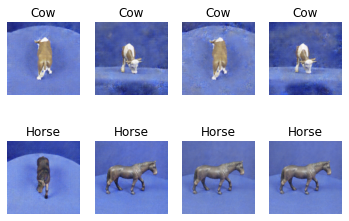

27301 [D loss: 0.129826, acc.: 95.31%] [G loss: 4.553007]
27302 [D loss: 0.156810, acc.: 95.31%] [G loss: 3.534575]
27303 [D loss: 0.157029, acc.: 95.31%] [G loss: 3.057587]
27304 [D loss: 0.100046, acc.: 96.88%] [G loss: 3.579758]
27305 [D loss: 0.089720, acc.: 96.88%] [G loss: 3.883169]
27306 [D loss: 0.123211, acc.: 96.88%] [G loss: 3.973761]
27307 [D loss: 0.036959, acc.: 100.00%] [G loss: 3.474292]
27308 [D loss: 0.086060, acc.: 96.88%] [G loss: 4.087751]
27309 [D loss: 0.049140, acc.: 98.44%] [G loss: 4.849106]
27310 [D loss: 0.046930, acc.: 98.44%] [G loss: 4.427216]
27311 [D loss: 0.081477, acc.: 98.44%] [G loss: 3.784985]
27312 [D loss: 0.086349, acc.: 96.88%] [G loss: 5.349602]
27313 [D loss: 0.104732, acc.: 98.44%] [G loss: 4.265039]
27314 [D loss: 0.088495, acc.: 96.88%] [G loss: 3.429928]
27315 [D loss: 0.031173, acc.: 100.00%] [G loss: 3.936631]
27316 [D loss: 0.119390, acc.: 96.88%] [G loss: 4.583330]
27317 [D loss: 0.137775, acc.: 96.88%] [G loss: 3.484438]
27318 [D los

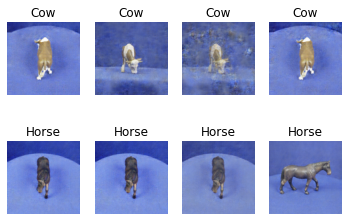

27401 [D loss: 0.020388, acc.: 100.00%] [G loss: 4.085661]
27402 [D loss: 0.148627, acc.: 96.88%] [G loss: 4.228539]
27403 [D loss: 0.134165, acc.: 96.88%] [G loss: 3.746593]
27404 [D loss: 0.063141, acc.: 98.44%] [G loss: 4.261487]
27405 [D loss: 0.113051, acc.: 96.88%] [G loss: 3.561277]
27406 [D loss: 0.098188, acc.: 96.88%] [G loss: 3.713216]
27407 [D loss: 0.020183, acc.: 100.00%] [G loss: 4.446901]
27408 [D loss: 0.096778, acc.: 96.88%] [G loss: 4.158252]
27409 [D loss: 0.176336, acc.: 95.31%] [G loss: 3.374648]
27410 [D loss: 0.029655, acc.: 100.00%] [G loss: 3.407358]
27411 [D loss: 0.112437, acc.: 96.88%] [G loss: 3.517901]
27412 [D loss: 0.164610, acc.: 95.31%] [G loss: 4.125205]
27413 [D loss: 0.098574, acc.: 96.88%] [G loss: 3.530755]
27414 [D loss: 0.065882, acc.: 98.44%] [G loss: 4.461000]
27415 [D loss: 0.065943, acc.: 98.44%] [G loss: 4.204317]
27416 [D loss: 0.127467, acc.: 95.31%] [G loss: 4.267844]
27417 [D loss: 0.098616, acc.: 96.88%] [G loss: 5.413575]
27418 [D lo

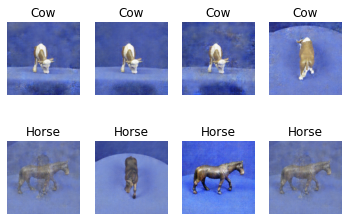

27501 [D loss: 0.077724, acc.: 98.44%] [G loss: 3.544600]
27502 [D loss: 0.067271, acc.: 98.44%] [G loss: 3.345928]
27503 [D loss: 0.119752, acc.: 96.88%] [G loss: 4.278862]
27504 [D loss: 0.127364, acc.: 96.88%] [G loss: 4.050130]
27505 [D loss: 0.129243, acc.: 96.88%] [G loss: 4.866135]
27506 [D loss: 0.069225, acc.: 96.88%] [G loss: 4.290202]
27507 [D loss: 0.083686, acc.: 98.44%] [G loss: 3.941497]
27508 [D loss: 0.074932, acc.: 96.88%] [G loss: 4.373478]
27509 [D loss: 0.024437, acc.: 100.00%] [G loss: 4.652146]
27510 [D loss: 0.060289, acc.: 98.44%] [G loss: 4.239746]
27511 [D loss: 0.008711, acc.: 100.00%] [G loss: 5.152980]
27512 [D loss: 0.094211, acc.: 98.44%] [G loss: 4.519164]
27513 [D loss: 0.061897, acc.: 98.44%] [G loss: 5.256576]
27514 [D loss: 0.148795, acc.: 95.31%] [G loss: 4.499319]
27515 [D loss: 0.099635, acc.: 96.88%] [G loss: 3.290929]
27516 [D loss: 0.137420, acc.: 96.88%] [G loss: 3.329708]
27517 [D loss: 0.115989, acc.: 96.88%] [G loss: 3.130971]
27518 [D los

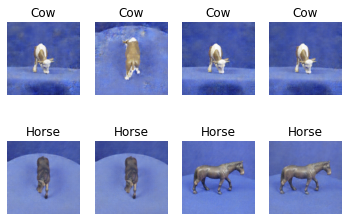

27601 [D loss: 0.127451, acc.: 96.88%] [G loss: 3.612779]
27602 [D loss: 0.140967, acc.: 96.88%] [G loss: 3.708769]
27603 [D loss: 0.104887, acc.: 96.88%] [G loss: 2.718662]
27604 [D loss: 0.028991, acc.: 100.00%] [G loss: 3.387817]
27605 [D loss: 0.164435, acc.: 96.88%] [G loss: 3.147218]
27606 [D loss: 0.064952, acc.: 98.44%] [G loss: 3.165703]
27607 [D loss: 0.115520, acc.: 96.88%] [G loss: 3.349701]
27608 [D loss: 0.033158, acc.: 100.00%] [G loss: 3.360060]
27609 [D loss: 0.220814, acc.: 93.75%] [G loss: 3.372941]
27610 [D loss: 0.069107, acc.: 98.44%] [G loss: 3.522330]
27611 [D loss: 0.119187, acc.: 96.88%] [G loss: 3.090965]
27612 [D loss: 0.160227, acc.: 95.31%] [G loss: 3.098396]
27613 [D loss: 0.133329, acc.: 95.31%] [G loss: 3.612798]
27614 [D loss: 0.096962, acc.: 96.88%] [G loss: 3.178530]
27615 [D loss: 0.038067, acc.: 100.00%] [G loss: 2.939145]
27616 [D loss: 0.177106, acc.: 92.19%] [G loss: 3.456336]
27617 [D loss: 0.033142, acc.: 100.00%] [G loss: 3.668889]
27618 [D l

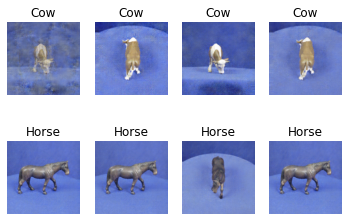

27701 [D loss: 0.089706, acc.: 96.88%] [G loss: 5.156850]
27702 [D loss: 0.113594, acc.: 96.88%] [G loss: 3.851918]
27703 [D loss: 0.174609, acc.: 93.75%] [G loss: 4.800537]
27704 [D loss: 0.090860, acc.: 96.88%] [G loss: 2.932759]
27705 [D loss: 0.125461, acc.: 95.31%] [G loss: 3.151721]
27706 [D loss: 0.066835, acc.: 98.44%] [G loss: 3.075210]
27707 [D loss: 0.077595, acc.: 96.88%] [G loss: 3.817120]
27708 [D loss: 0.023640, acc.: 100.00%] [G loss: 4.264964]
27709 [D loss: 0.009784, acc.: 100.00%] [G loss: 4.929029]
27710 [D loss: 0.046432, acc.: 98.44%] [G loss: 5.118447]
27711 [D loss: 0.050726, acc.: 98.44%] [G loss: 4.575829]
27712 [D loss: 0.125175, acc.: 96.88%] [G loss: 3.963864]
27713 [D loss: 0.066566, acc.: 98.44%] [G loss: 4.009956]
27714 [D loss: 0.126546, acc.: 96.88%] [G loss: 3.750359]
27715 [D loss: 0.019769, acc.: 100.00%] [G loss: 3.640165]
27716 [D loss: 0.167539, acc.: 95.31%] [G loss: 5.289788]
27717 [D loss: 0.108968, acc.: 96.88%] [G loss: 4.416778]
27718 [D lo

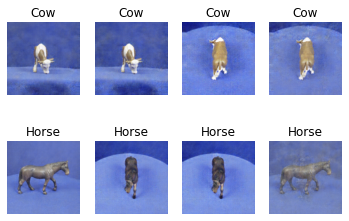

27801 [D loss: 0.211578, acc.: 93.75%] [G loss: 3.030702]
27802 [D loss: 0.096868, acc.: 96.88%] [G loss: 3.862746]
27803 [D loss: 0.010402, acc.: 100.00%] [G loss: 5.248628]
27804 [D loss: 0.101214, acc.: 96.88%] [G loss: 4.568605]
27805 [D loss: 0.122257, acc.: 95.31%] [G loss: 3.649506]
27806 [D loss: 0.069212, acc.: 98.44%] [G loss: 3.462393]
27807 [D loss: 0.096223, acc.: 96.88%] [G loss: 3.821687]
27808 [D loss: 0.060655, acc.: 98.44%] [G loss: 4.817435]
27809 [D loss: 0.118709, acc.: 96.88%] [G loss: 4.820943]
27810 [D loss: 0.022617, acc.: 100.00%] [G loss: 4.105692]
27811 [D loss: 0.135440, acc.: 95.31%] [G loss: 3.627128]
27812 [D loss: 0.166214, acc.: 93.75%] [G loss: 3.560360]
27813 [D loss: 0.064669, acc.: 98.44%] [G loss: 4.148471]
27814 [D loss: 0.080480, acc.: 98.44%] [G loss: 3.946017]
27815 [D loss: 0.022500, acc.: 100.00%] [G loss: 4.648721]
27816 [D loss: 0.156320, acc.: 95.31%] [G loss: 4.671737]
27817 [D loss: 0.227587, acc.: 93.75%] [G loss: 4.465116]
27818 [D lo

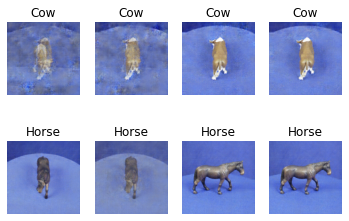

27901 [D loss: 0.180358, acc.: 95.31%] [G loss: 4.783921]
27902 [D loss: 0.051117, acc.: 98.44%] [G loss: 4.509732]
27903 [D loss: 0.055530, acc.: 98.44%] [G loss: 4.987354]
27904 [D loss: 0.135595, acc.: 96.88%] [G loss: 4.843509]
27905 [D loss: 0.073633, acc.: 96.88%] [G loss: 4.940377]
27906 [D loss: 0.075942, acc.: 96.88%] [G loss: 5.556788]
27907 [D loss: 0.196993, acc.: 93.75%] [G loss: 3.742789]
27908 [D loss: 0.068177, acc.: 98.44%] [G loss: 4.259018]
27909 [D loss: 0.076944, acc.: 98.44%] [G loss: 3.629281]
27910 [D loss: 0.055301, acc.: 98.44%] [G loss: 5.023862]
27911 [D loss: 0.068247, acc.: 98.44%] [G loss: 4.425622]
27912 [D loss: 0.160657, acc.: 95.31%] [G loss: 3.012427]
27913 [D loss: 0.053104, acc.: 98.44%] [G loss: 4.664823]
27914 [D loss: 0.050175, acc.: 98.44%] [G loss: 4.853173]
27915 [D loss: 0.069537, acc.: 98.44%] [G loss: 3.856632]
27916 [D loss: 0.107468, acc.: 96.88%] [G loss: 3.939787]
27917 [D loss: 0.069239, acc.: 98.44%] [G loss: 4.715416]
27918 [D loss:

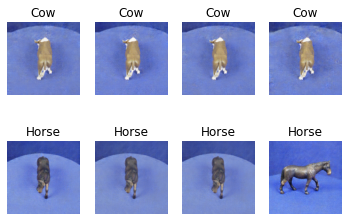

28001 [D loss: 0.113009, acc.: 96.88%] [G loss: 3.470157]
28002 [D loss: 0.113689, acc.: 96.88%] [G loss: 3.300611]
28003 [D loss: 0.084920, acc.: 98.44%] [G loss: 3.824357]
28004 [D loss: 0.066314, acc.: 98.44%] [G loss: 3.606584]
28005 [D loss: 0.056039, acc.: 98.44%] [G loss: 3.382592]
28006 [D loss: 0.097466, acc.: 96.88%] [G loss: 3.498679]
28007 [D loss: 0.076231, acc.: 98.44%] [G loss: 3.320483]
28008 [D loss: 0.067821, acc.: 98.44%] [G loss: 4.857756]
28009 [D loss: 0.056988, acc.: 98.44%] [G loss: 4.801348]
28010 [D loss: 0.265395, acc.: 92.19%] [G loss: 3.634562]
28011 [D loss: 0.112200, acc.: 96.88%] [G loss: 3.462169]
28012 [D loss: 0.170078, acc.: 95.31%] [G loss: 3.462906]
28013 [D loss: 0.090605, acc.: 96.88%] [G loss: 3.590165]
28014 [D loss: 0.169433, acc.: 95.31%] [G loss: 3.305664]
28015 [D loss: 0.079800, acc.: 98.44%] [G loss: 3.111127]
28016 [D loss: 0.116681, acc.: 96.88%] [G loss: 3.108449]
28017 [D loss: 0.066111, acc.: 98.44%] [G loss: 3.540288]
28018 [D loss:

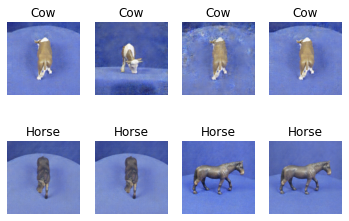

28101 [D loss: 0.032657, acc.: 100.00%] [G loss: 3.540651]
28102 [D loss: 0.025078, acc.: 100.00%] [G loss: 3.746726]
28103 [D loss: 0.114319, acc.: 96.88%] [G loss: 3.961369]
28104 [D loss: 0.231665, acc.: 93.75%] [G loss: 3.923040]
28105 [D loss: 0.028599, acc.: 100.00%] [G loss: 3.419882]
28106 [D loss: 0.073075, acc.: 98.44%] [G loss: 3.845762]
28107 [D loss: 0.045509, acc.: 98.44%] [G loss: 3.711851]
28108 [D loss: 0.033197, acc.: 100.00%] [G loss: 3.976449]
28109 [D loss: 0.082281, acc.: 98.44%] [G loss: 3.956277]
28110 [D loss: 0.221998, acc.: 93.75%] [G loss: 3.756166]
28111 [D loss: 0.127972, acc.: 96.88%] [G loss: 4.188813]
28112 [D loss: 0.224969, acc.: 93.75%] [G loss: 3.931183]
28113 [D loss: 0.219576, acc.: 92.19%] [G loss: 3.670986]
28114 [D loss: 0.075826, acc.: 98.44%] [G loss: 3.516298]
28115 [D loss: 0.044808, acc.: 100.00%] [G loss: 3.675856]
28116 [D loss: 0.128114, acc.: 95.31%] [G loss: 3.585091]
28117 [D loss: 0.188297, acc.: 93.75%] [G loss: 3.778649]
28118 [D 

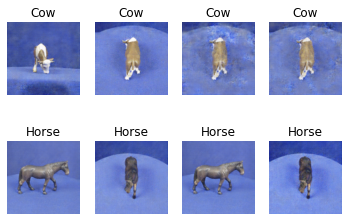

28201 [D loss: 0.179711, acc.: 95.31%] [G loss: 3.621594]
28202 [D loss: 0.178426, acc.: 95.31%] [G loss: 3.947322]
28203 [D loss: 0.124343, acc.: 96.88%] [G loss: 3.441179]
28204 [D loss: 0.041111, acc.: 100.00%] [G loss: 3.303190]
28205 [D loss: 0.034948, acc.: 100.00%] [G loss: 3.358865]
28206 [D loss: 0.162048, acc.: 95.31%] [G loss: 3.423656]
28207 [D loss: 0.059881, acc.: 98.44%] [G loss: 3.024022]
28208 [D loss: 0.072519, acc.: 98.44%] [G loss: 3.659315]
28209 [D loss: 0.098166, acc.: 96.88%] [G loss: 3.800364]
28210 [D loss: 0.125152, acc.: 96.88%] [G loss: 3.679797]
28211 [D loss: 0.061912, acc.: 98.44%] [G loss: 3.701018]
28212 [D loss: 0.078027, acc.: 98.44%] [G loss: 3.253881]
28213 [D loss: 0.194912, acc.: 95.31%] [G loss: 3.791000]
28214 [D loss: 0.021768, acc.: 100.00%] [G loss: 3.499071]
28215 [D loss: 0.108805, acc.: 96.88%] [G loss: 3.908493]
28216 [D loss: 0.216121, acc.: 95.31%] [G loss: 3.122105]
28217 [D loss: 0.161240, acc.: 95.31%] [G loss: 2.835011]
28218 [D lo

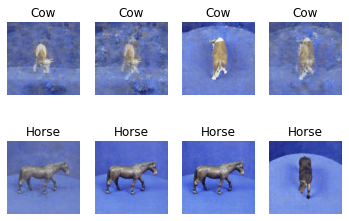

28301 [D loss: 0.168434, acc.: 93.75%] [G loss: 4.025532]
28302 [D loss: 0.039628, acc.: 98.44%] [G loss: 5.635316]
28303 [D loss: 0.045736, acc.: 98.44%] [G loss: 4.550685]
28304 [D loss: 0.181812, acc.: 93.75%] [G loss: 4.752288]
28305 [D loss: 0.060572, acc.: 98.44%] [G loss: 5.171223]
28306 [D loss: 0.051377, acc.: 98.44%] [G loss: 5.054731]
28307 [D loss: 0.101341, acc.: 96.88%] [G loss: 4.080428]
28308 [D loss: 0.016214, acc.: 100.00%] [G loss: 5.050855]
28309 [D loss: 0.052261, acc.: 98.44%] [G loss: 6.110142]
28310 [D loss: 0.129348, acc.: 96.88%] [G loss: 5.218511]
28311 [D loss: 0.094216, acc.: 96.88%] [G loss: 4.131012]
28312 [D loss: 0.039148, acc.: 100.00%] [G loss: 3.900257]
28313 [D loss: 0.116866, acc.: 96.88%] [G loss: 5.847864]
28314 [D loss: 0.090641, acc.: 96.88%] [G loss: 3.124067]
28315 [D loss: 0.159356, acc.: 96.88%] [G loss: 4.061865]
28316 [D loss: 0.020587, acc.: 100.00%] [G loss: 3.808364]
28317 [D loss: 0.061193, acc.: 98.44%] [G loss: 4.108763]
28318 [D lo

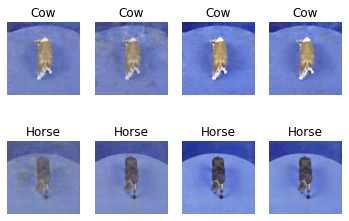

28401 [D loss: 0.078506, acc.: 98.44%] [G loss: 4.139589]
28402 [D loss: 0.068280, acc.: 98.44%] [G loss: 3.805265]
28403 [D loss: 0.090631, acc.: 96.88%] [G loss: 4.743179]
28404 [D loss: 0.149965, acc.: 95.31%] [G loss: 5.716943]
28405 [D loss: 0.074865, acc.: 98.44%] [G loss: 4.439838]
28406 [D loss: 0.053243, acc.: 98.44%] [G loss: 5.611735]
28407 [D loss: 0.102315, acc.: 96.88%] [G loss: 4.429075]
28408 [D loss: 0.163676, acc.: 96.88%] [G loss: 3.623291]
28409 [D loss: 0.060065, acc.: 98.44%] [G loss: 4.232389]
28410 [D loss: 0.077764, acc.: 98.44%] [G loss: 3.958046]
28411 [D loss: 0.084941, acc.: 98.44%] [G loss: 3.983861]
28412 [D loss: 0.151856, acc.: 95.31%] [G loss: 4.613120]
28413 [D loss: 0.027059, acc.: 100.00%] [G loss: 3.498966]
28414 [D loss: 0.026206, acc.: 100.00%] [G loss: 3.754691]
28415 [D loss: 0.118514, acc.: 96.88%] [G loss: 3.896501]
28416 [D loss: 0.019734, acc.: 100.00%] [G loss: 4.117475]
28417 [D loss: 0.172184, acc.: 96.88%] [G loss: 4.454665]
28418 [D lo

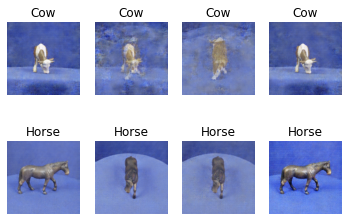

28501 [D loss: 0.009291, acc.: 100.00%] [G loss: 4.238037]
28502 [D loss: 0.230018, acc.: 92.19%] [G loss: 4.099442]
28503 [D loss: 0.041939, acc.: 100.00%] [G loss: 3.875323]
28504 [D loss: 0.029192, acc.: 100.00%] [G loss: 3.731550]
28505 [D loss: 0.015794, acc.: 100.00%] [G loss: 5.264047]
28506 [D loss: 0.125232, acc.: 96.88%] [G loss: 3.497064]
28507 [D loss: 0.010018, acc.: 100.00%] [G loss: 5.369547]
28508 [D loss: 0.009473, acc.: 100.00%] [G loss: 4.984559]
28509 [D loss: 0.066434, acc.: 98.44%] [G loss: 4.250671]
28510 [D loss: 0.047589, acc.: 98.44%] [G loss: 5.681827]
28511 [D loss: 0.022379, acc.: 100.00%] [G loss: 4.654452]
28512 [D loss: 0.013390, acc.: 100.00%] [G loss: 4.465317]
28513 [D loss: 0.085488, acc.: 98.44%] [G loss: 4.808120]
28514 [D loss: 0.017133, acc.: 100.00%] [G loss: 4.130889]
28515 [D loss: 0.114487, acc.: 96.88%] [G loss: 4.233132]
28516 [D loss: 0.166432, acc.: 95.31%] [G loss: 4.750039]
28517 [D loss: 0.043495, acc.: 98.44%] [G loss: 3.999973]
28518

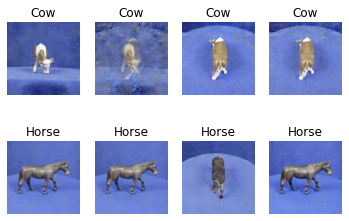

28601 [D loss: 0.053241, acc.: 98.44%] [G loss: 3.730743]
28602 [D loss: 0.029423, acc.: 100.00%] [G loss: 2.922894]
28603 [D loss: 0.187025, acc.: 93.75%] [G loss: 3.358773]
28604 [D loss: 0.151323, acc.: 95.31%] [G loss: 4.476002]
28605 [D loss: 0.061792, acc.: 98.44%] [G loss: 3.376720]
28606 [D loss: 0.115526, acc.: 96.88%] [G loss: 3.983009]
28607 [D loss: 0.063510, acc.: 98.44%] [G loss: 4.234447]
28608 [D loss: 0.132228, acc.: 96.88%] [G loss: 3.899992]
28609 [D loss: 0.203995, acc.: 93.75%] [G loss: 2.869163]
28610 [D loss: 0.060975, acc.: 98.44%] [G loss: 3.536420]
28611 [D loss: 0.074048, acc.: 98.44%] [G loss: 3.276280]
28612 [D loss: 0.056014, acc.: 98.44%] [G loss: 3.663146]
28613 [D loss: 0.148428, acc.: 95.31%] [G loss: 3.812279]
28614 [D loss: 0.071293, acc.: 98.44%] [G loss: 3.725754]
28615 [D loss: 0.130113, acc.: 96.88%] [G loss: 4.146810]
28616 [D loss: 0.015903, acc.: 100.00%] [G loss: 4.580418]
28617 [D loss: 0.098308, acc.: 96.88%] [G loss: 4.647820]
28618 [D los

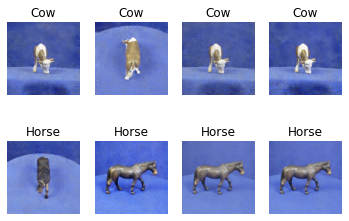

28701 [D loss: 0.063106, acc.: 98.44%] [G loss: 3.656892]
28702 [D loss: 0.045178, acc.: 98.44%] [G loss: 3.985982]
28703 [D loss: 0.014765, acc.: 100.00%] [G loss: 4.568328]
28704 [D loss: 0.060772, acc.: 98.44%] [G loss: 4.968139]
28705 [D loss: 0.229227, acc.: 93.75%] [G loss: 4.162044]
28706 [D loss: 0.019314, acc.: 100.00%] [G loss: 3.900545]
28707 [D loss: 0.101018, acc.: 96.88%] [G loss: 4.450841]
28708 [D loss: 0.100095, acc.: 96.88%] [G loss: 3.798579]
28709 [D loss: 0.175248, acc.: 95.31%] [G loss: 4.418566]
28710 [D loss: 0.088405, acc.: 98.44%] [G loss: 4.090594]
28711 [D loss: 0.163176, acc.: 95.31%] [G loss: 3.428632]
28712 [D loss: 0.061963, acc.: 98.44%] [G loss: 3.359708]
28713 [D loss: 0.020971, acc.: 100.00%] [G loss: 4.123993]
28714 [D loss: 0.054579, acc.: 98.44%] [G loss: 4.590151]
28715 [D loss: 0.020198, acc.: 100.00%] [G loss: 4.560682]
28716 [D loss: 0.045664, acc.: 98.44%] [G loss: 4.171078]
28717 [D loss: 0.066829, acc.: 98.44%] [G loss: 3.983731]
28718 [D l

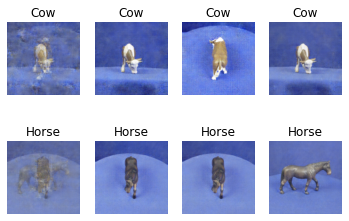

28801 [D loss: 0.085607, acc.: 98.44%] [G loss: 3.658039]
28802 [D loss: 0.024191, acc.: 100.00%] [G loss: 3.759167]
28803 [D loss: 0.111048, acc.: 96.88%] [G loss: 3.367522]
28804 [D loss: 0.099577, acc.: 96.88%] [G loss: 3.182210]
28805 [D loss: 0.028224, acc.: 100.00%] [G loss: 3.603573]
28806 [D loss: 0.152079, acc.: 95.31%] [G loss: 3.635802]
28807 [D loss: 0.029000, acc.: 100.00%] [G loss: 3.411363]
28808 [D loss: 0.016264, acc.: 100.00%] [G loss: 3.881334]
28809 [D loss: 0.115471, acc.: 96.88%] [G loss: 3.564543]
28810 [D loss: 0.248137, acc.: 93.75%] [G loss: 4.074830]
28811 [D loss: 0.178138, acc.: 95.31%] [G loss: 3.703762]
28812 [D loss: 0.133646, acc.: 95.31%] [G loss: 3.436944]
28813 [D loss: 0.082011, acc.: 98.44%] [G loss: 3.472547]
28814 [D loss: 0.112058, acc.: 96.88%] [G loss: 3.088534]
28815 [D loss: 0.110601, acc.: 96.88%] [G loss: 3.331953]
28816 [D loss: 0.032268, acc.: 100.00%] [G loss: 3.232474]
28817 [D loss: 0.114416, acc.: 96.88%] [G loss: 4.194437]
28818 [D 

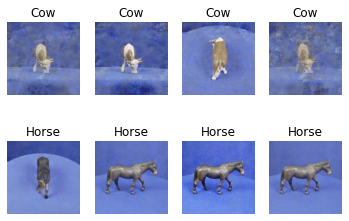

28901 [D loss: 0.069436, acc.: 98.44%] [G loss: 4.085416]
28902 [D loss: 0.123786, acc.: 96.88%] [G loss: 3.505851]
28903 [D loss: 0.174689, acc.: 93.75%] [G loss: 3.631351]
28904 [D loss: 0.092960, acc.: 96.88%] [G loss: 3.242400]
28905 [D loss: 0.013069, acc.: 100.00%] [G loss: 4.922369]
28906 [D loss: 0.215259, acc.: 93.75%] [G loss: 4.345162]
28907 [D loss: 0.088057, acc.: 98.44%] [G loss: 3.894411]
28908 [D loss: 0.192045, acc.: 93.75%] [G loss: 4.763954]
28909 [D loss: 0.060222, acc.: 98.44%] [G loss: 4.234645]
28910 [D loss: 0.024794, acc.: 100.00%] [G loss: 3.730268]
28911 [D loss: 0.107906, acc.: 96.88%] [G loss: 3.796979]
28912 [D loss: 0.123381, acc.: 96.88%] [G loss: 3.944544]
28913 [D loss: 0.022363, acc.: 100.00%] [G loss: 3.538884]
28914 [D loss: 0.082622, acc.: 96.88%] [G loss: 4.288608]
28915 [D loss: 0.089638, acc.: 96.88%] [G loss: 4.283199]
28916 [D loss: 0.066760, acc.: 98.44%] [G loss: 4.017407]
28917 [D loss: 0.023909, acc.: 100.00%] [G loss: 5.264947]
28918 [D l

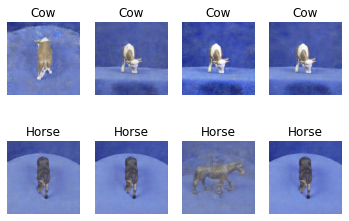

29001 [D loss: 0.076688, acc.: 98.44%] [G loss: 4.271901]
29002 [D loss: 0.067503, acc.: 98.44%] [G loss: 4.388397]
29003 [D loss: 0.160049, acc.: 95.31%] [G loss: 3.321195]
29004 [D loss: 0.065840, acc.: 98.44%] [G loss: 4.116338]
29005 [D loss: 0.030858, acc.: 100.00%] [G loss: 4.148380]
29006 [D loss: 0.122092, acc.: 96.88%] [G loss: 4.153111]
29007 [D loss: 0.131619, acc.: 96.88%] [G loss: 3.758753]
29008 [D loss: 0.090345, acc.: 96.88%] [G loss: 4.749655]
29009 [D loss: 0.120845, acc.: 96.88%] [G loss: 4.162732]
29010 [D loss: 0.146177, acc.: 95.31%] [G loss: 3.625478]
29011 [D loss: 0.125876, acc.: 95.31%] [G loss: 3.624630]
29012 [D loss: 0.166381, acc.: 93.75%] [G loss: 3.533075]
29013 [D loss: 0.087952, acc.: 98.44%] [G loss: 3.931366]
29014 [D loss: 0.074466, acc.: 96.88%] [G loss: 3.996300]
29015 [D loss: 0.135157, acc.: 95.31%] [G loss: 3.845631]
29016 [D loss: 0.117107, acc.: 95.31%] [G loss: 4.826461]
29017 [D loss: 0.047181, acc.: 98.44%] [G loss: 4.742638]
29018 [D loss

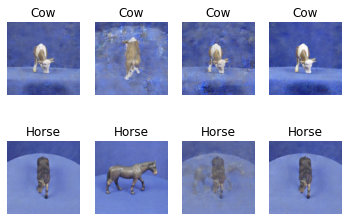

29101 [D loss: 0.240047, acc.: 92.19%] [G loss: 3.508799]
29102 [D loss: 0.079874, acc.: 98.44%] [G loss: 2.645422]
29103 [D loss: 0.141171, acc.: 95.31%] [G loss: 3.501077]
29104 [D loss: 0.175222, acc.: 93.75%] [G loss: 3.678516]
29105 [D loss: 0.059405, acc.: 98.44%] [G loss: 4.740245]
29106 [D loss: 0.083917, acc.: 98.44%] [G loss: 3.146554]
29107 [D loss: 0.020596, acc.: 100.00%] [G loss: 4.710230]
29108 [D loss: 0.032846, acc.: 100.00%] [G loss: 3.596604]
29109 [D loss: 0.253446, acc.: 92.19%] [G loss: 4.452088]
29110 [D loss: 0.108877, acc.: 96.88%] [G loss: 3.582887]
29111 [D loss: 0.096883, acc.: 96.88%] [G loss: 4.569279]
29112 [D loss: 0.088292, acc.: 98.44%] [G loss: 3.885559]
29113 [D loss: 0.127769, acc.: 95.31%] [G loss: 3.901531]
29114 [D loss: 0.067396, acc.: 98.44%] [G loss: 3.340132]
29115 [D loss: 0.056016, acc.: 98.44%] [G loss: 3.352531]
29116 [D loss: 0.029208, acc.: 100.00%] [G loss: 4.318062]
29117 [D loss: 0.185041, acc.: 93.75%] [G loss: 3.490071]
29118 [D lo

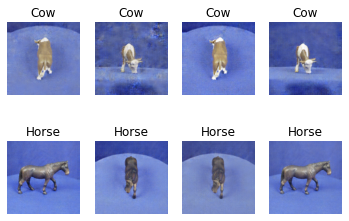

29201 [D loss: 0.161651, acc.: 95.31%] [G loss: 3.840608]
29202 [D loss: 0.056801, acc.: 98.44%] [G loss: 4.880217]
29203 [D loss: 0.139980, acc.: 95.31%] [G loss: 4.806480]
29204 [D loss: 0.135964, acc.: 95.31%] [G loss: 4.491631]
29205 [D loss: 0.020398, acc.: 100.00%] [G loss: 4.071455]
29206 [D loss: 0.151157, acc.: 93.75%] [G loss: 5.015349]
29207 [D loss: 0.074589, acc.: 96.88%] [G loss: 4.000626]
29208 [D loss: 0.062898, acc.: 98.44%] [G loss: 4.717377]
29209 [D loss: 0.036629, acc.: 100.00%] [G loss: 3.127674]
29210 [D loss: 0.181832, acc.: 93.75%] [G loss: 3.338749]
29211 [D loss: 0.163037, acc.: 93.75%] [G loss: 3.859049]
29212 [D loss: 0.085614, acc.: 96.88%] [G loss: 3.611351]
29213 [D loss: 0.139051, acc.: 95.31%] [G loss: 3.994917]
29214 [D loss: 0.101453, acc.: 95.31%] [G loss: 5.308885]
29215 [D loss: 0.071700, acc.: 96.88%] [G loss: 4.094134]
29216 [D loss: 0.173999, acc.: 93.75%] [G loss: 4.579867]
29217 [D loss: 0.020652, acc.: 100.00%] [G loss: 4.025753]
29218 [D lo

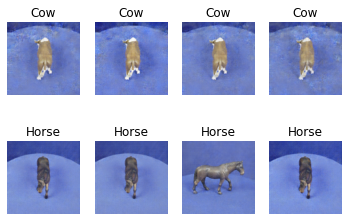

29301 [D loss: 0.198112, acc.: 95.31%] [G loss: 3.818154]
29302 [D loss: 0.096391, acc.: 96.88%] [G loss: 3.815979]
29303 [D loss: 0.117565, acc.: 96.88%] [G loss: 4.030801]
29304 [D loss: 0.057870, acc.: 98.44%] [G loss: 4.228166]
29305 [D loss: 0.014270, acc.: 100.00%] [G loss: 4.628969]
29306 [D loss: 0.070339, acc.: 98.44%] [G loss: 4.520388]
29307 [D loss: 0.178536, acc.: 95.31%] [G loss: 3.098001]
29308 [D loss: 0.137811, acc.: 96.88%] [G loss: 3.950907]
29309 [D loss: 0.188414, acc.: 93.75%] [G loss: 3.940874]
29310 [D loss: 0.063027, acc.: 98.44%] [G loss: 3.828266]
29311 [D loss: 0.100301, acc.: 96.88%] [G loss: 3.578002]
29312 [D loss: 0.126541, acc.: 96.88%] [G loss: 4.348867]
29313 [D loss: 0.141465, acc.: 95.31%] [G loss: 3.598491]
29314 [D loss: 0.083485, acc.: 98.44%] [G loss: 4.266666]
29315 [D loss: 0.106084, acc.: 96.88%] [G loss: 4.815192]
29316 [D loss: 0.091510, acc.: 96.88%] [G loss: 4.124535]
29317 [D loss: 0.053500, acc.: 98.44%] [G loss: 3.737263]
29318 [D loss

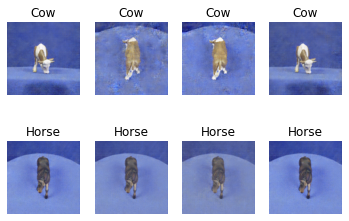

29401 [D loss: 0.061489, acc.: 98.44%] [G loss: 4.504075]
29402 [D loss: 0.046018, acc.: 98.44%] [G loss: 4.992952]
29403 [D loss: 0.018238, acc.: 100.00%] [G loss: 4.071850]
29404 [D loss: 0.017394, acc.: 100.00%] [G loss: 4.483800]
29405 [D loss: 0.008326, acc.: 100.00%] [G loss: 5.134743]
29406 [D loss: 0.048232, acc.: 98.44%] [G loss: 5.107155]
29407 [D loss: 0.096744, acc.: 96.88%] [G loss: 5.058804]
29408 [D loss: 0.169404, acc.: 95.31%] [G loss: 5.156193]
29409 [D loss: 0.061543, acc.: 98.44%] [G loss: 3.263200]
29410 [D loss: 0.031791, acc.: 100.00%] [G loss: 4.449448]
29411 [D loss: 0.117722, acc.: 96.88%] [G loss: 3.584414]
29412 [D loss: 0.076739, acc.: 98.44%] [G loss: 3.315917]
29413 [D loss: 0.056639, acc.: 98.44%] [G loss: 4.972147]
29414 [D loss: 0.011180, acc.: 100.00%] [G loss: 4.428904]
29415 [D loss: 0.068741, acc.: 98.44%] [G loss: 4.169442]
29416 [D loss: 0.048742, acc.: 98.44%] [G loss: 4.214162]
29417 [D loss: 0.011946, acc.: 100.00%] [G loss: 4.606493]
29418 [D

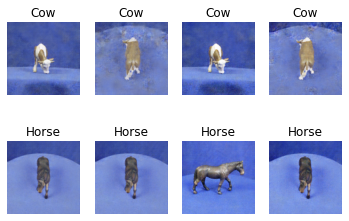

29501 [D loss: 0.130562, acc.: 96.88%] [G loss: 3.722498]
29502 [D loss: 0.014438, acc.: 100.00%] [G loss: 4.080571]
29503 [D loss: 0.169637, acc.: 95.31%] [G loss: 4.105355]
29504 [D loss: 0.104564, acc.: 96.88%] [G loss: 3.687750]
29505 [D loss: 0.062812, acc.: 98.44%] [G loss: 3.321479]
29506 [D loss: 0.082428, acc.: 98.44%] [G loss: 3.870810]
29507 [D loss: 0.105241, acc.: 96.88%] [G loss: 4.345377]
29508 [D loss: 0.072981, acc.: 98.44%] [G loss: 4.749146]
29509 [D loss: 0.054212, acc.: 98.44%] [G loss: 3.270253]
29510 [D loss: 0.114411, acc.: 96.88%] [G loss: 3.373844]
29511 [D loss: 0.061473, acc.: 98.44%] [G loss: 4.416407]
29512 [D loss: 0.059721, acc.: 98.44%] [G loss: 3.727782]
29513 [D loss: 0.220639, acc.: 95.31%] [G loss: 3.703350]
29514 [D loss: 0.015499, acc.: 100.00%] [G loss: 4.156006]
29515 [D loss: 0.120259, acc.: 96.88%] [G loss: 4.041163]
29516 [D loss: 0.134414, acc.: 96.88%] [G loss: 5.302264]
29517 [D loss: 0.095846, acc.: 96.88%] [G loss: 3.621671]
29518 [D los

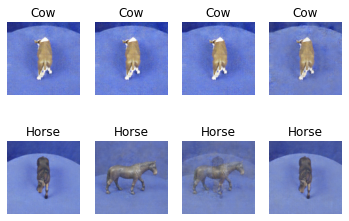

29601 [D loss: 0.074850, acc.: 98.44%] [G loss: 3.862606]
29602 [D loss: 0.054163, acc.: 98.44%] [G loss: 4.033709]
29603 [D loss: 0.021672, acc.: 100.00%] [G loss: 4.382347]
29604 [D loss: 0.056505, acc.: 98.44%] [G loss: 4.960474]
29605 [D loss: 0.080847, acc.: 98.44%] [G loss: 4.470482]
29606 [D loss: 0.279727, acc.: 92.19%] [G loss: 4.217042]
29607 [D loss: 0.089249, acc.: 96.88%] [G loss: 4.723503]
29608 [D loss: 0.025308, acc.: 100.00%] [G loss: 3.760573]
29609 [D loss: 0.015573, acc.: 100.00%] [G loss: 4.276081]
29610 [D loss: 0.042457, acc.: 98.44%] [G loss: 4.638388]
29611 [D loss: 0.053858, acc.: 98.44%] [G loss: 3.551467]
29612 [D loss: 0.137225, acc.: 95.31%] [G loss: 4.163782]
29613 [D loss: 0.102420, acc.: 96.88%] [G loss: 4.560258]
29614 [D loss: 0.133301, acc.: 95.31%] [G loss: 4.484232]
29615 [D loss: 0.089901, acc.: 96.88%] [G loss: 4.523429]
29616 [D loss: 0.072468, acc.: 96.88%] [G loss: 6.588191]
29617 [D loss: 0.023766, acc.: 100.00%] [G loss: 5.222390]
29618 [D l

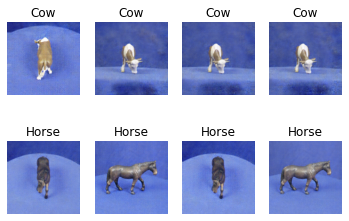

29701 [D loss: 0.137970, acc.: 95.31%] [G loss: 4.629693]
29702 [D loss: 0.095032, acc.: 96.88%] [G loss: 3.533196]
29703 [D loss: 0.018865, acc.: 100.00%] [G loss: 4.795250]
29704 [D loss: 0.061010, acc.: 98.44%] [G loss: 4.652015]
29705 [D loss: 0.089542, acc.: 96.88%] [G loss: 5.241282]
29706 [D loss: 0.140451, acc.: 95.31%] [G loss: 3.968572]
29707 [D loss: 0.131864, acc.: 96.88%] [G loss: 4.185423]
29708 [D loss: 0.171556, acc.: 93.75%] [G loss: 3.667156]
29709 [D loss: 0.060684, acc.: 98.44%] [G loss: 4.278257]
29710 [D loss: 0.106240, acc.: 96.88%] [G loss: 4.763958]
29711 [D loss: 0.052379, acc.: 98.44%] [G loss: 4.247396]
29712 [D loss: 0.097090, acc.: 96.88%] [G loss: 5.268470]
29713 [D loss: 0.235897, acc.: 93.75%] [G loss: 4.041211]
29714 [D loss: 0.053475, acc.: 98.44%] [G loss: 3.654417]
29715 [D loss: 0.062254, acc.: 98.44%] [G loss: 4.072612]
29716 [D loss: 0.023483, acc.: 100.00%] [G loss: 4.685455]
29717 [D loss: 0.114294, acc.: 96.88%] [G loss: 3.920013]
29718 [D los

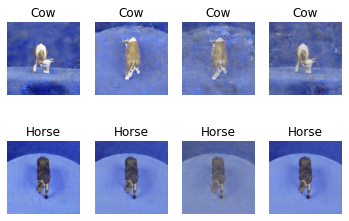

29801 [D loss: 0.033368, acc.: 100.00%] [G loss: 4.145541]
29802 [D loss: 0.191718, acc.: 95.31%] [G loss: 3.747732]
29803 [D loss: 0.125061, acc.: 96.88%] [G loss: 3.164188]
29804 [D loss: 0.191616, acc.: 95.31%] [G loss: 2.993250]
29805 [D loss: 0.073535, acc.: 98.44%] [G loss: 3.925604]
29806 [D loss: 0.032885, acc.: 100.00%] [G loss: 3.518819]
29807 [D loss: 0.061638, acc.: 98.44%] [G loss: 3.539141]
29808 [D loss: 0.093604, acc.: 96.88%] [G loss: 4.446693]
29809 [D loss: 0.138023, acc.: 95.31%] [G loss: 4.421034]
29810 [D loss: 0.147348, acc.: 96.88%] [G loss: 4.443161]
29811 [D loss: 0.121355, acc.: 95.31%] [G loss: 3.816939]
29812 [D loss: 0.047349, acc.: 100.00%] [G loss: 3.708048]
29813 [D loss: 0.057611, acc.: 98.44%] [G loss: 3.864993]
29814 [D loss: 0.105668, acc.: 96.88%] [G loss: 4.658310]
29815 [D loss: 0.124224, acc.: 96.88%] [G loss: 4.658913]
29816 [D loss: 0.163099, acc.: 95.31%] [G loss: 5.180813]
29817 [D loss: 0.031945, acc.: 100.00%] [G loss: 4.590642]
29818 [D l

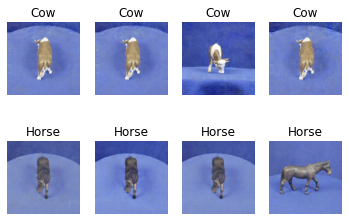

29901 [D loss: 0.027372, acc.: 100.00%] [G loss: 3.435090]
29902 [D loss: 0.014953, acc.: 100.00%] [G loss: 4.347030]
29903 [D loss: 0.123996, acc.: 96.88%] [G loss: 4.584192]
29904 [D loss: 0.013682, acc.: 100.00%] [G loss: 5.342798]
29905 [D loss: 0.005754, acc.: 100.00%] [G loss: 5.522037]
29906 [D loss: 0.086349, acc.: 98.44%] [G loss: 4.376322]
29907 [D loss: 0.147771, acc.: 95.31%] [G loss: 4.490590]
29908 [D loss: 0.047260, acc.: 98.44%] [G loss: 4.268473]
29909 [D loss: 0.019099, acc.: 100.00%] [G loss: 4.708261]
29910 [D loss: 0.030670, acc.: 98.44%] [G loss: 6.057814]
29911 [D loss: 0.172245, acc.: 93.75%] [G loss: 4.477381]
29912 [D loss: 0.133148, acc.: 96.88%] [G loss: 3.850348]
29913 [D loss: 0.066072, acc.: 98.44%] [G loss: 4.078638]
29914 [D loss: 0.046598, acc.: 98.44%] [G loss: 3.662361]
29915 [D loss: 0.143829, acc.: 96.88%] [G loss: 4.033325]
29916 [D loss: 0.100212, acc.: 96.88%] [G loss: 4.052721]
29917 [D loss: 0.121365, acc.: 96.88%] [G loss: 3.982902]
29918 [D 

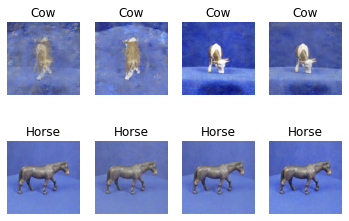

30001 [D loss: 0.150082, acc.: 95.31%] [G loss: 3.966384]
30002 [D loss: 0.062490, acc.: 98.44%] [G loss: 4.508927]
30003 [D loss: 0.029014, acc.: 100.00%] [G loss: 3.811118]
30004 [D loss: 0.013955, acc.: 100.00%] [G loss: 5.647889]
30005 [D loss: 0.048805, acc.: 98.44%] [G loss: 6.118498]
30006 [D loss: 0.142944, acc.: 95.31%] [G loss: 3.871095]
30007 [D loss: 0.062891, acc.: 98.44%] [G loss: 4.908471]
30008 [D loss: 0.114839, acc.: 96.88%] [G loss: 3.545704]
30009 [D loss: 0.102286, acc.: 96.88%] [G loss: 5.180655]
30010 [D loss: 0.019255, acc.: 100.00%] [G loss: 4.518273]
30011 [D loss: 0.163080, acc.: 95.31%] [G loss: 4.373584]
30012 [D loss: 0.103779, acc.: 96.88%] [G loss: 4.998291]
30013 [D loss: 0.060371, acc.: 98.44%] [G loss: 5.919720]
30014 [D loss: 0.140652, acc.: 95.31%] [G loss: 4.544981]
30015 [D loss: 0.047397, acc.: 98.44%] [G loss: 5.610885]
30016 [D loss: 0.158702, acc.: 95.31%] [G loss: 5.331290]
30017 [D loss: 0.093254, acc.: 96.88%] [G loss: 7.133181]
30018 [D lo

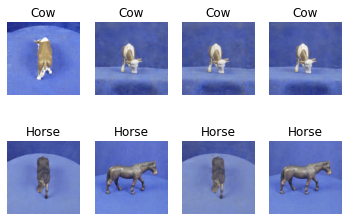

30101 [D loss: 0.065714, acc.: 98.44%] [G loss: 4.111282]
30102 [D loss: 0.098528, acc.: 98.44%] [G loss: 3.757570]
30103 [D loss: 0.038099, acc.: 98.44%] [G loss: 5.980968]
30104 [D loss: 0.009206, acc.: 100.00%] [G loss: 5.981849]
30105 [D loss: 0.009844, acc.: 100.00%] [G loss: 5.230544]
30106 [D loss: 0.157642, acc.: 95.31%] [G loss: 4.352014]
30107 [D loss: 0.195591, acc.: 93.75%] [G loss: 3.538601]
30108 [D loss: 0.071622, acc.: 96.88%] [G loss: 3.851878]
30109 [D loss: 0.099163, acc.: 96.88%] [G loss: 4.367506]
30110 [D loss: 0.108651, acc.: 96.88%] [G loss: 4.053074]
30111 [D loss: 0.209098, acc.: 93.75%] [G loss: 4.131903]
30112 [D loss: 0.057559, acc.: 98.44%] [G loss: 4.064149]
30113 [D loss: 0.119872, acc.: 96.88%] [G loss: 4.260315]
30114 [D loss: 0.139587, acc.: 95.31%] [G loss: 4.608779]
30115 [D loss: 0.124616, acc.: 95.31%] [G loss: 5.269601]
30116 [D loss: 0.090737, acc.: 96.88%] [G loss: 4.797150]
30117 [D loss: 0.018081, acc.: 100.00%] [G loss: 5.745322]
30118 [D lo

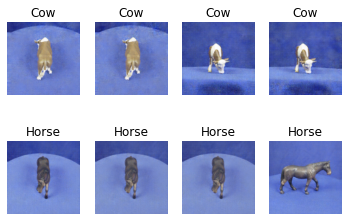

30201 [D loss: 0.028466, acc.: 100.00%] [G loss: 3.403222]
30202 [D loss: 0.052860, acc.: 98.44%] [G loss: 3.690594]
30203 [D loss: 0.077046, acc.: 98.44%] [G loss: 3.689496]
30204 [D loss: 0.151374, acc.: 95.31%] [G loss: 4.358445]
30205 [D loss: 0.098988, acc.: 96.88%] [G loss: 4.477268]
30206 [D loss: 0.072660, acc.: 98.44%] [G loss: 4.789441]
30207 [D loss: 0.070693, acc.: 98.44%] [G loss: 3.981717]
30208 [D loss: 0.019686, acc.: 100.00%] [G loss: 3.960594]
30209 [D loss: 0.130783, acc.: 98.44%] [G loss: 4.650081]
30210 [D loss: 0.015367, acc.: 100.00%] [G loss: 4.120589]
30211 [D loss: 0.058014, acc.: 98.44%] [G loss: 4.021867]
30212 [D loss: 0.181926, acc.: 95.31%] [G loss: 3.945519]
30213 [D loss: 0.170525, acc.: 95.31%] [G loss: 5.124410]
30214 [D loss: 0.122338, acc.: 96.88%] [G loss: 3.893538]
30215 [D loss: 0.059520, acc.: 98.44%] [G loss: 3.497885]
30216 [D loss: 0.127003, acc.: 95.31%] [G loss: 4.326022]
30217 [D loss: 0.133237, acc.: 95.31%] [G loss: 4.279525]
30218 [D lo

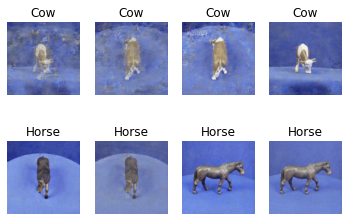

30301 [D loss: 0.183193, acc.: 95.31%] [G loss: 3.546606]
30302 [D loss: 0.022154, acc.: 100.00%] [G loss: 4.135573]
30303 [D loss: 0.165291, acc.: 95.31%] [G loss: 4.520805]
30304 [D loss: 0.017258, acc.: 100.00%] [G loss: 4.596798]
30305 [D loss: 0.122062, acc.: 98.44%] [G loss: 4.858859]
30306 [D loss: 0.066081, acc.: 98.44%] [G loss: 4.400023]
30307 [D loss: 0.059954, acc.: 98.44%] [G loss: 4.756988]
30308 [D loss: 0.115610, acc.: 96.88%] [G loss: 3.974434]
30309 [D loss: 0.104013, acc.: 96.88%] [G loss: 4.106142]
30310 [D loss: 0.068124, acc.: 98.44%] [G loss: 4.471850]
30311 [D loss: 0.056547, acc.: 98.44%] [G loss: 3.639356]
30312 [D loss: 0.051061, acc.: 98.44%] [G loss: 3.952665]
30313 [D loss: 0.121622, acc.: 96.88%] [G loss: 5.946962]
30314 [D loss: 0.154393, acc.: 95.31%] [G loss: 3.371798]
30315 [D loss: 0.133394, acc.: 93.75%] [G loss: 4.735413]
30316 [D loss: 0.093137, acc.: 96.88%] [G loss: 2.874612]
30317 [D loss: 0.140229, acc.: 95.31%] [G loss: 3.032231]
30318 [D los

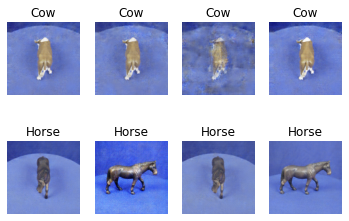

30401 [D loss: 0.093872, acc.: 96.88%] [G loss: 4.145682]
30402 [D loss: 0.066850, acc.: 98.44%] [G loss: 3.997452]
30403 [D loss: 0.103961, acc.: 96.88%] [G loss: 3.369080]
30404 [D loss: 0.022150, acc.: 100.00%] [G loss: 3.718185]
30405 [D loss: 0.067257, acc.: 98.44%] [G loss: 4.138863]
30406 [D loss: 0.024666, acc.: 100.00%] [G loss: 4.394702]
30407 [D loss: 0.020940, acc.: 100.00%] [G loss: 4.424333]
30408 [D loss: 0.065947, acc.: 98.44%] [G loss: 4.041724]
30409 [D loss: 0.085052, acc.: 98.44%] [G loss: 4.077918]
30410 [D loss: 0.059248, acc.: 98.44%] [G loss: 3.476309]
30411 [D loss: 0.110135, acc.: 96.88%] [G loss: 3.447392]
30412 [D loss: 0.015468, acc.: 100.00%] [G loss: 4.122233]
30413 [D loss: 0.173830, acc.: 95.31%] [G loss: 3.983021]
30414 [D loss: 0.068857, acc.: 98.44%] [G loss: 3.916416]
30415 [D loss: 0.118296, acc.: 96.88%] [G loss: 5.011877]
30416 [D loss: 0.124556, acc.: 95.31%] [G loss: 4.664557]
30417 [D loss: 0.167294, acc.: 95.31%] [G loss: 3.700257]
30418 [D l

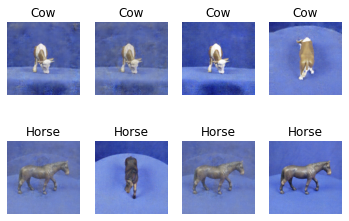

30501 [D loss: 0.015200, acc.: 100.00%] [G loss: 4.936543]
30502 [D loss: 0.088860, acc.: 98.44%] [G loss: 3.810538]
30503 [D loss: 0.100846, acc.: 96.88%] [G loss: 4.757135]
30504 [D loss: 0.105099, acc.: 96.88%] [G loss: 4.694311]
30505 [D loss: 0.113577, acc.: 96.88%] [G loss: 4.615669]
30506 [D loss: 0.078742, acc.: 98.44%] [G loss: 4.316615]
30507 [D loss: 0.160389, acc.: 95.31%] [G loss: 4.206126]
30508 [D loss: 0.062131, acc.: 98.44%] [G loss: 3.634223]
30509 [D loss: 0.032745, acc.: 100.00%] [G loss: 4.519871]
30510 [D loss: 0.053403, acc.: 98.44%] [G loss: 4.277102]
30511 [D loss: 0.059285, acc.: 98.44%] [G loss: 4.317844]
30512 [D loss: 0.055246, acc.: 98.44%] [G loss: 4.049962]
30513 [D loss: 0.157642, acc.: 95.31%] [G loss: 3.855051]
30514 [D loss: 0.028414, acc.: 100.00%] [G loss: 4.027888]
30515 [D loss: 0.027237, acc.: 100.00%] [G loss: 4.206491]
30516 [D loss: 0.276749, acc.: 93.75%] [G loss: 4.108949]
30517 [D loss: 0.148546, acc.: 96.88%] [G loss: 3.538626]
30518 [D l

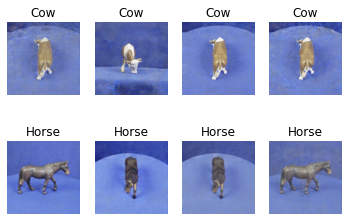

30601 [D loss: 0.015452, acc.: 100.00%] [G loss: 5.015661]
30602 [D loss: 0.117305, acc.: 96.88%] [G loss: 5.465798]
30603 [D loss: 0.189234, acc.: 93.75%] [G loss: 3.844980]
30604 [D loss: 0.079068, acc.: 98.44%] [G loss: 3.545389]
30605 [D loss: 0.031766, acc.: 100.00%] [G loss: 3.376869]
30606 [D loss: 0.115264, acc.: 96.88%] [G loss: 3.705056]
30607 [D loss: 0.023413, acc.: 100.00%] [G loss: 3.611306]
30608 [D loss: 0.126280, acc.: 96.88%] [G loss: 3.316378]
30609 [D loss: 0.022984, acc.: 100.00%] [G loss: 3.799960]
30610 [D loss: 0.016303, acc.: 100.00%] [G loss: 4.646582]
30611 [D loss: 0.179148, acc.: 93.75%] [G loss: 4.178487]
30612 [D loss: 0.112191, acc.: 96.88%] [G loss: 3.580238]
30613 [D loss: 0.093862, acc.: 96.88%] [G loss: 4.120935]
30614 [D loss: 0.146745, acc.: 95.31%] [G loss: 4.123163]
30615 [D loss: 0.105639, acc.: 96.88%] [G loss: 4.131460]
30616 [D loss: 0.055938, acc.: 98.44%] [G loss: 3.771413]
30617 [D loss: 0.141341, acc.: 96.88%] [G loss: 4.634893]
30618 [D 

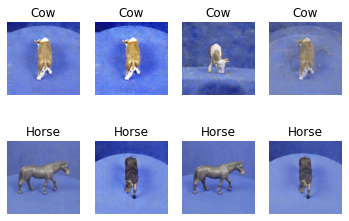

30701 [D loss: 0.022304, acc.: 100.00%] [G loss: 3.587006]
30702 [D loss: 0.053848, acc.: 98.44%] [G loss: 4.258133]
30703 [D loss: 0.149205, acc.: 96.88%] [G loss: 3.795692]
30704 [D loss: 0.094589, acc.: 96.88%] [G loss: 4.672287]
30705 [D loss: 0.128777, acc.: 95.31%] [G loss: 3.679570]
30706 [D loss: 0.017467, acc.: 100.00%] [G loss: 4.249590]
30707 [D loss: 0.190572, acc.: 95.31%] [G loss: 3.950578]
30708 [D loss: 0.065974, acc.: 98.44%] [G loss: 3.652961]
30709 [D loss: 0.119081, acc.: 96.88%] [G loss: 5.059494]
30710 [D loss: 0.094129, acc.: 96.88%] [G loss: 4.557997]
30711 [D loss: 0.024687, acc.: 100.00%] [G loss: 4.469172]
30712 [D loss: 0.087510, acc.: 96.88%] [G loss: 5.300241]
30713 [D loss: 0.317407, acc.: 93.75%] [G loss: 4.420333]
30714 [D loss: 0.117594, acc.: 96.88%] [G loss: 3.073144]
30715 [D loss: 0.108179, acc.: 98.44%] [G loss: 4.539795]
30716 [D loss: 0.134925, acc.: 96.88%] [G loss: 5.359239]
30717 [D loss: 0.037685, acc.: 100.00%] [G loss: 4.402384]
30718 [D l

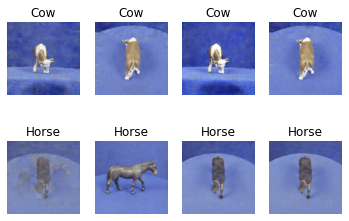

30801 [D loss: 0.089372, acc.: 98.44%] [G loss: 3.599297]
30802 [D loss: 0.069004, acc.: 98.44%] [G loss: 3.898898]
30803 [D loss: 0.293932, acc.: 92.19%] [G loss: 3.970477]
30804 [D loss: 0.070809, acc.: 98.44%] [G loss: 4.170131]
30805 [D loss: 0.136695, acc.: 95.31%] [G loss: 3.574338]
30806 [D loss: 0.083013, acc.: 98.44%] [G loss: 3.098284]
30807 [D loss: 0.105912, acc.: 96.88%] [G loss: 3.555645]
30808 [D loss: 0.024841, acc.: 100.00%] [G loss: 3.562127]
30809 [D loss: 0.100671, acc.: 96.88%] [G loss: 4.031393]
30810 [D loss: 0.215792, acc.: 93.75%] [G loss: 3.465796]
30811 [D loss: 0.191123, acc.: 95.31%] [G loss: 2.767843]
30812 [D loss: 0.111458, acc.: 96.88%] [G loss: 3.242404]
30813 [D loss: 0.057197, acc.: 98.44%] [G loss: 3.623727]
30814 [D loss: 0.076881, acc.: 98.44%] [G loss: 3.211314]
30815 [D loss: 0.122955, acc.: 96.88%] [G loss: 3.651871]
30816 [D loss: 0.106703, acc.: 96.88%] [G loss: 2.923303]
30817 [D loss: 0.100737, acc.: 98.44%] [G loss: 3.878419]
30818 [D loss

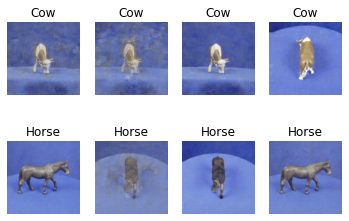

30901 [D loss: 0.113169, acc.: 96.88%] [G loss: 3.641097]
30902 [D loss: 0.106825, acc.: 96.88%] [G loss: 3.769830]
30903 [D loss: 0.062704, acc.: 98.44%] [G loss: 4.688811]
30904 [D loss: 0.021470, acc.: 100.00%] [G loss: 4.536385]
30905 [D loss: 0.082480, acc.: 98.44%] [G loss: 4.633869]
30906 [D loss: 0.054881, acc.: 98.44%] [G loss: 4.804087]
30907 [D loss: 0.008340, acc.: 100.00%] [G loss: 4.829405]
30908 [D loss: 0.120599, acc.: 96.88%] [G loss: 5.170535]
30909 [D loss: 0.158059, acc.: 95.31%] [G loss: 3.821889]
30910 [D loss: 0.033747, acc.: 100.00%] [G loss: 5.414340]
30911 [D loss: 0.042506, acc.: 98.44%] [G loss: 5.129635]
30912 [D loss: 0.108936, acc.: 96.88%] [G loss: 3.342221]
30913 [D loss: 0.063917, acc.: 98.44%] [G loss: 4.720143]
30914 [D loss: 0.008809, acc.: 100.00%] [G loss: 6.023518]
30915 [D loss: 0.192916, acc.: 93.75%] [G loss: 4.484783]
30916 [D loss: 0.088630, acc.: 96.88%] [G loss: 4.204505]
30917 [D loss: 0.025825, acc.: 100.00%] [G loss: 4.433345]
30918 [D 

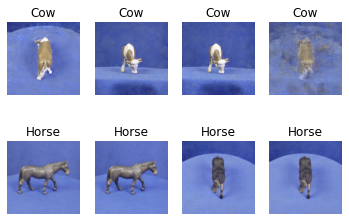

31001 [D loss: 0.060001, acc.: 98.44%] [G loss: 3.727037]
31002 [D loss: 0.060066, acc.: 98.44%] [G loss: 4.191251]
31003 [D loss: 0.093174, acc.: 98.44%] [G loss: 4.401435]
31004 [D loss: 0.163603, acc.: 96.88%] [G loss: 4.632856]
31005 [D loss: 0.026426, acc.: 100.00%] [G loss: 4.106872]
31006 [D loss: 0.052963, acc.: 98.44%] [G loss: 3.935133]
31007 [D loss: 0.088647, acc.: 98.44%] [G loss: 3.729020]
31008 [D loss: 0.109543, acc.: 96.88%] [G loss: 4.500352]
31009 [D loss: 0.067995, acc.: 98.44%] [G loss: 4.082645]
31010 [D loss: 0.102266, acc.: 96.88%] [G loss: 4.392954]
31011 [D loss: 0.058688, acc.: 98.44%] [G loss: 3.796792]
31012 [D loss: 0.123426, acc.: 96.88%] [G loss: 3.612201]
31013 [D loss: 0.106035, acc.: 96.88%] [G loss: 3.701358]
31014 [D loss: 0.026168, acc.: 100.00%] [G loss: 3.754690]
31015 [D loss: 0.091249, acc.: 96.88%] [G loss: 4.735024]
31016 [D loss: 0.057994, acc.: 98.44%] [G loss: 4.474594]
31017 [D loss: 0.018839, acc.: 100.00%] [G loss: 4.011825]
31018 [D lo

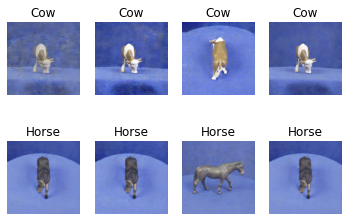

31101 [D loss: 0.024143, acc.: 100.00%] [G loss: 4.598498]
31102 [D loss: 0.146727, acc.: 95.31%] [G loss: 4.945688]
31103 [D loss: 0.009065, acc.: 100.00%] [G loss: 5.520863]
31104 [D loss: 0.192193, acc.: 93.75%] [G loss: 4.024158]
31105 [D loss: 0.063698, acc.: 98.44%] [G loss: 3.391151]
31106 [D loss: 0.023305, acc.: 100.00%] [G loss: 3.526171]
31107 [D loss: 0.079950, acc.: 98.44%] [G loss: 3.347622]
31108 [D loss: 0.105151, acc.: 96.88%] [G loss: 3.489718]
31109 [D loss: 0.087180, acc.: 98.44%] [G loss: 4.160214]
31110 [D loss: 0.062122, acc.: 98.44%] [G loss: 3.892668]
31111 [D loss: 0.014111, acc.: 100.00%] [G loss: 3.808777]
31112 [D loss: 0.013481, acc.: 100.00%] [G loss: 4.791043]
31113 [D loss: 0.150095, acc.: 96.88%] [G loss: 4.127234]
31114 [D loss: 0.060389, acc.: 98.44%] [G loss: 4.910812]
31115 [D loss: 0.196013, acc.: 93.75%] [G loss: 4.670207]
31116 [D loss: 0.014796, acc.: 100.00%] [G loss: 4.646625]
31117 [D loss: 0.020099, acc.: 100.00%] [G loss: 4.070366]
31118 [

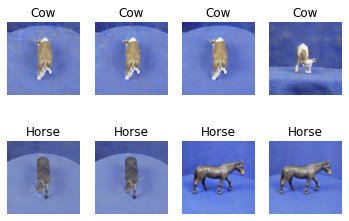

31201 [D loss: 0.077020, acc.: 96.88%] [G loss: 4.898024]
31202 [D loss: 0.030776, acc.: 98.44%] [G loss: 6.366991]
31203 [D loss: 0.045991, acc.: 98.44%] [G loss: 4.375828]
31204 [D loss: 0.184961, acc.: 95.31%] [G loss: 4.697979]
31205 [D loss: 0.049296, acc.: 98.44%] [G loss: 5.001015]
31206 [D loss: 0.009448, acc.: 100.00%] [G loss: 6.355479]
31207 [D loss: 0.045600, acc.: 98.44%] [G loss: 5.620859]
31208 [D loss: 0.054585, acc.: 98.44%] [G loss: 7.396816]
31209 [D loss: 0.016759, acc.: 98.44%] [G loss: 7.568654]
31210 [D loss: 0.171822, acc.: 96.88%] [G loss: 6.256785]
31211 [D loss: 0.012550, acc.: 100.00%] [G loss: 6.158518]
31212 [D loss: 0.025018, acc.: 100.00%] [G loss: 4.783557]
31213 [D loss: 0.187446, acc.: 93.75%] [G loss: 5.133118]
31214 [D loss: 0.091822, acc.: 98.44%] [G loss: 4.363235]
31215 [D loss: 0.065093, acc.: 98.44%] [G loss: 4.050298]
31216 [D loss: 0.084821, acc.: 98.44%] [G loss: 5.081622]
31217 [D loss: 0.018875, acc.: 100.00%] [G loss: 5.068161]
31218 [D l

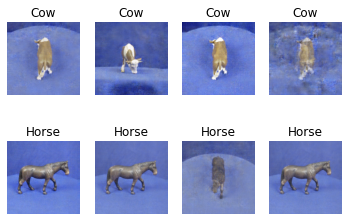

31301 [D loss: 0.129403, acc.: 95.31%] [G loss: 4.364395]
31302 [D loss: 0.035019, acc.: 98.44%] [G loss: 6.033339]
31303 [D loss: 0.093084, acc.: 96.88%] [G loss: 3.936509]
31304 [D loss: 0.174524, acc.: 93.75%] [G loss: 4.226135]
31305 [D loss: 0.176653, acc.: 93.75%] [G loss: 4.439007]
31306 [D loss: 0.114261, acc.: 98.44%] [G loss: 4.910796]
31307 [D loss: 0.019061, acc.: 100.00%] [G loss: 5.855534]
31308 [D loss: 0.029480, acc.: 100.00%] [G loss: 4.230677]
31309 [D loss: 0.121597, acc.: 96.88%] [G loss: 3.341136]
31310 [D loss: 0.060842, acc.: 98.44%] [G loss: 3.964564]
31311 [D loss: 0.104813, acc.: 96.88%] [G loss: 4.674746]
31312 [D loss: 0.065453, acc.: 98.44%] [G loss: 4.572638]
31313 [D loss: 0.055075, acc.: 98.44%] [G loss: 4.075221]
31314 [D loss: 0.161236, acc.: 93.75%] [G loss: 4.471012]
31315 [D loss: 0.030511, acc.: 100.00%] [G loss: 3.774346]
31316 [D loss: 0.068826, acc.: 98.44%] [G loss: 3.799184]
31317 [D loss: 0.188219, acc.: 95.31%] [G loss: 3.926217]
31318 [D lo

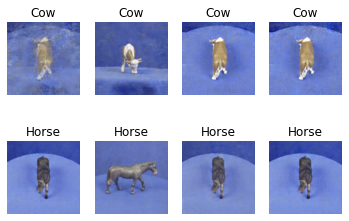

31401 [D loss: 0.102713, acc.: 96.88%] [G loss: 3.215276]
31402 [D loss: 0.105884, acc.: 96.88%] [G loss: 3.721096]
31403 [D loss: 0.111687, acc.: 96.88%] [G loss: 3.440432]
31404 [D loss: 0.076406, acc.: 98.44%] [G loss: 3.738300]
31405 [D loss: 0.162114, acc.: 95.31%] [G loss: 3.250656]
31406 [D loss: 0.137104, acc.: 95.31%] [G loss: 4.245274]
31407 [D loss: 0.030296, acc.: 100.00%] [G loss: 4.111460]
31408 [D loss: 0.109430, acc.: 96.88%] [G loss: 3.759280]
31409 [D loss: 0.063791, acc.: 98.44%] [G loss: 5.071179]
31410 [D loss: 0.085726, acc.: 98.44%] [G loss: 4.021426]
31411 [D loss: 0.107015, acc.: 96.88%] [G loss: 4.281699]
31412 [D loss: 0.081714, acc.: 98.44%] [G loss: 4.106203]
31413 [D loss: 0.049719, acc.: 98.44%] [G loss: 5.640374]
31414 [D loss: 0.112261, acc.: 96.88%] [G loss: 3.820308]
31415 [D loss: 0.123625, acc.: 96.88%] [G loss: 4.894225]
31416 [D loss: 0.060124, acc.: 98.44%] [G loss: 3.981746]
31417 [D loss: 0.056478, acc.: 98.44%] [G loss: 5.658995]
31418 [D loss

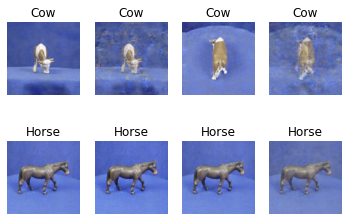

31501 [D loss: 0.068331, acc.: 98.44%] [G loss: 4.479506]
31502 [D loss: 0.065987, acc.: 98.44%] [G loss: 3.971274]
31503 [D loss: 0.129257, acc.: 95.31%] [G loss: 4.192410]
31504 [D loss: 0.030918, acc.: 100.00%] [G loss: 3.384801]
31505 [D loss: 0.106181, acc.: 96.88%] [G loss: 4.117143]
31506 [D loss: 0.054518, acc.: 98.44%] [G loss: 3.739255]
31507 [D loss: 0.023738, acc.: 100.00%] [G loss: 4.705919]
31508 [D loss: 0.145776, acc.: 95.31%] [G loss: 7.051538]
31509 [D loss: 0.069255, acc.: 98.44%] [G loss: 4.953985]
31510 [D loss: 0.023016, acc.: 100.00%] [G loss: 4.712092]
31511 [D loss: 0.013757, acc.: 100.00%] [G loss: 4.623561]
31512 [D loss: 0.039839, acc.: 98.44%] [G loss: 4.808350]
31513 [D loss: 0.193533, acc.: 93.75%] [G loss: 4.905975]
31514 [D loss: 0.158233, acc.: 95.31%] [G loss: 3.675500]
31515 [D loss: 0.116564, acc.: 96.88%] [G loss: 3.086603]
31516 [D loss: 0.182830, acc.: 95.31%] [G loss: 3.443010]
31517 [D loss: 0.149487, acc.: 96.88%] [G loss: 3.707669]
31518 [D l

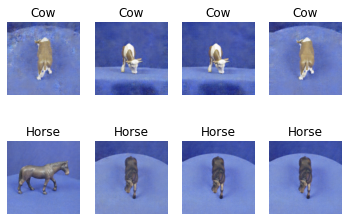

31601 [D loss: 0.022664, acc.: 100.00%] [G loss: 3.896798]
31602 [D loss: 0.091366, acc.: 96.88%] [G loss: 4.180830]
31603 [D loss: 0.100347, acc.: 96.88%] [G loss: 3.559777]
31604 [D loss: 0.060062, acc.: 98.44%] [G loss: 4.974485]
31605 [D loss: 0.007027, acc.: 100.00%] [G loss: 6.424648]
31606 [D loss: 0.089407, acc.: 98.44%] [G loss: 4.698372]
31607 [D loss: 0.175629, acc.: 95.31%] [G loss: 4.817170]
31608 [D loss: 0.152787, acc.: 95.31%] [G loss: 3.000624]
31609 [D loss: 0.141140, acc.: 95.31%] [G loss: 4.942629]
31610 [D loss: 0.147782, acc.: 95.31%] [G loss: 3.564150]
31611 [D loss: 0.026398, acc.: 100.00%] [G loss: 4.160431]
31612 [D loss: 0.080350, acc.: 98.44%] [G loss: 4.422775]
31613 [D loss: 0.136632, acc.: 95.31%] [G loss: 4.340545]
31614 [D loss: 0.135039, acc.: 95.31%] [G loss: 4.137757]
31615 [D loss: 0.050510, acc.: 98.44%] [G loss: 4.283409]
31616 [D loss: 0.095902, acc.: 96.88%] [G loss: 3.781853]
31617 [D loss: 0.052092, acc.: 98.44%] [G loss: 4.929046]
31618 [D lo

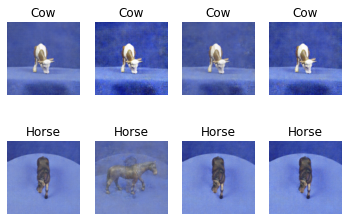

31701 [D loss: 0.052940, acc.: 98.44%] [G loss: 4.267813]
31702 [D loss: 0.056782, acc.: 98.44%] [G loss: 4.169306]
31703 [D loss: 0.029822, acc.: 100.00%] [G loss: 3.351196]
31704 [D loss: 0.017355, acc.: 100.00%] [G loss: 4.025213]
31705 [D loss: 0.013723, acc.: 100.00%] [G loss: 4.881301]
31706 [D loss: 0.016748, acc.: 100.00%] [G loss: 4.246778]
31707 [D loss: 0.090287, acc.: 96.88%] [G loss: 3.967385]
31708 [D loss: 0.013878, acc.: 100.00%] [G loss: 4.932690]
31709 [D loss: 0.070931, acc.: 98.44%] [G loss: 4.135018]
31710 [D loss: 0.057699, acc.: 98.44%] [G loss: 4.780885]
31711 [D loss: 0.053406, acc.: 98.44%] [G loss: 5.253987]
31712 [D loss: 0.049329, acc.: 98.44%] [G loss: 4.974753]
31713 [D loss: 0.130016, acc.: 96.88%] [G loss: 4.504158]
31714 [D loss: 0.067373, acc.: 98.44%] [G loss: 4.541945]
31715 [D loss: 0.100722, acc.: 96.88%] [G loss: 4.625288]
31716 [D loss: 0.052799, acc.: 98.44%] [G loss: 5.281871]
31717 [D loss: 0.174977, acc.: 93.75%] [G loss: 4.922279]
31718 [D 

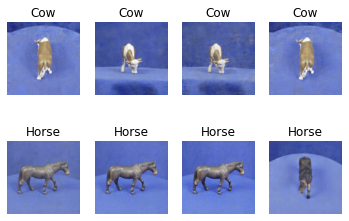

31801 [D loss: 0.019895, acc.: 100.00%] [G loss: 4.873977]
31802 [D loss: 0.018853, acc.: 100.00%] [G loss: 3.647727]
31803 [D loss: 0.120441, acc.: 96.88%] [G loss: 3.540925]
31804 [D loss: 0.057535, acc.: 98.44%] [G loss: 4.271069]
31805 [D loss: 0.077284, acc.: 98.44%] [G loss: 3.837985]
31806 [D loss: 0.066196, acc.: 98.44%] [G loss: 4.324600]
31807 [D loss: 0.108167, acc.: 96.88%] [G loss: 4.684425]
31808 [D loss: 0.058577, acc.: 98.44%] [G loss: 4.481281]
31809 [D loss: 0.210357, acc.: 95.31%] [G loss: 4.030387]
31810 [D loss: 0.021131, acc.: 100.00%] [G loss: 5.023971]
31811 [D loss: 0.014077, acc.: 100.00%] [G loss: 5.290715]
31812 [D loss: 0.076877, acc.: 98.44%] [G loss: 4.838070]
31813 [D loss: 0.080120, acc.: 96.88%] [G loss: 4.802493]
31814 [D loss: 0.067992, acc.: 98.44%] [G loss: 3.437761]
31815 [D loss: 0.117984, acc.: 96.88%] [G loss: 6.549231]
31816 [D loss: 0.104284, acc.: 98.44%] [G loss: 5.104901]
31817 [D loss: 0.011156, acc.: 100.00%] [G loss: 5.188341]
31818 [D 

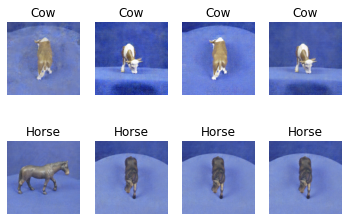

31901 [D loss: 0.080654, acc.: 98.44%] [G loss: 3.694124]
31902 [D loss: 0.151167, acc.: 95.31%] [G loss: 4.810535]
31903 [D loss: 0.113151, acc.: 96.88%] [G loss: 6.416377]
31904 [D loss: 0.073389, acc.: 98.44%] [G loss: 4.432022]
31905 [D loss: 0.074562, acc.: 98.44%] [G loss: 3.466939]
31906 [D loss: 0.163908, acc.: 93.75%] [G loss: 3.639746]
31907 [D loss: 0.062188, acc.: 98.44%] [G loss: 4.435451]
31908 [D loss: 0.083989, acc.: 98.44%] [G loss: 3.772699]
31909 [D loss: 0.090281, acc.: 96.88%] [G loss: 3.787060]
31910 [D loss: 0.143880, acc.: 95.31%] [G loss: 3.548861]
31911 [D loss: 0.113762, acc.: 96.88%] [G loss: 3.029544]
31912 [D loss: 0.128282, acc.: 96.88%] [G loss: 4.050992]
31913 [D loss: 0.025472, acc.: 100.00%] [G loss: 3.637244]
31914 [D loss: 0.067357, acc.: 98.44%] [G loss: 3.141613]
31915 [D loss: 0.150778, acc.: 95.31%] [G loss: 3.569566]
31916 [D loss: 0.091032, acc.: 96.88%] [G loss: 3.811125]
31917 [D loss: 0.036102, acc.: 100.00%] [G loss: 2.983048]
31918 [D los

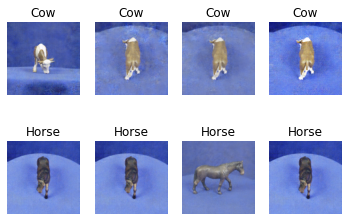

32001 [D loss: 0.148302, acc.: 95.31%] [G loss: 2.670419]
32002 [D loss: 0.108314, acc.: 96.88%] [G loss: 4.344066]
32003 [D loss: 0.141847, acc.: 95.31%] [G loss: 3.442600]
32004 [D loss: 0.064261, acc.: 98.44%] [G loss: 3.801357]
32005 [D loss: 0.091587, acc.: 96.88%] [G loss: 3.715069]
32006 [D loss: 0.030265, acc.: 100.00%] [G loss: 3.784666]
32007 [D loss: 0.107645, acc.: 95.31%] [G loss: 3.282818]
32008 [D loss: 0.096037, acc.: 96.88%] [G loss: 3.869588]
32009 [D loss: 0.107176, acc.: 96.88%] [G loss: 3.040474]
32010 [D loss: 0.061809, acc.: 98.44%] [G loss: 3.252048]
32011 [D loss: 0.032034, acc.: 100.00%] [G loss: 3.240377]
32012 [D loss: 0.080889, acc.: 96.88%] [G loss: 4.112328]
32013 [D loss: 0.018942, acc.: 100.00%] [G loss: 4.492047]
32014 [D loss: 0.185180, acc.: 95.31%] [G loss: 3.819651]
32015 [D loss: 0.096814, acc.: 96.88%] [G loss: 3.279287]
32016 [D loss: 0.119463, acc.: 96.88%] [G loss: 3.718276]
32017 [D loss: 0.034521, acc.: 100.00%] [G loss: 4.576985]
32018 [D l

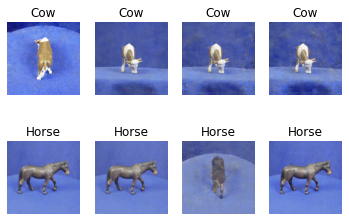

32101 [D loss: 0.103373, acc.: 96.88%] [G loss: 4.152732]
32102 [D loss: 0.124237, acc.: 95.31%] [G loss: 3.552435]
32103 [D loss: 0.058557, acc.: 98.44%] [G loss: 4.127729]
32104 [D loss: 0.065060, acc.: 98.44%] [G loss: 4.201777]
32105 [D loss: 0.022259, acc.: 100.00%] [G loss: 3.577704]
32106 [D loss: 0.012279, acc.: 100.00%] [G loss: 4.594979]
32107 [D loss: 0.040154, acc.: 98.44%] [G loss: 6.205235]
32108 [D loss: 0.127156, acc.: 95.31%] [G loss: 4.273326]
32109 [D loss: 0.083780, acc.: 96.88%] [G loss: 5.988991]
32110 [D loss: 0.178307, acc.: 95.31%] [G loss: 4.874914]
32111 [D loss: 0.019335, acc.: 100.00%] [G loss: 4.951116]
32112 [D loss: 0.080142, acc.: 98.44%] [G loss: 4.891676]
32113 [D loss: 0.145612, acc.: 96.88%] [G loss: 4.242086]
32114 [D loss: 0.069587, acc.: 98.44%] [G loss: 6.327835]
32115 [D loss: 0.091261, acc.: 96.88%] [G loss: 6.012306]
32116 [D loss: 0.049217, acc.: 98.44%] [G loss: 4.301743]
32117 [D loss: 0.043222, acc.: 98.44%] [G loss: 4.825950]
32118 [D lo

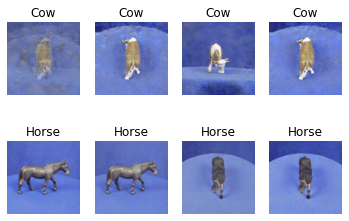

32201 [D loss: 0.052554, acc.: 98.44%] [G loss: 4.857590]
32202 [D loss: 0.065959, acc.: 98.44%] [G loss: 4.398957]
32203 [D loss: 0.103890, acc.: 96.88%] [G loss: 5.038977]
32204 [D loss: 0.134589, acc.: 95.31%] [G loss: 6.093664]
32205 [D loss: 0.016968, acc.: 100.00%] [G loss: 4.665170]
32206 [D loss: 0.015974, acc.: 100.00%] [G loss: 5.154716]
32207 [D loss: 0.010431, acc.: 100.00%] [G loss: 4.954508]
32208 [D loss: 0.213697, acc.: 95.31%] [G loss: 3.946986]
32209 [D loss: 0.027376, acc.: 100.00%] [G loss: 3.234365]
32210 [D loss: 0.114103, acc.: 96.88%] [G loss: 3.729837]
32211 [D loss: 0.248321, acc.: 92.19%] [G loss: 3.610716]
32212 [D loss: 0.023733, acc.: 100.00%] [G loss: 4.048146]
32213 [D loss: 0.026653, acc.: 100.00%] [G loss: 3.835804]
32214 [D loss: 0.102938, acc.: 96.88%] [G loss: 4.240860]
32215 [D loss: 0.175037, acc.: 95.31%] [G loss: 5.082211]
32216 [D loss: 0.219838, acc.: 93.75%] [G loss: 4.149985]
32217 [D loss: 0.089664, acc.: 96.88%] [G loss: 5.106734]
32218 [D

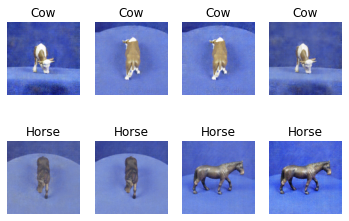

32301 [D loss: 0.111847, acc.: 96.88%] [G loss: 4.190010]
32302 [D loss: 0.105219, acc.: 96.88%] [G loss: 3.888090]
32303 [D loss: 0.054599, acc.: 98.44%] [G loss: 4.032158]
32304 [D loss: 0.081932, acc.: 98.44%] [G loss: 3.825034]
32305 [D loss: 0.067040, acc.: 98.44%] [G loss: 3.798433]
32306 [D loss: 0.057123, acc.: 98.44%] [G loss: 5.181105]
32307 [D loss: 0.094455, acc.: 96.88%] [G loss: 4.520406]
32308 [D loss: 0.141191, acc.: 96.88%] [G loss: 3.995598]
32309 [D loss: 0.086794, acc.: 96.88%] [G loss: 4.145376]
32310 [D loss: 0.030625, acc.: 100.00%] [G loss: 3.682081]
32311 [D loss: 0.020916, acc.: 100.00%] [G loss: 3.951768]
32312 [D loss: 0.165712, acc.: 95.31%] [G loss: 5.400944]
32313 [D loss: 0.121298, acc.: 96.88%] [G loss: 4.561025]
32314 [D loss: 0.099725, acc.: 96.88%] [G loss: 3.729952]
32315 [D loss: 0.023637, acc.: 100.00%] [G loss: 3.842903]
32316 [D loss: 0.168590, acc.: 95.31%] [G loss: 4.218294]
32317 [D loss: 0.028757, acc.: 100.00%] [G loss: 3.938574]
32318 [D l

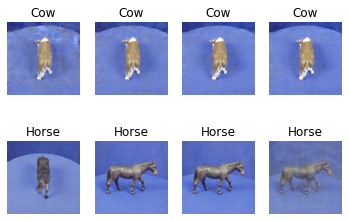

32401 [D loss: 0.132447, acc.: 96.88%] [G loss: 3.715343]
32402 [D loss: 0.115919, acc.: 96.88%] [G loss: 5.676223]
32403 [D loss: 0.073520, acc.: 96.88%] [G loss: 5.400818]
32404 [D loss: 0.128357, acc.: 96.88%] [G loss: 2.986034]
32405 [D loss: 0.134372, acc.: 95.31%] [G loss: 3.665843]
32406 [D loss: 0.078640, acc.: 96.88%] [G loss: 4.294574]
32407 [D loss: 0.138664, acc.: 95.31%] [G loss: 3.655107]
32408 [D loss: 0.035939, acc.: 100.00%] [G loss: 3.279458]
32409 [D loss: 0.126166, acc.: 95.31%] [G loss: 4.260614]
32410 [D loss: 0.130697, acc.: 96.88%] [G loss: 4.476763]
32411 [D loss: 0.119599, acc.: 96.88%] [G loss: 4.394063]
32412 [D loss: 0.117481, acc.: 96.88%] [G loss: 4.682833]
32413 [D loss: 0.104326, acc.: 98.44%] [G loss: 4.189492]
32414 [D loss: 0.143324, acc.: 96.88%] [G loss: 4.344625]
32415 [D loss: 0.054659, acc.: 98.44%] [G loss: 4.029712]
32416 [D loss: 0.127203, acc.: 96.88%] [G loss: 3.866540]
32417 [D loss: 0.157888, acc.: 95.31%] [G loss: 3.203814]
32418 [D loss

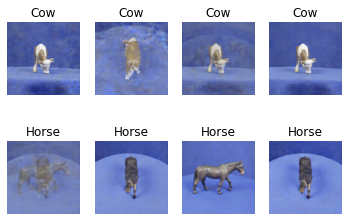

32501 [D loss: 0.091890, acc.: 96.88%] [G loss: 3.996273]
32502 [D loss: 0.083121, acc.: 98.44%] [G loss: 3.527836]
32503 [D loss: 0.064006, acc.: 98.44%] [G loss: 3.875055]
32504 [D loss: 0.135280, acc.: 95.31%] [G loss: 4.145698]
32505 [D loss: 0.084479, acc.: 98.44%] [G loss: 3.548786]
32506 [D loss: 0.079769, acc.: 96.88%] [G loss: 4.949306]
32507 [D loss: 0.194400, acc.: 92.19%] [G loss: 7.506831]
32508 [D loss: 0.065364, acc.: 98.44%] [G loss: 3.568628]
32509 [D loss: 0.091742, acc.: 96.88%] [G loss: 5.435101]
32510 [D loss: 0.014322, acc.: 100.00%] [G loss: 6.388274]
32511 [D loss: 0.063830, acc.: 98.44%] [G loss: 4.745549]
32512 [D loss: 0.040237, acc.: 98.44%] [G loss: 7.330481]
32513 [D loss: 0.133238, acc.: 95.31%] [G loss: 4.406920]
32514 [D loss: 0.102850, acc.: 96.88%] [G loss: 4.580351]
32515 [D loss: 0.090541, acc.: 96.88%] [G loss: 5.773118]
32516 [D loss: 0.089693, acc.: 96.88%] [G loss: 4.328851]
32517 [D loss: 0.087124, acc.: 96.88%] [G loss: 6.232270]
32518 [D loss

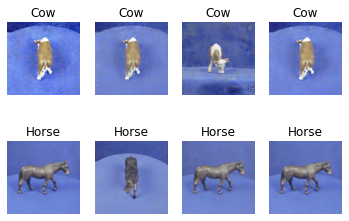

32601 [D loss: 0.161364, acc.: 95.31%] [G loss: 4.141459]
32602 [D loss: 0.072616, acc.: 98.44%] [G loss: 3.620941]
32603 [D loss: 0.135901, acc.: 95.31%] [G loss: 3.294370]
32604 [D loss: 0.089785, acc.: 96.88%] [G loss: 4.146466]
32605 [D loss: 0.166047, acc.: 95.31%] [G loss: 4.787553]
32606 [D loss: 0.078604, acc.: 98.44%] [G loss: 3.898490]
32607 [D loss: 0.199015, acc.: 93.75%] [G loss: 4.465317]
32608 [D loss: 0.019325, acc.: 100.00%] [G loss: 4.275635]
32609 [D loss: 0.099591, acc.: 96.88%] [G loss: 4.560220]
32610 [D loss: 0.030307, acc.: 100.00%] [G loss: 4.687277]
32611 [D loss: 0.059994, acc.: 98.44%] [G loss: 3.910594]
32612 [D loss: 0.012214, acc.: 100.00%] [G loss: 5.398450]
32613 [D loss: 0.047075, acc.: 98.44%] [G loss: 5.154747]
32614 [D loss: 0.097409, acc.: 96.88%] [G loss: 5.530013]
32615 [D loss: 0.013786, acc.: 100.00%] [G loss: 5.583354]
32616 [D loss: 0.179102, acc.: 95.31%] [G loss: 5.585698]
32617 [D loss: 0.077131, acc.: 96.88%] [G loss: 4.498321]
32618 [D l

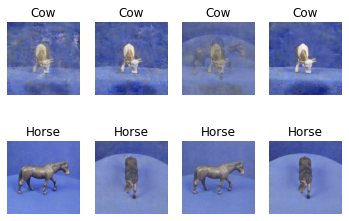

32701 [D loss: 0.042492, acc.: 98.44%] [G loss: 4.475838]
32702 [D loss: 0.162848, acc.: 95.31%] [G loss: 5.440005]
32703 [D loss: 0.022490, acc.: 100.00%] [G loss: 4.480522]
32704 [D loss: 0.058359, acc.: 98.44%] [G loss: 4.200227]
32705 [D loss: 0.016333, acc.: 100.00%] [G loss: 3.890218]
32706 [D loss: 0.146078, acc.: 95.31%] [G loss: 3.757608]
32707 [D loss: 0.146669, acc.: 95.31%] [G loss: 4.643941]
32708 [D loss: 0.052427, acc.: 98.44%] [G loss: 5.060541]
32709 [D loss: 0.062988, acc.: 98.44%] [G loss: 3.761033]
32710 [D loss: 0.071290, acc.: 98.44%] [G loss: 3.571871]
32711 [D loss: 0.149089, acc.: 95.31%] [G loss: 3.680736]
32712 [D loss: 0.065272, acc.: 98.44%] [G loss: 4.061263]
32713 [D loss: 0.055077, acc.: 98.44%] [G loss: 3.993728]
32714 [D loss: 0.130003, acc.: 95.31%] [G loss: 3.676263]
32715 [D loss: 0.018387, acc.: 100.00%] [G loss: 4.845149]
32716 [D loss: 0.114008, acc.: 96.88%] [G loss: 4.133009]
32717 [D loss: 0.057424, acc.: 98.44%] [G loss: 4.705862]
32718 [D lo

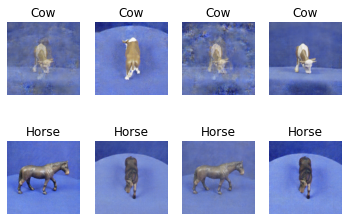

32801 [D loss: 0.116917, acc.: 95.31%] [G loss: 5.783648]
32802 [D loss: 0.015672, acc.: 100.00%] [G loss: 5.000435]
32803 [D loss: 0.044741, acc.: 98.44%] [G loss: 5.203697]
32804 [D loss: 0.190492, acc.: 93.75%] [G loss: 4.401205]
32805 [D loss: 0.020768, acc.: 100.00%] [G loss: 4.312264]
32806 [D loss: 0.091431, acc.: 96.88%] [G loss: 4.091612]
32807 [D loss: 0.031309, acc.: 100.00%] [G loss: 4.847468]
32808 [D loss: 0.191101, acc.: 95.31%] [G loss: 3.051767]
32809 [D loss: 0.037434, acc.: 100.00%] [G loss: 3.806323]
32810 [D loss: 0.057505, acc.: 98.44%] [G loss: 4.289751]
32811 [D loss: 0.071784, acc.: 98.44%] [G loss: 3.624209]
32812 [D loss: 0.103353, acc.: 98.44%] [G loss: 3.495185]
32813 [D loss: 0.083998, acc.: 98.44%] [G loss: 5.143721]
32814 [D loss: 0.047633, acc.: 98.44%] [G loss: 4.042186]
32815 [D loss: 0.078983, acc.: 96.88%] [G loss: 5.084208]
32816 [D loss: 0.021751, acc.: 100.00%] [G loss: 3.948931]
32817 [D loss: 0.082199, acc.: 96.88%] [G loss: 5.525385]
32818 [D 

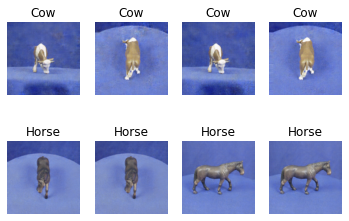

32901 [D loss: 0.140506, acc.: 95.31%] [G loss: 4.387712]
32902 [D loss: 0.099166, acc.: 96.88%] [G loss: 4.939916]
32903 [D loss: 0.074776, acc.: 96.88%] [G loss: 4.701081]
32904 [D loss: 0.022491, acc.: 100.00%] [G loss: 5.333457]
32905 [D loss: 0.157501, acc.: 95.31%] [G loss: 4.625193]
32906 [D loss: 0.117421, acc.: 96.88%] [G loss: 4.688181]
32907 [D loss: 0.068579, acc.: 98.44%] [G loss: 4.226182]
32908 [D loss: 0.105635, acc.: 96.88%] [G loss: 2.914371]
32909 [D loss: 0.092276, acc.: 96.88%] [G loss: 4.525004]
32910 [D loss: 0.183582, acc.: 93.75%] [G loss: 4.655032]
32911 [D loss: 0.053190, acc.: 98.44%] [G loss: 4.030859]
32912 [D loss: 0.093970, acc.: 96.88%] [G loss: 3.825681]
32913 [D loss: 0.046715, acc.: 98.44%] [G loss: 4.512234]
32914 [D loss: 0.119341, acc.: 95.31%] [G loss: 4.774465]
32915 [D loss: 0.061310, acc.: 98.44%] [G loss: 5.228710]
32916 [D loss: 0.030502, acc.: 100.00%] [G loss: 3.888196]
32917 [D loss: 0.002627, acc.: 100.00%] [G loss: 6.007981]
32918 [D lo

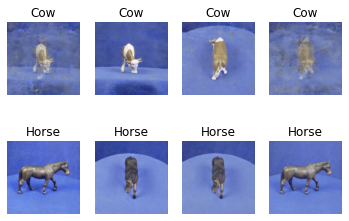

33001 [D loss: 0.098208, acc.: 96.88%] [G loss: 4.347522]
33002 [D loss: 0.089801, acc.: 96.88%] [G loss: 3.361722]
33003 [D loss: 0.177067, acc.: 93.75%] [G loss: 3.841825]
33004 [D loss: 0.027035, acc.: 100.00%] [G loss: 3.679030]
33005 [D loss: 0.116816, acc.: 96.88%] [G loss: 4.545265]
33006 [D loss: 0.051610, acc.: 98.44%] [G loss: 5.315134]
33007 [D loss: 0.158152, acc.: 93.75%] [G loss: 5.419770]
33008 [D loss: 0.128328, acc.: 95.31%] [G loss: 3.882330]
33009 [D loss: 0.042151, acc.: 100.00%] [G loss: 3.991074]
33010 [D loss: 0.108205, acc.: 96.88%] [G loss: 4.176012]
33011 [D loss: 0.031305, acc.: 100.00%] [G loss: 5.988438]
33012 [D loss: 0.188867, acc.: 93.75%] [G loss: 3.982704]
33013 [D loss: 0.116431, acc.: 96.88%] [G loss: 3.415016]
33014 [D loss: 0.196468, acc.: 96.88%] [G loss: 3.540412]
33015 [D loss: 0.107141, acc.: 96.88%] [G loss: 3.375268]
33016 [D loss: 0.071237, acc.: 98.44%] [G loss: 3.485285]
33017 [D loss: 0.090587, acc.: 98.44%] [G loss: 3.642725]
33018 [D lo

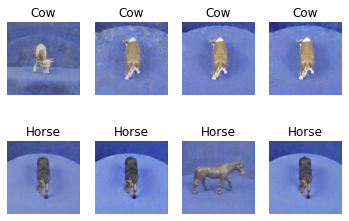

33101 [D loss: 0.072791, acc.: 98.44%] [G loss: 5.164123]
33102 [D loss: 0.016475, acc.: 100.00%] [G loss: 4.041344]
33103 [D loss: 0.050918, acc.: 98.44%] [G loss: 4.203665]
33104 [D loss: 0.021935, acc.: 100.00%] [G loss: 4.507309]
33105 [D loss: 0.123204, acc.: 96.88%] [G loss: 4.982169]
33106 [D loss: 0.103665, acc.: 96.88%] [G loss: 4.514968]
33107 [D loss: 0.073085, acc.: 98.44%] [G loss: 4.371041]
33108 [D loss: 0.103442, acc.: 96.88%] [G loss: 4.666309]
33109 [D loss: 0.027974, acc.: 100.00%] [G loss: 4.328739]
33110 [D loss: 0.138862, acc.: 95.31%] [G loss: 4.763632]
33111 [D loss: 0.110778, acc.: 96.88%] [G loss: 3.882773]
33112 [D loss: 0.144754, acc.: 96.88%] [G loss: 3.463159]
33113 [D loss: 0.083970, acc.: 98.44%] [G loss: 3.683430]
33114 [D loss: 0.066871, acc.: 98.44%] [G loss: 3.961767]
33115 [D loss: 0.110849, acc.: 96.88%] [G loss: 3.502442]
33116 [D loss: 0.108852, acc.: 96.88%] [G loss: 4.217338]
33117 [D loss: 0.099715, acc.: 96.88%] [G loss: 4.201464]
33118 [D lo

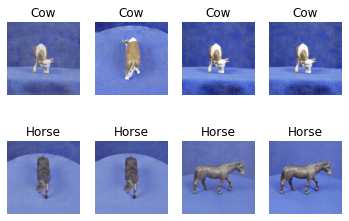

33201 [D loss: 0.032460, acc.: 100.00%] [G loss: 4.020181]
33202 [D loss: 0.019696, acc.: 100.00%] [G loss: 5.077066]
33203 [D loss: 0.134661, acc.: 96.88%] [G loss: 4.559985]
33204 [D loss: 0.090167, acc.: 96.88%] [G loss: 4.291957]
33205 [D loss: 0.136339, acc.: 95.31%] [G loss: 4.438096]
33206 [D loss: 0.154390, acc.: 93.75%] [G loss: 4.737988]
33207 [D loss: 0.103439, acc.: 98.44%] [G loss: 3.921196]
33208 [D loss: 0.064193, acc.: 98.44%] [G loss: 4.361311]
33209 [D loss: 0.154358, acc.: 95.31%] [G loss: 3.377252]
33210 [D loss: 0.034909, acc.: 100.00%] [G loss: 3.293952]
33211 [D loss: 0.103939, acc.: 96.88%] [G loss: 4.696271]
33212 [D loss: 0.059274, acc.: 98.44%] [G loss: 4.726884]
33213 [D loss: 0.216091, acc.: 93.75%] [G loss: 3.554221]
33214 [D loss: 0.071529, acc.: 98.44%] [G loss: 3.798494]
33215 [D loss: 0.012515, acc.: 100.00%] [G loss: 5.378286]
33216 [D loss: 0.219248, acc.: 95.31%] [G loss: 3.350530]
33217 [D loss: 0.096658, acc.: 96.88%] [G loss: 3.645289]
33218 [D l

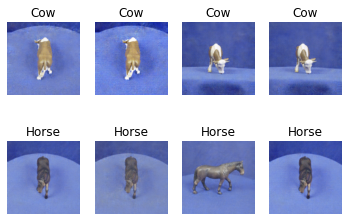

33301 [D loss: 0.078667, acc.: 98.44%] [G loss: 4.204200]
33302 [D loss: 0.140343, acc.: 96.88%] [G loss: 4.007170]
33303 [D loss: 0.081237, acc.: 98.44%] [G loss: 3.753598]
33304 [D loss: 0.110778, acc.: 96.88%] [G loss: 4.221854]
33305 [D loss: 0.072838, acc.: 98.44%] [G loss: 3.251444]
33306 [D loss: 0.101174, acc.: 96.88%] [G loss: 3.937066]
33307 [D loss: 0.106983, acc.: 96.88%] [G loss: 3.982962]
33308 [D loss: 0.146132, acc.: 95.31%] [G loss: 5.205845]
33309 [D loss: 0.148589, acc.: 95.31%] [G loss: 4.099624]
33310 [D loss: 0.084504, acc.: 98.44%] [G loss: 3.433052]
33311 [D loss: 0.092142, acc.: 96.88%] [G loss: 4.208000]
33312 [D loss: 0.132480, acc.: 95.31%] [G loss: 4.371318]
33313 [D loss: 0.048137, acc.: 98.44%] [G loss: 5.143095]
33314 [D loss: 0.014868, acc.: 100.00%] [G loss: 5.639227]
33315 [D loss: 0.227785, acc.: 93.75%] [G loss: 4.600876]
33316 [D loss: 0.122907, acc.: 95.31%] [G loss: 4.622647]
33317 [D loss: 0.137375, acc.: 95.31%] [G loss: 4.607264]
33318 [D loss

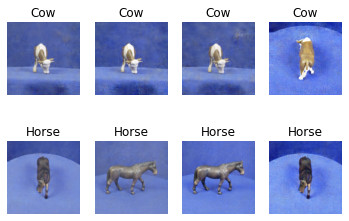

33401 [D loss: 0.054013, acc.: 98.44%] [G loss: 4.858551]
33402 [D loss: 0.141997, acc.: 96.88%] [G loss: 5.212066]
33403 [D loss: 0.150580, acc.: 96.88%] [G loss: 3.927011]
33404 [D loss: 0.082095, acc.: 98.44%] [G loss: 4.505390]
33405 [D loss: 0.015570, acc.: 100.00%] [G loss: 4.694824]
33406 [D loss: 0.054384, acc.: 98.44%] [G loss: 4.903537]
33407 [D loss: 0.060724, acc.: 98.44%] [G loss: 5.145901]
33408 [D loss: 0.024519, acc.: 100.00%] [G loss: 4.501687]
33409 [D loss: 0.149511, acc.: 95.31%] [G loss: 4.904519]
33410 [D loss: 0.045303, acc.: 98.44%] [G loss: 4.587150]
33411 [D loss: 0.117648, acc.: 96.88%] [G loss: 4.479766]
33412 [D loss: 0.118540, acc.: 96.88%] [G loss: 5.735303]
33413 [D loss: 0.082007, acc.: 96.88%] [G loss: 5.669118]
33414 [D loss: 0.083121, acc.: 98.44%] [G loss: 3.934730]
33415 [D loss: 0.091112, acc.: 96.88%] [G loss: 3.100701]
33416 [D loss: 0.062868, acc.: 98.44%] [G loss: 4.282963]
33417 [D loss: 0.022967, acc.: 100.00%] [G loss: 5.004296]
33418 [D lo

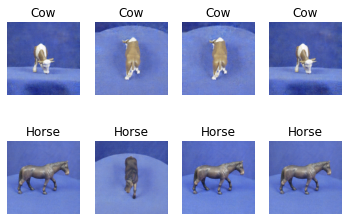

33501 [D loss: 0.037741, acc.: 100.00%] [G loss: 3.332832]
33502 [D loss: 0.156084, acc.: 96.88%] [G loss: 3.013301]
33503 [D loss: 0.253729, acc.: 92.19%] [G loss: 2.716186]
33504 [D loss: 0.064863, acc.: 98.44%] [G loss: 3.087039]
33505 [D loss: 0.059852, acc.: 98.44%] [G loss: 3.396939]
33506 [D loss: 0.019465, acc.: 100.00%] [G loss: 3.837844]
33507 [D loss: 0.107067, acc.: 96.88%] [G loss: 3.343609]
33508 [D loss: 0.018385, acc.: 100.00%] [G loss: 4.539003]
33509 [D loss: 0.247400, acc.: 93.75%] [G loss: 3.924639]
33510 [D loss: 0.064131, acc.: 98.44%] [G loss: 4.989305]
33511 [D loss: 0.173808, acc.: 93.75%] [G loss: 3.319287]
33512 [D loss: 0.064924, acc.: 98.44%] [G loss: 3.604795]
33513 [D loss: 0.140108, acc.: 95.31%] [G loss: 2.946810]
33514 [D loss: 0.106939, acc.: 96.88%] [G loss: 2.807201]
33515 [D loss: 0.092784, acc.: 96.88%] [G loss: 4.143830]
33516 [D loss: 0.147241, acc.: 95.31%] [G loss: 3.223281]
33517 [D loss: 0.057687, acc.: 98.44%] [G loss: 3.962953]
33518 [D lo

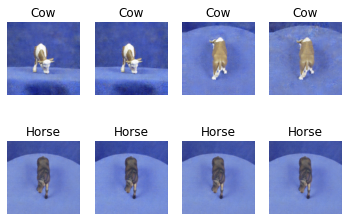

33601 [D loss: 0.084495, acc.: 98.44%] [G loss: 3.950033]
33602 [D loss: 0.127236, acc.: 96.88%] [G loss: 3.841184]
33603 [D loss: 0.142351, acc.: 96.88%] [G loss: 3.220931]
33604 [D loss: 0.081108, acc.: 98.44%] [G loss: 3.374995]
33605 [D loss: 0.102577, acc.: 96.88%] [G loss: 3.025409]
33606 [D loss: 0.055182, acc.: 98.44%] [G loss: 3.925405]
33607 [D loss: 0.134720, acc.: 96.88%] [G loss: 3.356811]
33608 [D loss: 0.061954, acc.: 98.44%] [G loss: 3.464767]
33609 [D loss: 0.092525, acc.: 98.44%] [G loss: 4.279791]
33610 [D loss: 0.019328, acc.: 100.00%] [G loss: 3.611638]
33611 [D loss: 0.100200, acc.: 96.88%] [G loss: 4.449642]
33612 [D loss: 0.011226, acc.: 100.00%] [G loss: 5.031682]
33613 [D loss: 0.117271, acc.: 96.88%] [G loss: 3.511401]
33614 [D loss: 0.213962, acc.: 93.75%] [G loss: 3.446841]
33615 [D loss: 0.089279, acc.: 98.44%] [G loss: 3.420743]
33616 [D loss: 0.132374, acc.: 96.88%] [G loss: 3.638881]
33617 [D loss: 0.027690, acc.: 100.00%] [G loss: 3.663979]
33618 [D lo

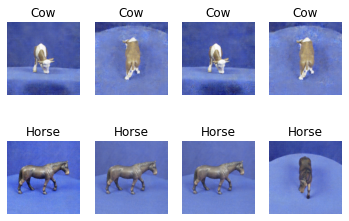

33701 [D loss: 0.086625, acc.: 98.44%] [G loss: 3.731674]
33702 [D loss: 0.062394, acc.: 98.44%] [G loss: 3.884392]
33703 [D loss: 0.016426, acc.: 100.00%] [G loss: 5.068731]
33704 [D loss: 0.183442, acc.: 95.31%] [G loss: 3.752094]
33705 [D loss: 0.025939, acc.: 100.00%] [G loss: 3.572246]
33706 [D loss: 0.197220, acc.: 93.75%] [G loss: 3.719515]
33707 [D loss: 0.024746, acc.: 100.00%] [G loss: 3.357211]
33708 [D loss: 0.020124, acc.: 100.00%] [G loss: 4.066520]
33709 [D loss: 0.021120, acc.: 100.00%] [G loss: 3.677270]
33710 [D loss: 0.017278, acc.: 100.00%] [G loss: 4.094802]
33711 [D loss: 0.010219, acc.: 100.00%] [G loss: 4.287600]
33712 [D loss: 0.043354, acc.: 98.44%] [G loss: 4.726065]
33713 [D loss: 0.131523, acc.: 96.88%] [G loss: 4.159647]
33714 [D loss: 0.014049, acc.: 100.00%] [G loss: 4.114383]
33715 [D loss: 0.009974, acc.: 100.00%] [G loss: 4.412567]
33716 [D loss: 0.347775, acc.: 90.62%] [G loss: 4.492952]
33717 [D loss: 0.046108, acc.: 98.44%] [G loss: 3.968077]
33718

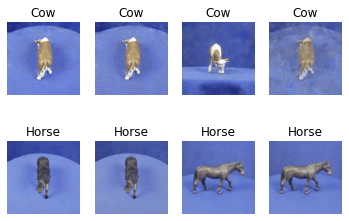

33801 [D loss: 0.112768, acc.: 96.88%] [G loss: 3.824804]
33802 [D loss: 0.058702, acc.: 98.44%] [G loss: 3.564195]
33803 [D loss: 0.147942, acc.: 95.31%] [G loss: 3.775455]
33804 [D loss: 0.052529, acc.: 98.44%] [G loss: 5.002192]
33805 [D loss: 0.149622, acc.: 95.31%] [G loss: 4.344520]
33806 [D loss: 0.150688, acc.: 95.31%] [G loss: 3.974363]
33807 [D loss: 0.079503, acc.: 98.44%] [G loss: 3.325371]
33808 [D loss: 0.033896, acc.: 100.00%] [G loss: 3.282987]
33809 [D loss: 0.028692, acc.: 100.00%] [G loss: 3.390899]
33810 [D loss: 0.211419, acc.: 93.75%] [G loss: 4.535562]
33811 [D loss: 0.099603, acc.: 96.88%] [G loss: 3.668100]
33812 [D loss: 0.134904, acc.: 95.31%] [G loss: 3.579764]
33813 [D loss: 0.156705, acc.: 95.31%] [G loss: 4.477870]
33814 [D loss: 0.087183, acc.: 98.44%] [G loss: 3.878558]
33815 [D loss: 0.077808, acc.: 98.44%] [G loss: 3.549513]
33816 [D loss: 0.119219, acc.: 96.88%] [G loss: 4.928993]
33817 [D loss: 0.108360, acc.: 96.88%] [G loss: 3.803636]
33818 [D los

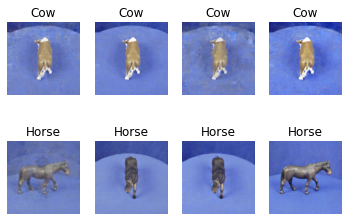

33901 [D loss: 0.050710, acc.: 98.44%] [G loss: 4.602505]
33902 [D loss: 0.061547, acc.: 98.44%] [G loss: 4.129889]
33903 [D loss: 0.074005, acc.: 96.88%] [G loss: 4.759739]
33904 [D loss: 0.013710, acc.: 100.00%] [G loss: 4.499476]
33905 [D loss: 0.090625, acc.: 96.88%] [G loss: 5.229604]
33906 [D loss: 0.011452, acc.: 100.00%] [G loss: 5.074509]
33907 [D loss: 0.054747, acc.: 98.44%] [G loss: 6.736649]
33908 [D loss: 0.151335, acc.: 95.31%] [G loss: 5.265863]
33909 [D loss: 0.103184, acc.: 96.88%] [G loss: 5.542812]
33910 [D loss: 0.105643, acc.: 96.88%] [G loss: 4.799802]
33911 [D loss: 0.137362, acc.: 96.88%] [G loss: 4.601906]
33912 [D loss: 0.065179, acc.: 98.44%] [G loss: 3.579993]
33913 [D loss: 0.022522, acc.: 100.00%] [G loss: 4.432086]
33914 [D loss: 0.068326, acc.: 98.44%] [G loss: 4.176289]
33915 [D loss: 0.057385, acc.: 98.44%] [G loss: 4.739145]
33916 [D loss: 0.177971, acc.: 95.31%] [G loss: 4.099566]
33917 [D loss: 0.081914, acc.: 98.44%] [G loss: 3.342319]
33918 [D lo

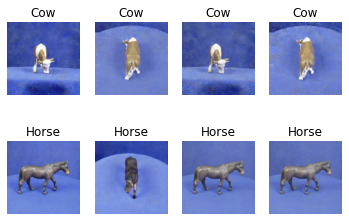

34001 [D loss: 0.030319, acc.: 100.00%] [G loss: 4.409435]
34002 [D loss: 0.061556, acc.: 98.44%] [G loss: 7.019169]
34003 [D loss: 0.099000, acc.: 96.88%] [G loss: 5.251581]
34004 [D loss: 0.042311, acc.: 98.44%] [G loss: 5.549416]
34005 [D loss: 0.040000, acc.: 98.44%] [G loss: 4.768191]
34006 [D loss: 0.019203, acc.: 100.00%] [G loss: 5.021626]
34007 [D loss: 0.008234, acc.: 100.00%] [G loss: 4.892065]
34008 [D loss: 0.086683, acc.: 96.88%] [G loss: 6.037357]
34009 [D loss: 0.012004, acc.: 100.00%] [G loss: 6.442688]
34010 [D loss: 0.017635, acc.: 100.00%] [G loss: 4.945869]
34011 [D loss: 0.007738, acc.: 100.00%] [G loss: 6.229887]
34012 [D loss: 0.078044, acc.: 98.44%] [G loss: 7.166305]
34013 [D loss: 0.207947, acc.: 95.31%] [G loss: 4.008530]
34014 [D loss: 0.007961, acc.: 100.00%] [G loss: 6.176803]
34015 [D loss: 0.139170, acc.: 96.88%] [G loss: 4.231190]
34016 [D loss: 0.124087, acc.: 95.31%] [G loss: 3.750390]
34017 [D loss: 0.051150, acc.: 98.44%] [G loss: 4.900068]
34018 [

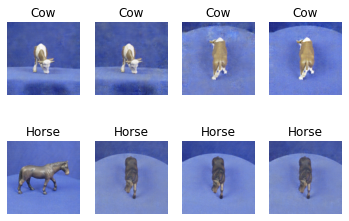

34101 [D loss: 0.056913, acc.: 98.44%] [G loss: 4.435042]
34102 [D loss: 0.042108, acc.: 98.44%] [G loss: 4.366521]
34103 [D loss: 0.063218, acc.: 98.44%] [G loss: 6.370404]
34104 [D loss: 0.067739, acc.: 98.44%] [G loss: 3.570001]
34105 [D loss: 0.156382, acc.: 95.31%] [G loss: 3.984951]
34106 [D loss: 0.059388, acc.: 98.44%] [G loss: 4.491943]
34107 [D loss: 0.154968, acc.: 95.31%] [G loss: 4.772519]
34108 [D loss: 0.141252, acc.: 95.31%] [G loss: 4.507727]
34109 [D loss: 0.054437, acc.: 98.44%] [G loss: 4.688388]
34110 [D loss: 0.069877, acc.: 96.88%] [G loss: 5.003413]
34111 [D loss: 0.077677, acc.: 98.44%] [G loss: 4.686728]
34112 [D loss: 0.090130, acc.: 96.88%] [G loss: 4.871718]
34113 [D loss: 0.191879, acc.: 95.31%] [G loss: 3.415343]
34114 [D loss: 0.071738, acc.: 98.44%] [G loss: 3.415369]
34115 [D loss: 0.085392, acc.: 96.88%] [G loss: 4.471799]
34116 [D loss: 0.031743, acc.: 100.00%] [G loss: 4.312889]
34117 [D loss: 0.130539, acc.: 95.31%] [G loss: 4.908552]
34118 [D loss

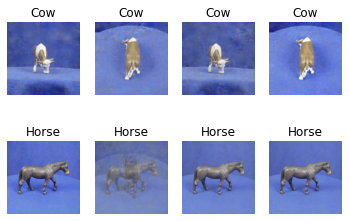

34201 [D loss: 0.126010, acc.: 96.88%] [G loss: 4.682224]
34202 [D loss: 0.117744, acc.: 96.88%] [G loss: 4.548252]
34203 [D loss: 0.021622, acc.: 100.00%] [G loss: 5.504550]
34204 [D loss: 0.094516, acc.: 96.88%] [G loss: 4.070116]
34205 [D loss: 0.071831, acc.: 98.44%] [G loss: 4.221028]
34206 [D loss: 0.119636, acc.: 98.44%] [G loss: 3.776465]
34207 [D loss: 0.080283, acc.: 98.44%] [G loss: 3.903214]
34208 [D loss: 0.033895, acc.: 100.00%] [G loss: 3.969838]
34209 [D loss: 0.134921, acc.: 95.31%] [G loss: 6.127824]
34210 [D loss: 0.203029, acc.: 93.75%] [G loss: 4.036960]
34211 [D loss: 0.123388, acc.: 96.88%] [G loss: 4.815222]
34212 [D loss: 0.050031, acc.: 98.44%] [G loss: 3.284091]
34213 [D loss: 0.143227, acc.: 96.88%] [G loss: 3.744172]
34214 [D loss: 0.038617, acc.: 100.00%] [G loss: 3.270453]
34215 [D loss: 0.031189, acc.: 100.00%] [G loss: 4.131402]
34216 [D loss: 0.015708, acc.: 100.00%] [G loss: 4.779547]
34217 [D loss: 0.019593, acc.: 100.00%] [G loss: 4.654078]
34218 [D

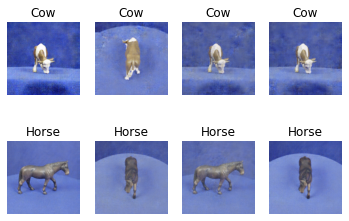

34301 [D loss: 0.098715, acc.: 98.44%] [G loss: 3.720404]
34302 [D loss: 0.100095, acc.: 96.88%] [G loss: 4.166627]
34303 [D loss: 0.231587, acc.: 93.75%] [G loss: 3.827228]
34304 [D loss: 0.085724, acc.: 98.44%] [G loss: 3.214298]
34305 [D loss: 0.025461, acc.: 100.00%] [G loss: 3.894277]
34306 [D loss: 0.040114, acc.: 100.00%] [G loss: 3.383040]
34307 [D loss: 0.097436, acc.: 96.88%] [G loss: 3.428437]
34308 [D loss: 0.019887, acc.: 100.00%] [G loss: 4.478692]
34309 [D loss: 0.145979, acc.: 95.31%] [G loss: 4.210480]
34310 [D loss: 0.054736, acc.: 98.44%] [G loss: 4.832794]
34311 [D loss: 0.088979, acc.: 96.88%] [G loss: 4.261425]
34312 [D loss: 0.061200, acc.: 98.44%] [G loss: 4.057595]
34313 [D loss: 0.151717, acc.: 96.88%] [G loss: 3.359912]
34314 [D loss: 0.133407, acc.: 95.31%] [G loss: 4.762043]
34315 [D loss: 0.017536, acc.: 100.00%] [G loss: 4.424809]
34316 [D loss: 0.074148, acc.: 98.44%] [G loss: 4.444257]
34317 [D loss: 0.061965, acc.: 98.44%] [G loss: 4.986463]
34318 [D l

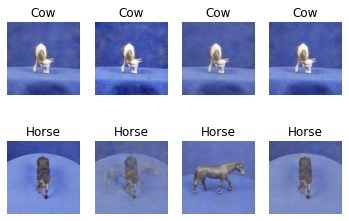

34401 [D loss: 0.120764, acc.: 96.88%] [G loss: 6.174100]
34402 [D loss: 0.062213, acc.: 98.44%] [G loss: 7.726577]
34403 [D loss: 0.168795, acc.: 95.31%] [G loss: 5.017301]
34404 [D loss: 0.200804, acc.: 95.31%] [G loss: 4.729489]
34405 [D loss: 0.107030, acc.: 96.88%] [G loss: 3.758248]
34406 [D loss: 0.037105, acc.: 100.00%] [G loss: 3.302486]
34407 [D loss: 0.062223, acc.: 98.44%] [G loss: 3.708761]
34408 [D loss: 0.097323, acc.: 96.88%] [G loss: 3.534723]
34409 [D loss: 0.085296, acc.: 98.44%] [G loss: 3.464606]
34410 [D loss: 0.026813, acc.: 100.00%] [G loss: 3.392498]
34411 [D loss: 0.027607, acc.: 100.00%] [G loss: 3.645448]
34412 [D loss: 0.110626, acc.: 96.88%] [G loss: 3.737108]
34413 [D loss: 0.064696, acc.: 98.44%] [G loss: 3.372681]
34414 [D loss: 0.053936, acc.: 98.44%] [G loss: 4.225749]
34415 [D loss: 0.072924, acc.: 98.44%] [G loss: 4.453407]
34416 [D loss: 0.180708, acc.: 95.31%] [G loss: 4.022841]
34417 [D loss: 0.029159, acc.: 100.00%] [G loss: 3.534157]
34418 [D l

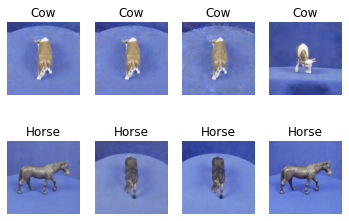

34501 [D loss: 0.152953, acc.: 95.31%] [G loss: 4.228418]
34502 [D loss: 0.070328, acc.: 98.44%] [G loss: 3.971341]
34503 [D loss: 0.105628, acc.: 96.88%] [G loss: 3.866624]
34504 [D loss: 0.134778, acc.: 95.31%] [G loss: 4.357782]
34505 [D loss: 0.147085, acc.: 96.88%] [G loss: 3.442142]
34506 [D loss: 0.066377, acc.: 98.44%] [G loss: 3.296907]
34507 [D loss: 0.188785, acc.: 95.31%] [G loss: 3.448679]
34508 [D loss: 0.064799, acc.: 98.44%] [G loss: 4.030804]
34509 [D loss: 0.136783, acc.: 95.31%] [G loss: 3.499627]
34510 [D loss: 0.214329, acc.: 92.19%] [G loss: 4.897738]
34511 [D loss: 0.073757, acc.: 98.44%] [G loss: 3.712787]
34512 [D loss: 0.095381, acc.: 96.88%] [G loss: 3.894390]
34513 [D loss: 0.021745, acc.: 100.00%] [G loss: 4.622567]
34514 [D loss: 0.098376, acc.: 98.44%] [G loss: 4.477690]
34515 [D loss: 0.060476, acc.: 98.44%] [G loss: 4.220618]
34516 [D loss: 0.060490, acc.: 98.44%] [G loss: 3.879539]
34517 [D loss: 0.157291, acc.: 95.31%] [G loss: 5.051377]
34518 [D loss

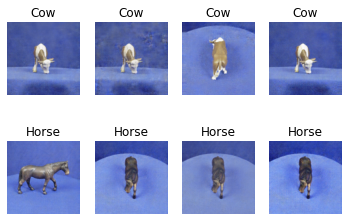

34601 [D loss: 0.081276, acc.: 96.88%] [G loss: 5.920280]
34602 [D loss: 0.056570, acc.: 100.00%] [G loss: 3.574249]
34603 [D loss: 0.083534, acc.: 96.88%] [G loss: 4.823172]
34604 [D loss: 0.182373, acc.: 92.19%] [G loss: 4.563340]
34605 [D loss: 0.238891, acc.: 92.19%] [G loss: 3.095088]
34606 [D loss: 0.073990, acc.: 98.44%] [G loss: 3.174996]
34607 [D loss: 0.194421, acc.: 95.31%] [G loss: 4.063046]
34608 [D loss: 0.122071, acc.: 96.88%] [G loss: 3.223444]
34609 [D loss: 0.159032, acc.: 95.31%] [G loss: 3.882189]
34610 [D loss: 0.170628, acc.: 93.75%] [G loss: 4.125143]
34611 [D loss: 0.074870, acc.: 98.44%] [G loss: 3.557905]
34612 [D loss: 0.122601, acc.: 96.88%] [G loss: 3.018536]
34613 [D loss: 0.049341, acc.: 98.44%] [G loss: 3.921824]
34614 [D loss: 0.082867, acc.: 98.44%] [G loss: 4.050425]
34615 [D loss: 0.024776, acc.: 100.00%] [G loss: 3.478306]
34616 [D loss: 0.104266, acc.: 96.88%] [G loss: 4.571836]
34617 [D loss: 0.098016, acc.: 96.88%] [G loss: 4.371493]
34618 [D los

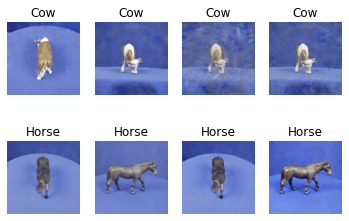

34701 [D loss: 0.161926, acc.: 95.31%] [G loss: 4.795202]
34702 [D loss: 0.051778, acc.: 98.44%] [G loss: 5.766200]
34703 [D loss: 0.021611, acc.: 100.00%] [G loss: 3.937657]
34704 [D loss: 0.104549, acc.: 96.88%] [G loss: 5.637929]
34705 [D loss: 0.060227, acc.: 98.44%] [G loss: 3.999082]
34706 [D loss: 0.065728, acc.: 98.44%] [G loss: 3.806371]
34707 [D loss: 0.115954, acc.: 95.31%] [G loss: 4.528137]
34708 [D loss: 0.163454, acc.: 95.31%] [G loss: 3.524853]
34709 [D loss: 0.024007, acc.: 100.00%] [G loss: 4.256336]
34710 [D loss: 0.059074, acc.: 98.44%] [G loss: 4.218364]
34711 [D loss: 0.099983, acc.: 96.88%] [G loss: 4.911455]
34712 [D loss: 0.092213, acc.: 96.88%] [G loss: 4.315961]
34713 [D loss: 0.245147, acc.: 90.62%] [G loss: 5.449931]
34714 [D loss: 0.090951, acc.: 98.44%] [G loss: 3.158532]
34715 [D loss: 0.070826, acc.: 98.44%] [G loss: 4.414658]
34716 [D loss: 0.020250, acc.: 100.00%] [G loss: 5.779228]
34717 [D loss: 0.036001, acc.: 100.00%] [G loss: 3.768667]
34718 [D l

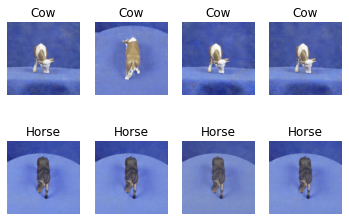

34801 [D loss: 0.073133, acc.: 98.44%] [G loss: 3.536891]
34802 [D loss: 0.108442, acc.: 96.88%] [G loss: 3.635618]
34803 [D loss: 0.125825, acc.: 96.88%] [G loss: 4.055647]
34804 [D loss: 0.080632, acc.: 98.44%] [G loss: 4.292709]
34805 [D loss: 0.170911, acc.: 93.75%] [G loss: 3.716610]
34806 [D loss: 0.114711, acc.: 96.88%] [G loss: 3.377011]
34807 [D loss: 0.019403, acc.: 100.00%] [G loss: 4.197161]
34808 [D loss: 0.105901, acc.: 96.88%] [G loss: 4.218822]
34809 [D loss: 0.223331, acc.: 93.75%] [G loss: 4.113631]
34810 [D loss: 0.108862, acc.: 96.88%] [G loss: 4.051648]
34811 [D loss: 0.163703, acc.: 95.31%] [G loss: 3.931308]
34812 [D loss: 0.106020, acc.: 96.88%] [G loss: 3.689894]
34813 [D loss: 0.135661, acc.: 95.31%] [G loss: 3.382353]
34814 [D loss: 0.098425, acc.: 96.88%] [G loss: 3.433636]
34815 [D loss: 0.176496, acc.: 93.75%] [G loss: 3.229321]
34816 [D loss: 0.184985, acc.: 93.75%] [G loss: 3.350195]
34817 [D loss: 0.084669, acc.: 98.44%] [G loss: 4.014819]
34818 [D loss

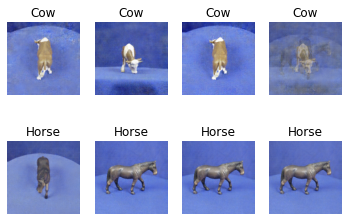

34901 [D loss: 0.079062, acc.: 98.44%] [G loss: 3.581386]
34902 [D loss: 0.143253, acc.: 95.31%] [G loss: 3.745617]
34903 [D loss: 0.063496, acc.: 98.44%] [G loss: 3.743833]
34904 [D loss: 0.103113, acc.: 96.88%] [G loss: 4.375053]
34905 [D loss: 0.020607, acc.: 100.00%] [G loss: 5.555948]
34906 [D loss: 0.006191, acc.: 100.00%] [G loss: 5.703432]
34907 [D loss: 0.095258, acc.: 96.88%] [G loss: 4.627461]
34908 [D loss: 0.014928, acc.: 100.00%] [G loss: 5.469226]
34909 [D loss: 0.009771, acc.: 100.00%] [G loss: 5.309909]
34910 [D loss: 0.063521, acc.: 98.44%] [G loss: 4.134106]
34911 [D loss: 0.104244, acc.: 96.88%] [G loss: 4.615258]
34912 [D loss: 0.070955, acc.: 98.44%] [G loss: 4.945593]
34913 [D loss: 0.096504, acc.: 96.88%] [G loss: 6.321050]
34914 [D loss: 0.060669, acc.: 98.44%] [G loss: 3.863940]
34915 [D loss: 0.120976, acc.: 95.31%] [G loss: 5.038607]
34916 [D loss: 0.019244, acc.: 100.00%] [G loss: 4.543254]
34917 [D loss: 0.117620, acc.: 98.44%] [G loss: 4.561072]
34918 [D 

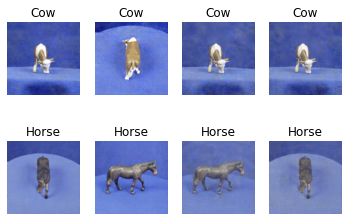

35001 [D loss: 0.112233, acc.: 95.31%] [G loss: 4.050915]
35002 [D loss: 0.028016, acc.: 100.00%] [G loss: 4.771459]
35003 [D loss: 0.145250, acc.: 95.31%] [G loss: 4.599496]
35004 [D loss: 0.054902, acc.: 98.44%] [G loss: 3.626396]
35005 [D loss: 0.057495, acc.: 98.44%] [G loss: 4.504961]
35006 [D loss: 0.112663, acc.: 96.88%] [G loss: 4.713992]
35007 [D loss: 0.111925, acc.: 96.88%] [G loss: 4.498528]
35008 [D loss: 0.141912, acc.: 95.31%] [G loss: 5.170278]
35009 [D loss: 0.076017, acc.: 96.88%] [G loss: 4.293347]
35010 [D loss: 0.129867, acc.: 96.88%] [G loss: 4.426242]
35011 [D loss: 0.101400, acc.: 96.88%] [G loss: 3.696710]
35012 [D loss: 0.070636, acc.: 98.44%] [G loss: 3.901488]
35013 [D loss: 0.099886, acc.: 96.88%] [G loss: 3.363388]
35014 [D loss: 0.073370, acc.: 96.88%] [G loss: 5.208158]
35015 [D loss: 0.084070, acc.: 96.88%] [G loss: 4.322426]
35016 [D loss: 0.100538, acc.: 96.88%] [G loss: 3.728701]
35017 [D loss: 0.250780, acc.: 90.62%] [G loss: 4.484461]
35018 [D loss

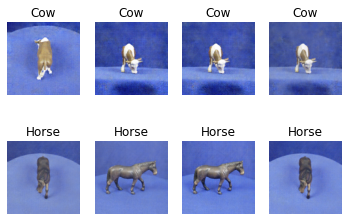

35101 [D loss: 0.064874, acc.: 98.44%] [G loss: 4.565513]
35102 [D loss: 0.107937, acc.: 96.88%] [G loss: 4.698595]
35103 [D loss: 0.140025, acc.: 95.31%] [G loss: 4.227716]
35104 [D loss: 0.106054, acc.: 96.88%] [G loss: 4.839798]
35105 [D loss: 0.137624, acc.: 95.31%] [G loss: 3.697696]
35106 [D loss: 0.072971, acc.: 98.44%] [G loss: 4.663116]
35107 [D loss: 0.091641, acc.: 96.88%] [G loss: 4.590357]
35108 [D loss: 0.105757, acc.: 98.44%] [G loss: 3.514186]
35109 [D loss: 0.092603, acc.: 96.88%] [G loss: 3.572418]
35110 [D loss: 0.101025, acc.: 96.88%] [G loss: 4.176454]
35111 [D loss: 0.103995, acc.: 96.88%] [G loss: 2.924046]
35112 [D loss: 0.176162, acc.: 93.75%] [G loss: 3.614744]
35113 [D loss: 0.080117, acc.: 98.44%] [G loss: 3.421561]
35114 [D loss: 0.022761, acc.: 100.00%] [G loss: 4.209510]
35115 [D loss: 0.043513, acc.: 98.44%] [G loss: 4.825933]
35116 [D loss: 0.014494, acc.: 100.00%] [G loss: 4.821683]
35117 [D loss: 0.086534, acc.: 96.88%] [G loss: 4.935146]
35118 [D los

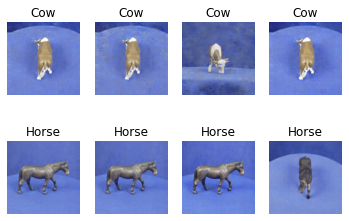

35201 [D loss: 0.101054, acc.: 96.88%] [G loss: 6.474930]
35202 [D loss: 0.126200, acc.: 95.31%] [G loss: 4.312128]
35203 [D loss: 0.077839, acc.: 96.88%] [G loss: 3.580697]
35204 [D loss: 0.101820, acc.: 95.31%] [G loss: 4.175263]
35205 [D loss: 0.047314, acc.: 98.44%] [G loss: 5.884085]
35206 [D loss: 0.053840, acc.: 98.44%] [G loss: 4.198623]
35207 [D loss: 0.025870, acc.: 100.00%] [G loss: 5.154055]
35208 [D loss: 0.118315, acc.: 95.31%] [G loss: 2.962018]
35209 [D loss: 0.079786, acc.: 98.44%] [G loss: 4.013243]
35210 [D loss: 0.093597, acc.: 96.88%] [G loss: 4.698788]
35211 [D loss: 0.066801, acc.: 98.44%] [G loss: 3.462579]
35212 [D loss: 0.118532, acc.: 96.88%] [G loss: 3.529814]
35213 [D loss: 0.024462, acc.: 100.00%] [G loss: 3.998957]
35214 [D loss: 0.106360, acc.: 96.88%] [G loss: 3.580700]
35215 [D loss: 0.045678, acc.: 98.44%] [G loss: 5.294340]
35216 [D loss: 0.067898, acc.: 98.44%] [G loss: 4.896073]
35217 [D loss: 0.053086, acc.: 98.44%] [G loss: 6.092399]
35218 [D los

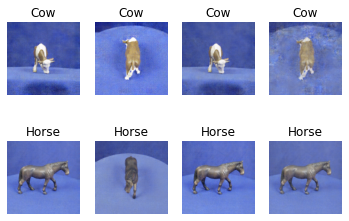

35301 [D loss: 0.039269, acc.: 100.00%] [G loss: 3.776896]
35302 [D loss: 0.051814, acc.: 98.44%] [G loss: 4.315754]
35303 [D loss: 0.154197, acc.: 96.88%] [G loss: 5.232518]
35304 [D loss: 0.109966, acc.: 96.88%] [G loss: 5.284538]
35305 [D loss: 0.026488, acc.: 100.00%] [G loss: 4.656532]
35306 [D loss: 0.112972, acc.: 96.88%] [G loss: 5.765904]
35307 [D loss: 0.021129, acc.: 100.00%] [G loss: 5.455541]
35308 [D loss: 0.181770, acc.: 93.75%] [G loss: 3.728914]
35309 [D loss: 0.156772, acc.: 95.31%] [G loss: 4.293928]
35310 [D loss: 0.027106, acc.: 100.00%] [G loss: 4.069902]
35311 [D loss: 0.078287, acc.: 98.44%] [G loss: 4.013391]
35312 [D loss: 0.100275, acc.: 96.88%] [G loss: 4.525094]
35313 [D loss: 0.031300, acc.: 100.00%] [G loss: 4.509817]
35314 [D loss: 0.011425, acc.: 100.00%] [G loss: 5.399895]
35315 [D loss: 0.196092, acc.: 95.31%] [G loss: 4.966587]
35316 [D loss: 0.097981, acc.: 96.88%] [G loss: 5.397625]
35317 [D loss: 0.147084, acc.: 95.31%] [G loss: 6.168645]
35318 [D

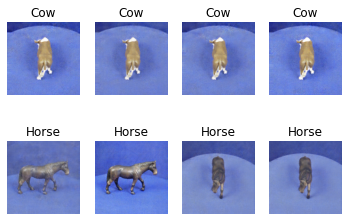

35401 [D loss: 0.064773, acc.: 98.44%] [G loss: 3.481231]
35402 [D loss: 0.016944, acc.: 100.00%] [G loss: 5.473539]
35403 [D loss: 0.189436, acc.: 95.31%] [G loss: 4.583072]
35404 [D loss: 0.118492, acc.: 96.88%] [G loss: 5.010829]
35405 [D loss: 0.010807, acc.: 100.00%] [G loss: 5.706736]
35406 [D loss: 0.173494, acc.: 95.31%] [G loss: 3.357702]
35407 [D loss: 0.061244, acc.: 98.44%] [G loss: 4.650006]
35408 [D loss: 0.086883, acc.: 96.88%] [G loss: 5.742012]
35409 [D loss: 0.136591, acc.: 95.31%] [G loss: 4.283082]
35410 [D loss: 0.090845, acc.: 96.88%] [G loss: 6.121302]
35411 [D loss: 0.102018, acc.: 95.31%] [G loss: 6.087472]
35412 [D loss: 0.088803, acc.: 96.88%] [G loss: 5.324630]
35413 [D loss: 0.061307, acc.: 98.44%] [G loss: 5.597549]
35414 [D loss: 0.054194, acc.: 98.44%] [G loss: 4.507732]
35415 [D loss: 0.140629, acc.: 95.31%] [G loss: 5.854781]
35416 [D loss: 0.058151, acc.: 98.44%] [G loss: 4.390868]
35417 [D loss: 0.050513, acc.: 98.44%] [G loss: 5.766908]
35418 [D los

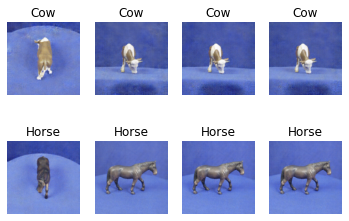

35501 [D loss: 0.103012, acc.: 96.88%] [G loss: 3.141249]
35502 [D loss: 0.050083, acc.: 98.44%] [G loss: 3.230190]
35503 [D loss: 0.032754, acc.: 100.00%] [G loss: 4.005084]
35504 [D loss: 0.155195, acc.: 95.31%] [G loss: 4.732339]
35505 [D loss: 0.046216, acc.: 98.44%] [G loss: 4.481551]
35506 [D loss: 0.049748, acc.: 98.44%] [G loss: 5.938956]
35507 [D loss: 0.042631, acc.: 98.44%] [G loss: 7.289073]
35508 [D loss: 0.213716, acc.: 93.75%] [G loss: 4.170835]
35509 [D loss: 0.090313, acc.: 98.44%] [G loss: 5.285952]
35510 [D loss: 0.156585, acc.: 95.31%] [G loss: 5.411108]
35511 [D loss: 0.041532, acc.: 98.44%] [G loss: 4.579310]
35512 [D loss: 0.102010, acc.: 96.88%] [G loss: 3.435174]
35513 [D loss: 0.068362, acc.: 98.44%] [G loss: 4.795376]
35514 [D loss: 0.057254, acc.: 98.44%] [G loss: 5.184472]
35515 [D loss: 0.160638, acc.: 95.31%] [G loss: 3.331349]
35516 [D loss: 0.119005, acc.: 95.31%] [G loss: 4.425517]
35517 [D loss: 0.163433, acc.: 93.75%] [G loss: 3.511602]
35518 [D loss

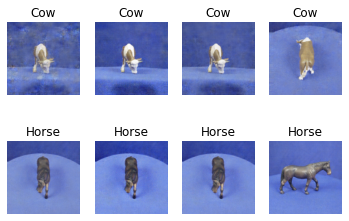

35601 [D loss: 0.048391, acc.: 98.44%] [G loss: 7.392339]
35602 [D loss: 0.062420, acc.: 96.88%] [G loss: 6.241036]
35603 [D loss: 0.209319, acc.: 93.75%] [G loss: 4.718168]
35604 [D loss: 0.068703, acc.: 98.44%] [G loss: 4.977563]
35605 [D loss: 0.172519, acc.: 93.75%] [G loss: 5.589583]
35606 [D loss: 0.061117, acc.: 98.44%] [G loss: 4.057157]
35607 [D loss: 0.109053, acc.: 96.88%] [G loss: 5.013175]
35608 [D loss: 0.027353, acc.: 100.00%] [G loss: 5.695181]
35609 [D loss: 0.020662, acc.: 100.00%] [G loss: 4.853343]
35610 [D loss: 0.160045, acc.: 95.31%] [G loss: 5.812319]
35611 [D loss: 0.069253, acc.: 98.44%] [G loss: 4.350235]
35612 [D loss: 0.084163, acc.: 98.44%] [G loss: 3.866834]
35613 [D loss: 0.095286, acc.: 96.88%] [G loss: 3.944988]
35614 [D loss: 0.065389, acc.: 98.44%] [G loss: 3.567550]
35615 [D loss: 0.028768, acc.: 100.00%] [G loss: 3.680935]
35616 [D loss: 0.177086, acc.: 93.75%] [G loss: 5.478881]
35617 [D loss: 0.087891, acc.: 98.44%] [G loss: 3.062200]
35618 [D lo

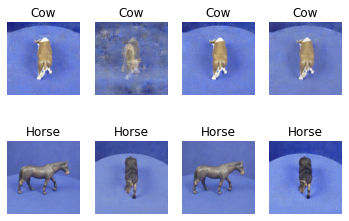

35701 [D loss: 0.042300, acc.: 98.44%] [G loss: 5.408700]
35702 [D loss: 0.082926, acc.: 96.88%] [G loss: 6.335131]
35703 [D loss: 0.033309, acc.: 100.00%] [G loss: 3.512295]
35704 [D loss: 0.050273, acc.: 98.44%] [G loss: 6.392024]
35705 [D loss: 0.154116, acc.: 93.75%] [G loss: 7.004018]
35706 [D loss: 0.052092, acc.: 98.44%] [G loss: 5.094153]
35707 [D loss: 0.073986, acc.: 98.44%] [G loss: 5.194706]
35708 [D loss: 0.026436, acc.: 100.00%] [G loss: 4.150073]
35709 [D loss: 0.127246, acc.: 96.88%] [G loss: 5.017597]
35710 [D loss: 0.116391, acc.: 96.88%] [G loss: 3.975435]
35711 [D loss: 0.090957, acc.: 96.88%] [G loss: 5.018489]
35712 [D loss: 0.189722, acc.: 95.31%] [G loss: 3.138422]
35713 [D loss: 0.146587, acc.: 95.31%] [G loss: 4.780467]
35714 [D loss: 0.136321, acc.: 93.75%] [G loss: 3.891834]
35715 [D loss: 0.076198, acc.: 96.88%] [G loss: 4.996362]
35716 [D loss: 0.299862, acc.: 92.19%] [G loss: 6.069555]
35717 [D loss: 0.099882, acc.: 96.88%] [G loss: 3.145180]
35718 [D los

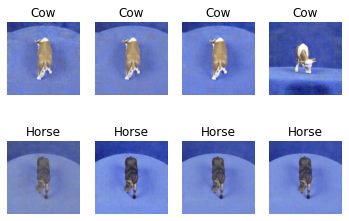

35801 [D loss: 0.050774, acc.: 98.44%] [G loss: 5.213783]
35802 [D loss: 0.008998, acc.: 100.00%] [G loss: 5.449278]
35803 [D loss: 0.140967, acc.: 96.88%] [G loss: 3.608637]
35804 [D loss: 0.116598, acc.: 96.88%] [G loss: 3.506200]
35805 [D loss: 0.064170, acc.: 98.44%] [G loss: 3.377180]
35806 [D loss: 0.134307, acc.: 96.88%] [G loss: 3.342772]
35807 [D loss: 0.135138, acc.: 95.31%] [G loss: 4.225043]
35808 [D loss: 0.037778, acc.: 100.00%] [G loss: 3.463639]
35809 [D loss: 0.026849, acc.: 100.00%] [G loss: 4.164776]
35810 [D loss: 0.141373, acc.: 95.31%] [G loss: 3.500882]
35811 [D loss: 0.053892, acc.: 98.44%] [G loss: 5.583700]
35812 [D loss: 0.019691, acc.: 100.00%] [G loss: 4.623290]
35813 [D loss: 0.059812, acc.: 98.44%] [G loss: 5.068556]
35814 [D loss: 0.159493, acc.: 93.75%] [G loss: 4.386730]
35815 [D loss: 0.062118, acc.: 98.44%] [G loss: 4.719462]
35816 [D loss: 0.013656, acc.: 100.00%] [G loss: 5.206923]
35817 [D loss: 0.154508, acc.: 95.31%] [G loss: 4.865148]
35818 [D 

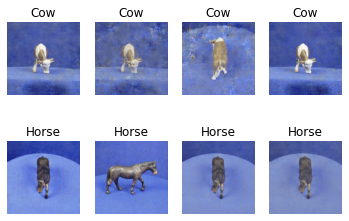

35901 [D loss: 0.039080, acc.: 98.44%] [G loss: 5.622713]
35902 [D loss: 0.107571, acc.: 96.88%] [G loss: 4.050309]
35903 [D loss: 0.110356, acc.: 96.88%] [G loss: 4.345029]
35904 [D loss: 0.136652, acc.: 95.31%] [G loss: 5.090247]
35905 [D loss: 0.052265, acc.: 98.44%] [G loss: 3.715565]
35906 [D loss: 0.030416, acc.: 100.00%] [G loss: 3.536618]
35907 [D loss: 0.017825, acc.: 100.00%] [G loss: 4.055225]
35908 [D loss: 0.048577, acc.: 98.44%] [G loss: 5.423446]
35909 [D loss: 0.067452, acc.: 98.44%] [G loss: 5.132688]
35910 [D loss: 0.054611, acc.: 98.44%] [G loss: 4.849634]
35911 [D loss: 0.310169, acc.: 93.75%] [G loss: 5.188900]
35912 [D loss: 0.048047, acc.: 98.44%] [G loss: 4.899558]
35913 [D loss: 0.017621, acc.: 100.00%] [G loss: 4.955050]
35914 [D loss: 0.022932, acc.: 100.00%] [G loss: 4.345788]
35915 [D loss: 0.050876, acc.: 98.44%] [G loss: 5.000307]
35916 [D loss: 0.066029, acc.: 98.44%] [G loss: 4.990569]
35917 [D loss: 0.087449, acc.: 96.88%] [G loss: 4.418378]
35918 [D l

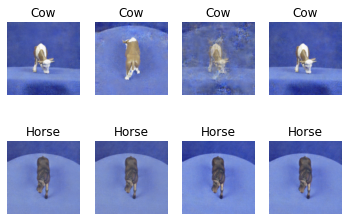

36001 [D loss: 0.006258, acc.: 100.00%] [G loss: 4.809505]
36002 [D loss: 0.104527, acc.: 96.88%] [G loss: 3.982574]
36003 [D loss: 0.046636, acc.: 98.44%] [G loss: 5.543849]
36004 [D loss: 0.052985, acc.: 98.44%] [G loss: 6.455055]
36005 [D loss: 0.020815, acc.: 100.00%] [G loss: 6.764785]
36006 [D loss: 0.064336, acc.: 98.44%] [G loss: 6.393551]
36007 [D loss: 0.022777, acc.: 100.00%] [G loss: 4.765772]
36008 [D loss: 0.007975, acc.: 100.00%] [G loss: 5.750348]
36009 [D loss: 0.103219, acc.: 96.88%] [G loss: 4.340471]
36010 [D loss: 0.142885, acc.: 95.31%] [G loss: 5.610539]
36011 [D loss: 0.069847, acc.: 98.44%] [G loss: 5.400011]
36012 [D loss: 0.059882, acc.: 98.44%] [G loss: 7.609730]
36013 [D loss: 0.064224, acc.: 98.44%] [G loss: 3.881614]
36014 [D loss: 0.147549, acc.: 98.44%] [G loss: 4.113204]
36015 [D loss: 0.053406, acc.: 98.44%] [G loss: 4.066252]
36016 [D loss: 0.063018, acc.: 98.44%] [G loss: 4.395661]
36017 [D loss: 0.296076, acc.: 93.75%] [G loss: 4.346368]
36018 [D l

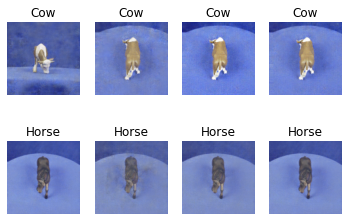

36101 [D loss: 0.130532, acc.: 96.88%] [G loss: 4.642746]
36102 [D loss: 0.187897, acc.: 95.31%] [G loss: 4.874232]
36103 [D loss: 0.099194, acc.: 98.44%] [G loss: 4.731097]
36104 [D loss: 0.123772, acc.: 96.88%] [G loss: 3.245834]
36105 [D loss: 0.061853, acc.: 98.44%] [G loss: 4.230856]
36106 [D loss: 0.074130, acc.: 98.44%] [G loss: 3.743172]
36107 [D loss: 0.025323, acc.: 100.00%] [G loss: 3.710625]
36108 [D loss: 0.070181, acc.: 98.44%] [G loss: 5.080128]
36109 [D loss: 0.062627, acc.: 98.44%] [G loss: 3.938864]
36110 [D loss: 0.018684, acc.: 100.00%] [G loss: 4.506740]
36111 [D loss: 0.134418, acc.: 96.88%] [G loss: 3.563717]
36112 [D loss: 0.025882, acc.: 100.00%] [G loss: 4.495976]
36113 [D loss: 0.058999, acc.: 98.44%] [G loss: 3.991087]
36114 [D loss: 0.062164, acc.: 98.44%] [G loss: 5.506538]
36115 [D loss: 0.007512, acc.: 100.00%] [G loss: 5.358644]
36116 [D loss: 0.342321, acc.: 90.62%] [G loss: 6.656973]
36117 [D loss: 0.069302, acc.: 98.44%] [G loss: 3.429722]
36118 [D l

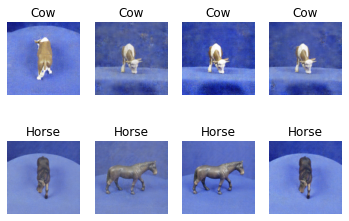

36201 [D loss: 0.083411, acc.: 96.88%] [G loss: 5.360609]
36202 [D loss: 0.281105, acc.: 95.31%] [G loss: 3.483298]
36203 [D loss: 0.062333, acc.: 98.44%] [G loss: 3.947340]
36204 [D loss: 0.205413, acc.: 96.88%] [G loss: 4.793344]
36205 [D loss: 0.070585, acc.: 98.44%] [G loss: 3.305944]
36206 [D loss: 0.172213, acc.: 93.75%] [G loss: 3.629098]
36207 [D loss: 0.082232, acc.: 98.44%] [G loss: 3.358763]
36208 [D loss: 0.373031, acc.: 89.06%] [G loss: 4.503205]
36209 [D loss: 0.134681, acc.: 98.44%] [G loss: 2.464210]
36210 [D loss: 0.154616, acc.: 93.75%] [G loss: 3.721194]
36211 [D loss: 0.125773, acc.: 96.88%] [G loss: 3.442576]
36212 [D loss: 0.175739, acc.: 95.31%] [G loss: 3.907000]
36213 [D loss: 0.049176, acc.: 100.00%] [G loss: 3.162154]
36214 [D loss: 0.199753, acc.: 92.19%] [G loss: 3.260464]
36215 [D loss: 0.131287, acc.: 95.31%] [G loss: 3.073364]
36216 [D loss: 0.144700, acc.: 95.31%] [G loss: 3.404113]
36217 [D loss: 0.035200, acc.: 100.00%] [G loss: 3.627343]
36218 [D los

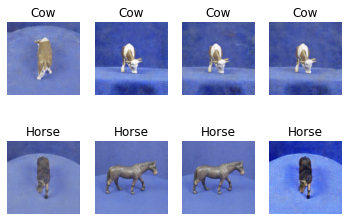

36301 [D loss: 0.069326, acc.: 98.44%] [G loss: 4.001255]
36302 [D loss: 0.248571, acc.: 92.19%] [G loss: 4.408335]
36303 [D loss: 0.057170, acc.: 98.44%] [G loss: 4.312056]
36304 [D loss: 0.139877, acc.: 95.31%] [G loss: 4.075601]
36305 [D loss: 0.107716, acc.: 96.88%] [G loss: 5.231131]
36306 [D loss: 0.161719, acc.: 96.88%] [G loss: 4.570345]
36307 [D loss: 0.064379, acc.: 98.44%] [G loss: 4.149369]
36308 [D loss: 0.033736, acc.: 100.00%] [G loss: 3.528962]
36309 [D loss: 0.132793, acc.: 96.88%] [G loss: 3.051443]
36310 [D loss: 0.027010, acc.: 100.00%] [G loss: 4.441481]
36311 [D loss: 0.121230, acc.: 96.88%] [G loss: 3.365115]
36312 [D loss: 0.114914, acc.: 96.88%] [G loss: 2.969766]
36313 [D loss: 0.022063, acc.: 100.00%] [G loss: 4.184908]
36314 [D loss: 0.092650, acc.: 96.88%] [G loss: 3.702073]
36315 [D loss: 0.020600, acc.: 100.00%] [G loss: 4.127521]
36316 [D loss: 0.109079, acc.: 96.88%] [G loss: 4.291465]
36317 [D loss: 0.124812, acc.: 95.31%] [G loss: 3.621143]
36318 [D l

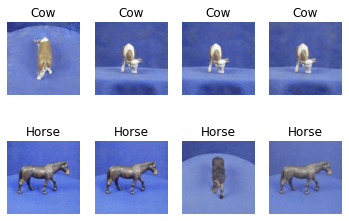

36401 [D loss: 0.055348, acc.: 98.44%] [G loss: 4.405719]
36402 [D loss: 0.218879, acc.: 93.75%] [G loss: 3.999519]
36403 [D loss: 0.109657, acc.: 96.88%] [G loss: 3.330312]
36404 [D loss: 0.029956, acc.: 100.00%] [G loss: 3.566154]
36405 [D loss: 0.112452, acc.: 96.88%] [G loss: 3.836654]
36406 [D loss: 0.095567, acc.: 96.88%] [G loss: 3.916947]
36407 [D loss: 0.065032, acc.: 98.44%] [G loss: 3.588330]
36408 [D loss: 0.093323, acc.: 98.44%] [G loss: 4.467477]
36409 [D loss: 0.084270, acc.: 96.88%] [G loss: 4.292422]
36410 [D loss: 0.057018, acc.: 98.44%] [G loss: 4.095417]
36411 [D loss: 0.019251, acc.: 100.00%] [G loss: 3.831311]
36412 [D loss: 0.131498, acc.: 96.88%] [G loss: 4.278953]
36413 [D loss: 0.251878, acc.: 92.19%] [G loss: 2.946106]
36414 [D loss: 0.103349, acc.: 96.88%] [G loss: 3.512701]
36415 [D loss: 0.088404, acc.: 98.44%] [G loss: 3.649923]
36416 [D loss: 0.052642, acc.: 98.44%] [G loss: 3.905708]
36417 [D loss: 0.218150, acc.: 92.19%] [G loss: 3.820422]
36418 [D los

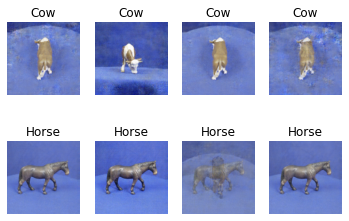

36501 [D loss: 0.262941, acc.: 92.19%] [G loss: 2.991734]
36502 [D loss: 0.081804, acc.: 98.44%] [G loss: 3.757928]
36503 [D loss: 0.049584, acc.: 98.44%] [G loss: 3.988266]
36504 [D loss: 0.060877, acc.: 98.44%] [G loss: 4.377176]
36505 [D loss: 0.063819, acc.: 98.44%] [G loss: 3.575767]
36506 [D loss: 0.020721, acc.: 100.00%] [G loss: 4.381412]
36507 [D loss: 0.205124, acc.: 93.75%] [G loss: 5.595953]
36508 [D loss: 0.015529, acc.: 100.00%] [G loss: 5.135059]
36509 [D loss: 0.053368, acc.: 98.44%] [G loss: 4.891354]
36510 [D loss: 0.198350, acc.: 95.31%] [G loss: 4.517411]
36511 [D loss: 0.096109, acc.: 96.88%] [G loss: 4.492508]
36512 [D loss: 0.074702, acc.: 98.44%] [G loss: 3.194149]
36513 [D loss: 0.051083, acc.: 98.44%] [G loss: 4.560208]
36514 [D loss: 0.107092, acc.: 96.88%] [G loss: 4.874206]
36515 [D loss: 0.068191, acc.: 98.44%] [G loss: 3.525324]
36516 [D loss: 0.108456, acc.: 95.31%] [G loss: 4.573471]
36517 [D loss: 0.183003, acc.: 93.75%] [G loss: 3.749368]
36518 [D los

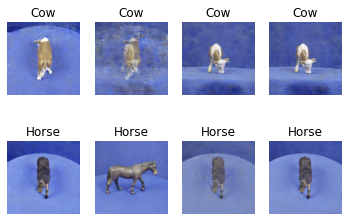

36601 [D loss: 0.086025, acc.: 98.44%] [G loss: 3.768019]
36602 [D loss: 0.081916, acc.: 98.44%] [G loss: 5.491679]
36603 [D loss: 0.071244, acc.: 98.44%] [G loss: 4.034978]
36604 [D loss: 0.064899, acc.: 98.44%] [G loss: 5.020278]
36605 [D loss: 0.226577, acc.: 92.19%] [G loss: 4.233925]
36606 [D loss: 0.185184, acc.: 95.31%] [G loss: 3.625334]
36607 [D loss: 0.137624, acc.: 96.88%] [G loss: 3.602992]
36608 [D loss: 0.038095, acc.: 100.00%] [G loss: 3.566816]
36609 [D loss: 0.195338, acc.: 93.75%] [G loss: 2.541495]
36610 [D loss: 0.043213, acc.: 100.00%] [G loss: 3.344992]
36611 [D loss: 0.185553, acc.: 93.75%] [G loss: 3.815022]
36612 [D loss: 0.034135, acc.: 100.00%] [G loss: 4.261338]
36613 [D loss: 0.073989, acc.: 98.44%] [G loss: 3.114234]
36614 [D loss: 0.076075, acc.: 98.44%] [G loss: 3.344283]
36615 [D loss: 0.098615, acc.: 96.88%] [G loss: 3.607459]
36616 [D loss: 0.165551, acc.: 95.31%] [G loss: 4.832348]
36617 [D loss: 0.059637, acc.: 98.44%] [G loss: 3.985862]
36618 [D lo

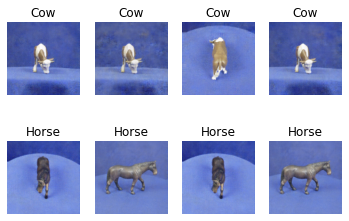

36701 [D loss: 0.024977, acc.: 100.00%] [G loss: 4.469516]
36702 [D loss: 0.106546, acc.: 96.88%] [G loss: 4.226145]
36703 [D loss: 0.061714, acc.: 98.44%] [G loss: 4.421618]
36704 [D loss: 0.134111, acc.: 96.88%] [G loss: 3.725677]
36705 [D loss: 0.120472, acc.: 96.88%] [G loss: 3.682720]
36706 [D loss: 0.164804, acc.: 95.31%] [G loss: 3.916928]
36707 [D loss: 0.169850, acc.: 95.31%] [G loss: 4.029582]
36708 [D loss: 0.133383, acc.: 95.31%] [G loss: 4.494507]
36709 [D loss: 0.043982, acc.: 100.00%] [G loss: 3.401120]
36710 [D loss: 0.103125, acc.: 96.88%] [G loss: 4.283671]
36711 [D loss: 0.080156, acc.: 98.44%] [G loss: 4.074985]
36712 [D loss: 0.017898, acc.: 100.00%] [G loss: 4.610056]
36713 [D loss: 0.060083, acc.: 98.44%] [G loss: 4.376388]
36714 [D loss: 0.070979, acc.: 98.44%] [G loss: 4.060823]
36715 [D loss: 0.277966, acc.: 90.62%] [G loss: 5.368013]
36716 [D loss: 0.027634, acc.: 100.00%] [G loss: 4.700773]
36717 [D loss: 0.115730, acc.: 96.88%] [G loss: 3.712961]
36718 [D l

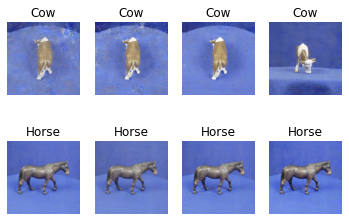

36801 [D loss: 0.090724, acc.: 96.88%] [G loss: 3.293140]
36802 [D loss: 0.040359, acc.: 100.00%] [G loss: 4.026027]
36803 [D loss: 0.061601, acc.: 98.44%] [G loss: 3.569525]
36804 [D loss: 0.135046, acc.: 95.31%] [G loss: 3.742162]
36805 [D loss: 0.083837, acc.: 98.44%] [G loss: 4.177495]
36806 [D loss: 0.120401, acc.: 96.88%] [G loss: 4.015689]
36807 [D loss: 0.064159, acc.: 98.44%] [G loss: 3.794059]
36808 [D loss: 0.016773, acc.: 100.00%] [G loss: 4.281341]
36809 [D loss: 0.144531, acc.: 95.31%] [G loss: 4.340769]
36810 [D loss: 0.059917, acc.: 98.44%] [G loss: 4.631501]
36811 [D loss: 0.070292, acc.: 98.44%] [G loss: 4.819079]
36812 [D loss: 0.022993, acc.: 100.00%] [G loss: 3.831574]
36813 [D loss: 0.006322, acc.: 100.00%] [G loss: 4.994649]
36814 [D loss: 0.007007, acc.: 100.00%] [G loss: 6.302406]
36815 [D loss: 0.225851, acc.: 95.31%] [G loss: 4.649399]
36816 [D loss: 0.059236, acc.: 98.44%] [G loss: 4.225919]
36817 [D loss: 0.022234, acc.: 100.00%] [G loss: 4.154726]
36818 [D

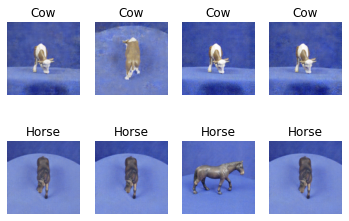

36901 [D loss: 0.129909, acc.: 96.88%] [G loss: 3.524278]
36902 [D loss: 0.061368, acc.: 98.44%] [G loss: 3.543576]
36903 [D loss: 0.110816, acc.: 96.88%] [G loss: 3.867375]
36904 [D loss: 0.046946, acc.: 98.44%] [G loss: 3.683640]
36905 [D loss: 0.151771, acc.: 96.88%] [G loss: 3.259373]
36906 [D loss: 0.163204, acc.: 95.31%] [G loss: 3.364926]
36907 [D loss: 0.124704, acc.: 96.88%] [G loss: 3.346204]
36908 [D loss: 0.114846, acc.: 96.88%] [G loss: 3.087085]
36909 [D loss: 0.079633, acc.: 98.44%] [G loss: 3.313106]
36910 [D loss: 0.099185, acc.: 96.88%] [G loss: 3.142022]
36911 [D loss: 0.110538, acc.: 96.88%] [G loss: 3.107563]
36912 [D loss: 0.029578, acc.: 100.00%] [G loss: 3.724398]
36913 [D loss: 0.055159, acc.: 98.44%] [G loss: 3.879421]
36914 [D loss: 0.079659, acc.: 98.44%] [G loss: 3.651647]
36915 [D loss: 0.065448, acc.: 98.44%] [G loss: 3.702313]
36916 [D loss: 0.182587, acc.: 95.31%] [G loss: 3.509113]
36917 [D loss: 0.021005, acc.: 100.00%] [G loss: 5.156520]
36918 [D los

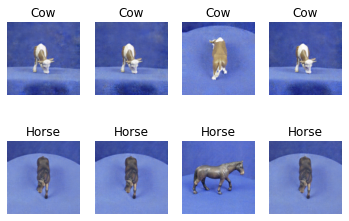

37001 [D loss: 0.071681, acc.: 98.44%] [G loss: 3.089475]
37002 [D loss: 0.006666, acc.: 100.00%] [G loss: 5.867923]
37003 [D loss: 0.072493, acc.: 98.44%] [G loss: 5.659331]
37004 [D loss: 0.067453, acc.: 98.44%] [G loss: 4.106848]
37005 [D loss: 0.120282, acc.: 96.88%] [G loss: 3.770146]
37006 [D loss: 0.087108, acc.: 96.88%] [G loss: 5.004244]
37007 [D loss: 0.193262, acc.: 93.75%] [G loss: 3.779451]
37008 [D loss: 0.075332, acc.: 96.88%] [G loss: 5.115528]
37009 [D loss: 0.163259, acc.: 95.31%] [G loss: 3.702909]
37010 [D loss: 0.113402, acc.: 96.88%] [G loss: 4.378288]
37011 [D loss: 0.119667, acc.: 96.88%] [G loss: 4.422460]
37012 [D loss: 0.028538, acc.: 100.00%] [G loss: 3.606844]
37013 [D loss: 0.056357, acc.: 98.44%] [G loss: 3.887187]
37014 [D loss: 0.022050, acc.: 100.00%] [G loss: 4.323207]
37015 [D loss: 0.177712, acc.: 95.31%] [G loss: 4.807863]
37016 [D loss: 0.200162, acc.: 95.31%] [G loss: 4.982148]
37017 [D loss: 0.062937, acc.: 98.44%] [G loss: 4.293365]
37018 [D lo

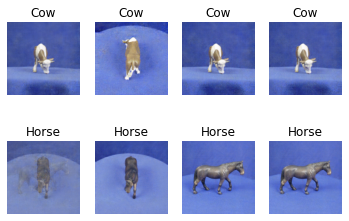

37101 [D loss: 0.107133, acc.: 96.88%] [G loss: 6.347466]
37102 [D loss: 0.136492, acc.: 95.31%] [G loss: 5.203650]
37103 [D loss: 0.123659, acc.: 96.88%] [G loss: 3.648389]
37104 [D loss: 0.140006, acc.: 95.31%] [G loss: 3.117134]
37105 [D loss: 0.055885, acc.: 98.44%] [G loss: 4.147732]
37106 [D loss: 0.082915, acc.: 96.88%] [G loss: 4.041831]
37107 [D loss: 0.054135, acc.: 98.44%] [G loss: 4.401592]
37108 [D loss: 0.116491, acc.: 96.88%] [G loss: 3.206952]
37109 [D loss: 0.144780, acc.: 95.31%] [G loss: 3.656048]
37110 [D loss: 0.186430, acc.: 93.75%] [G loss: 3.960767]
37111 [D loss: 0.093027, acc.: 96.88%] [G loss: 4.060346]
37112 [D loss: 0.087115, acc.: 96.88%] [G loss: 4.201805]
37113 [D loss: 0.020434, acc.: 100.00%] [G loss: 5.197680]
37114 [D loss: 0.089200, acc.: 98.44%] [G loss: 3.825333]
37115 [D loss: 0.146220, acc.: 95.31%] [G loss: 6.580916]
37116 [D loss: 0.091983, acc.: 96.88%] [G loss: 5.531968]
37117 [D loss: 0.100776, acc.: 96.88%] [G loss: 4.346691]
37118 [D loss

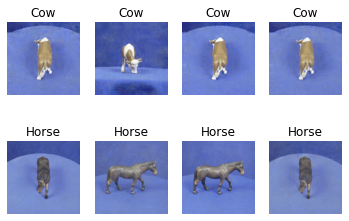

37201 [D loss: 0.109557, acc.: 96.88%] [G loss: 3.670416]
37202 [D loss: 0.121214, acc.: 96.88%] [G loss: 3.159131]
37203 [D loss: 0.061639, acc.: 98.44%] [G loss: 2.990167]
37204 [D loss: 0.033790, acc.: 100.00%] [G loss: 3.384930]
37205 [D loss: 0.156926, acc.: 95.31%] [G loss: 4.101498]
37206 [D loss: 0.063038, acc.: 98.44%] [G loss: 4.144482]
37207 [D loss: 0.144416, acc.: 95.31%] [G loss: 4.679532]
37208 [D loss: 0.127228, acc.: 96.88%] [G loss: 4.315590]
37209 [D loss: 0.193923, acc.: 93.75%] [G loss: 3.564805]
37210 [D loss: 0.052076, acc.: 98.44%] [G loss: 3.651821]
37211 [D loss: 0.041826, acc.: 100.00%] [G loss: 3.340458]
37212 [D loss: 0.014621, acc.: 100.00%] [G loss: 3.700779]
37213 [D loss: 0.020572, acc.: 100.00%] [G loss: 4.042270]
37214 [D loss: 0.071600, acc.: 98.44%] [G loss: 4.120018]
37215 [D loss: 0.087788, acc.: 98.44%] [G loss: 4.119416]
37216 [D loss: 0.141116, acc.: 95.31%] [G loss: 4.308721]
37217 [D loss: 0.066684, acc.: 98.44%] [G loss: 3.566035]
37218 [D l

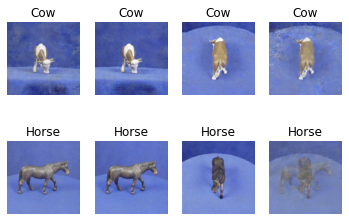

37301 [D loss: 0.060518, acc.: 98.44%] [G loss: 3.195669]
37302 [D loss: 0.100676, acc.: 96.88%] [G loss: 3.742231]
37303 [D loss: 0.036352, acc.: 100.00%] [G loss: 3.671069]
37304 [D loss: 0.137112, acc.: 95.31%] [G loss: 4.248963]
37305 [D loss: 0.148984, acc.: 95.31%] [G loss: 3.107982]
37306 [D loss: 0.241604, acc.: 90.62%] [G loss: 3.141683]
37307 [D loss: 0.047866, acc.: 100.00%] [G loss: 3.258723]
37308 [D loss: 0.027538, acc.: 100.00%] [G loss: 4.019992]
37309 [D loss: 0.059366, acc.: 98.44%] [G loss: 4.069982]
37310 [D loss: 0.021416, acc.: 100.00%] [G loss: 4.000922]
37311 [D loss: 0.006934, acc.: 100.00%] [G loss: 5.046561]
37312 [D loss: 0.113146, acc.: 96.88%] [G loss: 4.344366]
37313 [D loss: 0.081616, acc.: 96.88%] [G loss: 4.184533]
37314 [D loss: 0.183716, acc.: 93.75%] [G loss: 4.810011]
37315 [D loss: 0.153071, acc.: 93.75%] [G loss: 5.083302]
37316 [D loss: 0.178009, acc.: 93.75%] [G loss: 5.592116]
37317 [D loss: 0.134681, acc.: 96.88%] [G loss: 3.087308]
37318 [D 

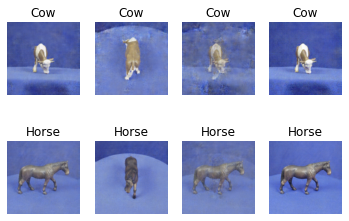

37401 [D loss: 0.050514, acc.: 98.44%] [G loss: 4.864964]
37402 [D loss: 0.031367, acc.: 100.00%] [G loss: 3.876177]
37403 [D loss: 0.062301, acc.: 98.44%] [G loss: 5.055693]
37404 [D loss: 0.099073, acc.: 96.88%] [G loss: 3.790812]
37405 [D loss: 0.102569, acc.: 96.88%] [G loss: 3.418299]
37406 [D loss: 0.154959, acc.: 95.31%] [G loss: 4.949383]
37407 [D loss: 0.059216, acc.: 98.44%] [G loss: 4.897688]
37408 [D loss: 0.101685, acc.: 96.88%] [G loss: 3.228127]
37409 [D loss: 0.120351, acc.: 95.31%] [G loss: 4.552628]
37410 [D loss: 0.030221, acc.: 100.00%] [G loss: 4.319597]
37411 [D loss: 0.049204, acc.: 98.44%] [G loss: 5.915489]
37412 [D loss: 0.128136, acc.: 95.31%] [G loss: 4.812639]
37413 [D loss: 0.171826, acc.: 93.75%] [G loss: 6.189069]
37414 [D loss: 0.042326, acc.: 100.00%] [G loss: 3.998692]
37415 [D loss: 0.057381, acc.: 98.44%] [G loss: 6.198930]
37416 [D loss: 0.057771, acc.: 98.44%] [G loss: 4.252487]
37417 [D loss: 0.066240, acc.: 98.44%] [G loss: 6.424920]
37418 [D lo

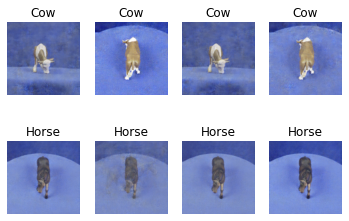

37501 [D loss: 0.105059, acc.: 96.88%] [G loss: 5.543205]
37502 [D loss: 0.067382, acc.: 98.44%] [G loss: 4.336013]
37503 [D loss: 0.019862, acc.: 100.00%] [G loss: 6.378447]
37504 [D loss: 0.022227, acc.: 100.00%] [G loss: 7.546057]
37505 [D loss: 0.278242, acc.: 92.19%] [G loss: 3.637276]
37506 [D loss: 0.046166, acc.: 98.44%] [G loss: 4.258871]
37507 [D loss: 0.018388, acc.: 100.00%] [G loss: 6.140800]
37508 [D loss: 0.034190, acc.: 100.00%] [G loss: 3.427421]
37509 [D loss: 0.010719, acc.: 100.00%] [G loss: 4.918863]
37510 [D loss: 0.007544, acc.: 100.00%] [G loss: 5.175906]
37511 [D loss: 0.016009, acc.: 100.00%] [G loss: 4.085494]
37512 [D loss: 0.107462, acc.: 96.88%] [G loss: 4.805367]
37513 [D loss: 0.049787, acc.: 98.44%] [G loss: 4.823173]
37514 [D loss: 0.018512, acc.: 100.00%] [G loss: 3.780653]
37515 [D loss: 0.168839, acc.: 95.31%] [G loss: 4.517029]
37516 [D loss: 0.053001, acc.: 98.44%] [G loss: 4.904695]
37517 [D loss: 0.175141, acc.: 95.31%] [G loss: 4.212453]
37518 

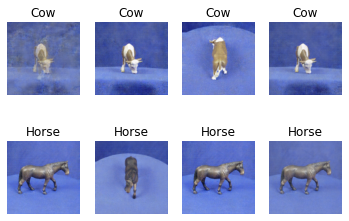

37601 [D loss: 0.053864, acc.: 98.44%] [G loss: 4.192204]
37602 [D loss: 0.100093, acc.: 96.88%] [G loss: 5.129863]
37603 [D loss: 0.089227, acc.: 96.88%] [G loss: 5.619954]
37604 [D loss: 0.045624, acc.: 98.44%] [G loss: 4.182298]
37605 [D loss: 0.026026, acc.: 100.00%] [G loss: 4.806299]
37606 [D loss: 0.097439, acc.: 96.88%] [G loss: 4.225593]
37607 [D loss: 0.320871, acc.: 93.75%] [G loss: 4.324734]
37608 [D loss: 0.141754, acc.: 95.31%] [G loss: 3.476061]
37609 [D loss: 0.090132, acc.: 96.88%] [G loss: 3.969013]
37610 [D loss: 0.070656, acc.: 98.44%] [G loss: 3.511374]
37611 [D loss: 0.136898, acc.: 95.31%] [G loss: 3.196308]
37612 [D loss: 0.082273, acc.: 98.44%] [G loss: 3.244622]
37613 [D loss: 0.022664, acc.: 100.00%] [G loss: 3.708182]
37614 [D loss: 0.092981, acc.: 98.44%] [G loss: 3.785796]
37615 [D loss: 0.063102, acc.: 98.44%] [G loss: 3.698493]
37616 [D loss: 0.129518, acc.: 96.88%] [G loss: 4.588951]
37617 [D loss: 0.055398, acc.: 98.44%] [G loss: 4.918478]
37618 [D los

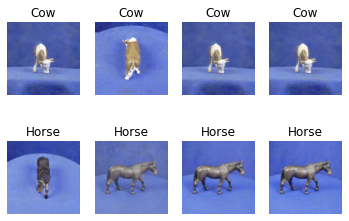

37701 [D loss: 0.012988, acc.: 100.00%] [G loss: 4.562730]
37702 [D loss: 0.112008, acc.: 96.88%] [G loss: 3.771137]
37703 [D loss: 0.016046, acc.: 100.00%] [G loss: 4.161356]
37704 [D loss: 0.084803, acc.: 96.88%] [G loss: 6.307564]
37705 [D loss: 0.052651, acc.: 98.44%] [G loss: 4.216395]
37706 [D loss: 0.026177, acc.: 100.00%] [G loss: 3.825488]
37707 [D loss: 0.015977, acc.: 100.00%] [G loss: 4.017150]
37708 [D loss: 0.011837, acc.: 100.00%] [G loss: 4.539424]
37709 [D loss: 0.109939, acc.: 96.88%] [G loss: 5.455931]
37710 [D loss: 0.079340, acc.: 98.44%] [G loss: 4.964215]
37711 [D loss: 0.045184, acc.: 98.44%] [G loss: 5.522507]
37712 [D loss: 0.117173, acc.: 96.88%] [G loss: 4.815602]
37713 [D loss: 0.071818, acc.: 98.44%] [G loss: 4.416217]
37714 [D loss: 0.017613, acc.: 100.00%] [G loss: 4.188498]
37715 [D loss: 0.076630, acc.: 98.44%] [G loss: 4.489265]
37716 [D loss: 0.011023, acc.: 100.00%] [G loss: 4.520471]
37717 [D loss: 0.017242, acc.: 100.00%] [G loss: 4.272827]
37718 

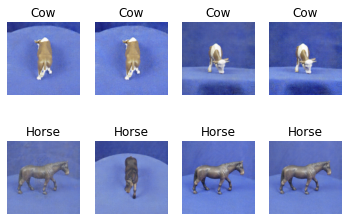

37801 [D loss: 0.106640, acc.: 96.88%] [G loss: 3.376186]
37802 [D loss: 0.059512, acc.: 98.44%] [G loss: 3.535760]
37803 [D loss: 0.110335, acc.: 96.88%] [G loss: 3.668709]
37804 [D loss: 0.069109, acc.: 98.44%] [G loss: 3.320236]
37805 [D loss: 0.051527, acc.: 98.44%] [G loss: 4.622347]
37806 [D loss: 0.085959, acc.: 98.44%] [G loss: 6.201826]
37807 [D loss: 0.073507, acc.: 98.44%] [G loss: 3.303799]
37808 [D loss: 0.052175, acc.: 98.44%] [G loss: 4.806770]
37809 [D loss: 0.070877, acc.: 98.44%] [G loss: 3.945172]
37810 [D loss: 0.014293, acc.: 100.00%] [G loss: 4.869494]
37811 [D loss: 0.015436, acc.: 100.00%] [G loss: 5.814572]
37812 [D loss: 0.156453, acc.: 95.31%] [G loss: 5.535000]
37813 [D loss: 0.049391, acc.: 98.44%] [G loss: 4.618979]
37814 [D loss: 0.090998, acc.: 96.88%] [G loss: 4.265751]
37815 [D loss: 0.190910, acc.: 95.31%] [G loss: 5.274394]
37816 [D loss: 0.058944, acc.: 98.44%] [G loss: 4.002306]
37817 [D loss: 0.196604, acc.: 93.75%] [G loss: 4.893367]
37818 [D los

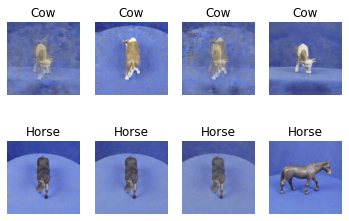

37901 [D loss: 0.033644, acc.: 100.00%] [G loss: 3.585890]
37902 [D loss: 0.027340, acc.: 100.00%] [G loss: 4.147827]
37903 [D loss: 0.106352, acc.: 96.88%] [G loss: 4.057176]
37904 [D loss: 0.063785, acc.: 98.44%] [G loss: 4.222517]
37905 [D loss: 0.088561, acc.: 98.44%] [G loss: 4.142136]
37906 [D loss: 0.163989, acc.: 95.31%] [G loss: 3.917700]
37907 [D loss: 0.140385, acc.: 95.31%] [G loss: 3.744590]
37908 [D loss: 0.079010, acc.: 98.44%] [G loss: 3.341990]
37909 [D loss: 0.104178, acc.: 96.88%] [G loss: 3.337090]
37910 [D loss: 0.158473, acc.: 95.31%] [G loss: 3.249714]
37911 [D loss: 0.055940, acc.: 98.44%] [G loss: 4.757183]
37912 [D loss: 0.023523, acc.: 100.00%] [G loss: 3.414750]
37913 [D loss: 0.086322, acc.: 98.44%] [G loss: 4.263981]
37914 [D loss: 0.058260, acc.: 98.44%] [G loss: 3.873724]
37915 [D loss: 0.019372, acc.: 100.00%] [G loss: 3.747751]
37916 [D loss: 0.124543, acc.: 95.31%] [G loss: 3.746783]
37917 [D loss: 0.117735, acc.: 96.88%] [G loss: 3.380964]
37918 [D l

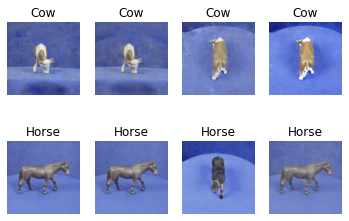

38001 [D loss: 0.016810, acc.: 100.00%] [G loss: 4.841011]
38002 [D loss: 0.054370, acc.: 98.44%] [G loss: 5.541670]
38003 [D loss: 0.182582, acc.: 95.31%] [G loss: 6.178433]
38004 [D loss: 0.063779, acc.: 98.44%] [G loss: 5.761115]
38005 [D loss: 0.179440, acc.: 93.75%] [G loss: 3.354092]
38006 [D loss: 0.076329, acc.: 96.88%] [G loss: 5.679121]
38007 [D loss: 0.130581, acc.: 95.31%] [G loss: 4.577156]
38008 [D loss: 0.145159, acc.: 93.75%] [G loss: 7.837199]
38009 [D loss: 0.078038, acc.: 98.44%] [G loss: 3.788726]
38010 [D loss: 0.067655, acc.: 98.44%] [G loss: 5.046369]
38011 [D loss: 0.074987, acc.: 98.44%] [G loss: 4.128688]
38012 [D loss: 0.106107, acc.: 96.88%] [G loss: 4.931109]
38013 [D loss: 0.023161, acc.: 100.00%] [G loss: 4.855434]
38014 [D loss: 0.021981, acc.: 100.00%] [G loss: 4.844435]
38015 [D loss: 0.022394, acc.: 100.00%] [G loss: 4.536324]
38016 [D loss: 0.130593, acc.: 95.31%] [G loss: 4.216257]
38017 [D loss: 0.020097, acc.: 100.00%] [G loss: 4.413212]
38018 [D 

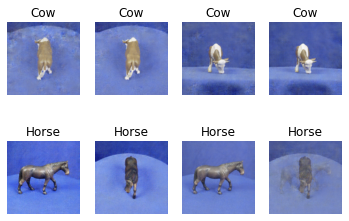

38101 [D loss: 0.205033, acc.: 93.75%] [G loss: 6.379080]
38102 [D loss: 0.072806, acc.: 98.44%] [G loss: 4.750497]
38103 [D loss: 0.054921, acc.: 98.44%] [G loss: 4.002099]
38104 [D loss: 0.171399, acc.: 93.75%] [G loss: 4.555097]
38105 [D loss: 0.112436, acc.: 98.44%] [G loss: 5.686463]
38106 [D loss: 0.055546, acc.: 98.44%] [G loss: 4.136562]
38107 [D loss: 0.090712, acc.: 98.44%] [G loss: 3.943931]
38108 [D loss: 0.127279, acc.: 96.88%] [G loss: 2.955967]
38109 [D loss: 0.149737, acc.: 95.31%] [G loss: 3.513296]
38110 [D loss: 0.076674, acc.: 98.44%] [G loss: 3.183919]
38111 [D loss: 0.141833, acc.: 96.88%] [G loss: 4.090207]
38112 [D loss: 0.021311, acc.: 100.00%] [G loss: 4.573907]
38113 [D loss: 0.115188, acc.: 96.88%] [G loss: 3.389428]
38114 [D loss: 0.107103, acc.: 96.88%] [G loss: 4.325287]
38115 [D loss: 0.157884, acc.: 95.31%] [G loss: 3.700144]
38116 [D loss: 0.083414, acc.: 96.88%] [G loss: 3.609376]
38117 [D loss: 0.081110, acc.: 98.44%] [G loss: 4.205719]
38118 [D loss

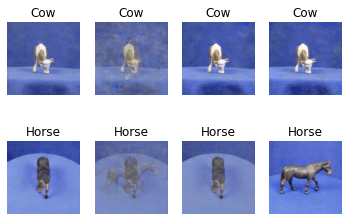

38201 [D loss: 0.062619, acc.: 98.44%] [G loss: 4.579133]
38202 [D loss: 0.019287, acc.: 100.00%] [G loss: 4.046288]
38203 [D loss: 0.137863, acc.: 96.88%] [G loss: 4.849622]
38204 [D loss: 0.042214, acc.: 98.44%] [G loss: 4.599604]
38205 [D loss: 0.139257, acc.: 95.31%] [G loss: 4.417157]
38206 [D loss: 0.099598, acc.: 96.88%] [G loss: 3.208808]
38207 [D loss: 0.089723, acc.: 98.44%] [G loss: 4.109817]
38208 [D loss: 0.056787, acc.: 98.44%] [G loss: 3.588004]
38209 [D loss: 0.094732, acc.: 96.88%] [G loss: 3.965750]
38210 [D loss: 0.086227, acc.: 96.88%] [G loss: 3.977679]
38211 [D loss: 0.062210, acc.: 98.44%] [G loss: 3.735734]
38212 [D loss: 0.151484, acc.: 95.31%] [G loss: 3.516736]
38213 [D loss: 0.023335, acc.: 100.00%] [G loss: 4.112320]
38214 [D loss: 0.022125, acc.: 100.00%] [G loss: 3.362303]
38215 [D loss: 0.140184, acc.: 96.88%] [G loss: 3.782054]
38216 [D loss: 0.014160, acc.: 100.00%] [G loss: 3.892985]
38217 [D loss: 0.182633, acc.: 95.31%] [G loss: 4.200788]
38218 [D l

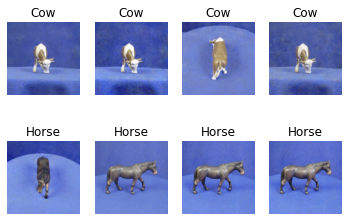

38301 [D loss: 0.017467, acc.: 100.00%] [G loss: 4.144096]
38302 [D loss: 0.253671, acc.: 93.75%] [G loss: 4.570230]
38303 [D loss: 0.055718, acc.: 98.44%] [G loss: 4.799313]
38304 [D loss: 0.089187, acc.: 96.88%] [G loss: 5.063807]
38305 [D loss: 0.120579, acc.: 95.31%] [G loss: 4.604957]
38306 [D loss: 0.069104, acc.: 96.88%] [G loss: 5.587260]
38307 [D loss: 0.292716, acc.: 93.75%] [G loss: 4.811247]
38308 [D loss: 1.754344, acc.: 87.50%] [G loss: 3.838236]
38309 [D loss: 0.065029, acc.: 98.44%] [G loss: 3.679140]
38310 [D loss: 0.609118, acc.: 89.06%] [G loss: 3.965311]
38311 [D loss: 0.311602, acc.: 85.94%] [G loss: 3.045254]
38312 [D loss: 0.289452, acc.: 95.31%] [G loss: 3.205959]
38313 [D loss: 0.356301, acc.: 95.31%] [G loss: 3.296571]
38314 [D loss: 0.091277, acc.: 98.44%] [G loss: 3.418722]
38315 [D loss: 0.094917, acc.: 98.44%] [G loss: 3.598445]
38316 [D loss: 0.018270, acc.: 100.00%] [G loss: 3.839299]
38317 [D loss: 0.150196, acc.: 96.88%] [G loss: 3.812707]
38318 [D los

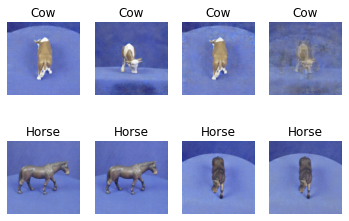

38401 [D loss: 0.075391, acc.: 98.44%] [G loss: 2.836201]
38402 [D loss: 0.261546, acc.: 92.19%] [G loss: 3.002501]
38403 [D loss: 0.121937, acc.: 96.88%] [G loss: 2.799638]
38404 [D loss: 0.043327, acc.: 100.00%] [G loss: 2.821631]
38405 [D loss: 0.121691, acc.: 96.88%] [G loss: 2.867019]
38406 [D loss: 0.107439, acc.: 96.88%] [G loss: 3.266750]
38407 [D loss: 0.086501, acc.: 98.44%] [G loss: 2.814366]
38408 [D loss: 0.227934, acc.: 93.75%] [G loss: 3.163298]
38409 [D loss: 0.078117, acc.: 98.44%] [G loss: 2.985156]
38410 [D loss: 0.030636, acc.: 100.00%] [G loss: 3.096811]
38411 [D loss: 0.105924, acc.: 96.88%] [G loss: 2.956871]
38412 [D loss: 0.026667, acc.: 100.00%] [G loss: 3.345191]
38413 [D loss: 0.114133, acc.: 96.88%] [G loss: 3.426297]
38414 [D loss: 0.249775, acc.: 92.19%] [G loss: 3.309587]
38415 [D loss: 0.030162, acc.: 100.00%] [G loss: 3.483846]
38416 [D loss: 0.028027, acc.: 100.00%] [G loss: 3.291114]
38417 [D loss: 0.063430, acc.: 98.44%] [G loss: 3.534818]
38418 [D 

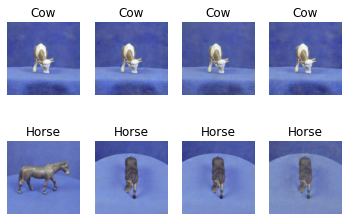

38501 [D loss: 0.071445, acc.: 98.44%] [G loss: 3.950570]
38502 [D loss: 0.067385, acc.: 98.44%] [G loss: 3.379776]
38503 [D loss: 0.066341, acc.: 98.44%] [G loss: 3.743081]
38504 [D loss: 0.015938, acc.: 100.00%] [G loss: 3.803356]
38505 [D loss: 0.256627, acc.: 92.19%] [G loss: 3.665722]
38506 [D loss: 0.023216, acc.: 100.00%] [G loss: 3.884287]
38507 [D loss: 0.076777, acc.: 98.44%] [G loss: 3.700281]
38508 [D loss: 0.121031, acc.: 96.88%] [G loss: 3.276264]
38509 [D loss: 0.057708, acc.: 98.44%] [G loss: 3.702013]
38510 [D loss: 0.059041, acc.: 98.44%] [G loss: 3.548600]
38511 [D loss: 0.160775, acc.: 95.31%] [G loss: 3.872951]
38512 [D loss: 0.183565, acc.: 95.31%] [G loss: 3.538600]
38513 [D loss: 0.060109, acc.: 98.44%] [G loss: 3.022306]
38514 [D loss: 0.138577, acc.: 95.31%] [G loss: 3.160334]
38515 [D loss: 0.076474, acc.: 98.44%] [G loss: 3.226985]
38516 [D loss: 0.086963, acc.: 98.44%] [G loss: 2.920280]
38517 [D loss: 0.114718, acc.: 96.88%] [G loss: 3.326955]
38518 [D los

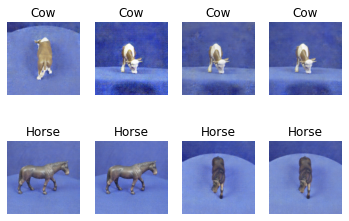

38601 [D loss: 0.069189, acc.: 98.44%] [G loss: 3.685640]
38602 [D loss: 0.218636, acc.: 93.75%] [G loss: 3.314017]
38603 [D loss: 0.162113, acc.: 95.31%] [G loss: 3.482615]
38604 [D loss: 0.069660, acc.: 98.44%] [G loss: 3.640176]
38605 [D loss: 0.030674, acc.: 100.00%] [G loss: 3.455263]
38606 [D loss: 0.026165, acc.: 100.00%] [G loss: 3.890211]
38607 [D loss: 0.107373, acc.: 96.88%] [G loss: 3.757214]
38608 [D loss: 0.079033, acc.: 98.44%] [G loss: 3.568064]
38609 [D loss: 0.075061, acc.: 98.44%] [G loss: 3.654552]
38610 [D loss: 0.127838, acc.: 96.88%] [G loss: 3.329910]
38611 [D loss: 0.224122, acc.: 93.75%] [G loss: 3.297977]
38612 [D loss: 0.068146, acc.: 98.44%] [G loss: 3.712276]
38613 [D loss: 0.160084, acc.: 95.31%] [G loss: 3.303990]
38614 [D loss: 0.034708, acc.: 100.00%] [G loss: 3.240135]
38615 [D loss: 0.083664, acc.: 98.44%] [G loss: 3.105252]
38616 [D loss: 0.066806, acc.: 98.44%] [G loss: 3.204427]
38617 [D loss: 0.063579, acc.: 98.44%] [G loss: 3.507358]
38618 [D lo

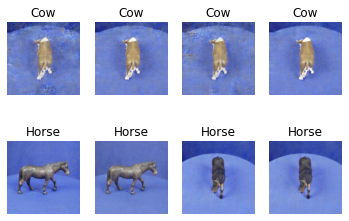

38701 [D loss: 0.020919, acc.: 100.00%] [G loss: 3.517196]
38702 [D loss: 0.062276, acc.: 98.44%] [G loss: 3.787255]
38703 [D loss: 0.062328, acc.: 98.44%] [G loss: 4.083050]
38704 [D loss: 0.053504, acc.: 98.44%] [G loss: 4.057266]
38705 [D loss: 0.045105, acc.: 98.44%] [G loss: 4.424069]
38706 [D loss: 0.117915, acc.: 96.88%] [G loss: 3.876750]
38707 [D loss: 0.143401, acc.: 95.31%] [G loss: 3.634914]
38708 [D loss: 0.016844, acc.: 100.00%] [G loss: 4.346102]
38709 [D loss: 0.019575, acc.: 100.00%] [G loss: 4.281062]
38710 [D loss: 0.210264, acc.: 93.75%] [G loss: 3.885038]
38711 [D loss: 0.058319, acc.: 98.44%] [G loss: 3.899618]
38712 [D loss: 0.104855, acc.: 96.88%] [G loss: 3.939622]
38713 [D loss: 0.104704, acc.: 96.88%] [G loss: 4.635981]
38714 [D loss: 0.058929, acc.: 98.44%] [G loss: 3.931306]
38715 [D loss: 0.100355, acc.: 98.44%] [G loss: 4.004142]
38716 [D loss: 0.128919, acc.: 95.31%] [G loss: 3.649921]
38717 [D loss: 0.112612, acc.: 96.88%] [G loss: 4.333923]
38718 [D lo

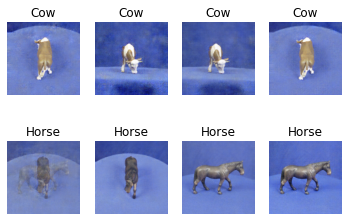

38801 [D loss: 0.077994, acc.: 98.44%] [G loss: 3.361694]
38802 [D loss: 0.127316, acc.: 96.88%] [G loss: 3.244899]
38803 [D loss: 0.104015, acc.: 96.88%] [G loss: 3.428115]
38804 [D loss: 0.211760, acc.: 93.75%] [G loss: 3.018208]
38805 [D loss: 0.080546, acc.: 98.44%] [G loss: 3.071510]
38806 [D loss: 0.092393, acc.: 96.88%] [G loss: 3.596606]
38807 [D loss: 0.062959, acc.: 98.44%] [G loss: 3.286326]
38808 [D loss: 0.020418, acc.: 100.00%] [G loss: 4.298666]
38809 [D loss: 0.052377, acc.: 98.44%] [G loss: 4.717517]
38810 [D loss: 0.140935, acc.: 95.31%] [G loss: 3.301663]
38811 [D loss: 0.098364, acc.: 96.88%] [G loss: 4.259643]
38812 [D loss: 0.020623, acc.: 100.00%] [G loss: 4.186771]
38813 [D loss: 0.190482, acc.: 93.75%] [G loss: 3.799184]
38814 [D loss: 0.161147, acc.: 95.31%] [G loss: 3.668488]
38815 [D loss: 0.073937, acc.: 96.88%] [G loss: 4.731069]
38816 [D loss: 0.081828, acc.: 98.44%] [G loss: 4.201933]
38817 [D loss: 0.069492, acc.: 98.44%] [G loss: 4.261883]
38818 [D los

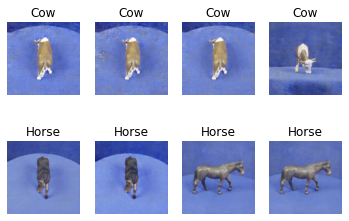

38901 [D loss: 0.167802, acc.: 93.75%] [G loss: 4.019462]
38902 [D loss: 0.024667, acc.: 100.00%] [G loss: 4.676831]
38903 [D loss: 0.116326, acc.: 98.44%] [G loss: 4.369823]
38904 [D loss: 0.145234, acc.: 95.31%] [G loss: 4.360037]
38905 [D loss: 0.078211, acc.: 98.44%] [G loss: 3.581391]
38906 [D loss: 0.078719, acc.: 98.44%] [G loss: 3.192593]
38907 [D loss: 0.073379, acc.: 98.44%] [G loss: 3.421152]
38908 [D loss: 0.077255, acc.: 98.44%] [G loss: 3.122192]
38909 [D loss: 0.068485, acc.: 98.44%] [G loss: 3.516863]
38910 [D loss: 0.258540, acc.: 92.19%] [G loss: 5.185607]
38911 [D loss: 0.086213, acc.: 98.44%] [G loss: 3.406449]
38912 [D loss: 0.146455, acc.: 95.31%] [G loss: 3.037070]
38913 [D loss: 0.091753, acc.: 98.44%] [G loss: 3.001344]
38914 [D loss: 0.317162, acc.: 89.06%] [G loss: 3.247413]
38915 [D loss: 0.222339, acc.: 92.19%] [G loss: 2.995921]
38916 [D loss: 0.074023, acc.: 98.44%] [G loss: 4.496411]
38917 [D loss: 0.097140, acc.: 96.88%] [G loss: 3.473634]
38918 [D loss

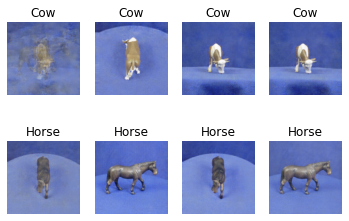

39001 [D loss: 0.041957, acc.: 100.00%] [G loss: 3.967900]
39002 [D loss: 0.060795, acc.: 98.44%] [G loss: 3.735458]
39003 [D loss: 0.120111, acc.: 95.31%] [G loss: 4.237030]
39004 [D loss: 0.064671, acc.: 98.44%] [G loss: 4.846134]
39005 [D loss: 0.126490, acc.: 95.31%] [G loss: 3.670487]
39006 [D loss: 0.203388, acc.: 93.75%] [G loss: 3.317093]
39007 [D loss: 0.192843, acc.: 92.19%] [G loss: 3.772558]
39008 [D loss: 0.086799, acc.: 96.88%] [G loss: 4.291595]
39009 [D loss: 0.040176, acc.: 100.00%] [G loss: 3.513657]
39010 [D loss: 0.093382, acc.: 98.44%] [G loss: 3.426288]
39011 [D loss: 0.218627, acc.: 93.75%] [G loss: 2.817214]
39012 [D loss: 0.169383, acc.: 95.31%] [G loss: 3.205306]
39013 [D loss: 0.127482, acc.: 95.31%] [G loss: 3.724985]
39014 [D loss: 0.034317, acc.: 100.00%] [G loss: 3.683123]
39015 [D loss: 0.098843, acc.: 96.88%] [G loss: 3.555202]
39016 [D loss: 0.029076, acc.: 100.00%] [G loss: 3.713325]
39017 [D loss: 0.053935, acc.: 98.44%] [G loss: 4.896114]
39018 [D l

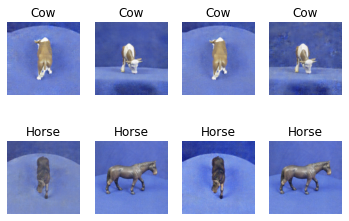

39101 [D loss: 0.076788, acc.: 96.88%] [G loss: 4.927440]
39102 [D loss: 0.116175, acc.: 96.88%] [G loss: 4.202794]
39103 [D loss: 0.052462, acc.: 98.44%] [G loss: 4.147671]
39104 [D loss: 0.057000, acc.: 98.44%] [G loss: 4.912140]
39105 [D loss: 0.113228, acc.: 96.88%] [G loss: 3.145456]
39106 [D loss: 0.033917, acc.: 100.00%] [G loss: 3.427475]
39107 [D loss: 0.077840, acc.: 98.44%] [G loss: 3.661070]
39108 [D loss: 0.112796, acc.: 96.88%] [G loss: 4.138568]
39109 [D loss: 0.010836, acc.: 100.00%] [G loss: 4.956622]
39110 [D loss: 0.086445, acc.: 96.88%] [G loss: 4.155919]
39111 [D loss: 0.024504, acc.: 100.00%] [G loss: 4.983017]
39112 [D loss: 0.039061, acc.: 98.44%] [G loss: 5.323583]
39113 [D loss: 0.237942, acc.: 92.19%] [G loss: 4.464673]
39114 [D loss: 0.166420, acc.: 93.75%] [G loss: 3.801185]
39115 [D loss: 0.027633, acc.: 100.00%] [G loss: 4.191292]
39116 [D loss: 0.061176, acc.: 98.44%] [G loss: 5.589865]
39117 [D loss: 0.121774, acc.: 96.88%] [G loss: 4.450448]
39118 [D l

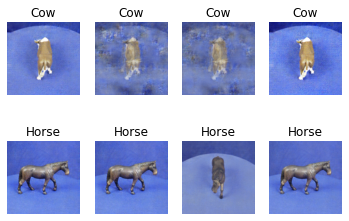

39201 [D loss: 0.137560, acc.: 95.31%] [G loss: 4.181359]
39202 [D loss: 0.080649, acc.: 98.44%] [G loss: 4.754433]
39203 [D loss: 0.059013, acc.: 98.44%] [G loss: 4.259958]
39204 [D loss: 0.109494, acc.: 96.88%] [G loss: 4.551024]
39205 [D loss: 0.018086, acc.: 100.00%] [G loss: 4.350555]
39206 [D loss: 0.092697, acc.: 96.88%] [G loss: 3.895595]
39207 [D loss: 0.119458, acc.: 96.88%] [G loss: 4.273496]
39208 [D loss: 0.108232, acc.: 96.88%] [G loss: 4.408480]
39209 [D loss: 0.098140, acc.: 96.88%] [G loss: 4.553118]
39210 [D loss: 0.103778, acc.: 96.88%] [G loss: 4.372155]
39211 [D loss: 0.073038, acc.: 98.44%] [G loss: 3.991477]
39212 [D loss: 0.017999, acc.: 100.00%] [G loss: 3.658598]
39213 [D loss: 0.018161, acc.: 100.00%] [G loss: 3.706708]
39214 [D loss: 0.148685, acc.: 95.31%] [G loss: 3.989673]
39215 [D loss: 0.071716, acc.: 98.44%] [G loss: 3.724252]
39216 [D loss: 0.023075, acc.: 100.00%] [G loss: 4.264168]
39217 [D loss: 0.074669, acc.: 98.44%] [G loss: 3.515226]
39218 [D l

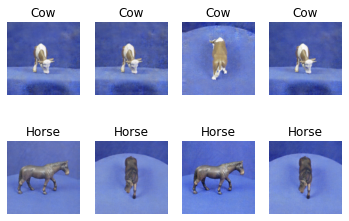

39301 [D loss: 0.115408, acc.: 96.88%] [G loss: 6.132390]
39302 [D loss: 0.025302, acc.: 100.00%] [G loss: 4.009720]
39303 [D loss: 0.055186, acc.: 98.44%] [G loss: 6.087273]
39304 [D loss: 0.064672, acc.: 98.44%] [G loss: 4.930893]
39305 [D loss: 0.079145, acc.: 96.88%] [G loss: 5.258414]
39306 [D loss: 0.056576, acc.: 98.44%] [G loss: 5.725148]
39307 [D loss: 0.141639, acc.: 96.88%] [G loss: 4.359841]
39308 [D loss: 0.169352, acc.: 95.31%] [G loss: 7.606157]
39309 [D loss: 0.192766, acc.: 93.75%] [G loss: 5.627150]
39310 [D loss: 0.072490, acc.: 98.44%] [G loss: 4.596478]
39311 [D loss: 0.114516, acc.: 96.88%] [G loss: 4.460752]
39312 [D loss: 0.182351, acc.: 95.31%] [G loss: 5.129488]
39313 [D loss: 0.091222, acc.: 96.88%] [G loss: 4.369330]
39314 [D loss: 0.049518, acc.: 98.44%] [G loss: 3.575325]
39315 [D loss: 0.073031, acc.: 98.44%] [G loss: 3.178539]
39316 [D loss: 0.034597, acc.: 100.00%] [G loss: 4.206459]
39317 [D loss: 0.135672, acc.: 95.31%] [G loss: 3.116061]
39318 [D los

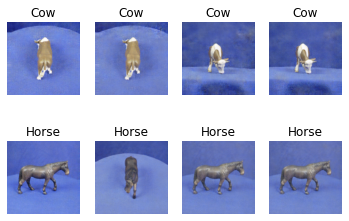

39401 [D loss: 0.097831, acc.: 96.88%] [G loss: 4.974974]
39402 [D loss: 0.059822, acc.: 98.44%] [G loss: 4.771370]
39403 [D loss: 0.051542, acc.: 98.44%] [G loss: 4.561889]
39404 [D loss: 0.017841, acc.: 100.00%] [G loss: 4.486383]
39405 [D loss: 0.138789, acc.: 96.88%] [G loss: 5.235011]
39406 [D loss: 0.100616, acc.: 96.88%] [G loss: 3.523245]
39407 [D loss: 0.310904, acc.: 89.06%] [G loss: 4.991348]
39408 [D loss: 0.078006, acc.: 98.44%] [G loss: 3.539948]
39409 [D loss: 0.102605, acc.: 98.44%] [G loss: 3.624431]
39410 [D loss: 0.133657, acc.: 95.31%] [G loss: 3.564622]
39411 [D loss: 0.073641, acc.: 98.44%] [G loss: 3.568855]
39412 [D loss: 0.113662, acc.: 98.44%] [G loss: 3.308752]
39413 [D loss: 0.034713, acc.: 100.00%] [G loss: 3.644076]
39414 [D loss: 0.055326, acc.: 98.44%] [G loss: 3.461564]
39415 [D loss: 0.102360, acc.: 96.88%] [G loss: 3.627130]
39416 [D loss: 0.086609, acc.: 98.44%] [G loss: 3.648876]
39417 [D loss: 0.322841, acc.: 90.62%] [G loss: 3.183269]
39418 [D los

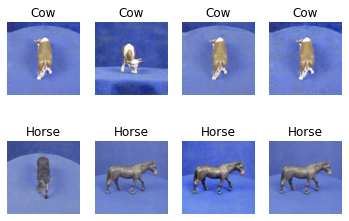

39501 [D loss: 0.105080, acc.: 96.88%] [G loss: 3.632953]
39502 [D loss: 0.064274, acc.: 98.44%] [G loss: 3.336722]
39503 [D loss: 0.101310, acc.: 96.88%] [G loss: 3.321904]
39504 [D loss: 0.103499, acc.: 96.88%] [G loss: 3.954801]
39505 [D loss: 0.073676, acc.: 98.44%] [G loss: 3.855833]
39506 [D loss: 0.021615, acc.: 100.00%] [G loss: 3.702451]
39507 [D loss: 0.070882, acc.: 98.44%] [G loss: 3.941148]
39508 [D loss: 0.059555, acc.: 98.44%] [G loss: 3.850808]
39509 [D loss: 0.017436, acc.: 100.00%] [G loss: 4.332428]
39510 [D loss: 0.067052, acc.: 98.44%] [G loss: 4.098253]
39511 [D loss: 0.059147, acc.: 98.44%] [G loss: 5.978179]
39512 [D loss: 0.050649, acc.: 98.44%] [G loss: 4.688444]
39513 [D loss: 0.149558, acc.: 95.31%] [G loss: 5.320301]
39514 [D loss: 0.062657, acc.: 98.44%] [G loss: 5.540247]
39515 [D loss: 0.071022, acc.: 98.44%] [G loss: 5.729362]
39516 [D loss: 0.033406, acc.: 100.00%] [G loss: 4.740164]
39517 [D loss: 0.091933, acc.: 96.88%] [G loss: 5.103184]
39518 [D lo

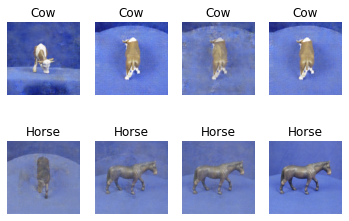

39601 [D loss: 0.024257, acc.: 100.00%] [G loss: 4.350173]
39602 [D loss: 0.063559, acc.: 98.44%] [G loss: 4.555387]
39603 [D loss: 0.116121, acc.: 96.88%] [G loss: 5.675460]
39604 [D loss: 0.192795, acc.: 93.75%] [G loss: 4.810352]
39605 [D loss: 0.209438, acc.: 90.62%] [G loss: 5.969377]
39606 [D loss: 0.067920, acc.: 96.88%] [G loss: 4.054478]
39607 [D loss: 0.097981, acc.: 96.88%] [G loss: 5.205280]
39608 [D loss: 0.129389, acc.: 98.44%] [G loss: 3.120493]
39609 [D loss: 0.105220, acc.: 96.88%] [G loss: 5.059789]
39610 [D loss: 0.034603, acc.: 100.00%] [G loss: 4.342486]
39611 [D loss: 0.140001, acc.: 95.31%] [G loss: 2.840624]
39612 [D loss: 0.088673, acc.: 98.44%] [G loss: 4.087142]
39613 [D loss: 0.091984, acc.: 96.88%] [G loss: 4.502902]
39614 [D loss: 0.268730, acc.: 90.62%] [G loss: 5.299510]
39615 [D loss: 0.033675, acc.: 100.00%] [G loss: 4.021850]
39616 [D loss: 0.097555, acc.: 96.88%] [G loss: 5.410295]
39617 [D loss: 0.075118, acc.: 98.44%] [G loss: 3.473729]
39618 [D lo

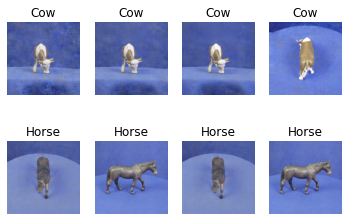

39701 [D loss: 0.048755, acc.: 98.44%] [G loss: 3.229117]
39702 [D loss: 0.024995, acc.: 100.00%] [G loss: 3.760255]
39703 [D loss: 0.044905, acc.: 98.44%] [G loss: 5.319543]
39704 [D loss: 0.096590, acc.: 96.88%] [G loss: 3.658183]
39705 [D loss: 0.064572, acc.: 98.44%] [G loss: 3.905855]
39706 [D loss: 0.090088, acc.: 96.88%] [G loss: 4.196543]
39707 [D loss: 0.089339, acc.: 96.88%] [G loss: 5.149142]
39708 [D loss: 0.184210, acc.: 95.31%] [G loss: 3.743818]
39709 [D loss: 0.143407, acc.: 95.31%] [G loss: 3.274826]
39710 [D loss: 0.097730, acc.: 96.88%] [G loss: 3.772764]
39711 [D loss: 0.098853, acc.: 96.88%] [G loss: 4.355438]
39712 [D loss: 0.104859, acc.: 96.88%] [G loss: 3.603100]
39713 [D loss: 0.037679, acc.: 100.00%] [G loss: 3.056399]
39714 [D loss: 0.086511, acc.: 98.44%] [G loss: 4.676290]
39715 [D loss: 0.139394, acc.: 95.31%] [G loss: 4.132957]
39716 [D loss: 0.055596, acc.: 98.44%] [G loss: 3.770309]
39717 [D loss: 0.099953, acc.: 96.88%] [G loss: 5.432854]
39718 [D los

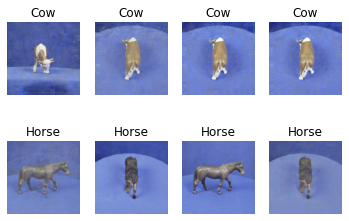

39801 [D loss: 0.014108, acc.: 100.00%] [G loss: 4.427838]
39802 [D loss: 0.063288, acc.: 98.44%] [G loss: 3.676277]
39803 [D loss: 0.143728, acc.: 95.31%] [G loss: 3.648128]
39804 [D loss: 0.074285, acc.: 98.44%] [G loss: 3.265257]
39805 [D loss: 0.091309, acc.: 98.44%] [G loss: 3.671602]
39806 [D loss: 0.082746, acc.: 98.44%] [G loss: 3.367343]
39807 [D loss: 0.189930, acc.: 92.19%] [G loss: 3.103205]
39808 [D loss: 0.105615, acc.: 96.88%] [G loss: 3.041686]
39809 [D loss: 0.060814, acc.: 98.44%] [G loss: 4.500044]
39810 [D loss: 0.106266, acc.: 96.88%] [G loss: 3.925018]
39811 [D loss: 0.130892, acc.: 96.88%] [G loss: 3.533135]
39812 [D loss: 0.127458, acc.: 95.31%] [G loss: 4.785090]
39813 [D loss: 0.047226, acc.: 98.44%] [G loss: 3.786406]
39814 [D loss: 0.071301, acc.: 98.44%] [G loss: 4.974958]
39815 [D loss: 0.191032, acc.: 93.75%] [G loss: 4.672949]
39816 [D loss: 0.277998, acc.: 90.62%] [G loss: 6.564972]
39817 [D loss: 0.042676, acc.: 98.44%] [G loss: 5.408580]
39818 [D loss

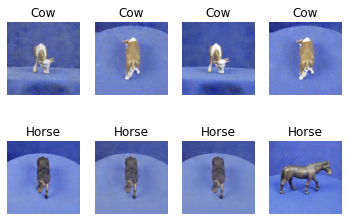

39901 [D loss: 0.063656, acc.: 98.44%] [G loss: 4.306150]
39902 [D loss: 0.224466, acc.: 92.19%] [G loss: 5.589480]
39903 [D loss: 0.106836, acc.: 96.88%] [G loss: 4.518399]
39904 [D loss: 0.114684, acc.: 96.88%] [G loss: 3.793424]
39905 [D loss: 0.137233, acc.: 95.31%] [G loss: 4.170208]
39906 [D loss: 0.102660, acc.: 95.31%] [G loss: 4.290270]
39907 [D loss: 0.051966, acc.: 98.44%] [G loss: 3.906932]
39908 [D loss: 0.049895, acc.: 100.00%] [G loss: 2.812562]
39909 [D loss: 0.031167, acc.: 100.00%] [G loss: 3.503229]
39910 [D loss: 0.017342, acc.: 100.00%] [G loss: 4.412761]
39911 [D loss: 0.051203, acc.: 98.44%] [G loss: 6.059299]
39912 [D loss: 0.054129, acc.: 98.44%] [G loss: 4.259155]
39913 [D loss: 0.217969, acc.: 93.75%] [G loss: 5.619757]
39914 [D loss: 0.095067, acc.: 96.88%] [G loss: 4.617516]
39915 [D loss: 0.022963, acc.: 100.00%] [G loss: 6.124133]
39916 [D loss: 0.065334, acc.: 98.44%] [G loss: 4.635998]
39917 [D loss: 0.144388, acc.: 95.31%] [G loss: 3.414384]
39918 [D l

In [52]:
generator = Generator(LATENT_DIM, NUM_CLASSES)
discriminator = Discriminator(IMAGE_SIZE, NUM_CLASSES)

cgan = CondGAN(image_size= IMAGE_SIZE, num_classes= NUM_CLASSES, latent_dim= LATENT_DIM, generator= generator, discriminator= discriminator)
cgan.train(epochs=40000, dataset= train_horses_cows, batch_size=32, sample_interval=100)

### Generating 1000 Images for Both Cows and Horses

In [66]:
nb_of_images = [250, 500, 1000]

noise_labels = {}
for no_im in nb_of_images:
    noise_labels[f"noise_{no_im}"] = tf.random.normal(shape= (no_im, 100))
    noise_labels[f"labels_{no_im}"] = np.random.randint(low= 0, high= 2, size= (no_im, 1)).reshape(-1, 1)

generated_cows_horses_images_250 = np.asarray(cgan.generator.predict([noise_labels["noise_250"], noise_labels["labels_250"]]) * 127.5 + 127.5, dtype= np.uint8)
generated_cows_horses_images_500 =  np.asarray(cgan.generator.predict([noise_labels["noise_500"], noise_labels["labels_500"]]) * 127.5 + 127.5, dtype= np.uint8)
generated_cows_horses_images_1000 =  np.asarray(cgan.generator.predict([noise_labels["noise_1000"], noise_labels["labels_1000"]]) * 127.5 + 127.5, dtype= np.uint8)

In [67]:
generated_data_250 = (np.asarray(generated_cows_horses_images_250, dtype= np.float32), np.asarray(noise_labels["labels_250"], dtype= np.int32))
generated_data_500 = (np.asarray(generated_cows_horses_images_500, dtype= np.float32), np.asarray(noise_labels["labels_500"], dtype= np.int32))
generated_data_1000 = (np.asarray(generated_cows_horses_images_1000, dtype= np.float32), np.asarray(noise_labels["labels_1000"], dtype= np.int32))

In [73]:
horse_batch = [data for i, data in enumerate(generated_data_500[0]) if generated_data_500[1][i] == 1]
cow_batch = [data for i, data in enumerate(generated_data_500[0]) if generated_data_500[1][i] == 0]

In [74]:
random_horse = np.random.choice(range(len(horse_batch)), size= 16, replace= False)
random_cow = np.random.choice(range(len(cow_batch)), size= 16, replace= False)
random_horse, random_cow

(array([169,  19,  72, 265, 215, 151,  13, 242, 111, 188,  98, 128,  30,
        235, 205,  25]),
 array([ 41,   1,  50,   6, 111,  45, 152, 125,  29,  16, 141,  34,  68,
         98,  17,  35]))

In [75]:
cow_images, horse_images = [np.asarray(cow_batch[i], dtype= np.uint8) for i in random_cow], [np.asarray(horse_batch[i], dtype= np.uint8) for i in random_horse]

	Generated Data


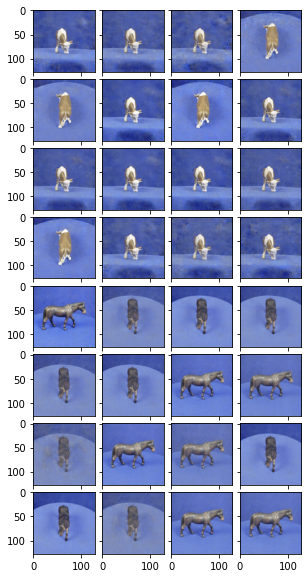

In [76]:
fig = plt.figure(figsize=(10., 10.), constrained_layout=True)
grid = ImageGrid(fig, 111,  # similar to subplot(111)
                 nrows_ncols=(8, 4),  # creates 2x2 grid of axes
                 axes_pad=0.1,  # pad between axes in inch.
                 )

for ax, im in zip(grid, [*cow_images, *horse_images]):
    # Iterating over the grid returns the Axes.
    ax.imshow(im)
print("\tGenerated Data")
plt.show()

### Appending To Original Dataset

In [ ]:
train_horses_cows_classification = tf.keras.preprocessing.image_dataset_from_directory(directory= "dataset/Newdata/Train",
                                                                                      batch_size= 16, image_size= (128, 128))

In [ ]:
train_horses_cows_classification

In [ ]:
generated_dataset_250 = tf.data.Dataset.from_tensor_slices(generated_data_250).batch(batch_size= 16)
generated_dataset_500 = tf.data.Dataset.from_tensor_slices(generated_data_500).batch(batch_size= 16)
generated_dataset_1000 = tf.data.Dataset.from_tensor_slices(generated_data_1000).batch(batch_size= 16)

In [ ]:
combined_dataset_250 = train_horses_cows_classification.concatenate(generated_dataset_250).shuffle(buffer_size= len(generated_dataset_250))
combined_dataset_500 = train_horses_cows_classification.concatenate(generated_dataset_500).shuffle(buffer_size= len(generated_dataset_500))
combined_dataset_1000 = train_horses_cows_classification.concatenate(generated_dataset_1000).shuffle(buffer_size= len(generated_dataset_1000))

val_horses_cows = DataLoader(im_dir= "dataset/Newdata/Test", classification= True, output_dim= (128, 128, 3))

### Classification Re-training

In [ ]:
EPOCHS= 50
BATCH_SIZE= 16
IMAGE_SIZE= (128, 128, 3)

In [ ]:
horses_cows_classifier_gen = Classifier(name= "Horses_vs_Cows_Classifier_with_Gen_Data")
horses_cows_classifier_gen.build(input_shape= (None, *IMAGE_SIZE))

horses_cows_classifier_gen.summary()
horses_cows_classifier_gen.compile(optimizer= Adam(0.001), loss= BinaryCrossentropy(), metrics= [BinaryAccuracy(), Recall(), Precision(), MSE])
# combined_dataset_250, combined_dataset_500, combined_dataset_1000
model_data = horses_cows_classifier_gen.fit(combined_dataset_1000, validation_data= val_horses_cows_classification, epochs= EPOCHS, workers= 10)

### Re-training Results

In [ ]:
show_metrics_classification(horses_cows_classifier_gen.history)

## Neural Style Transfer and Cycle GANs

In [ ]:
train_dataset = tf.keras.preprocessing.image_dataset_from_directory(directory= "dataset/Newdata/Train").unbatch()
test_dataset = tf.keras.preprocessing.image_dataset_from_directory(directory= "dataset/Newdata/Train").unbatch()

train_cows = train_dataset.filter(lambda img, label: label == 0).map(lambda img, label: img)
train_horses = train_dataset.filter(lambda img, label: label == 1).map(lambda img, label: img)

test_cows = test_dataset.filter(lambda img, label: label == 0).map(lambda img, label: img)
test_horses = test_dataset.filter(lambda img, label: label == 1).map(lambda img, label: img)

In [ ]:
# Define the standard image size.
orig_img_size = (256, 256)
# Size of the random crops to be used during training.
input_img_size = (200, 200, 3)
# Weights initializer for the layers.
kernel_init = RandomNormal(mean=0.0, stddev=0.02)
# Gamma initializer for instance normalization.
gamma_init = RandomNormal(mean=0.0, stddev=0.02)

buffer_size = 256
batch_size = 1


def normalize_img(img):
    img = tf.cast(img, dtype=tf.float32)
    # Map values in the range [-1, 1]
    return (img / 127.5) - 1.0


def preprocess_train_image(img):
    # Random flip
    img = tf.image.random_flip_left_right(img)
    # Resize to the original size first
    img = tf.image.resize(img, [*orig_img_size])
    # Random crop to 256X256
    img = tf.image.random_crop(img, size=[*input_img_size])
    # Normalize the pixel values in the range [-1, 1]
    img = normalize_img(img)
    return img


def preprocess_test_image(img):
    # Only resizing and normalization for the test images.
    img = tf.image.resize(img, [input_img_size[0], input_img_size[1]])
    img = normalize_img(img)
    return img


In [ ]:
# Apply the preprocessing operations to the training data
train_horses = (
    train_horses.map(preprocess_train_image)
    .cache()
    .shuffle(buffer_size)
    .batch(batch_size)
)
train_cows = (
    train_cows.map(preprocess_train_image)
    .cache()
    .shuffle(buffer_size)
    .batch(batch_size)
)

# Apply the preprocessing operations to the test data
test_horses = (
    test_horses.map(preprocess_test_image)
    .cache()
    .shuffle(buffer_size)
    .batch(batch_size)
)
test_cows = (
    test_cows.map(preprocess_test_image)
    .cache()
    .shuffle(buffer_size)
    .batch(batch_size)
)

In [ ]:
_, ax = plt.subplots(4, 2, figsize=(10, 15))
for i, samples in enumerate(zip(train_horses.take(4), train_cows.take(4))):
    horse = (((samples[0][0] * 127.5) + 127.5).numpy()).astype(np.uint8)
    cow = (((samples[1][0] * 127.5) + 127.5).numpy()).astype(np.uint8)
    ax[i, 0].imshow(horse)
    ax[i, 1].imshow(cow)
plt.show()


In [ ]:
class ReflectionPadding2D(Layer):

    def __init__(self, padding=(1, 1), **kwargs):
        self.padding = tuple(padding)
        super(ReflectionPadding2D, self).__init__(**kwargs)

    def call(self, input_tensor, mask=None):
        padding_width, padding_height = self.padding
        padding_tensor = [
            [0, 0],
            [padding_height, padding_height],
            [padding_width, padding_width],
            [0, 0],
        ]
        return tf.pad(input_tensor, padding_tensor, mode="REFLECT")


def residual_block(
    x,
    activation,
    kernel_initializer=kernel_init,
    kernel_size=(3, 3),
    strides=(1, 1),
    padding="valid",
    gamma_initializer=gamma_init,
    use_bias=False,
):
    dim = x.shape[-1]
    input_tensor = x

    x = ReflectionPadding2D()(input_tensor)
    x = layers.Conv2D(
        dim,
        kernel_size,
        strides=strides,
        kernel_initializer=kernel_initializer,
        padding=padding,
        use_bias=use_bias,
    )(x)
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    x = activation(x)

    x = ReflectionPadding2D()(x)
    x = layers.Conv2D(
        dim,
        kernel_size,
        strides=strides,
        kernel_initializer=kernel_initializer,
        padding=padding,
        use_bias=use_bias,
    )(x)
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    x = layers.add([input_tensor, x])
    return x


def downsample(
    x,
    filters,
    activation,
    kernel_initializer=kernel_init,
    kernel_size=(3, 3),
    strides=(2, 2),
    padding="same",
    gamma_initializer=gamma_init,
    use_bias=False,
):
    x = layers.Conv2D(
        filters,
        kernel_size,
        strides=strides,
        kernel_initializer=kernel_initializer,
        padding=padding,
        use_bias=use_bias,
    )(x)
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    if activation:
        x = activation(x)
    return x


def upsample(
    x,
    filters,
    activation,
    kernel_size=(3, 3),
    strides=(2, 2),
    padding="same",
    kernel_initializer=kernel_init,
    gamma_initializer=gamma_init,
    use_bias=False,
):
    x = layers.Conv2DTranspose(
        filters,
        kernel_size,
        strides=strides,
        padding=padding,
        kernel_initializer=kernel_initializer,
        use_bias=use_bias,
    )(x)
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    if activation:
        x = activation(x)
    return x


In [ ]:
def get_resnet_generator(
    filters=64,
    num_downsampling_blocks=2,
    num_residual_blocks=9,
    num_upsample_blocks=2,
    gamma_initializer=gamma_init,
    name=None,
):
    img_input = layers.Input(shape=input_img_size, name=name + "_img_input")
    x = ReflectionPadding2D(padding=(3, 3))(img_input)
    x = layers.Conv2D(filters, (7, 7), kernel_initializer=kernel_init, use_bias=False)(
        x
    )
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    x = layers.Activation("relu")(x)

    # Downsampling
    for _ in range(num_downsampling_blocks):
        filters *= 2
        x = downsample(x, filters=filters, activation=layers.Activation("relu"))

    # Residual blocks
    for _ in range(num_residual_blocks):
        x = residual_block(x, activation=layers.Activation("relu"))

    # Upsampling
    for _ in range(num_upsample_blocks):
        filters //= 2
        x = upsample(x, filters, activation=layers.Activation("relu"))

    # Final block
    x = ReflectionPadding2D(padding=(3, 3))(x)
    x = layers.Conv2D(3, (7, 7), padding="valid")(x)
    x = layers.Activation("tanh")(x)

    model = Model(img_input, x, name=name)
    return model


In [ ]:
def get_discriminator(
    filters=64, kernel_initializer=kernel_init, num_downsampling=3, name=None
):
    img_input = layers.Input(shape=input_img_size, name=name + "_img_input")
    x = layers.Conv2D(
        filters,
        (4, 4),
        strides=(2, 2),
        padding="same",
        kernel_initializer=kernel_initializer,
    )(img_input)
    x = layers.LeakyReLU(0.2)(x)

    num_filters = filters
    for num_downsample_block in range(3):
        num_filters *= 2
        if num_downsample_block < 2:
            x = downsample(
                x,
                filters=num_filters,
                activation=layers.LeakyReLU(0.2),
                kernel_size=(4, 4),
                strides=(2, 2),
            )
        else:
            x = downsample(
                x,
                filters=num_filters,
                activation=layers.LeakyReLU(0.2),
                kernel_size=(4, 4),
                strides=(1, 1),
            )

    x = layers.Conv2D(
        1, (4, 4), strides=(1, 1), padding="same", kernel_initializer=kernel_initializer
    )(x)

    model = Model(inputs=img_input, outputs=x, name=name)
    return model


# Get the generators
gen_G = get_resnet_generator(name="generator_G")
gen_F = get_resnet_generator(name="generator_F")

# Get the discriminators
disc_X = get_discriminator(name="discriminator_X")
disc_Y = get_discriminator(name="discriminator_Y")


In [ ]:
class CycleGan(keras.Model):
    def __init__(
        self,
        generator_G,
        generator_F,
        discriminator_X,
        discriminator_Y,
        lambda_cycle=10.0,
        lambda_identity=0.5,
    ):
        super(CycleGan, self).__init__()
        self.gen_G = generator_G
        self.gen_F = generator_F
        self.disc_X = discriminator_X
        self.disc_Y = discriminator_Y
        self.lambda_cycle = lambda_cycle
        self.lambda_identity = lambda_identity

    def compile(
        self,
        gen_G_optimizer,
        gen_F_optimizer,
        disc_X_optimizer,
        disc_Y_optimizer,
        gen_loss_fn,
        disc_loss_fn,
    ):
        super(CycleGan, self).compile()
        self.gen_G_optimizer = gen_G_optimizer
        self.gen_F_optimizer = gen_F_optimizer
        self.disc_X_optimizer = disc_X_optimizer
        self.disc_Y_optimizer = disc_Y_optimizer
        self.generator_loss_fn = gen_loss_fn
        self.discriminator_loss_fn = disc_loss_fn
        self.cycle_loss_fn = MeanAbsoluteError()
        self.identity_loss_fn = MeanAbsoluteError()

    def train_step(self, batch_data):
        # x is Horse and y is Cow
        real_x, real_y = batch_data

        # For CycleGAN, we need to calculate different
        # kinds of losses for the generators and discriminators.
        # We will perform the following steps here:
        #
        # 1. Pass real images through the generators and get the generated images
        # 2. Pass the generated images back to the generators to check if we
        #    we can predict the original image from the generated image.
        # 3. Do an identity mapping of the real images using the generators.
        # 4. Pass the generated images in 1) to the corresponding discriminators.
        # 5. Calculate the generators total loss (adverserial + cycle + identity)
        # 6. Calculate the discriminators loss
        # 7. Update the weights of the generators
        # 8. Update the weights of the discriminators
        # 9. Return the losses in a dictionary

        with tf.GradientTape(persistent=True) as tape:
            # Horse to fake Cow
            fake_y = self.gen_G(real_x, training=True)
            # Cow to fake horse -> y2x
            fake_x = self.gen_F(real_y, training=True)

            # Cycle (Horse to fake Cow to fake horse): x -> y -> x
            cycled_x = self.gen_F(fake_y, training=True)
            # Cycle (Cow to fake horse to fake Cow) y -> x -> y
            cycled_y = self.gen_G(fake_x, training=True)

            # Identity mapping
            same_x = self.gen_F(real_x, training=True)
            same_y = self.gen_G(real_y, training=True)

            # Discriminator output
            disc_real_x = self.disc_X(real_x, training=True)
            disc_fake_x = self.disc_X(fake_x, training=True)

            disc_real_y = self.disc_Y(real_y, training=True)
            disc_fake_y = self.disc_Y(fake_y, training=True)

            # Generator adverserial loss
            gen_G_loss = self.generator_loss_fn(disc_fake_y)
            gen_F_loss = self.generator_loss_fn(disc_fake_x)

            # Generator cycle loss
            cycle_loss_G = self.cycle_loss_fn(real_y, cycled_y) * self.lambda_cycle
            cycle_loss_F = self.cycle_loss_fn(real_x, cycled_x) * self.lambda_cycle

            # Generator identity loss
            id_loss_G = (
                self.identity_loss_fn(real_y, same_y)
                * self.lambda_cycle
                * self.lambda_identity
            )
            id_loss_F = (
                self.identity_loss_fn(real_x, same_x)
                * self.lambda_cycle
                * self.lambda_identity
            )

            # Total generator loss
            total_loss_G = gen_G_loss + cycle_loss_G + id_loss_G
            total_loss_F = gen_F_loss + cycle_loss_F + id_loss_F

            # Discriminator loss
            disc_X_loss = self.discriminator_loss_fn(disc_real_x, disc_fake_x)
            disc_Y_loss = self.discriminator_loss_fn(disc_real_y, disc_fake_y)

        # Get the gradients for the generators
        grads_G = tape.gradient(total_loss_G, self.gen_G.trainable_variables)
        grads_F = tape.gradient(total_loss_F, self.gen_F.trainable_variables)

        # Get the gradients for the discriminators
        disc_X_grads = tape.gradient(disc_X_loss, self.disc_X.trainable_variables)
        disc_Y_grads = tape.gradient(disc_Y_loss, self.disc_Y.trainable_variables)

        # Update the weights of the generators
        self.gen_G_optimizer.apply_gradients(
            zip(grads_G, self.gen_G.trainable_variables)
        )
        self.gen_F_optimizer.apply_gradients(
            zip(grads_F, self.gen_F.trainable_variables)
        )

        # Update the weights of the discriminators
        self.disc_X_optimizer.apply_gradients(
            zip(disc_X_grads, self.disc_X.trainable_variables)
        )
        self.disc_Y_optimizer.apply_gradients(
            zip(disc_Y_grads, self.disc_Y.trainable_variables)
        )

        return {
            "G_loss": total_loss_G,
            "F_loss": total_loss_F,
            "D_X_loss": disc_X_loss,
            "D_Y_loss": disc_Y_loss,
        }

In [ ]:
class GANMonitor(Callback):
    """A callback to generate and save images after each epoch"""

    def __init__(self, num_img=4):
        self.num_img = num_img

    def on_epoch_end(self, epoch, logs=None):
        _, ax = plt.subplots(4, 2, figsize=(12, 12))
        for i, img in enumerate(test_horses.take(self.num_img)):
            prediction = self.model.gen_G(img)[0].numpy()
            prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
            img = (img[0] * 127.5 + 127.5).numpy().astype(np.uint8)

            ax[i, 0].imshow(img)
            ax[i, 1].imshow(prediction)
            ax[i, 0].set_title("Input image")
            ax[i, 1].set_title("Translated image")
            ax[i, 0].axis("off")
            ax[i, 1].axis("off")

            prediction = tf.keras.preprocessing.image.array_to_img(prediction)
            prediction.save(
                "generated_img_{i}_{epoch}.png".format(i=i, epoch=epoch + 1)
            )
        plt.show()
        plt.close()

In [ ]:
# Loss function for evaluating adversarial loss
adv_loss_fn = keras.losses.MeanSquaredError()

# Define the loss function for the generators
def generator_loss_fn(fake):
    fake_loss = adv_loss_fn(tf.ones_like(fake), fake)
    return fake_loss


# Define the loss function for the discriminators
def discriminator_loss_fn(real, fake):
    real_loss = adv_loss_fn(tf.ones_like(real), real)
    fake_loss = adv_loss_fn(tf.zeros_like(fake), fake)
    return (real_loss + fake_loss) * 0.5


# Create cycle gan model
cycle_gan_model = CycleGan(
    generator_G=gen_G, generator_F=gen_F, discriminator_X=disc_X, discriminator_Y=disc_Y
)

# Compile the model
cycle_gan_model.compile(
    gen_G_optimizer=Adam(learning_rate=2e-4, beta_1=0.5),
    gen_F_optimizer=Adam(learning_rate=2e-4, beta_1=0.5),
    disc_X_optimizer=Adam(learning_rate=2e-4, beta_1=0.5),
    disc_Y_optimizer=Adam(learning_rate=2e-4, beta_1=0.5),
    gen_loss_fn=generator_loss_fn,
    disc_loss_fn=discriminator_loss_fn,
)
# Callbacks
plotter = GANMonitor()

cycle_gan_model.fit(
    tf.data.Dataset.zip((train_horses, train_cows)),
    epochs=50,
    callbacks=[plotter],
)

In [ ]:
_, ax = plt.subplots(4, 2, figsize=(10, 15))
for i, img in enumerate(test_horses.take(4)):
    prediction = cycle_gan_model.gen_G(img, training=False)[0].numpy()
    prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
    img = (img[0] * 127.5 + 127.5).numpy().astype(np.uint8)

    ax[i, 0].imshow(img)
    ax[i, 1].imshow(prediction)
    ax[i, 0].set_title("Input image")
    ax[i, 0].set_title("Input image")
    ax[i, 1].set_title("Translated image")
    ax[i, 0].axis("off")
    ax[i, 1].axis("off")

    prediction = tf.keras.preprocessing.image.array_to_img(prediction)
    prediction.save("predicted_img_{i}.png".format(i=i))
plt.tight_layout()
plt.show()